In [1]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import os, datetime
import tensorflow as tf
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
print('Tensorflow version: {}'.format(tf.__version__))

import matplotlib.pyplot as plt
plt.style.use('seaborn')

2023-08-31 09:20:00.941924: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-08-31 09:20:01.039421: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-08-31 09:20:01.041781: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-08-31 09:20:03.682169: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Tensorflow version: 2.12.0


In [2]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from keras.layers import Flatten
from keras import backend as K
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn import linear_model
import sqlite3
import pandas as pd
import math
import matplotlib.pyplot as plt
plt.style.use('seaborn')
from datetime import datetime
import random

In [3]:
import os
os.chdir('/gstore/project/hr_brca_heterogeneity/T47D_trace_Seq_v2/Nathan')
os.listdir()

['bar92196_survexp.csv',
 'bar92196_feature_importance.csv',
 'barmodels_palbo_barcodes6',
 'barmodels_pcares0.25',
 'tran_9545_survdepl.json',
 'pynbs',
 'tran_9545_barcodes.json',
 'cell_cycle_vignette_files',
 'tran_9545_barcodes5.json',
 'tran2_timebar_feature_importance.csv',
 'tran_combo_barcodes6.json',
 'SHAP',
 'model_training_weights',
 'barmodels_ptime_earlymid',
 'tran_combo_BREAST.json',
 'T-GEM',
 'barmodels2',
 'barmodels_ptime_BREAST',
 'barmodels_pcares0.25_BREAST',
 'tran_9545_barcodes2.json',
 'barmodels_ptime7',
 'barmodels_ptime_BREASTsurvdepl',
 'tran_Palbo_BREAST.json',
 'predictedSurvival',
 'tran_combo_barcodes.json',
 'barmodels_pathptime9',
 'IBMdata.csv',
 'tran_9545_pcares0.25_BREAST.json',
 'mse',
 'tran2_validation_feature_importance.csv',
 'barmodels_ptime_sd',
 'pathway_activity_scores.csv',
 'tran_Palbo_barcodes.json',
 'pathway_data.pckl',
 'dfs_merged_upload.csv',
 'barmodels_ptime_survdepl',
 'model_plot.png',
 'img',
 'tran_9545_barcodes3.json',
 '

In [4]:
'''Hyperparameters'''

batch_size = 32 # was 32
seq_len = 8 # was 128

#d_k = 256
#d_v = 256
n_heads = 40 # was 60  # Number of attention heads # no difference or imporvement between 5-60
n_head_size= 5 # was 46 # Embedding size for attention # no difference between 5-46
n_ff_dim = 5  # was 55    # Hidden layer size in feed forward network inside transformer # some difference between 5-55


In [26]:
#### full data
import json

# f = open('tran_9545_barcodes2.json') is 25% cells have count of 3 or more (RT-PT)
# f = open('tran_9545_barcodes3.json') is 10% cells have count of 1 or more (RT-PT)
# f = open('tran_9545_barcodes4.json') is PTIME ONLY order with 10% cells have count of 1 or more
# f = open('tran_9545_barcodes5.json') is PTIME ONLY order AND P-SURV with 10% cells have count of 1 or more
# f = open('tran_9545_barcodes6.json') is PLSR PTIME ONLY order AND P-SURV with 10% cells have count of 3 or more
# f = open('tran_9545_barcodes8.json') is PLSR BREASTcgp + ESRcgp Paths PTIME ONLY order AND P-SURV with 10% cells have count of 3 or more
# f = open('tran_9545_barcodes9.json') is PLSR PID + HALLMARK Paths PTIME ONLY order AND P-SURV with 10% cells have count of 3 or more
# f = open('tran_Palbo_barcodes.json') is palbo PLSR genes PTIME ONLY order AND P-SURV with 10% cells have count of 3 or more
# f = open('tran_Palbo_barcodes.json') is combo PLSR genes PTIME ONLY order AND P-SURV with 10% cells have count of 3 or more
# 'tran_9545_survdepl.json' is separated into surviving and depleting barcodes
# 'tran_9545_BREASTsurvdepl.json' is separated into surviving and depleting barcodes for BREAST + ESR paths
f = open('tran_9545_pcares0.25_BREAST.json')
data = json.load(f)

In [27]:
exp_days = {'Day 0': 1, 'Day 1': 2, 'Day 4': 3, 'Day 8': 4, 'Day 26': 5}

df = pd.DataFrame(data['GFPBC_libB_90850'])
df.iloc[:, 0:len(df.columns)-1]

,Pseudotime,RealTime,Survival,Score.MAPK,Score.ER_induced,Score.ER_repressed,Score.Hippo_145,Score.Hippo_50,Score.TCGA_LuBrCa_mPIK3CA_up,Score.TCGA_LuBrCa_mPIK3CA_dn,...,Score.VANTVEER_BREAST_CANCER_ESR1_DN.1,Score.STEIN_ESR1_TARGETS,Score.STEIN_ESRRA_TARGETS,Score.STEIN_ESTROGEN_RESPONSE_NOT_VIA_ESRRA,Score.WANG_METASTASIS_OF_BREAST_CANCER_ESR1_UP.1,Score.WANG_METASTASIS_OF_BREAST_CANCER_ESR1_DN.1,Score.BHAT_ESR1_TARGETS_NOT_VIA_AKT1_UP,Score.BHAT_ESR1_TARGETS_NOT_VIA_AKT1_DN,Score.BHAT_ESR1_TARGETS_VIA_AKT1_UP,Score.BHAT_ESR1_TARGETS_VIA_AKT1_DN
0,21.8581,4,1.3479,0.3698,0.3461,0.3930,0.3793,0.5344,0.1404,0.0000,...,2.0620,1.7869,2.0793,0.7788,1.5550,2.3805,1.2472,1.3634,1.2500,1.0628
1,21.8660,5,1.3474,0.0000,0.1373,0.7772,0.3282,0.3610,0.2225,0.0848,...,1.6761,1.2679,2.1058,0.0000,0.9096,1.5677,1.1380,1.1287,1.1096,1.4373
2,21.8810,2,1.3475,0.4983,0.2877,0.3057,0.4052,0.3888,0.0826,0.1513,...,1.8337,1.0623,1.9978,1.9469,1.2906,1.8691,1.4315,1.1239,1.5417,0.7202
3,21.9076,4,1.3515,0.2367,0.2339,0.5720,0.3742,0.3734,0.1671,0.0605,...,1.9364,1.1681,2.0584,0.8835,1.1995,1.3296,1.5209,2.0503,1.6197,1.8564
4,21.9140,3,1.3506,0.0000,0.2566,0.6624,0.3332,0.4337,0.1524,0.0000,...,2.0390,0.6070,1.8046,0.0000,1.5688,1.5826,1.4719,1.7649,1.3325,1.5627
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1726,47.6099,5,2.0272,0.1629,0.1874,0.7461,0.4528,0.6644,0.2782,0.1289,...,1.9110,2.0093,1.6691,1.3124,1.7693,0.8877,1.1421,1.3997,1.3462,1.4774
1727,47.6598,5,2.0279,0.1797,0.3142,0.3565,0.4034,0.4043,0.2266,0.0000,...,1.6208,1.3292,1.6895,0.7873,0.9536,1.3768,1.3683,2.0318,1.3632,2.0208
1728,47.6792,5,2.0181,0.1579,0.3484,0.8023,0.4660,0.6106,0.2495,0.0485,...,1.7083,1.0492,1.6445,1.1373,1.0046,1.6060,1.1635,2.1198,1.2699,2.0160
1729,47.6905,5,2.0082,0.0607,0.3118,0.6093,0.4208,0.5018,0.2528,0.2031,...,1.7890,1.1972,1.5808,0.6566,1.1603,1.4297,1.2211,2.0667,1.1661,1.8916


In [7]:
barcodes = [i for i in data.keys()]
new_barcodes = []
for i in barcodes:
    df = pd.DataFrame(data[i])
    #print(i, df.shape[0])
    if df.shape[0] > 400: # 50 or 60
        new_barcodes.append(i)
print(new_barcodes)

bar_dict = {new_barcodes[i]:i for i in range(len(new_barcodes))}

['GFPBC_libB_83026', 'GFPBC_libB_40758', 'GFPBC_libB_20182', 'GFPBC_libB_90850', 'GFPBC_libB_37798', 'GFPBC_libB_92196', 'GFPBC_libB_10678', 'GFPBC_libB_94397', 'GFPBC_libB_31581']


In [8]:
'''Create training and test data'''

def transformer_train_test_split_dayiter(bar, frac_val, extra_var_bool, splitval):
    
    bardf = pd.DataFrame(data[bar])
    #bardf = bardf[bardf['RealTime'] <= exp_days[d]]
    num_cell_day = len(bardf['RealTime'].tolist())
    snum = int(num_cell_day*splitval)
    bardf = bardf.iloc[:snum,:]
    
    
    bardf = bardf.iloc[:,:len(bardf.columns)-1]
    bardf['RealTime'] = bardf['RealTime'].astype('category')
    bardf['Barcode'] = [bar_dict[bar] for _ in range(bardf.shape[0])]
    bardf['Barcode'] = bardf['Barcode'].astype('category')
    
    # normalize after train/test split
    scaler = MinMaxScaler(feature_range=(-1, 1)) 
    bardf2 = pd.DataFrame(scaler.fit_transform(bardf.iloc[:,2:len(bardf.columns)-1])) # survival and expression
    bardf2.columns = bardf.columns[2:len(bardf.columns)-1]
    
    if extra_var_bool[0]:
        bardf2['RealTime'] = bardf['RealTime'].astype('category')
        num_cell_day = len(bardf2['RealTime'].tolist())
    if extra_var_bool[1]:
        bardf2['Barcode'] = bardf['Barcode'].astype('category')
    if extra_var_bool[2]:
        bardf2['Pseudotime'] = bardf['Pseudotime']
    #bardf2 = bardf2.dropna()
    COLS = bardf2.columns.tolist()[1:]
    #print(COLS)
    
    bardf2 = bardf2.dropna()
    bardf2.index = [i for i in range(bardf2.shape[0])]
    bardf_train = bardf2[:-(round(num_cell_day*frac_val))]
    bardf_val = bardf2[len(bardf2) - (round(num_cell_day*frac_val)):]
    #print(bardf_val)
    
    train_y = bardf_train['Survival']
    train_data = bardf_train.iloc[:,1:]
    val_y = bardf_val['Survival'].tolist()
    val_data = bardf_val.iloc[:,1:]
    
    # Training data
    X_train, y_train = [], []
    for i in range(seq_len, len(train_data)):
      X_train.append(train_data[i-seq_len:i]) 
      y_train.append(train_y[i]) #Value of 0th column (Survival) of df-row seq_len+1
    X_train, y_train = np.array(X_train), np.array(y_train)
    
    # Validation data
    X_val, y_val = [], []
    for i in range(seq_len, len(val_data)):
      X_val.append(val_data[i-seq_len:i]) 
      y_val.append(val_y[i]) #Value of 0th column (Survival) of df-row seq_len+1
    X_val, y_val = np.array(X_val), np.array(y_val)
    
    print('Transformer Training/Val set shapes (varies depending on barcode) ', X_train.shape, X_val.shape)
    return X_train, y_train, X_val, y_val, COLS

In [9]:
'''Create training and test data'''

def regr_train_test_split_dayiter(bar, frac_val, extra_var_bool, splitval):
    
    bardf = pd.DataFrame(data[bar])
    #bardf = bardf[bardf['RealTime'] <= exp_days[d]]
    num_cell_day = len(bardf['RealTime'].tolist())
    snum = int(num_cell_day*splitval)
    bardf = bardf.iloc[:snum,:]
    
    bardf = bardf.iloc[:,:len(bardf.columns)-1]
    bardf['RealTime'] = bardf['RealTime'].astype('category')
    bardf['Barcode'] = [bar_dict[bar] for _ in range(bardf.shape[0])]
    bardf['Barcode'] = bardf['Barcode'].astype('category')
    
    # normalize after train/test split
    scaler = MinMaxScaler(feature_range=(-1, 1)) 
    bardf2 = pd.DataFrame(scaler.fit_transform(bardf.iloc[:,2:len(bardf.columns)-1])) # survival and expression
    bardf2.columns = bardf.columns[2:len(bardf.columns)-1]
    
    if extra_var_bool[0]:
        bardf2['RealTime'] = bardf['RealTime'].astype('category')
        num_cell_day = len(bardf2['RealTime'].tolist())
    if extra_var_bool[1]:
        bardf2['Barcode'] = bardf['Barcode'].astype('category')
    if extra_var_bool[2]:
        bardf2['Pseudotime'] = bardf['Pseudotime']
        
    bardf2 = bardf2.dropna()
    bardf2.index = [i for i in range(bardf2.shape[0])]
    bardf_train = bardf2[:-(round(num_cell_day*frac_val))]
    bardf_val = bardf2[len(bardf2) - (round(num_cell_day*frac_val)):]
    #print(bardf_val)
    
    train_y = bardf_train['Survival']
    train_data = bardf_train.iloc[:,1:]
    val_y = bardf_val['Survival'].tolist()
    val_data = bardf_val.iloc[:,1:]
    
    # Training data
    X_train, y_train = np.array(train_data), np.array(train_y)
    
    # Validation data
    X_val, y_val = np.array(val_data), np.array(val_y)
    
    print('Regr Training/Val set shapes (varies depending on barcode) ', X_train.shape, X_val.shape)
    return X_train, y_train, X_val, y_val

In [10]:
########### testing function #################
# make the training and validation data

b = 'GFPBC_libB_92196'
frac_val = 0.20
extra_var_bool = [False, False, False] # 0-realtime, 1-barcode, 2-pseudotime
vs = [0.25, 0.5, 0.75, 1]
pct_test = frac_val/len(vs)
for v in vs:
    X_train, y_train, X_val, y_val, cols = transformer_train_test_split_dayiter(b, pct_test, extra_var_bool, v)
    X_train, y_train, X_val, y_val = regr_train_test_split_dayiter(b, pct_test, extra_var_bool, v)


Transformer Training/Val set shapes (varies depending on barcode)  (420, 8, 1969) (99, 8, 1969)
Regr Training/Val set shapes (varies depending on barcode)  (428, 1969) (107, 1969)
Transformer Training/Val set shapes (varies depending on barcode)  (955, 8, 1969) (99, 8, 1969)
Regr Training/Val set shapes (varies depending on barcode)  (963, 1969) (107, 1969)
Transformer Training/Val set shapes (varies depending on barcode)  (1490, 8, 1969) (99, 8, 1969)
Regr Training/Val set shapes (varies depending on barcode)  (1498, 1969) (107, 1969)
Transformer Training/Val set shapes (varies depending on barcode)  (2025, 8, 1969) (99, 8, 1969)
Regr Training/Val set shapes (varies depending on barcode)  (2033, 1969) (107, 1969)


In [11]:
def transformer_encoder(inputs, head_size, num_heads, ff_dim, num_transformer_blocks, dropout=0):
    
    for _ in range(num_transformer_blocks):
        # Normalization and Attention
        # "EMBEDDING LAYER"
        x = layers.LayerNormalization(epsilon=1e-6)(inputs)

        # "ATTENTION LAYER"
        x = layers.MultiHeadAttention(
            key_dim=head_size, num_heads=num_heads, dropout=dropout
        )(x, x)
        x = layers.Dropout(dropout)(x)
        res = x + inputs
    
    for _ in range(num_transformer_blocks):
        # FEED FORWARD Part - you can stick anything here or just delete the whole section - it will still work. 
        x = layers.LayerNormalization(epsilon=1e-6)(res)
        x = layers.Conv1D(filters=ff_dim, kernel_size=1, activation = "relu")(x)
        x = layers.Dropout(dropout)(x)
        x = layers.Conv1D(filters=inputs.shape[-1], kernel_size=1)(x)
    return x + res

In [12]:
def build_model(
    input_shape,
    head_size,
    num_heads,
    ff_dim,
    num_transformer_blocks,
    mlp_units,
    dropout=0,
    mlp_dropout=0, 
):
    inputs = keras.Input(shape=input_shape)
    x = inputs
    
    # This is what stacks our transformer blocks
    x = transformer_encoder(x, head_size, num_heads, ff_dim, num_transformer_blocks, dropout)

    x = layers.GlobalAveragePooling1D(data_format="channels_first")(x)
    for dim in mlp_units:
        x = layers.Dense(dim, activation="elu")(x)
        x = layers.Dropout(mlp_dropout)(x)
    outputs = layers.Dense(1, activation="linear")(x) #this is a pass-through
    return keras.Model(inputs, outputs)

In [13]:
def lr_scheduler(epoch, lr, warmup_epochs=30, decay_epochs=100, initial_lr=1e-6, base_lr=1e-3, min_lr=5e-5):
    if epoch <= warmup_epochs:
        pct = epoch / warmup_epochs
        return ((base_lr - initial_lr) * pct) + initial_lr

    if epoch > warmup_epochs and epoch < warmup_epochs+decay_epochs:
        pct = 1 - ((epoch - warmup_epochs) / decay_epochs)
        return ((base_lr - min_lr) * pct) + min_lr

    return min_lr

# This learning rate scheduler is also from Mr. Theodoros Ntakouris' articla at https://towardsdatascience.com/the-time-series-transformer-2a521a0efad3
# I am definetely a fan.

In [14]:
callbacks = [
            keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True),
            keras.callbacks.LearningRateScheduler(lr_scheduler)
            ]

In [15]:
# Create a callback that saves the model's weights
checkpoint_path = "model_training_weights/cp.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 verbose=1)

In [16]:
from keras.utils.vis_utils import plot_model
import pydot
import graphviz

#tf.keras.utils.plot_model(model, to_file ='model_plot.png', show_shapes = True, show_layer_names = True)

In [17]:
def SHAPvals(X_val, y_val, bar, COLS, dir_path):
    
    #COLS = bardf.columns.tolist()[1:] # may need fixing
    #print(len(COLS), X_val.shape)
    #print(COLS)

    results = []
    print(' Computing feature importance...')

    # COMPUTE BASELINE (NO SHUFFLE)
    oof_preds = model.predict(X_val, verbose=0).squeeze() 
    baseline_mae = np.mean(np.abs( oof_preds-y_val ))
    results.append({'feature':'BASELINE','mae':baseline_mae})           

    for k in range(len(COLS)):

        if k in [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]:
            print('SHAP', k)
        # SHUFFLE FEATURE K
        save_col = X_val[:,:,k].copy()
        np.random.shuffle(X_val[:,:,k])

        # COMPUTE OOF MAE WITH FEATURE K SHUFFLED
        oof_preds = model.predict(X_val, verbose=0).squeeze() 
        mae = np.mean(np.abs( oof_preds-y_val ))
        results.append({'feature':COLS[k],'mae':mae})
        X_val[:,:,k] = save_col

    # DISPLAY FEATURE IMPORTANCE
    print()
    df = pd.DataFrame(results)
    df = df.sort_values('mae')
    plt.figure(figsize=(10,20))
    plt.barh(np.arange(len(COLS)+1),df.mae)
    plt.yticks(np.arange(len(COLS)+1),df.feature.values)
    plt.title('Feature Importance',size=16)
    plt.ylim((-1,len(COLS)+1))
    plt.plot([baseline_mae,baseline_mae],[-1,len(COLS)+1], '--', color='orange',
             label=f'Baseline OOF\nMAE={baseline_mae:.3f}')
    plt.xlabel(f'OOF MAE with feature permuted',size=14)
    plt.ylabel('Feature',size=14)
    plt.legend()
    plt.show()

    # SAVE FEATURE IMPORTANCE
    df = df.sort_values('mae',ascending=False)
    df['fc_mae'] = df['mae'] - baseline_mae
    df.to_csv(dir_path+bar+'_feature_importance.csv',index=False)

In [18]:
def regr_SHAPvals(X_val, y_val, bar, COLS, dir_path):
    
    #COLS = bardf.columns.tolist()[1:] # may need fixing
    #print(len(COLS), X_val.shape)
    #print(COLS)

    results = []
    print(' Computing feature importance...')

    # COMPUTE BASELINE (NO SHUFFLE)
    oof_preds = regr.predict(X_val).squeeze() 
    baseline_mae = np.mean(np.abs( oof_preds-y_val ))
    results.append({'feature':'BASELINE','mae':baseline_mae})           

    for k in range(len(COLS)):

        if k in [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]:
            print('SHAP', k)
        # SHUFFLE FEATURE K
        save_col = X_val[:,k].copy()
        np.random.shuffle(X_val[:,k])

        # COMPUTE OOF MAE WITH FEATURE K SHUFFLED
        oof_preds = regr.predict(X_val).squeeze() 
        mae = np.mean(np.abs( oof_preds-y_val ))
        results.append({'feature':COLS[k],'mae':mae})
        X_val[:,k] = save_col

    # DISPLAY FEATURE IMPORTANCE
    print()
    df = pd.DataFrame(results)
    df = df.sort_values('mae')
    plt.figure(figsize=(10,20))
    plt.barh(np.arange(len(COLS)+1),df.mae)
    plt.yticks(np.arange(len(COLS)+1),df.feature.values)
    plt.title('Feature Importance',size=16)
    plt.ylim((-1,len(COLS)+1))
    plt.plot([baseline_mae,baseline_mae],[-1,len(COLS)+1], '--', color='orange',
             label=f'Baseline OOF\nMAE={baseline_mae:.3f}')
    plt.xlabel(f'OOF MAE with feature permuted',size=14)
    plt.ylabel('Feature',size=14)
    plt.legend()
    plt.show()

    # SAVE FEATURE IMPORTANCE
    df = df.sort_values('mae',ascending=False)
    df['fc_mae'] = df['mae'] - baseline_mae
    df.to_csv(dir_path+bar+'_feature_importance.csv',index=False)

In [19]:
def plot_transformer_predictions_losses(X_train, y_train, X_val, y_val, bar, dir_path):
    
    #Calculate predication for training, validation and test data
    print(X_train.shape, X_val.shape)
    train_pred = model.predict(X_train)
    val_pred = model.predict(X_val)

    #Print evaluation metrics for all datasets
    train_mse = mean_squared_error(y_train, train_pred)
    val_mse = mean_squared_error(y_val, val_pred)
    print(' ')
    print('Transformer Evaluation metrics')
    print('Transformer Training MSE - MSE: {:.4f}'.format(train_mse)) ### these lines should be MSE???
    print('Transformer Validation MSE - MSE: {:.4f}'.format(val_mse))
    

    plt.plot(y_train, label='Survival')
    plt.plot(np.arange(train_pred.shape[0]), train_pred, linewidth=3, label='Predicted Survival')
    plt.title("Transformer Training Data", fontsize=18)
    plt.xlabel('Real + Pseudotime')
    plt.ylabel('Survival')
    plt.ylim(-1.5, 1.5)
    plt.legend(loc="best", fontsize=12)
    plt.savefig(dir_path+bar+'_training.png', bbox_inches='tight')
    plt.show()

    #Plot validation data results
    plt.plot(y_val, label='Survival')
    plt.plot(np.arange(val_pred.shape[0]), val_pred, linewidth=3, label='Predicted Survival')
    plt.title("Transformer Validation Data", fontsize=18)
    plt.xlabel('Real + Pseudotime')
    plt.ylabel('Survival')
    plt.ylim(-1.5, 1.5)
    plt.legend(loc="best", fontsize=12)
    plt.savefig(dir_path+bar+'_validation.png', bbox_inches='tight')
    plt.show()
    
    return train_mse, val_mse

In [20]:
def plot_regr_predictions_losses(X_train, y_train, X_val, y_val, bar, dir_path):
    
    #Calculate predication for training, validation and test data
    train_pred = regr.predict(X_train) #regr.predict(X)
    val_pred = regr.predict(X_val) #regr.predict(X_test)

    #Print evaluation metrics for all datasets
    train_eval = mean_squared_error(y_train, train_pred) #mean_squared_error(y, train_pred)
    val_eval = mean_squared_error(y_val, val_pred) #mean_squared_error(y_test, val_pred)
    print(' ')
    print('Evaluation metrics Regr')
    print('Regr Training Data - MSE: {:.4f}'.format(train_eval)) ### these lines should be MSE???
    print('Regr Validation Data - MSE: {:.4f}'.format(val_eval))
    
    #plt.plot(y, label='Survival')
    plt.plot(y_train, label='Survival')
    plt.plot(np.arange(train_pred.shape[0]), train_pred, linewidth=3, label='Predicted Survival')
    plt.title("Regr Training Data", fontsize=18)
    plt.xlabel('Real + Pseudotime')
    plt.ylabel('Survival')
    plt.ylim(-1.5, 1.5)
    plt.legend(loc="best", fontsize=12)
    plt.savefig(dir_path+bar+'_training.png', bbox_inches='tight')
    plt.show()

    #Plot validation data results
    #plt.plot(y_test, label='Survival')
    plt.plot(y_val, label='Survival')
    plt.plot(np.arange(val_pred.shape[0]), val_pred, linewidth=3, label='Predicted Survival')
    plt.title("Regr Validation Data", fontsize=18)
    plt.xlabel('Real + Pseudotime')
    plt.ylabel('Survival')
    plt.ylim(-1.5, 1.5)
    plt.legend(loc="best", fontsize=12)
    plt.savefig(dir_path+bar+'_validation.png', bbox_inches='tight')
    plt.show()
    
    return train_eval, val_eval

In [21]:
# set seeds produces more similar results, but not exact
seed_value = 42
os.environ['PYTHONHASHSEED']=str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)
tf.random.set_seed(seed_value)

0 
 0 
 0



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor([1. 1. 1. 1. 1. 1. 1. 1. 1. 1.], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.2764 - mean_squared_error: 0.2764
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 44ms/step - loss: 0.2491 - mean_squared_error: 0.2491 - val_loss: 1.1581 - val_mean_squared_error: 1.1581
Epoch 2/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.1623 - mean_squared_error: 0.1623
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 0s 27ms/step - loss: 0.1387 - mean_squared_error: 0.1387 - val_loss: 0.3455 - val_mean_squared_error: 0.3455
Epoch 3/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0819 - mean_squared_error: 0.0819
Epoch 3: saving model to model_training_weights/cp.ckpt
12/12 [==================

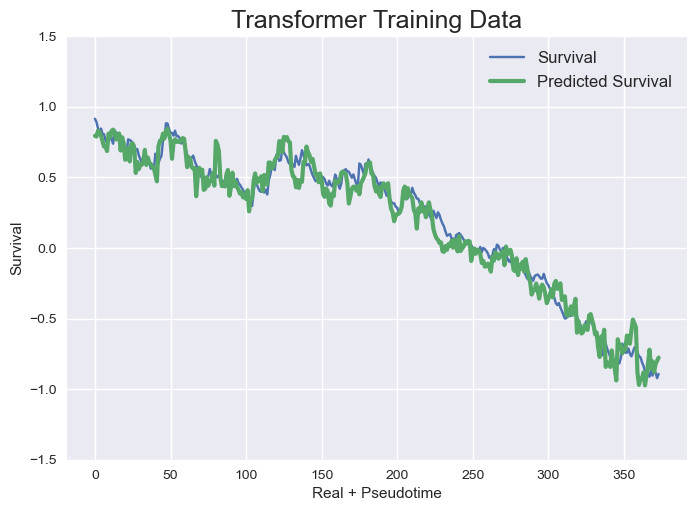

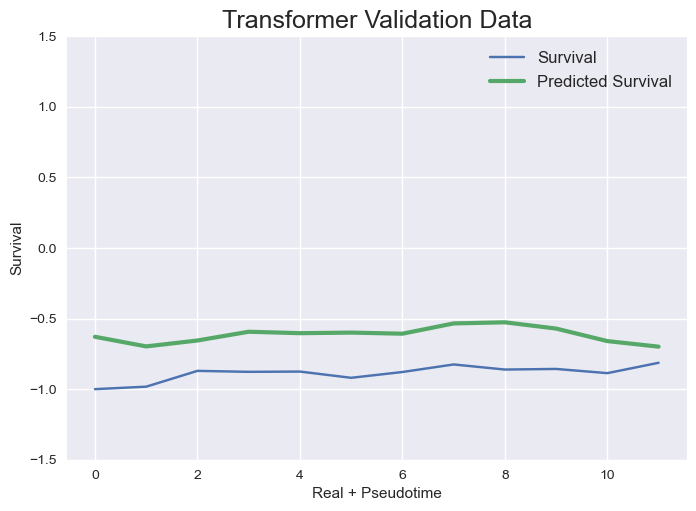

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


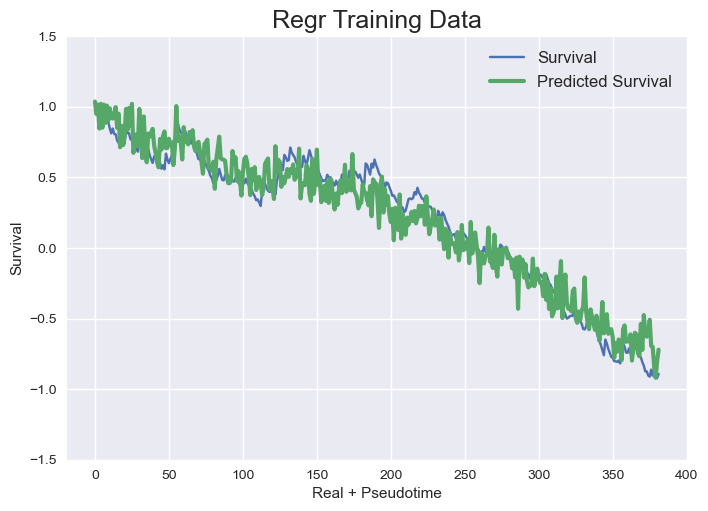

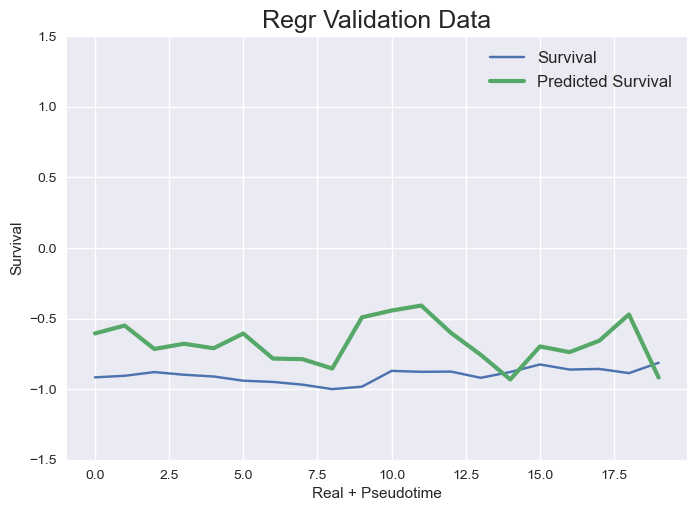

tf.Tensor(
[0.99761945 1.0008713  1.015699   1.0094589  1.0057678  1.0175887
 0.99301636 1.0151027  0.9934896  0.99313277], shape=(10,), dtype=float32)
{0.75: [0.007588213184932258, 0.07822887398284657, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.99761945 1.0008713  1.015699   1.0094589  1.0057678  1.0175887
 0.99301636 1.0151027  0.9934896  0.99313277], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0830 - mean_squared_error: 0.0830
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 78ms/step - loss: 0.0822 - mean_squared_error: 0.0822 - val_loss: 0.0679 - val_mean_squared_error: 0.0679
Epoch 2/10
 7/10 [====================>.........] - ETA: 0s - loss: 0.0465 - mean_squared_error: 0.0465
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [===========

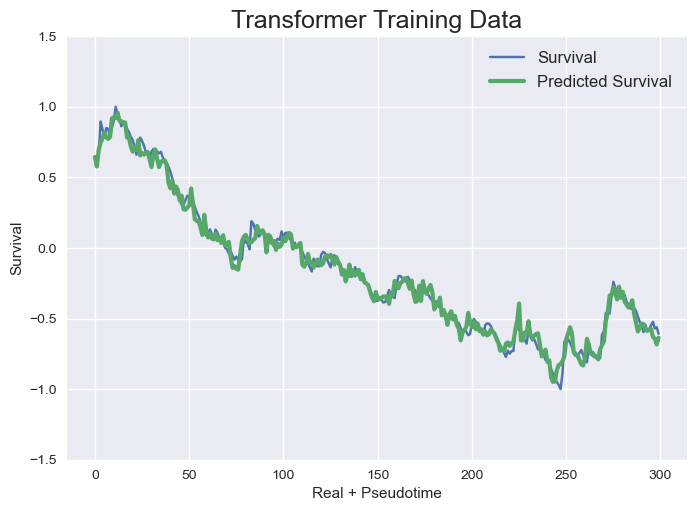

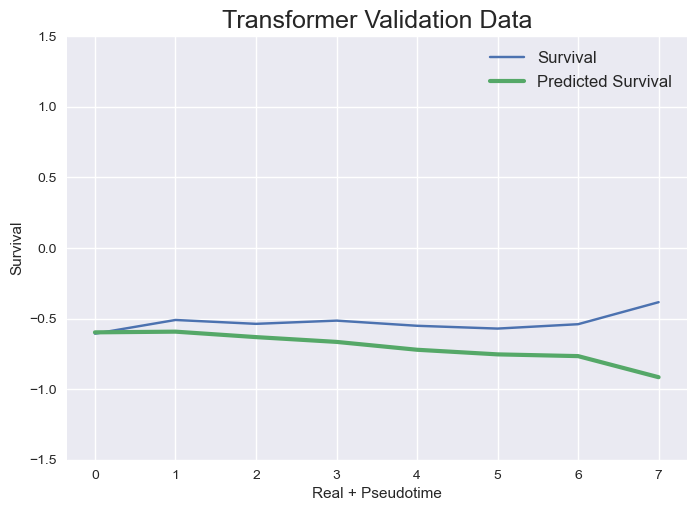

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


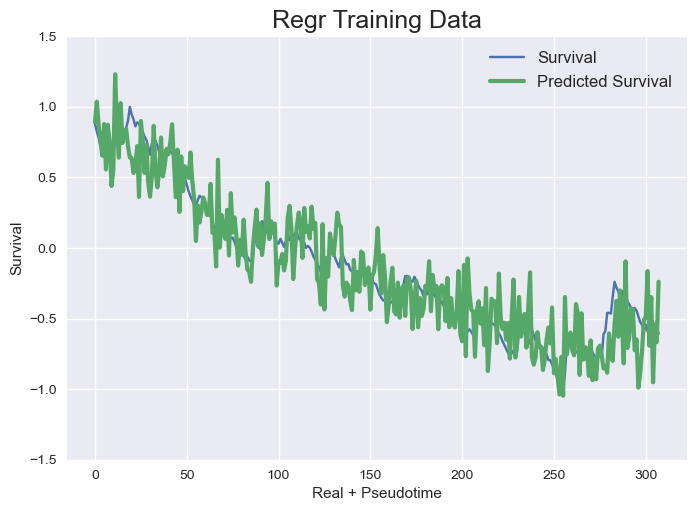

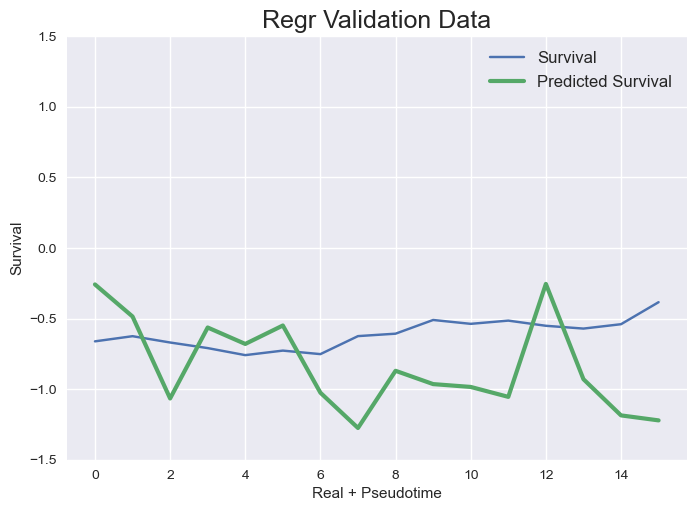

tf.Tensor(
[1.0059462  0.9950577  1.0181472  1.0192626  1.0206146  1.0176685
 0.98150295 1.0226951  1.0025498  0.98727995], shape=(10,), dtype=float32)
{0.75: [0.0033146826658401723, 0.0542817102921445, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[1.0059462  0.9950577  1.0181472  1.0192626  1.0206146  1.0176685
 0.98150295 1.0226951  1.0025498  0.98727995], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.1867 - mean_squared_error: 0.1867
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 60ms/step - loss: 0.1785 - mean_squared_error: 0.1785 - val_loss: 0.6011 - val_mean_squared_error: 0.6011
Epoch 2/10
28/28 [==============================] - ETA: 0s - loss: 0.0734 - mean_squared_error: 0.0734
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [=============

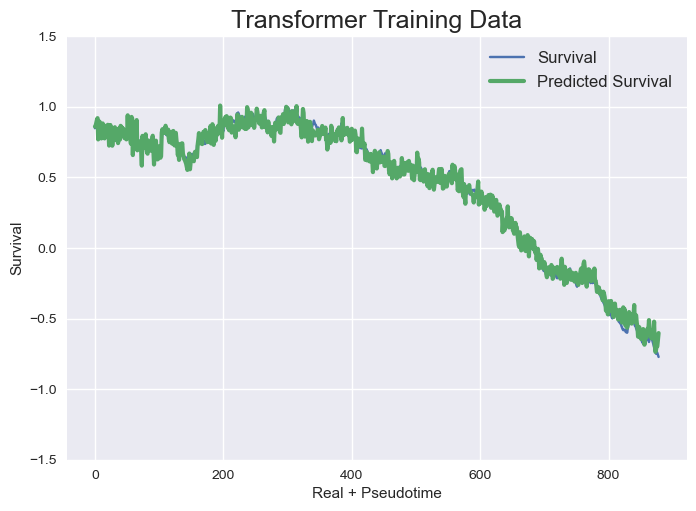

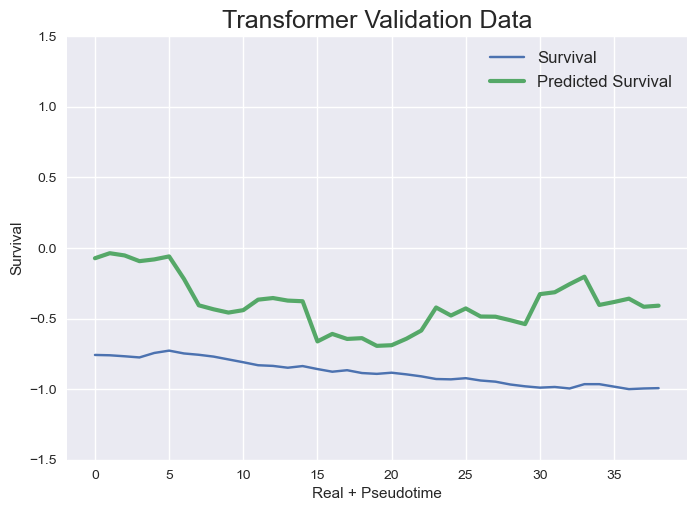

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


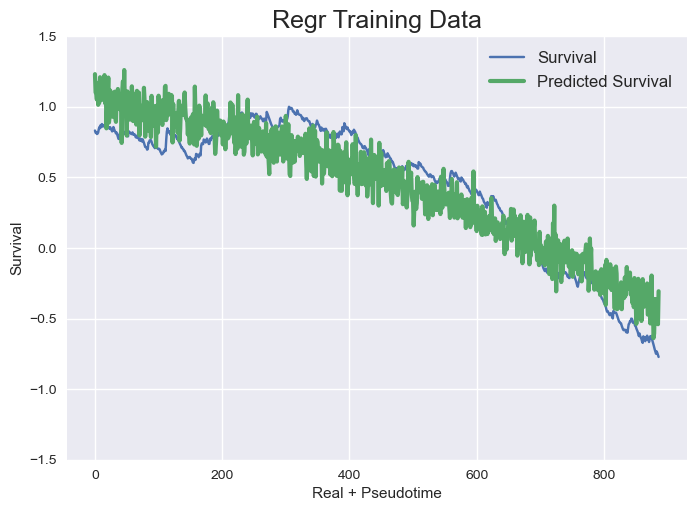

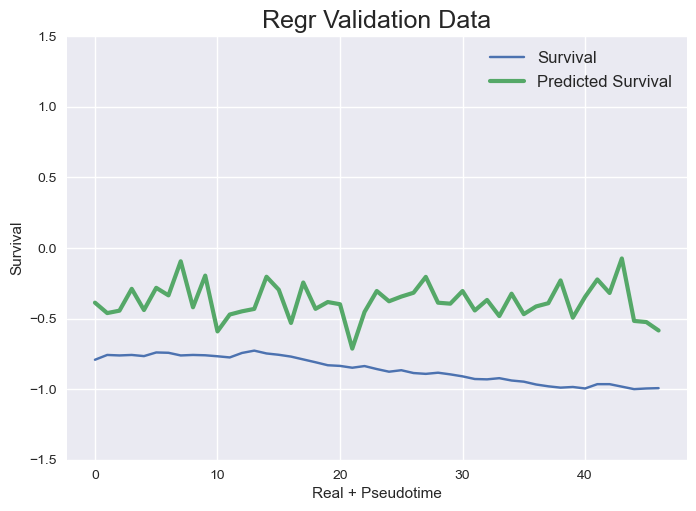

tf.Tensor(
[1.0148968  0.99512595 1.0527775  1.0406693  1.0135338  1.0320122
 0.9670427  1.0445834  0.99260044 0.97899276], shape=(10,), dtype=float32)
{0.75: [0.0023479986406836173, 0.26315217190181117, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[1.0148968  0.99512595 1.0527775  1.0406693  1.0135338  1.0320122
 0.9670427  1.0445834  0.99260044 0.97899276], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.2980 - mean_squared_error: 0.2980
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 4s 29ms/step - loss: 0.2892 - mean_squared_error: 0.2892 - val_loss: 0.0387 - val_mean_squared_error: 0.0387
Epoch 2/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0313 - mean_squared_error: 0.0313
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [==========

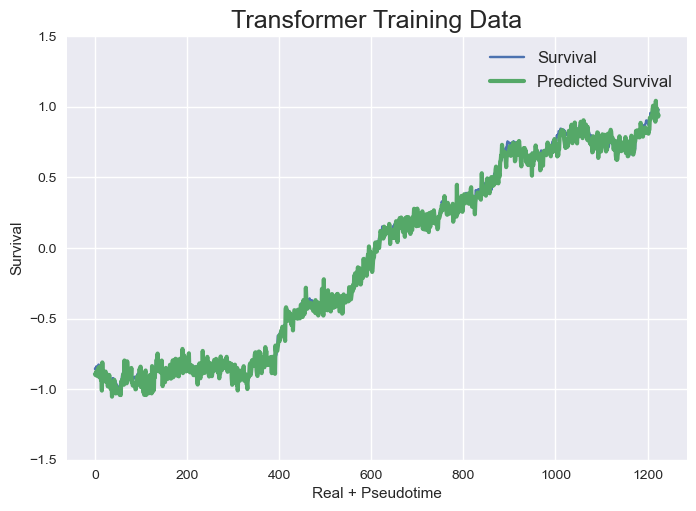

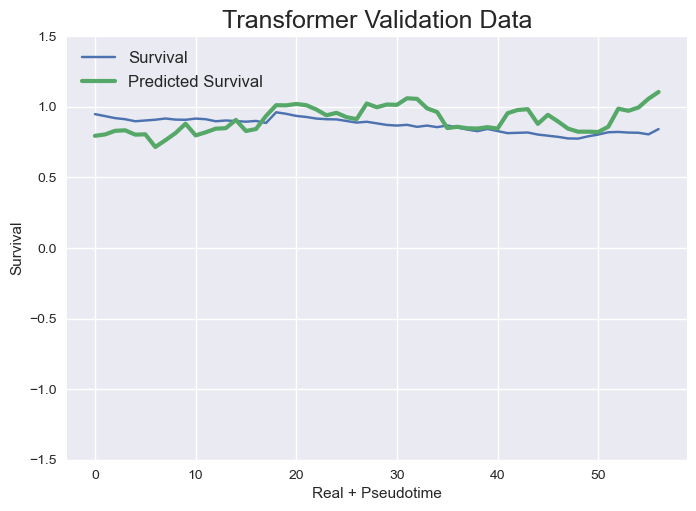

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


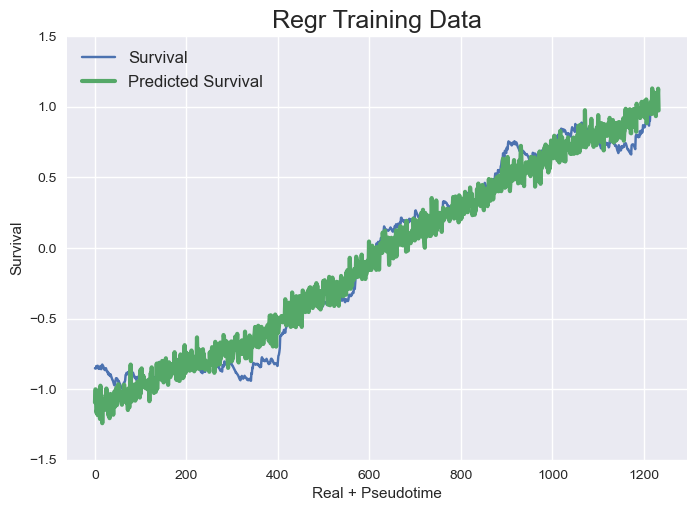

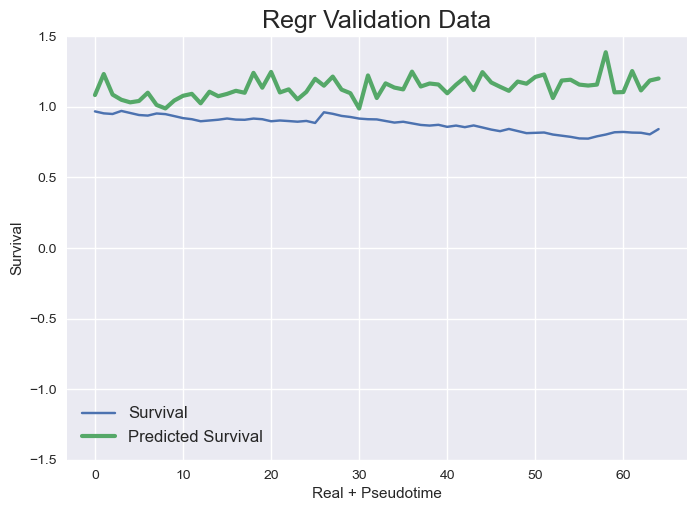

tf.Tensor(
[1.0007051  0.97746766 1.0437958  1.0259713  1.0048486  1.0179654
 0.9732504  1.029613   0.98816985 1.0030999 ], shape=(10,), dtype=float32)
{0.75: [0.002275413894065724, 0.012718349830652995, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[1.0007051  0.97746766 1.0437958  1.0259713  1.0048486  1.0179654
 0.9732504  1.029613   0.98816985 1.0030999 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.1802 - mean_squared_error: 0.1802
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 33ms/step - loss: 0.1740 - mean_squared_error: 0.1740 - val_loss: 1.6529 - val_mean_squared_error: 1.6529
Epoch 2/10
31/32 [============================>.] - ETA: 0s - loss: 0.0710 - mean_squared_error: 0.0710
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [==========

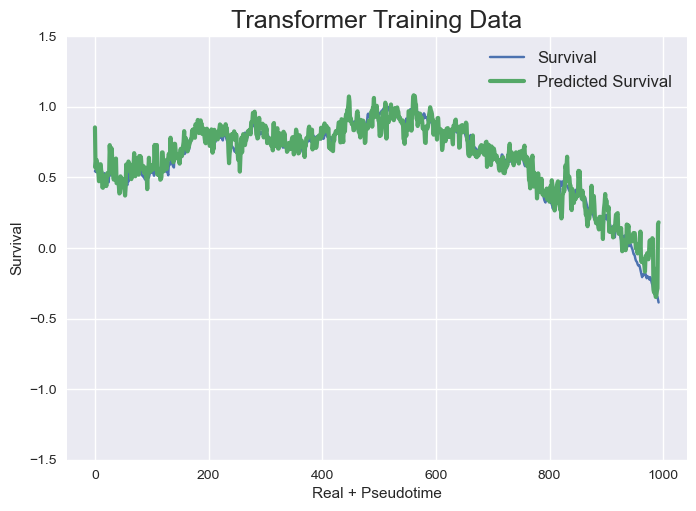

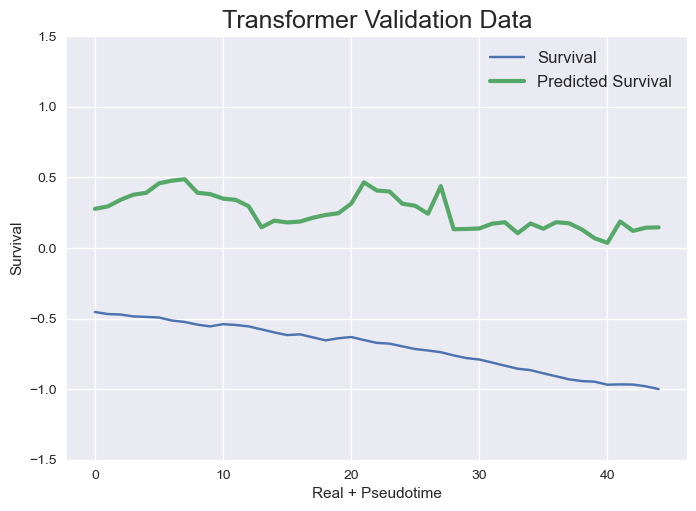

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


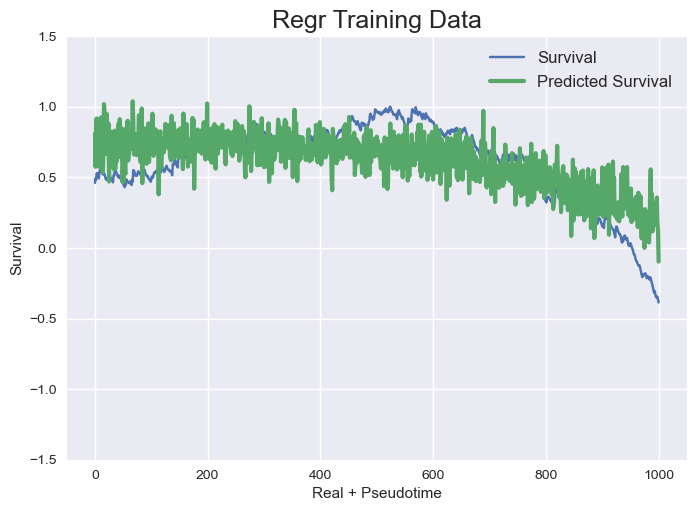

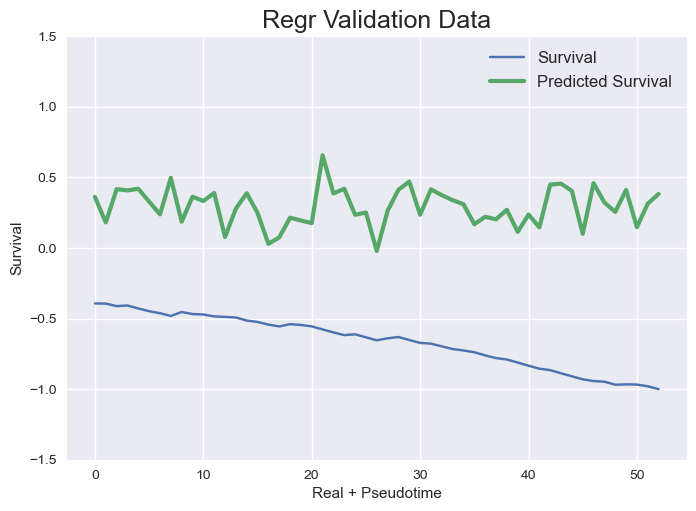

tf.Tensor(
[1.0028986  0.98492056 1.0270007  1.0043736  0.9915032  1.0086486
 0.99276036 1.022192   0.9926252  1.0513816 ], shape=(10,), dtype=float32)
{0.75: [0.005775322541314626, 0.9345006992880318, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[1.0028986  0.98492056 1.0270007  1.0043736  0.9915032  1.0086486
 0.99276036 1.022192   0.9926252  1.0513816 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.3075 - mean_squared_error: 0.3075
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 28ms/step - loss: 0.3041 - mean_squared_error: 0.3041 - val_loss: 1.0441 - val_mean_squared_error: 1.0441
Epoch 2/10
46/48 [===========================>..] - ETA: 0s - loss: 0.2560 - mean_squared_error: 0.2560
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [============

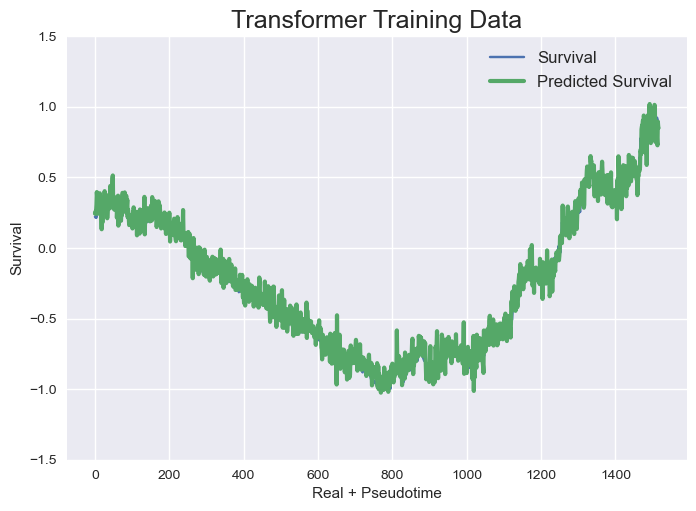

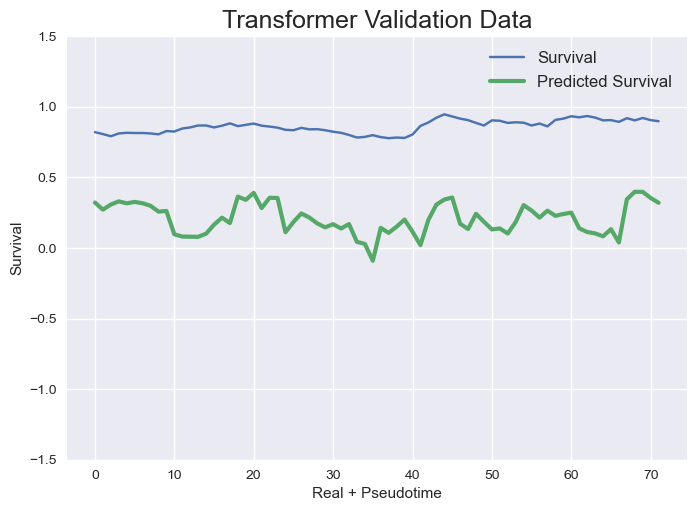

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


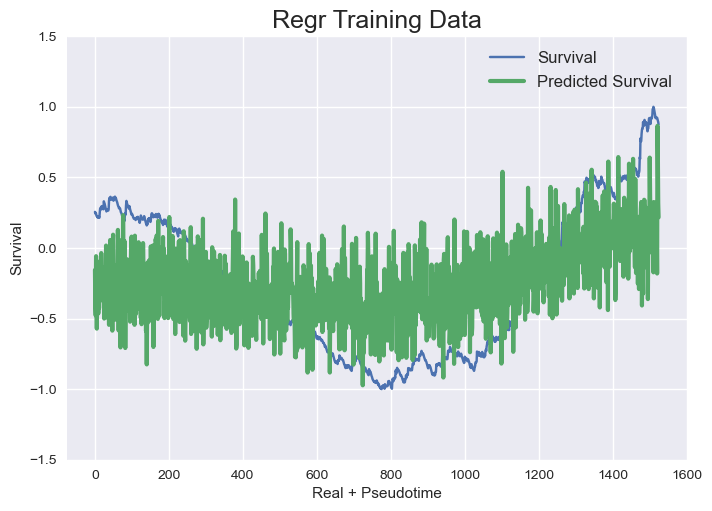

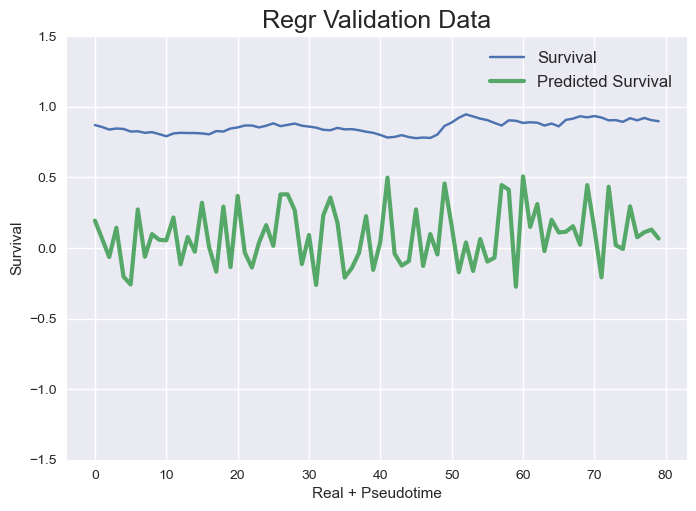

tf.Tensor(
[0.99094486 1.0163802  1.034865   1.0071372  1.0000961  1.0086309
 0.9805786  1.0540766  0.96168876 1.122986  ], shape=(10,), dtype=float32)
{0.75: [0.0047338652425224165, 0.4359699859053976, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.99094486 1.0163802  1.034865   1.0071372  1.0000961  1.0086309
 0.9805786  1.0540766  0.96168876 1.122986  ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.1171 - mean_squared_error: 0.1171
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 2s 27ms/step - loss: 0.1109 - mean_squared_error: 0.1109 - val_loss: 0.3637 - val_mean_squared_error: 0.3637
Epoch 2/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0357 - mean_squared_error: 0.0357
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [============

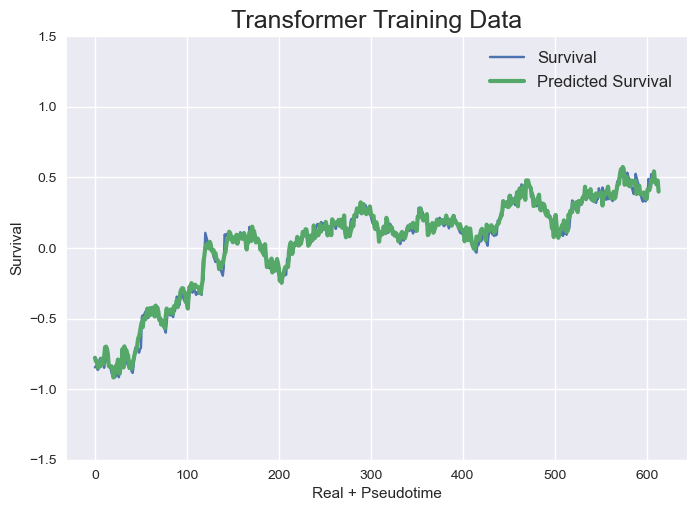

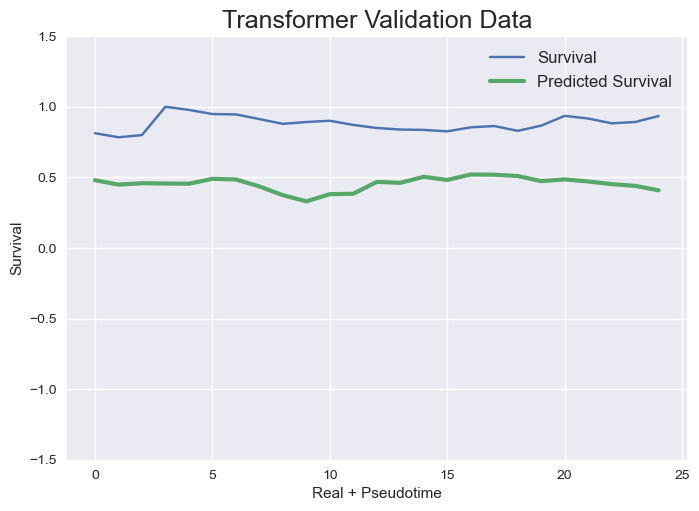

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


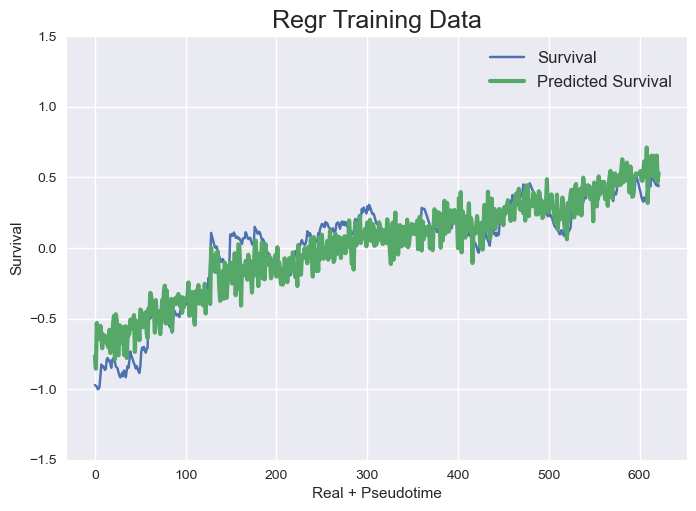

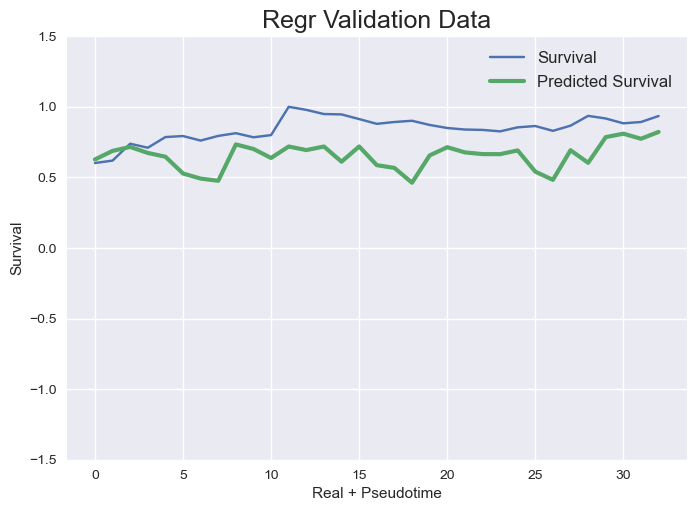

tf.Tensor(
[0.9744486  1.0069717  1.035115   1.0102631  0.9999608  1.013126
 0.9802049  1.0294346  0.96297926 1.1193694 ], shape=(10,), dtype=float32)
{0.75: [0.0018073313580704651, 0.18849440248352614, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9744486  1.0069717  1.035115   1.0102631  0.9999608  1.013126
 0.9802049  1.0294346  0.96297926 1.1193694 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.4824 - mean_squared_error: 0.4824
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 80ms/step - loss: 0.4676 - mean_squared_error: 0.4676 - val_loss: 0.0255 - val_mean_squared_error: 0.0255
Epoch 2/10
 7/10 [====================>.........] - ETA: 0s - loss: 0.2999 - mean_squared_error: 0.2999
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [===========

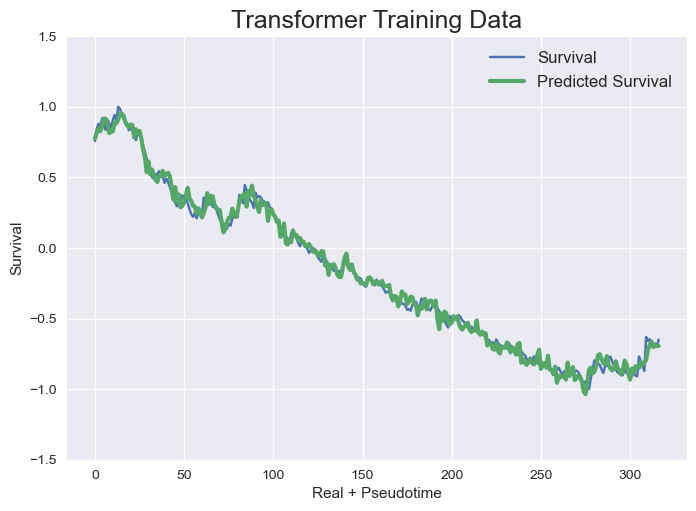

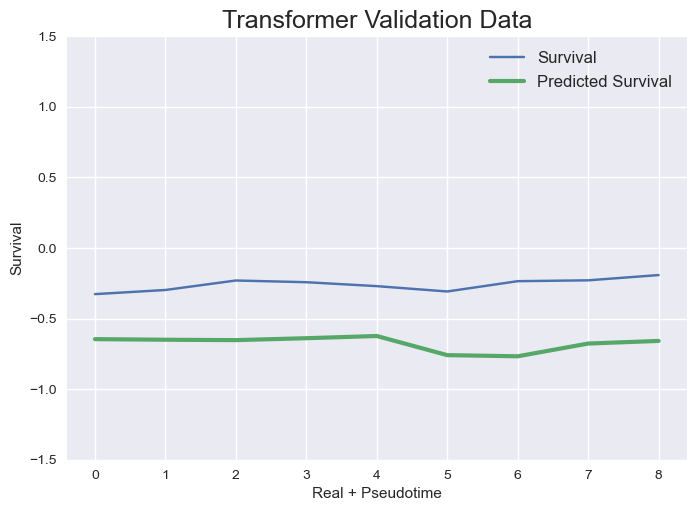

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


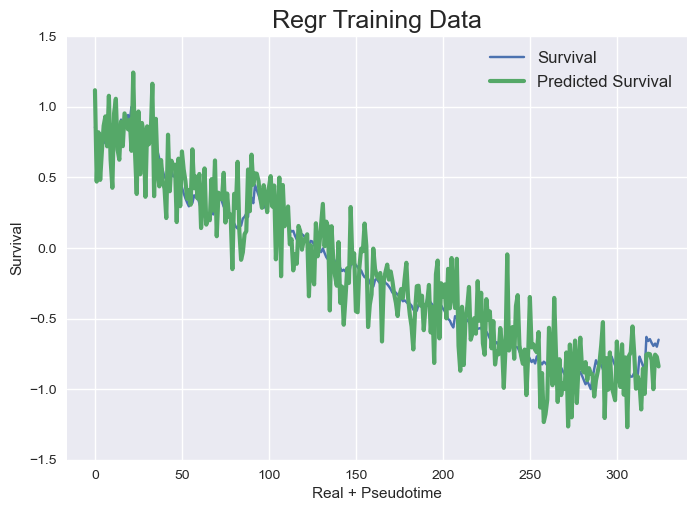

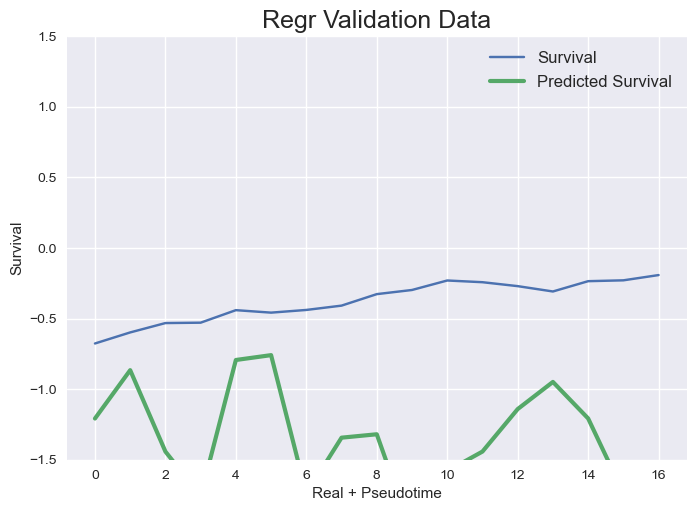

tf.Tensor(
[0.9765989  1.0227563  1.0364623  1.007958   0.98718166 1.0110321
 0.97814417 1.054993   0.95685166 1.1511077 ], shape=(10,), dtype=float32)
{0.75: [0.002310442380724704, 0.1767864748070231, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9765989  1.0227563  1.0364623  1.007958   0.98718166 1.0110321
 0.97814417 1.054993   0.95685166 1.1511077 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.3303 - mean_squared_error: 0.3303
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 79ms/step - loss: 0.3239 - mean_squared_error: 0.3239 - val_loss: 0.0427 - val_mean_squared_error: 0.0427
Epoch 2/10
 7/10 [====================>.........] - ETA: 0s - loss: 0.2418 - mean_squared_error: 0.2418
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==============

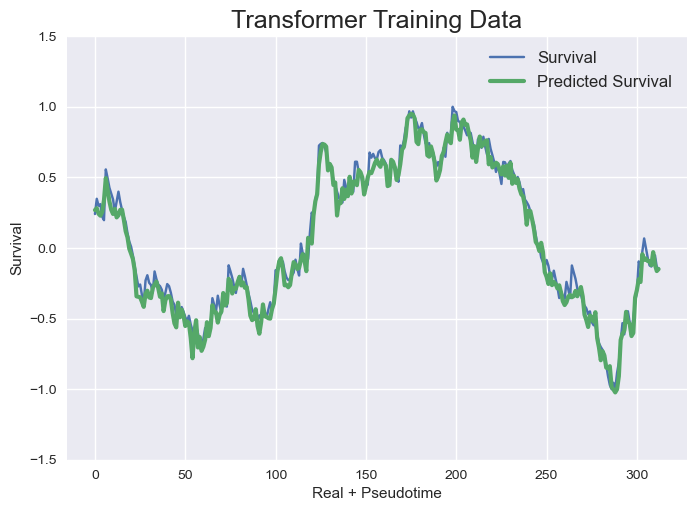

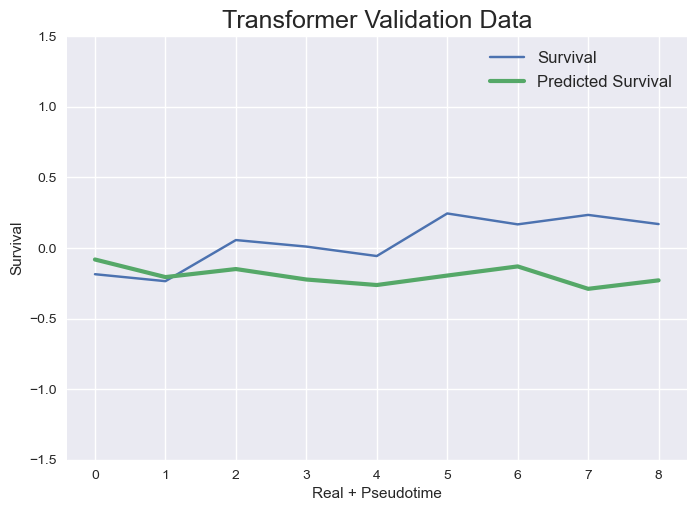

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


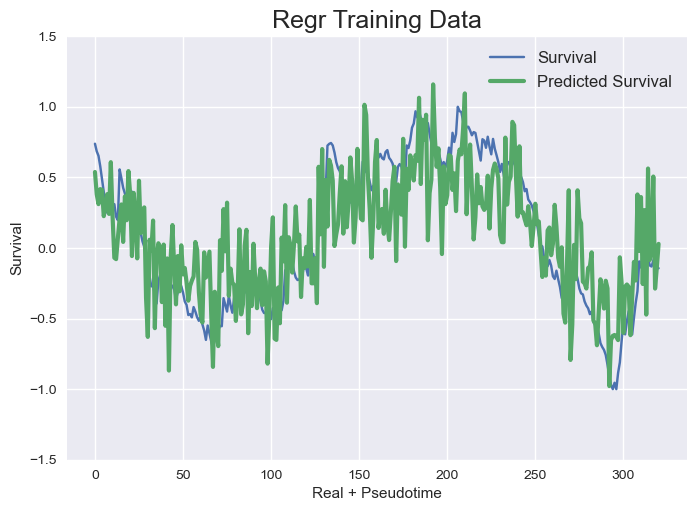

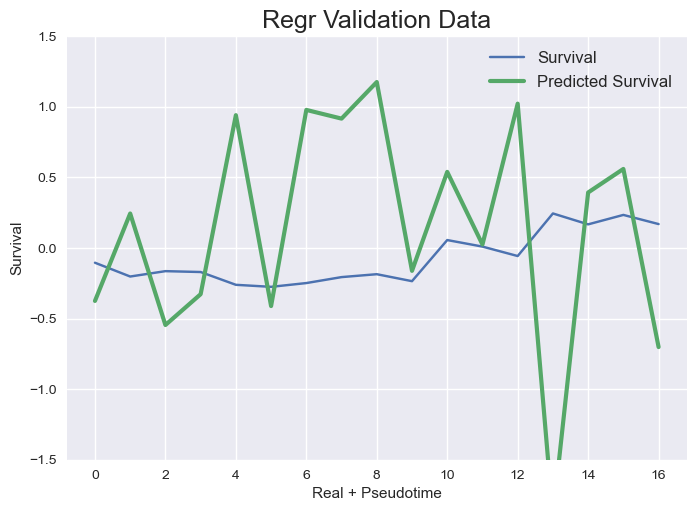

tf.Tensor(
[0.9669521  1.0196604  1.0317702  1.0095251  0.9786574  1.0095302
 0.97919154 1.038732   0.9504178  1.1565638 ], shape=(10,), dtype=float32)
{0.75: [0.005183144910371862, 0.09619265648699586, 0.09963663912416548, 0.7911836007528895]}
1 
 1 
 1



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.9669521  1.0196604  1.0317702  1.0095251  0.9786574  1.0095302
 0.97919154 1.038732   0.9504178  1.1565638 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.1799 - mean_squared_error: 0.1799
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 66ms/step - loss: 0.1568 - mean_squared_error: 0.1568 - val_loss: 0.5249 - val_mean_squared_error: 0.5249
Epoch 2/10
11/12 [==========================>...] - ETA: 0s - loss: 0.0342 - mean_squared_error: 0.0342
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [==

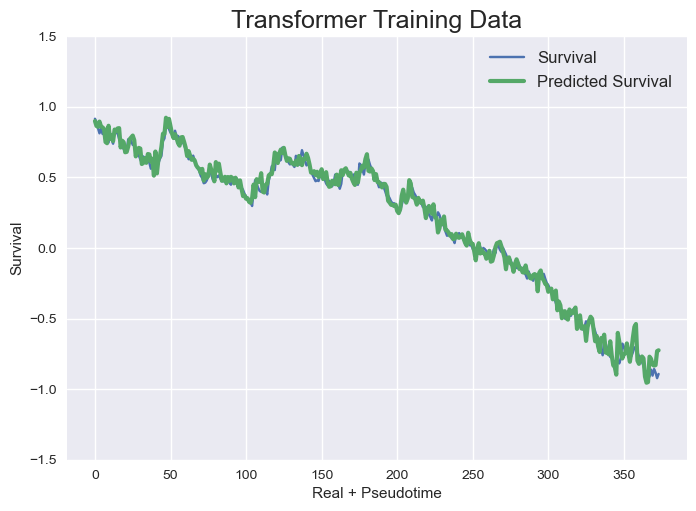

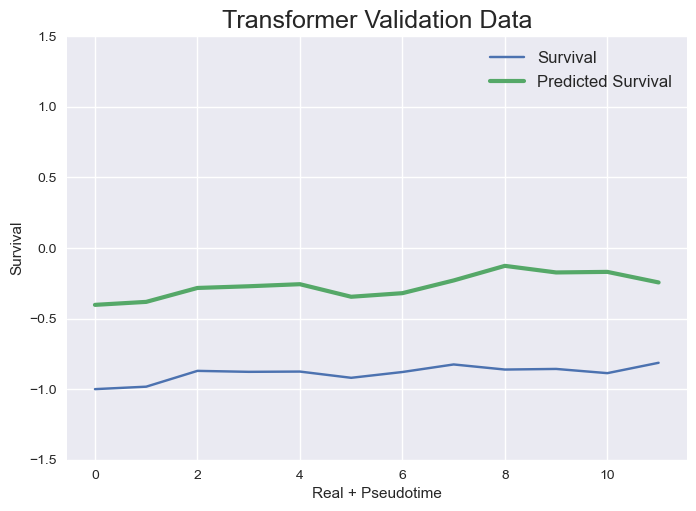

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


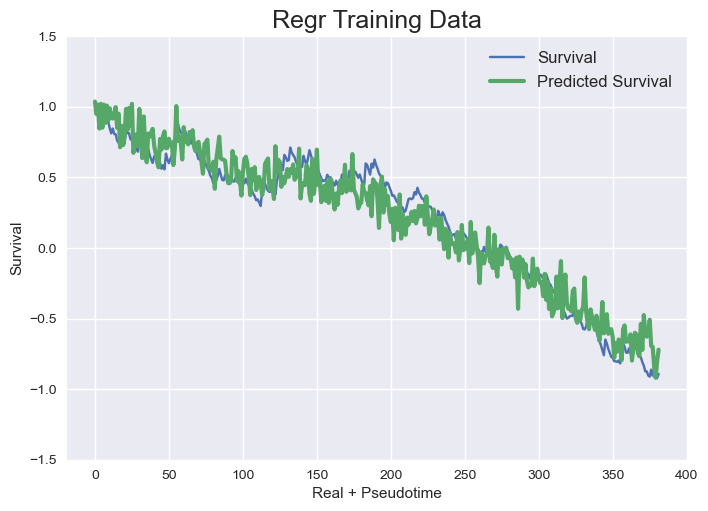

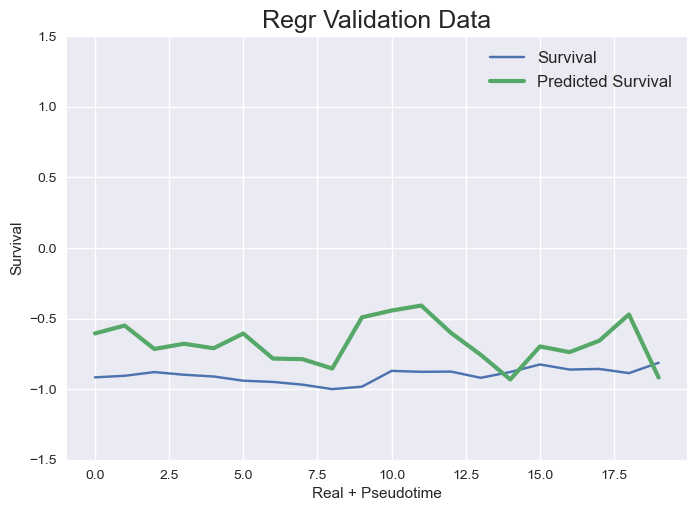

tf.Tensor(
[0.9494849  1.0087249  1.0377688  1.0253631  0.9971825  1.0123055
 0.9745121  1.0408453  0.94705564 1.1396298 ], shape=(10,), dtype=float32)
{0.75: [0.0025409058473215137, 0.38778838621082157, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.9494849  1.0087249  1.0377688  1.0253631  0.9971825  1.0123055
 0.9745121  1.0408453  0.94705564 1.1396298 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0607 - mean_squared_error: 0.0607
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 77ms/step - loss: 0.0597 - mean_squared_error: 0.0597 - val_loss: 0.0350 - val_mean_squared_error: 0.0350
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0233 - mean_squared_error: 0.0233
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

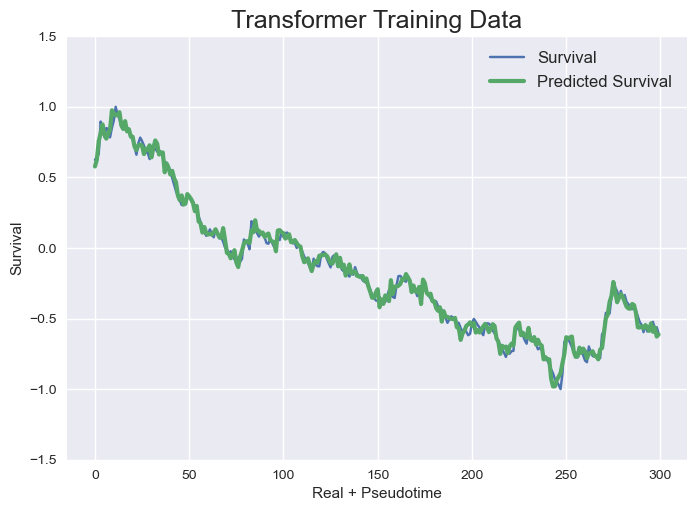

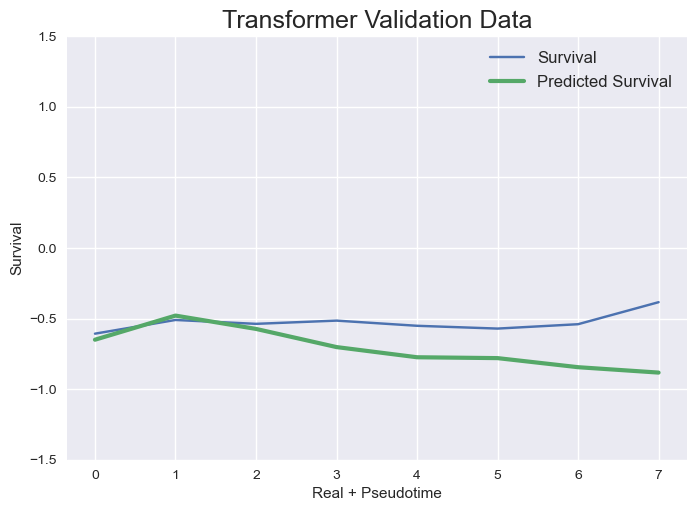

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


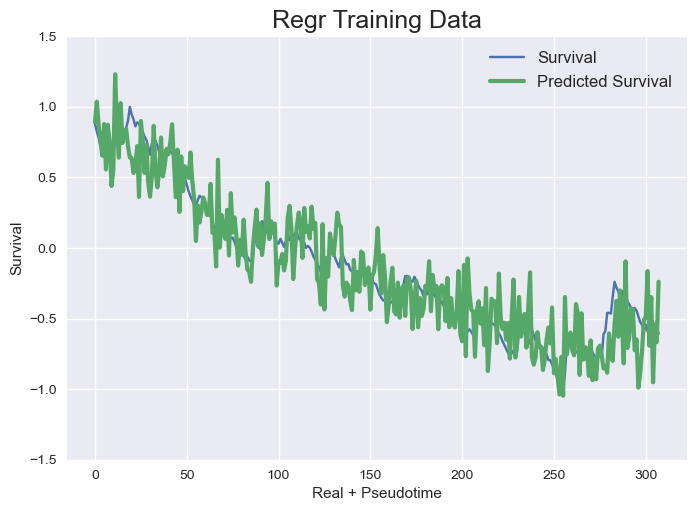

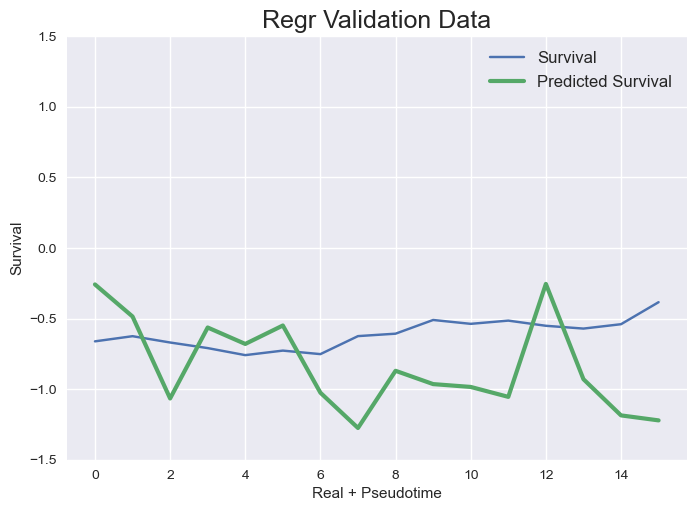

tf.Tensor(
[0.9451023 1.0036464 1.0362058 1.0304714 1.0190833 1.0123485 0.9792147
 1.0530257 0.9486254 1.1402217], shape=(10,), dtype=float32)
{0.75: [0.0017316665743025387, 0.059276185973389996, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.9451023 1.0036464 1.0362058 1.0304714 1.0190833 1.0123485 0.9792147
 1.0530257 0.9486254 1.1402217], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.1007 - mean_squared_error: 0.1007
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 36ms/step - loss: 0.0954 - mean_squared_error: 0.0954 - val_loss: 0.2991 - val_mean_squared_error: 0.2991
Epoch 2/10
27/28 [===========================>..] - ETA: 0s - loss: 0.0264 - mean_squared_error: 0.0264
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [=============================

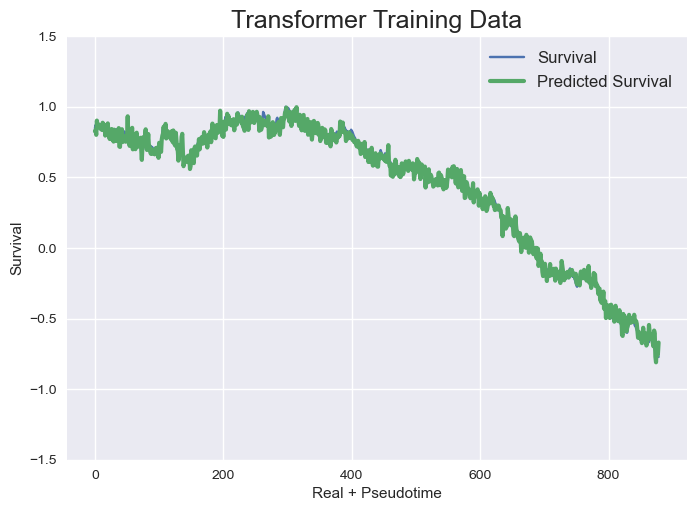

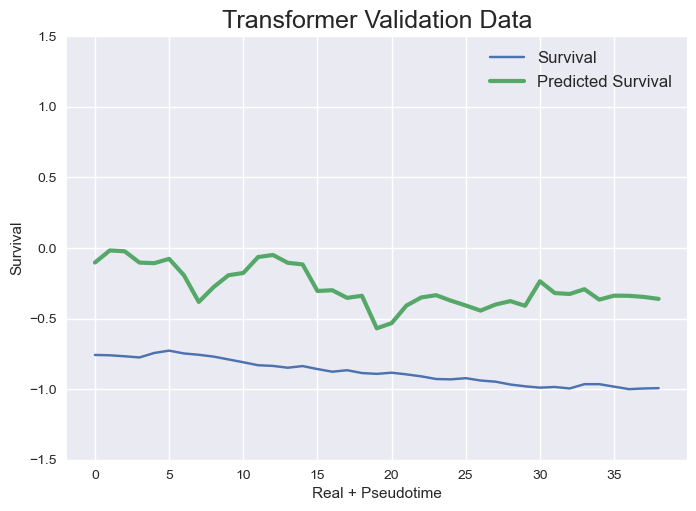

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


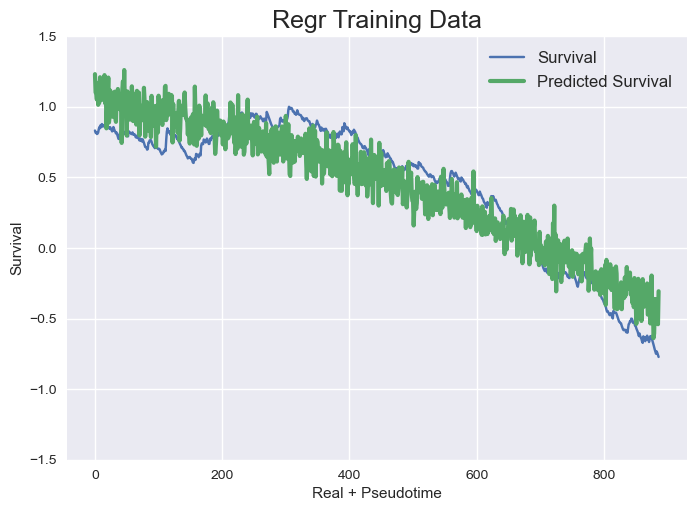

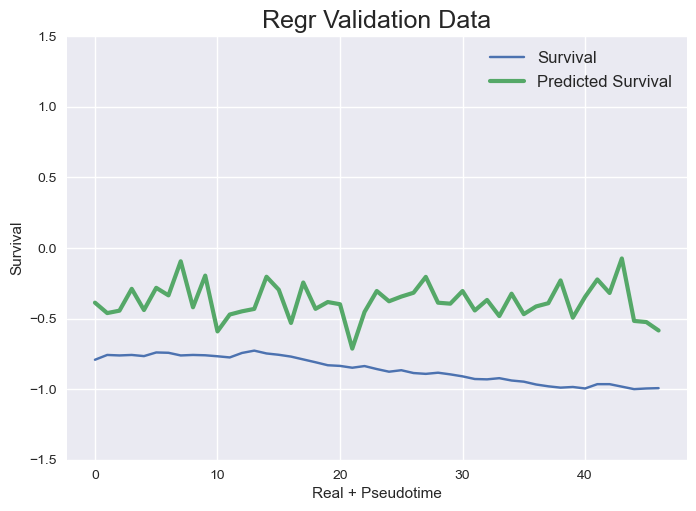

tf.Tensor(
[0.9242543 0.9964543 1.0528814 1.0467558 1.0248804 1.0172489 0.9601069
 1.054903  0.9345376 1.1407273], shape=(10,), dtype=float32)
{0.75: [0.0015631412108953807, 0.37435222010501096, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.9242543 0.9964543 1.0528814 1.0467558 1.0248804 1.0172489 0.9601069
 1.054903  0.9345376 1.1407273], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.4829 - mean_squared_error: 0.4829
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 23ms/step - loss: 0.4718 - mean_squared_error: 0.4718 - val_loss: 0.2645 - val_mean_squared_error: 0.2645
Epoch 2/10
36/39 [==========================>...] - ETA: 0s - loss: 0.0475 - mean_squared_error: 0.0475
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [============================

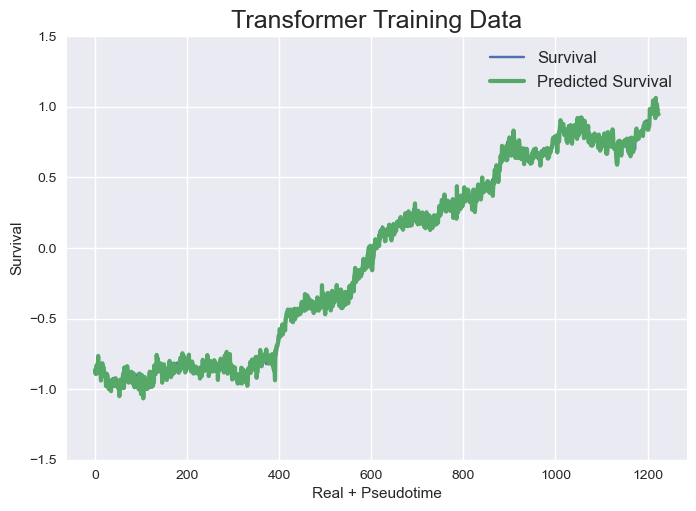

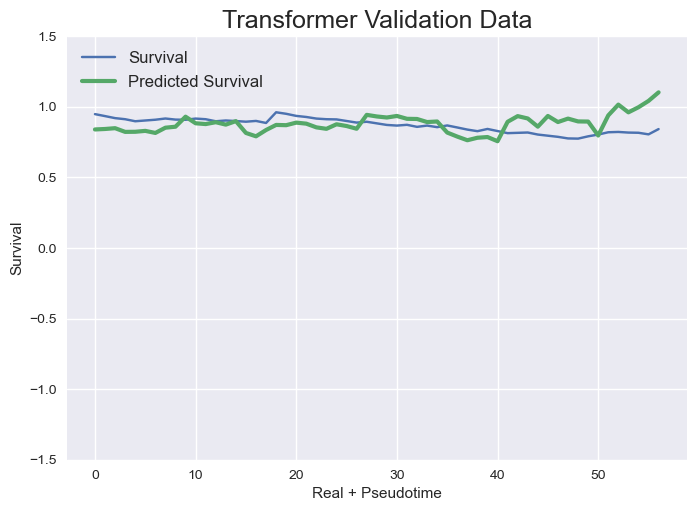

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


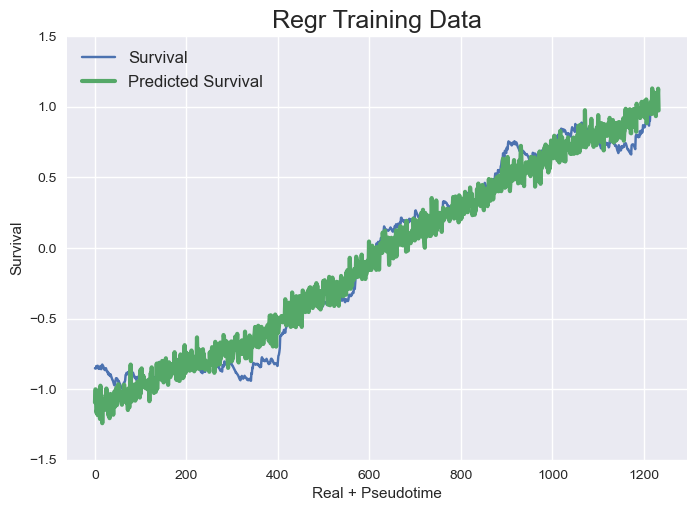

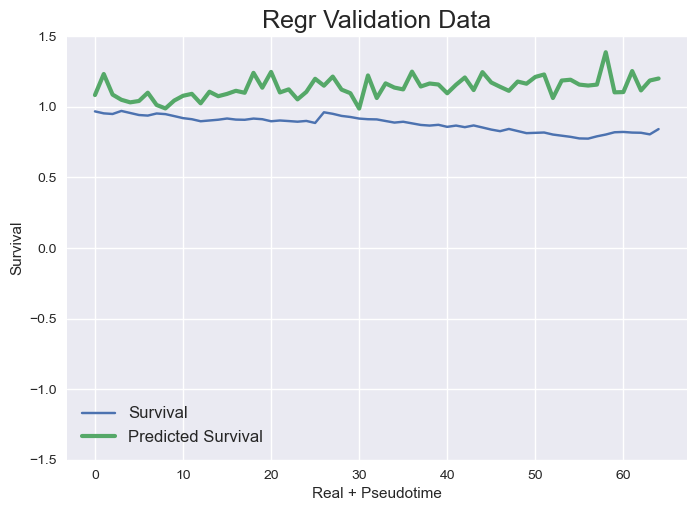

tf.Tensor(
[0.92028415 1.0077826  1.0208868  1.0111322  0.9895183  0.997324
 0.9597922  1.0408795  0.9231279  1.1567023 ], shape=(10,), dtype=float32)
{0.75: [0.0014706245247851867, 0.008715010146588896, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.92028415 1.0077826  1.0208868  1.0111322  0.9895183  0.997324
 0.9597922  1.0408795  0.9231279  1.1567023 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.1317 - mean_squared_error: 0.1317
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 24ms/step - loss: 0.1274 - mean_squared_error: 0.1274 - val_loss: 1.7551 - val_mean_squared_error: 1.7551
Epoch 2/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0460 - mean_squared_error: 0.0460
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [===========

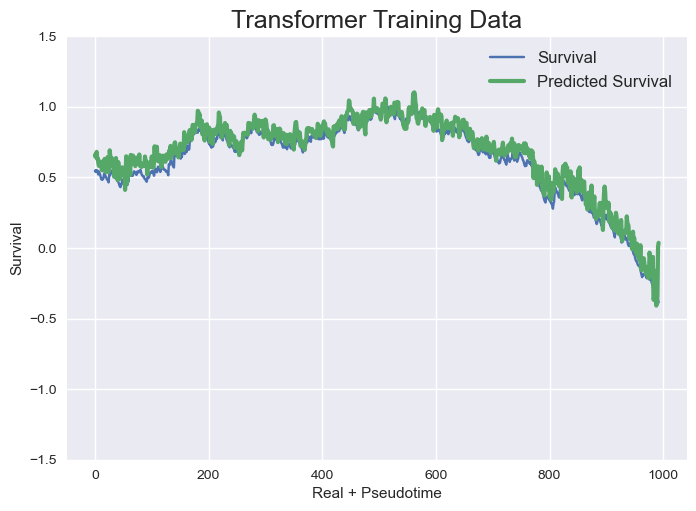

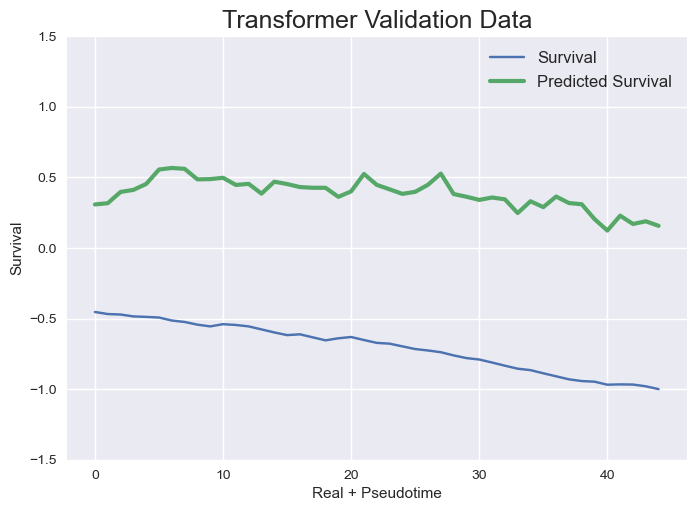

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


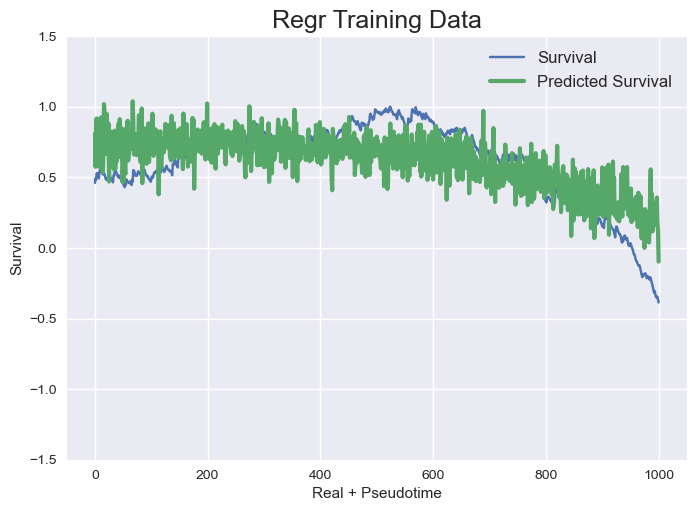

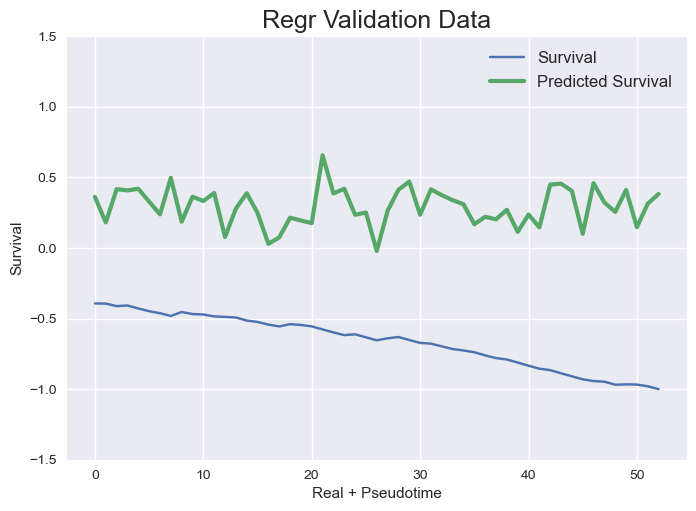

tf.Tensor(
[0.90811145 0.97579014 1.0011327  0.99371606 0.9850347  0.98299694
 0.97335154 1.0159619  0.9154604  1.1706045 ], shape=(10,), dtype=float32)
{0.75: [0.005774250634790403, 1.1902112911495983, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.90811145 0.97579014 1.0011327  0.99371606 0.9850347  0.98299694
 0.97335154 1.0159619  0.9154604  1.1706045 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.2811 - mean_squared_error: 0.2811
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 22ms/step - loss: 0.2767 - mean_squared_error: 0.2767 - val_loss: 1.0428 - val_mean_squared_error: 1.0428
Epoch 2/10
47/48 [============================>.] - ETA: 0s - loss: 0.0622 - mean_squared_error: 0.0622
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [==========

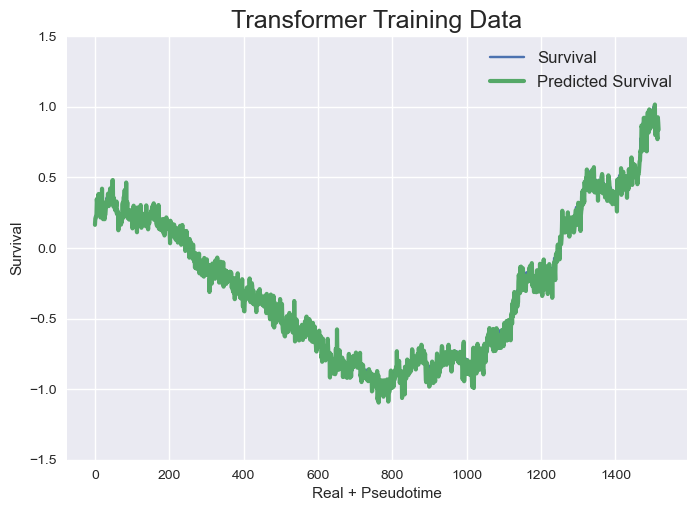

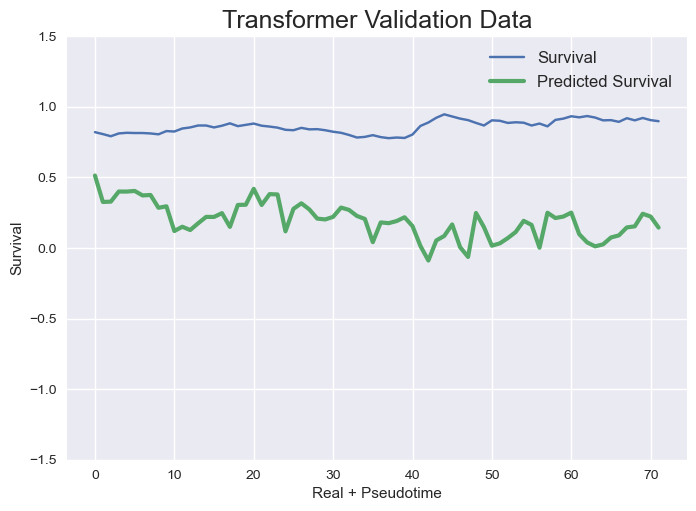

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


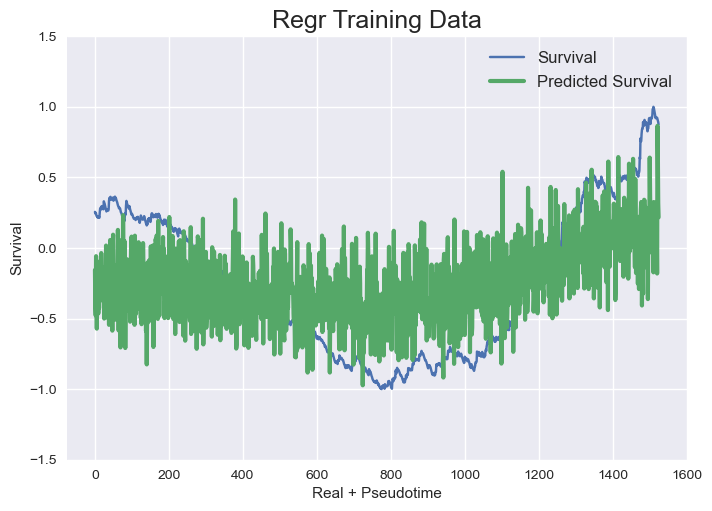

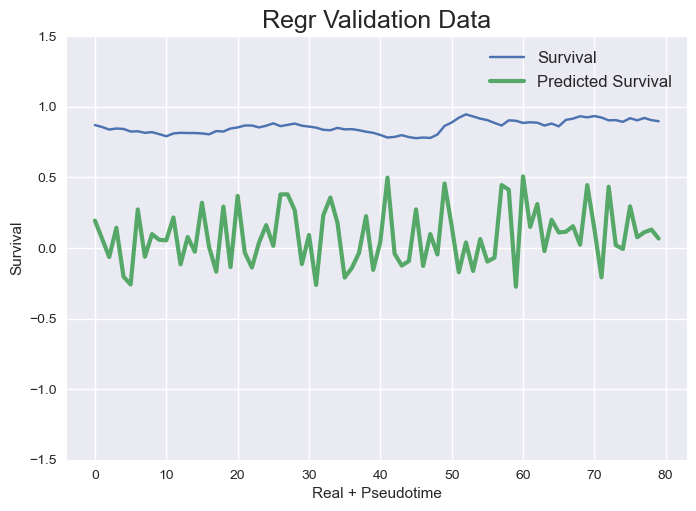

tf.Tensor(
[0.8830032  1.0010548  0.99419206 0.9803674  0.98572576 0.97280186
 0.9568554  1.072595   0.88480544 1.1800315 ], shape=(10,), dtype=float32)
{0.75: [0.002788405243829214, 0.46451920931694546, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.8830032  1.0010548  0.99419206 0.9803674  0.98572576 0.97280186
 0.9568554  1.072595   0.88480544 1.1800315 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0559 - mean_squared_error: 0.0559
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 2s 27ms/step - loss: 0.0516 - mean_squared_error: 0.0516 - val_loss: 0.1968 - val_mean_squared_error: 0.1968
Epoch 2/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0110 - mean_squared_error: 0.0110
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==========

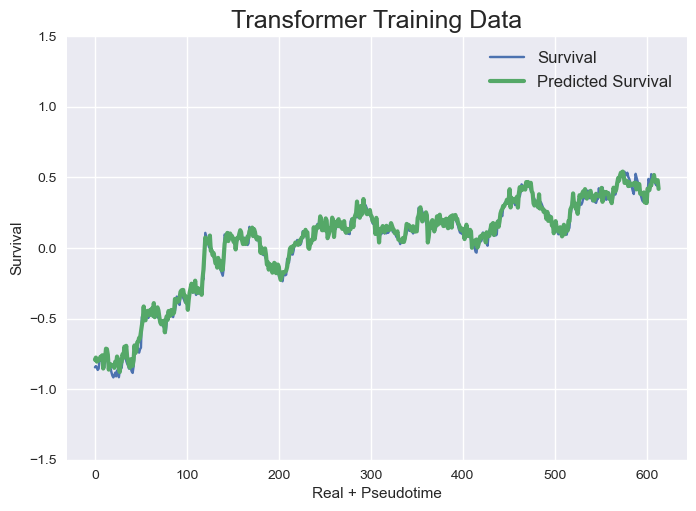

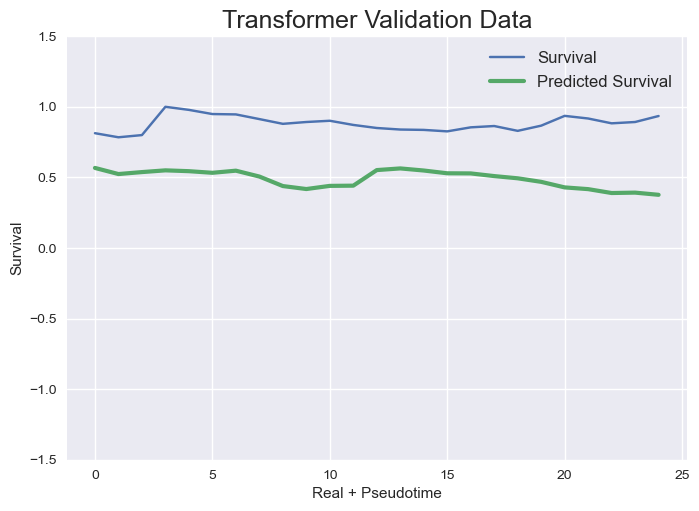

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


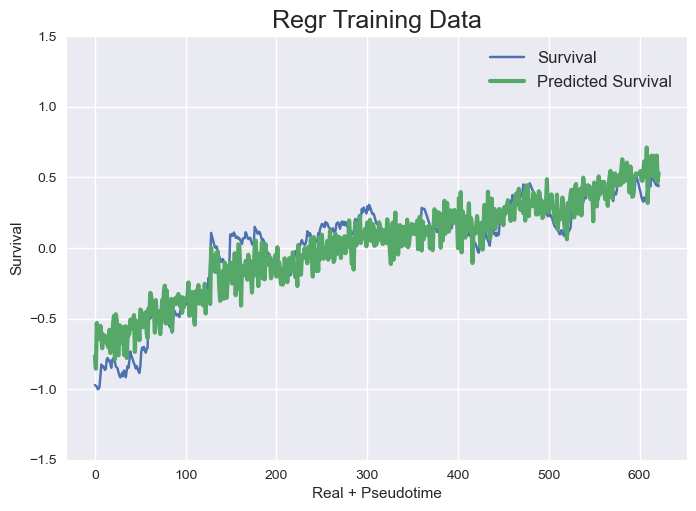

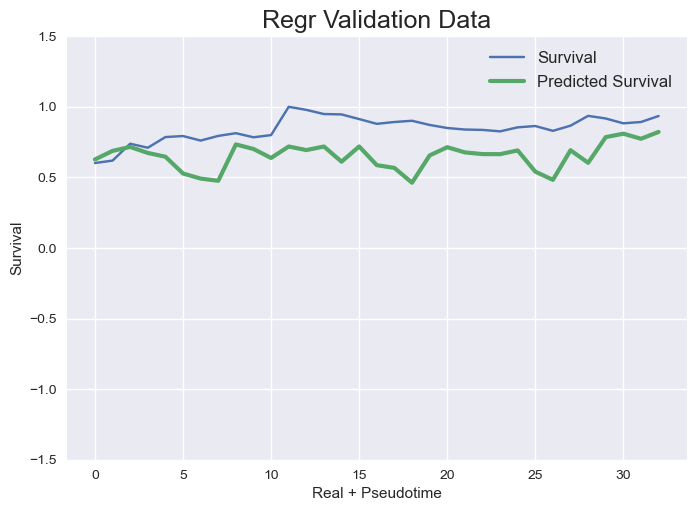

tf.Tensor(
[0.88299215 0.9837456  0.9963144  0.9811139  0.9846579  0.96846884
 0.959158   1.0431843  0.8899766  1.1724668 ], shape=(10,), dtype=float32)
{0.75: [0.0014292651822327587, 0.16222822118354407, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.88299215 0.9837456  0.9963144  0.9811139  0.9846579  0.96846884
 0.959158   1.0431843  0.8899766  1.1724668 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.3913 - mean_squared_error: 0.3913
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 75ms/step - loss: 0.3815 - mean_squared_error: 0.3815 - val_loss: 0.0194 - val_mean_squared_error: 0.0194
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.2204 - mean_squared_error: 0.2204
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=======

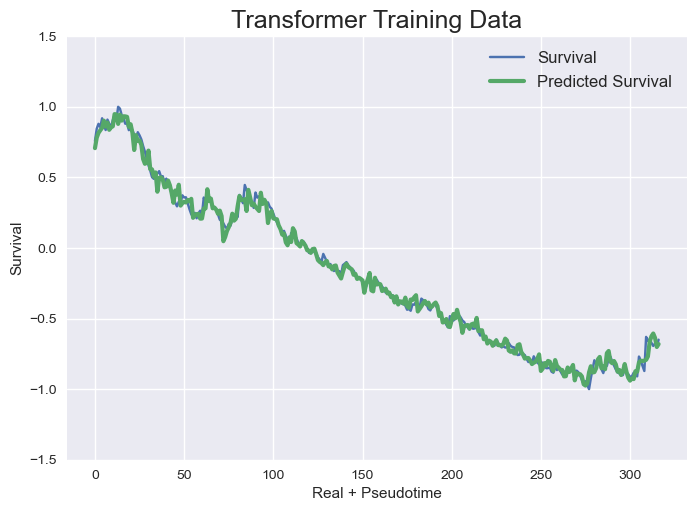

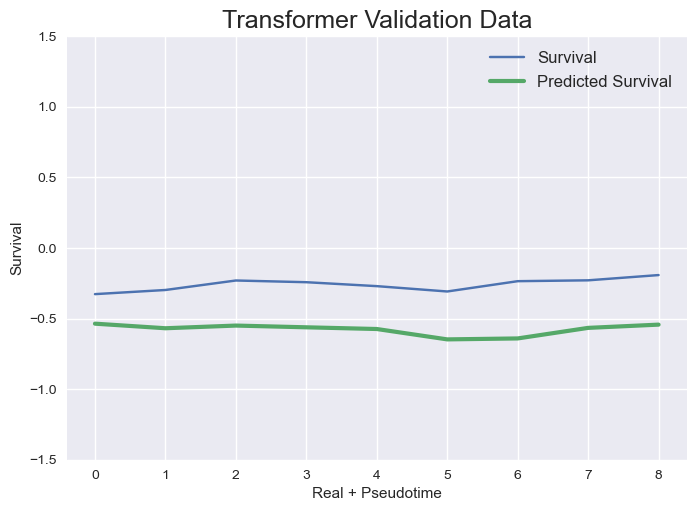

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


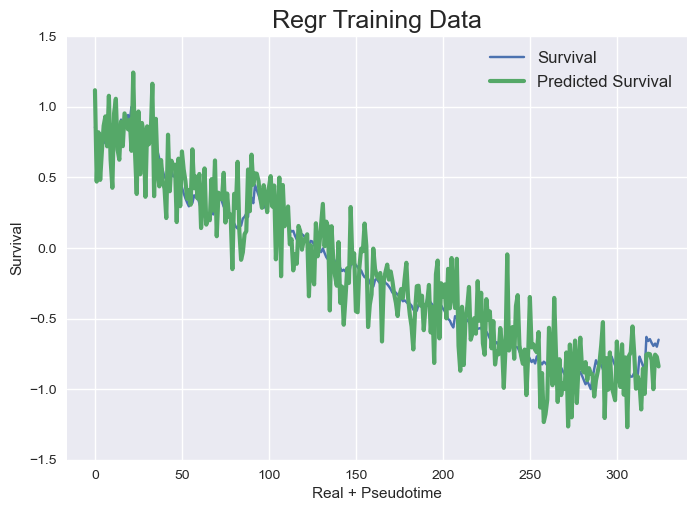

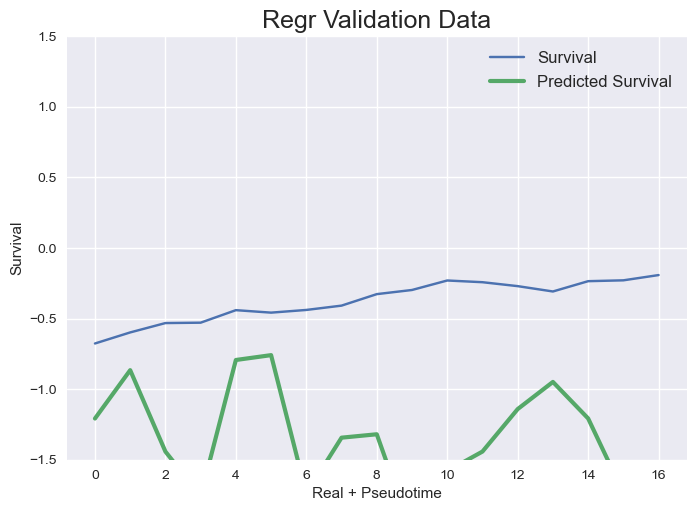

tf.Tensor(
[0.8987684  0.9962812  0.9936819  0.96589875 0.9724534  0.96135706
 0.9629411  1.0884901  0.89001924 1.185743  ], shape=(10,), dtype=float32)
{0.75: [0.0019467451754007533, 0.10332839941645615, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.8987684  0.9962812  0.9936819  0.96589875 0.9724534  0.96135706
 0.9629411  1.0884901  0.89001924 1.185743  ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.2069 - mean_squared_error: 0.2069
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 41ms/step - loss: 0.2023 - mean_squared_error: 0.2023 - val_loss: 0.0556 - val_mean_squared_error: 0.0556
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0661 - mean_squared_error: 0.0661
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

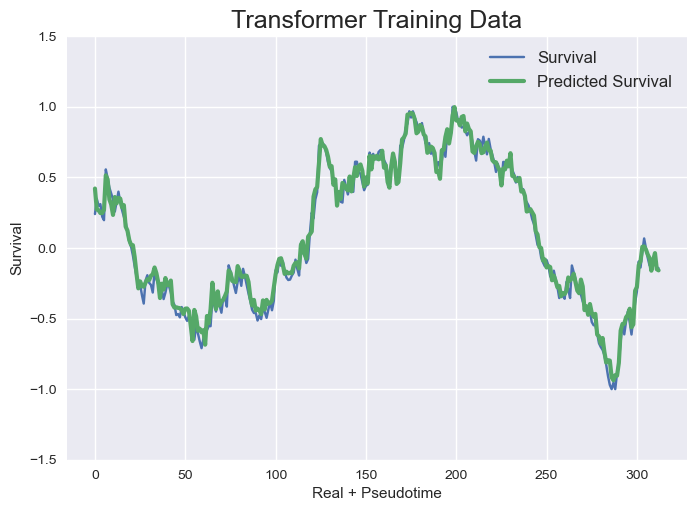

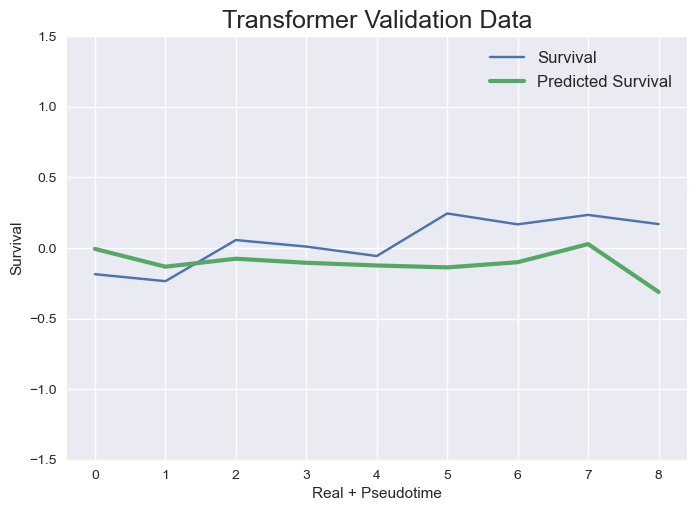

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


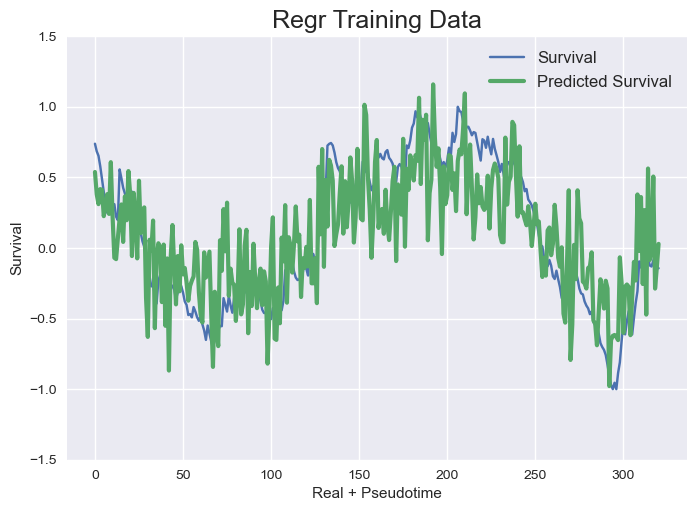

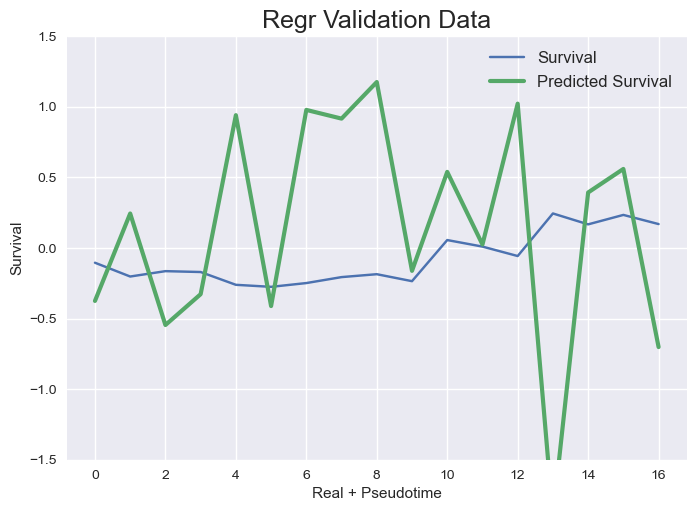

tf.Tensor(
[0.8922513  0.9749544  0.984109   0.9680036  0.9699616  0.96879834
 0.9620244  1.0521822  0.8830108  1.179649  ], shape=(10,), dtype=float32)
{0.75: [0.0035486357770702047, 0.06327698564384088, 0.09963663912416548, 0.7911836007528895]}
2 
 2 
 2



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.8922513  0.9749544  0.984109   0.9680036  0.9699616  0.96879834
 0.9620244  1.0521822  0.8830108  1.179649  ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0546 - mean_squared_error: 0.0546
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 2s 39ms/step - loss: 0.0492 - mean_squared_error: 0.0492 - val_loss: 0.6078 - val_mean_squared_error: 0.6078
Epoch 2/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0139 - mean_squared_error: 0.0139
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 

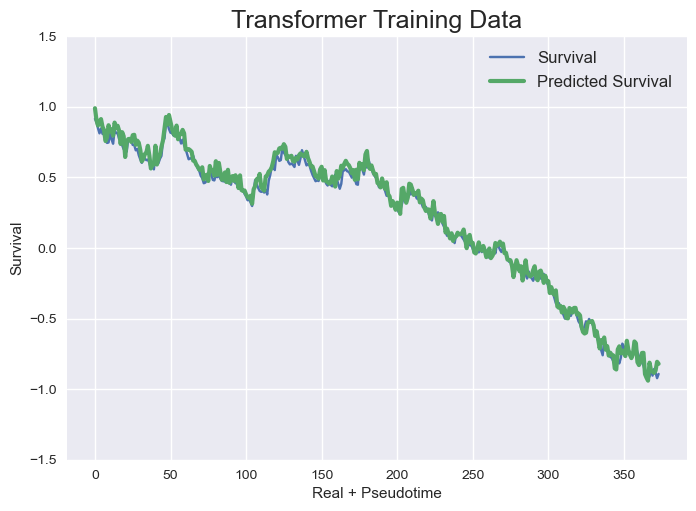

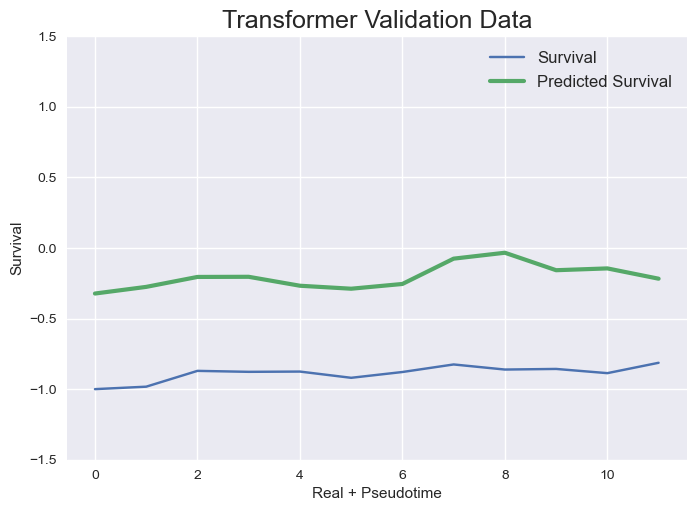

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


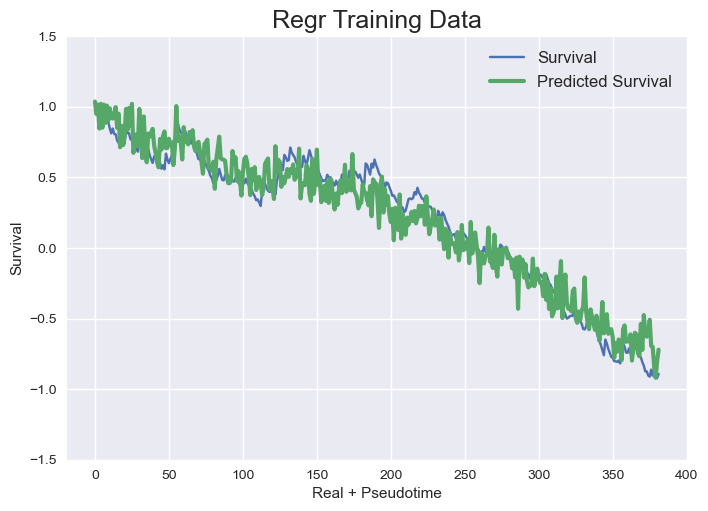

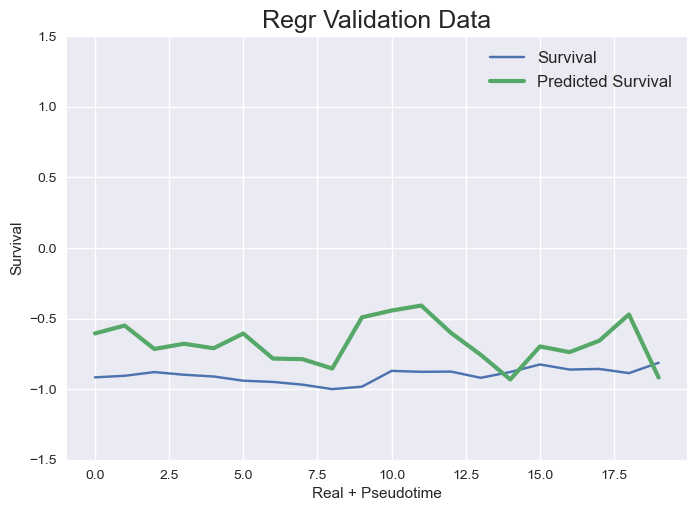

tf.Tensor(
[0.8828442  0.976307   0.98940516 0.9738136  0.9869562  0.97163004
 0.96607566 1.0566626  0.88619614 1.172726  ], shape=(10,), dtype=float32)
{0.75: [0.002306906282365397, 0.47100409112100117, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.8828442  0.976307   0.98940516 0.9738136  0.9869562  0.97163004
 0.96607566 1.0566626  0.88619614 1.172726  ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0317 - mean_squared_error: 0.0317
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 81ms/step - loss: 0.0311 - mean_squared_error: 0.0311 - val_loss: 0.0179 - val_mean_squared_error: 0.0179
Epoch 2/10
 7/10 [====================>.........] - ETA: 0s - loss: 0.0120 - mean_squared_error: 0.0120
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=========

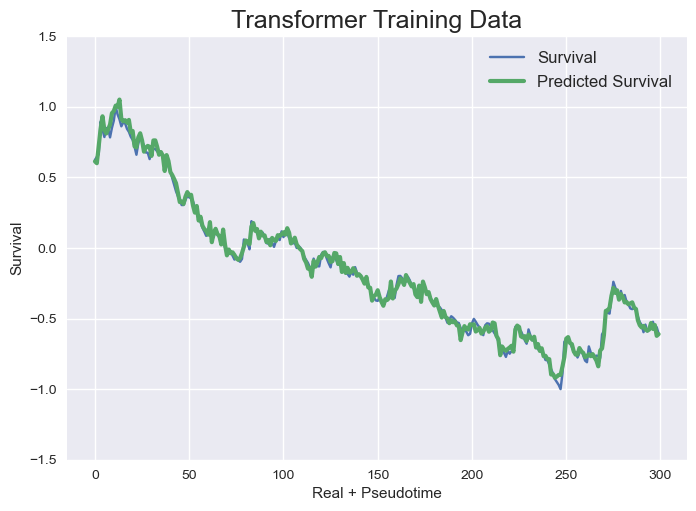

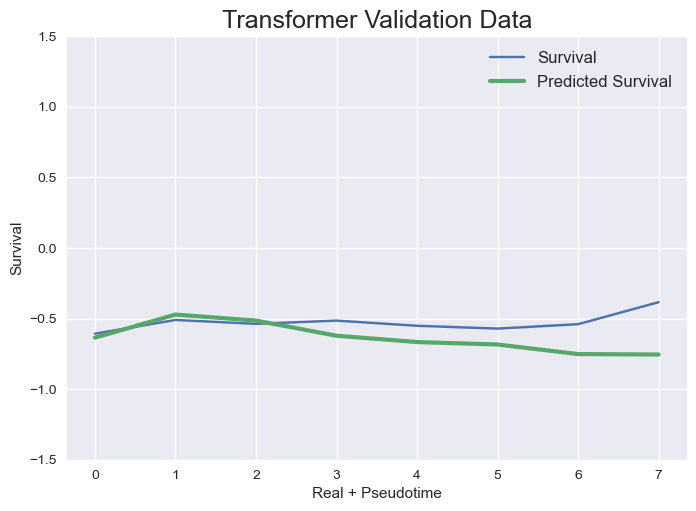

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


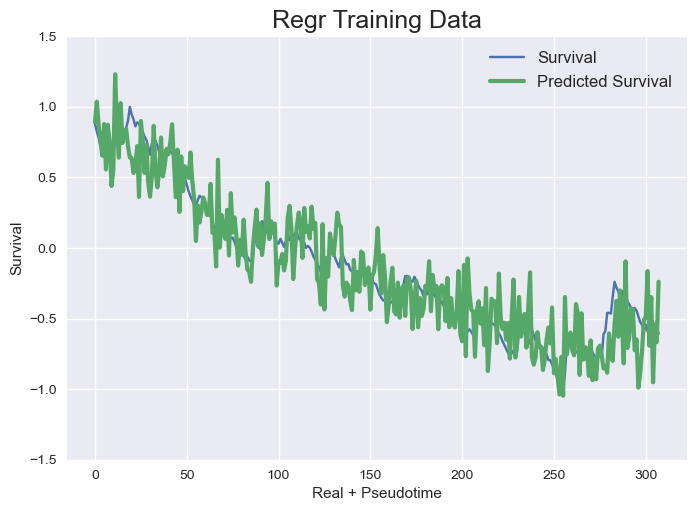

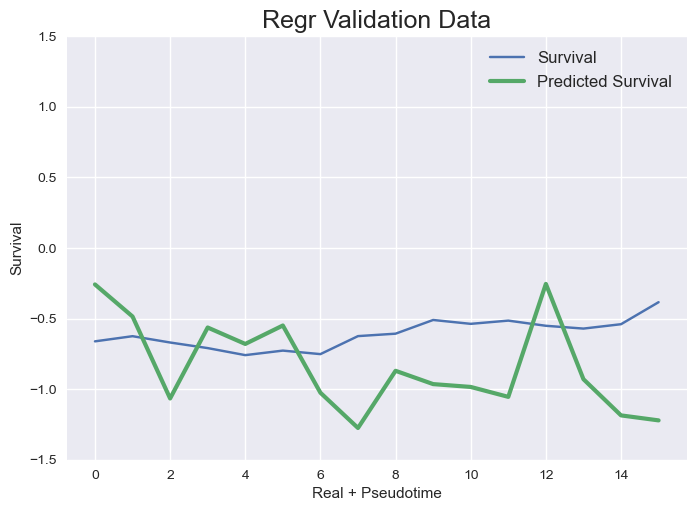

tf.Tensor(
[0.8802565  0.97142    0.98908895 0.97108704 0.9971832  0.9715493
 0.9669248  1.0551722  0.89069176 1.1686556 ], shape=(10,), dtype=float32)
{0.75: [0.0013877380592047114, 0.027805282154809697, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.8802565  0.97142    0.98908895 0.97108704 0.9971832  0.9715493
 0.9669248  1.0551722  0.89069176 1.1686556 ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0661 - mean_squared_error: 0.0661
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 35ms/step - loss: 0.0624 - mean_squared_error: 0.0624 - val_loss: 0.4470 - val_mean_squared_error: 0.4470
Epoch 2/10
28/28 [==============================] - ETA: 0s - loss: 0.0158 - mean_squared_error: 0.0158
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [===========

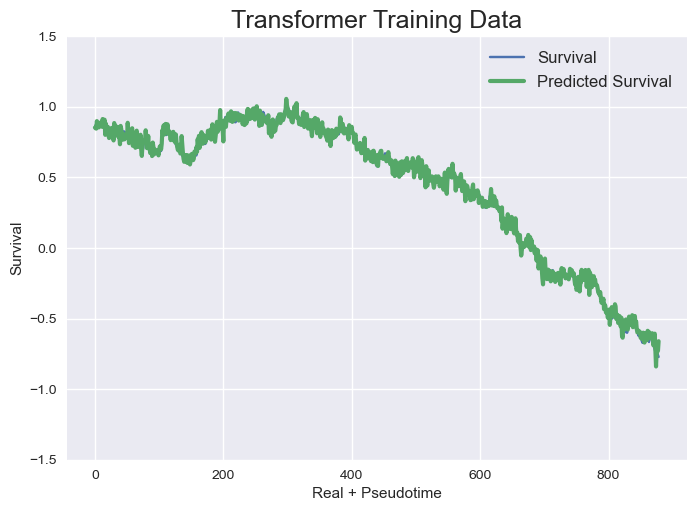

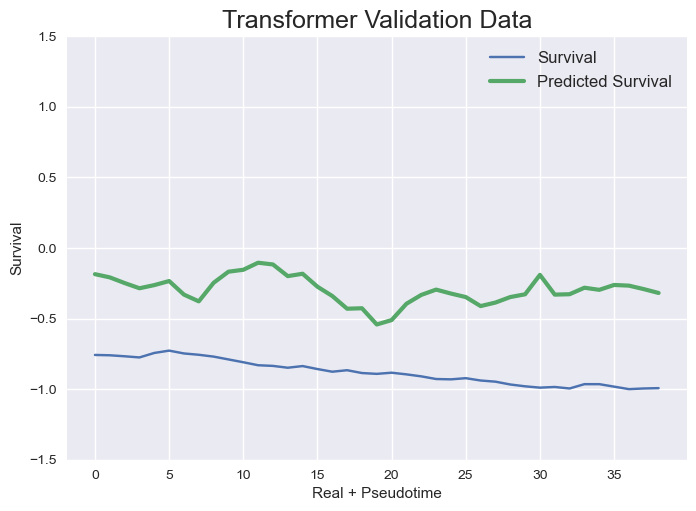

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


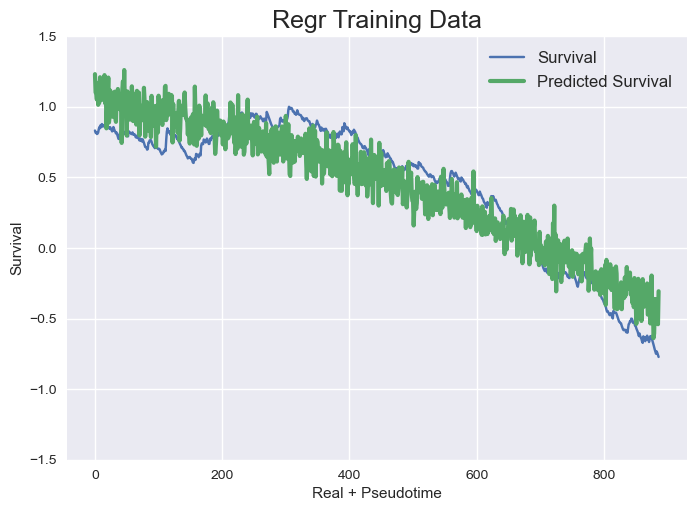

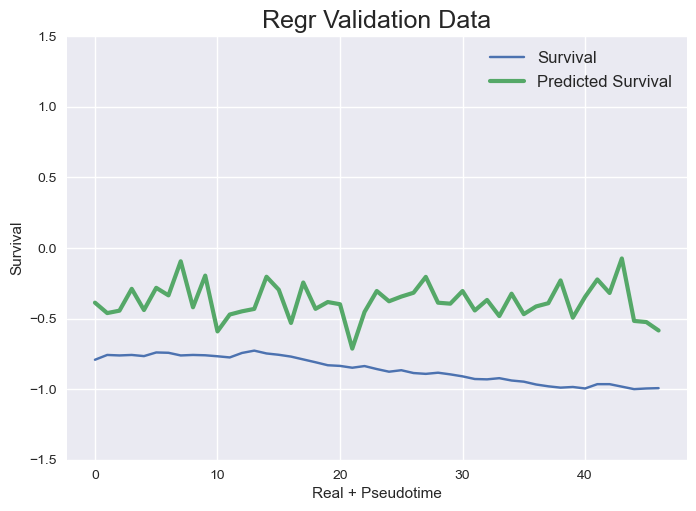

tf.Tensor(
[0.8725982  0.97726005 1.005319   0.9849116  1.0046216  0.988269
 0.96157664 1.0813943  0.8798221  1.1619743 ], shape=(10,), dtype=float32)
{0.75: [0.001259114135095031, 0.3517704535772829, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.8725982  0.97726005 1.005319   0.9849116  1.0046216  0.988269
 0.96157664 1.0813943  0.8798221  1.1619743 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.4528 - mean_squared_error: 0.4528
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 42ms/step - loss: 0.4410 - mean_squared_error: 0.4410 - val_loss: 0.1394 - val_mean_squared_error: 0.1394
Epoch 2/10
36/39 [==========================>...] - ETA: 0s - loss: 0.0398 - mean_squared_error: 0.0398
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [==============

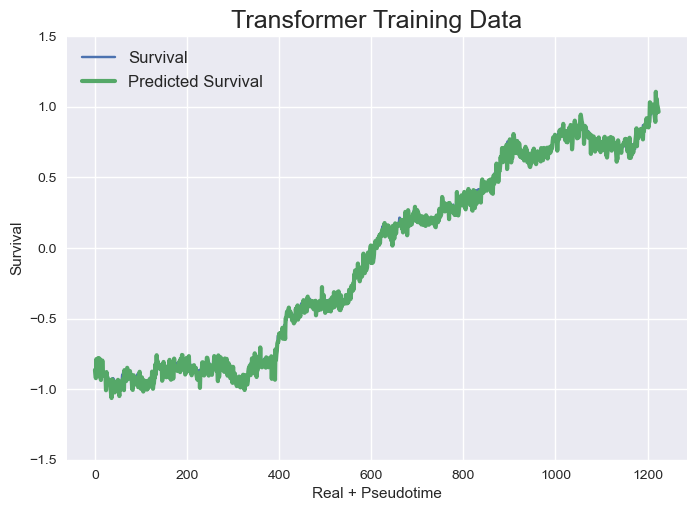

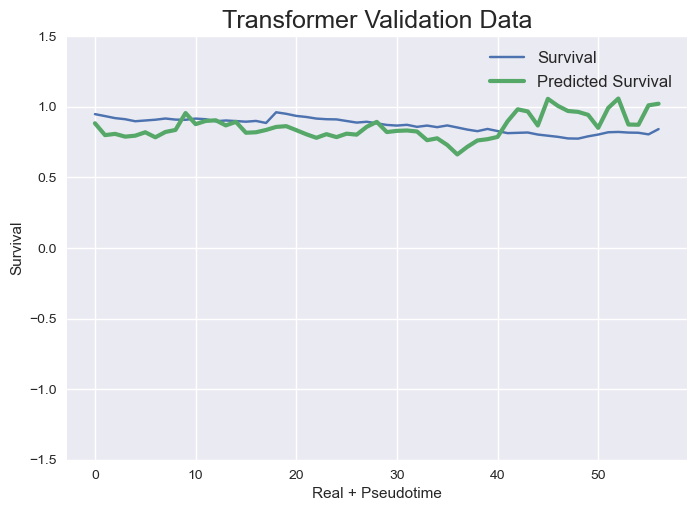

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


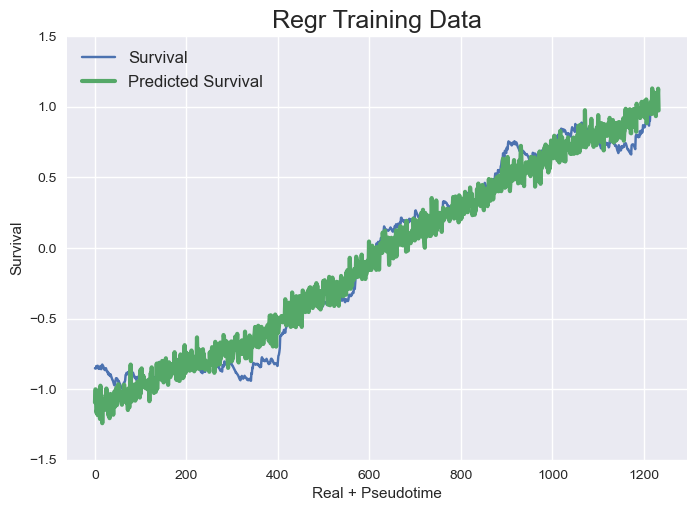

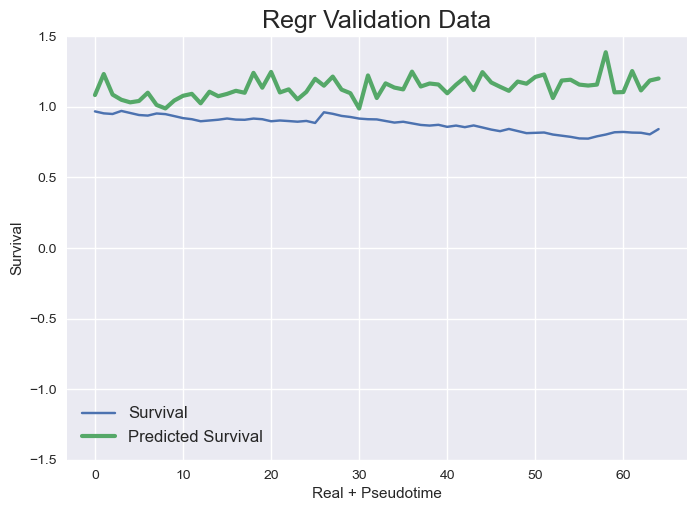

tf.Tensor(
[0.8693517  0.95484525 0.97111547 0.950398   0.9780046  0.9774542
 0.9895835  1.0552377  0.86988485 1.1855844 ], shape=(10,), dtype=float32)
{0.75: [0.0015495107159721503, 0.013549786418495935, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.8693517  0.95484525 0.97111547 0.950398   0.9780046  0.9774542
 0.9895835  1.0552377  0.86988485 1.1855844 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.1200 - mean_squared_error: 0.1200
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 32ms/step - loss: 0.1164 - mean_squared_error: 0.1164 - val_loss: 1.8545 - val_mean_squared_error: 1.8545
Epoch 2/10
31/32 [============================>.] - ETA: 0s - loss: 0.0367 - mean_squared_error: 0.0367
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [=========

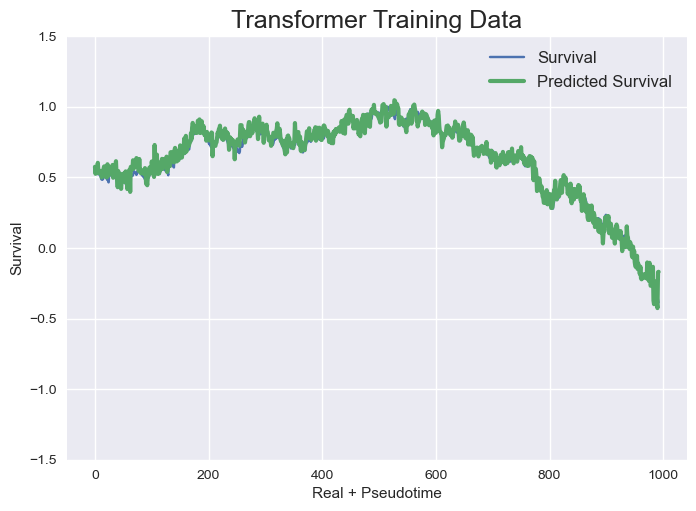

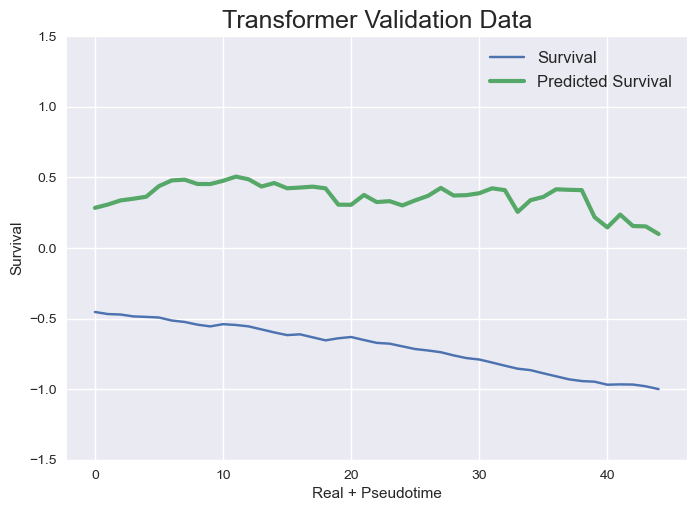

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


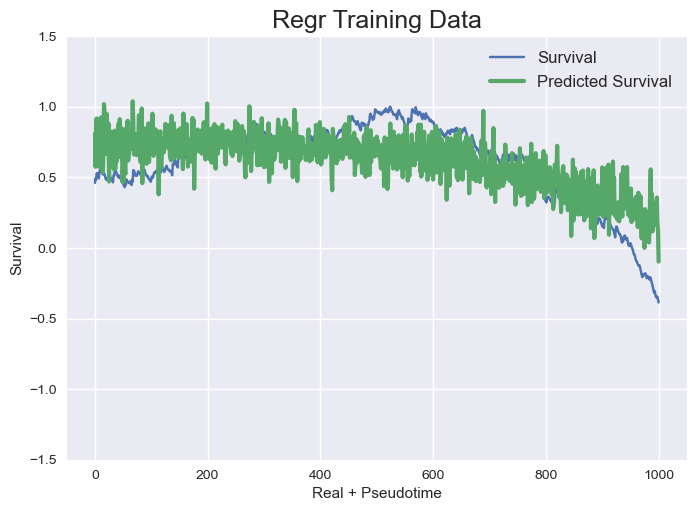

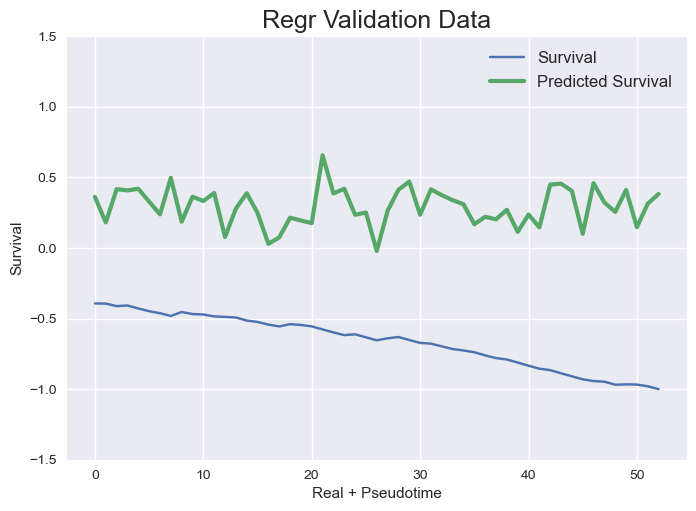

tf.Tensor(
[0.8682014  0.9333146  0.9602694  0.9345168  0.97030026 0.9647771
 0.9974208  1.0357364  0.8645849  1.2006369 ], shape=(10,), dtype=float32)
{0.75: [0.0019359182721688684, 1.1539540704125182, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.8682014  0.9333146  0.9602694  0.9345168  0.97030026 0.9647771
 0.9974208  1.0357364  0.8645849  1.2006369 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.1997 - mean_squared_error: 0.1997
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 27ms/step - loss: 0.1923 - mean_squared_error: 0.1923 - val_loss: 0.4702 - val_mean_squared_error: 0.4702
Epoch 2/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0310 - mean_squared_error: 0.0310
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [===========

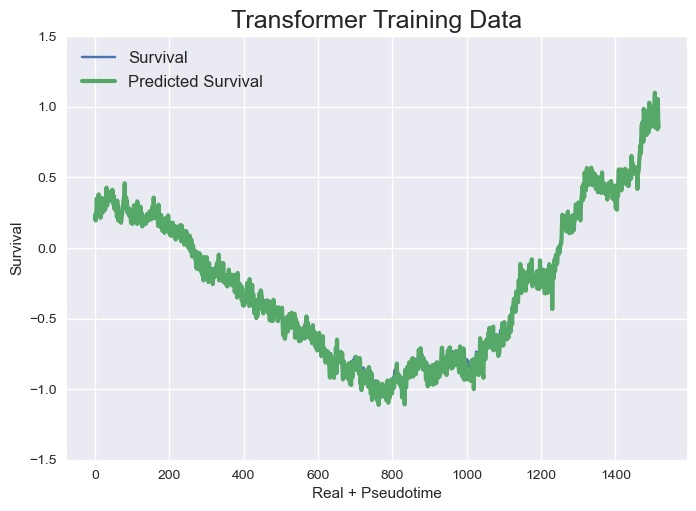

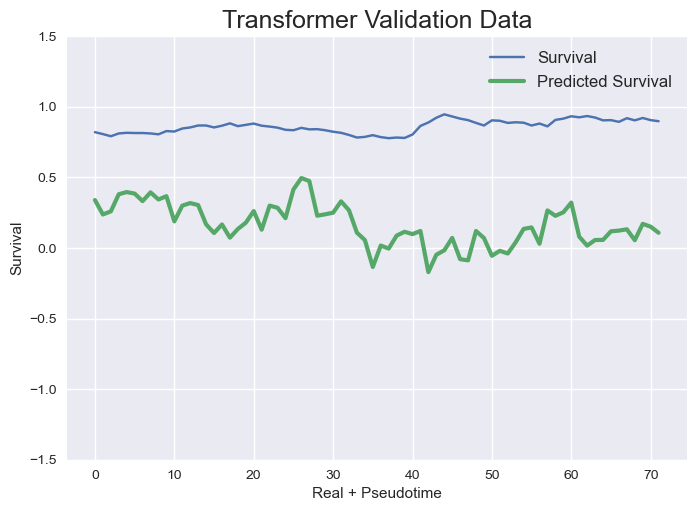

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


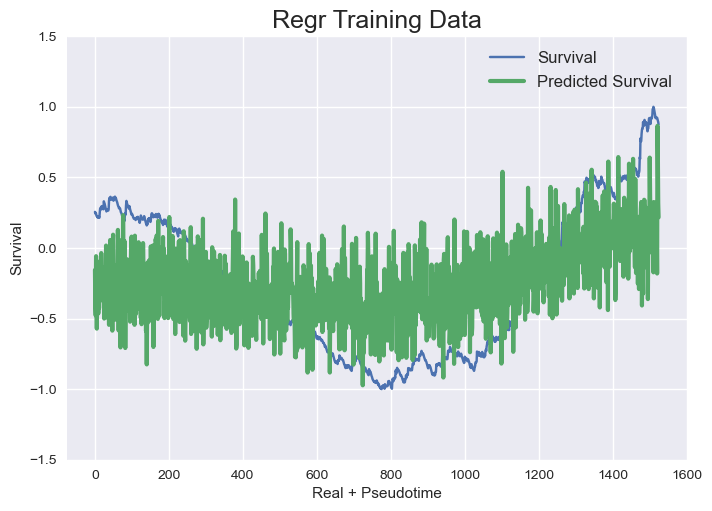

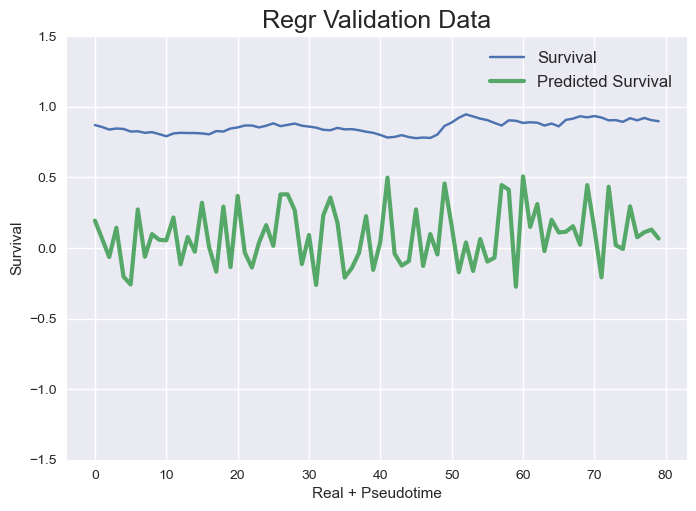

tf.Tensor(
[0.8723427  0.9380115  0.9592361  0.9323929  0.9881843  0.95826244
 0.972686   1.060376   0.84511054 1.2439091 ], shape=(10,), dtype=float32)
{0.75: [0.0026676050659815717, 0.5111512988625759, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.8723427  0.9380115  0.9592361  0.9323929  0.9881843  0.95826244
 0.972686   1.060376   0.84511054 1.2439091 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0335 - mean_squared_error: 0.0335
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 3s 45ms/step - loss: 0.0306 - mean_squared_error: 0.0306 - val_loss: 0.1319 - val_mean_squared_error: 0.1319
Epoch 2/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0063 - mean_squared_error: 0.0063
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==========

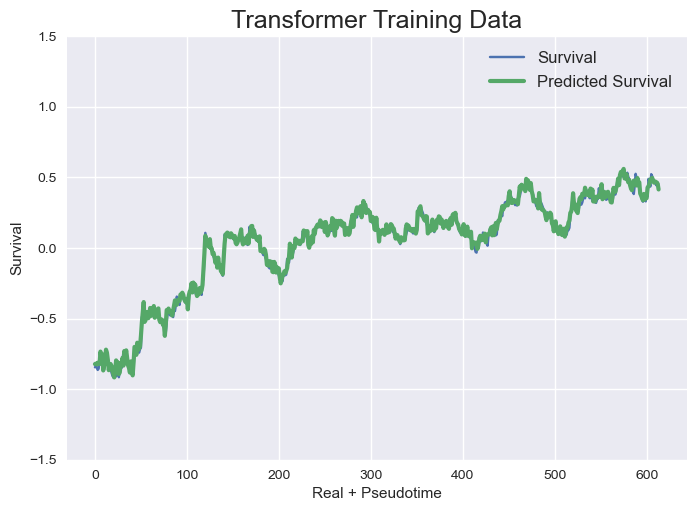

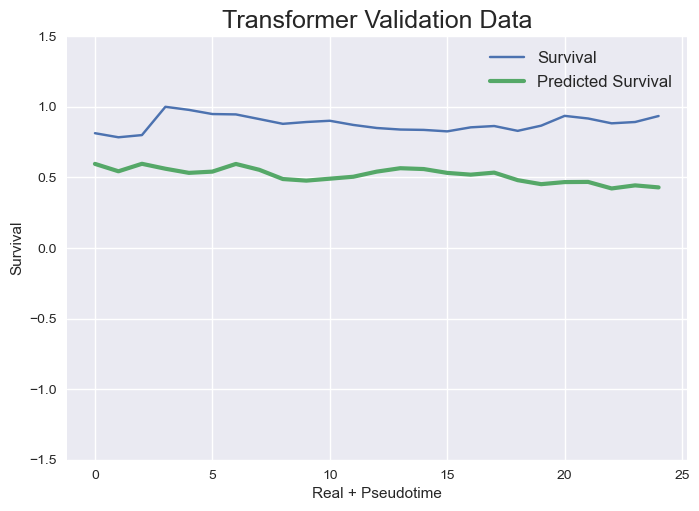

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


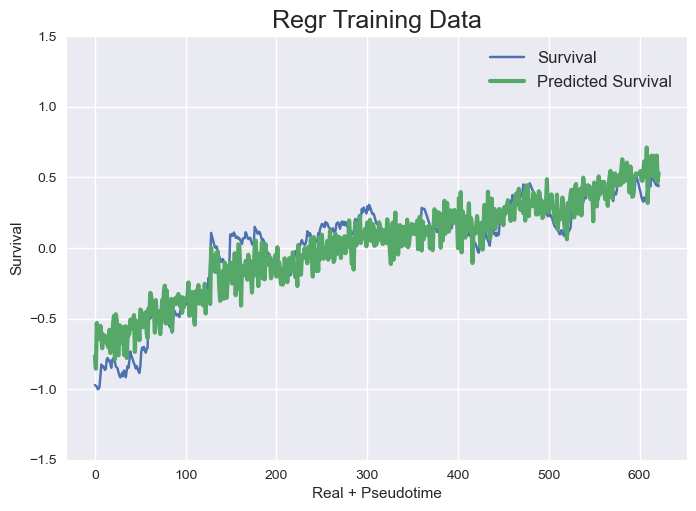

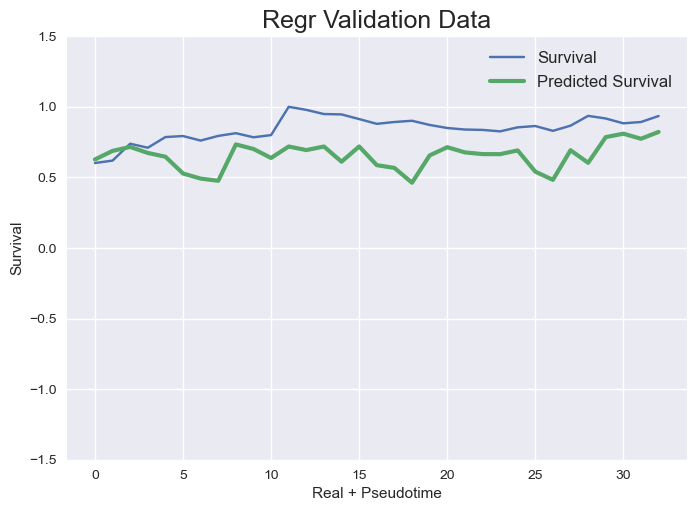

tf.Tensor(
[0.875027   0.9269406  0.9637793  0.9356784  0.9851018  0.95922303
 0.9677084  1.0280771  0.8488056  1.2428669 ], shape=(10,), dtype=float32)
{0.75: [0.001041507068219967, 0.141053998018288, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.875027   0.9269406  0.9637793  0.9356784  0.9851018  0.95922303
 0.9677084  1.0280771  0.8488056  1.2428669 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.2880 - mean_squared_error: 0.2880
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 77ms/step - loss: 0.2738 - mean_squared_error: 0.2738 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0505 - mean_squared_error: 0.0505
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

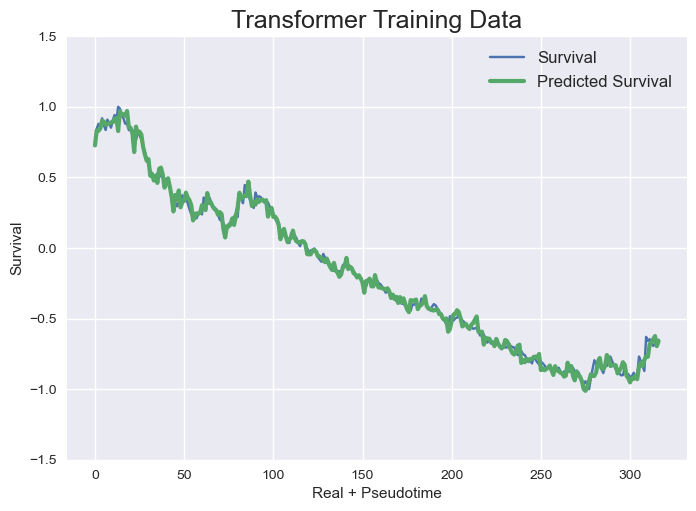

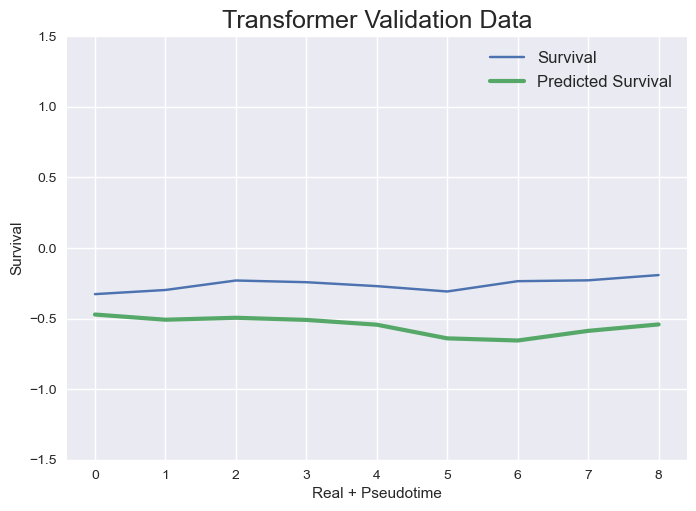

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


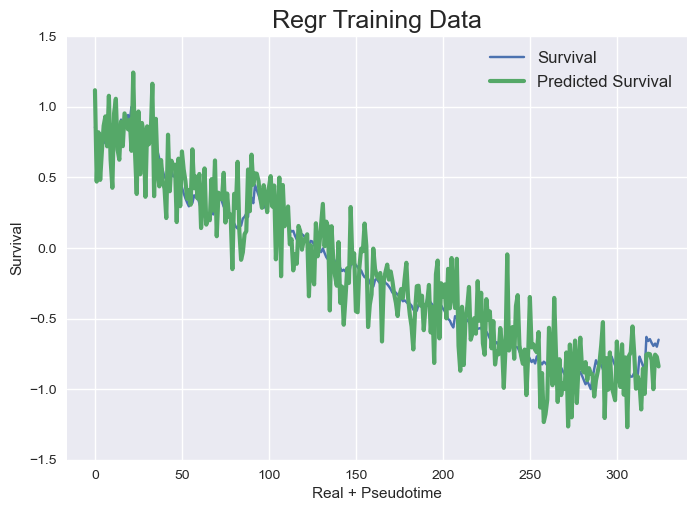

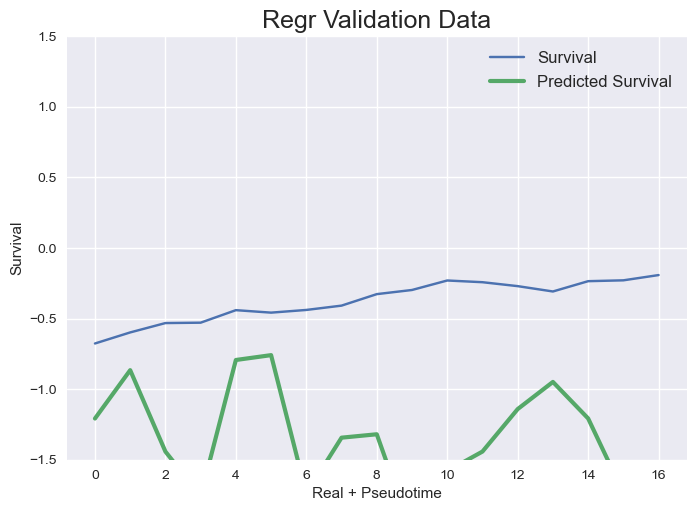

tf.Tensor(
[0.88813794 0.960446   0.9580353  0.92674005 0.984828   0.9457467
 0.97490424 1.0596602  0.8430094  1.2348847 ], shape=(10,), dtype=float32)
{0.75: [0.0015372842444344253, 0.0909107193341782, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.88813794 0.960446   0.9580353  0.92674005 0.984828   0.9457467
 0.97490424 1.0596602  0.8430094  1.2348847 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.1549 - mean_squared_error: 0.1549
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 77ms/step - loss: 0.1478 - mean_squared_error: 0.1478 - val_loss: 0.1497 - val_mean_squared_error: 0.1497
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0306 - mean_squared_error: 0.0306
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=============

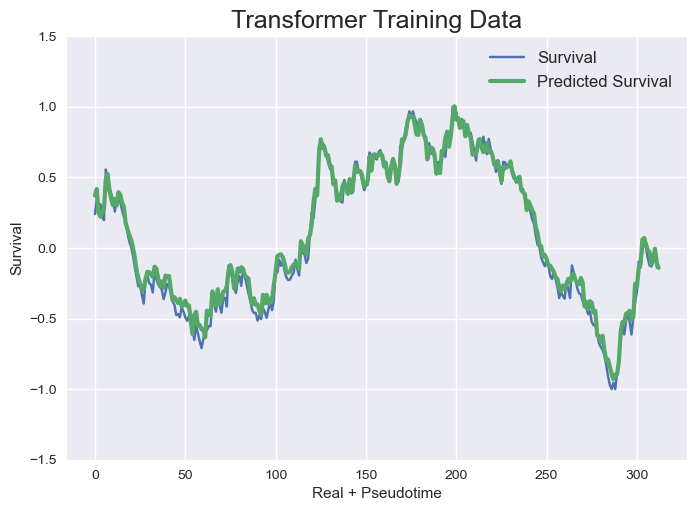

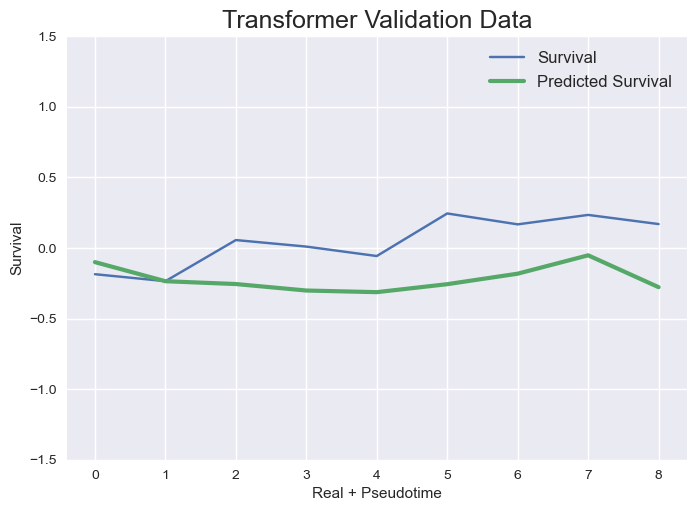

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


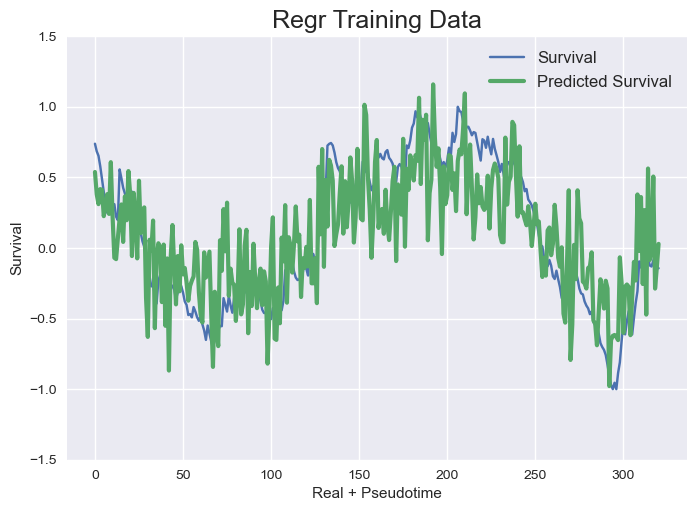

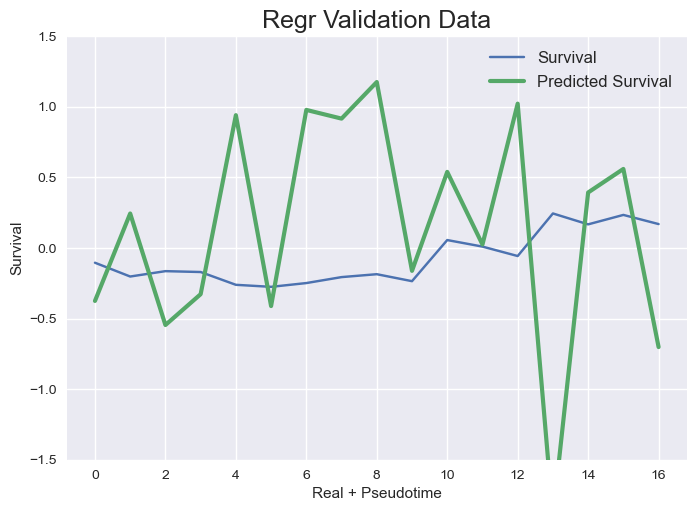

tf.Tensor(
[0.88808    0.9272292  0.948963   0.92850524 0.9882141  0.9568474
 0.96810186 1.0391593  0.83708113 1.2353697 ], shape=(10,), dtype=float32)
{0.75: [0.0038149544586681566, 0.10239041622330117, 0.09963663912416548, 0.7911836007528895]}
3 
 3 
 3



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.88808    0.9272292  0.948963   0.92850524 0.9882141  0.9568474
 0.96810186 1.0391593  0.83708113 1.2353697 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0393 - mean_squared_error: 0.0393
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 62ms/step - loss: 0.0365 - mean_squared_error: 0.0365 - val_loss: 0.4570 - val_mean_squared_error: 0.4570
Epoch 2/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0133 - mean_squared_error: 0.0133
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [=

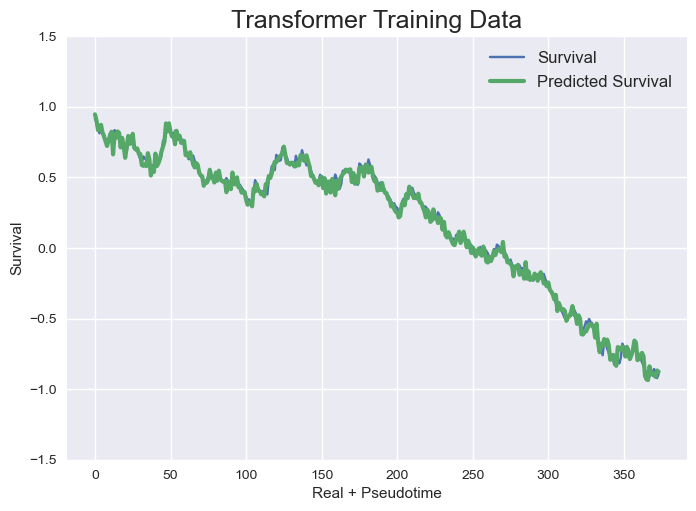

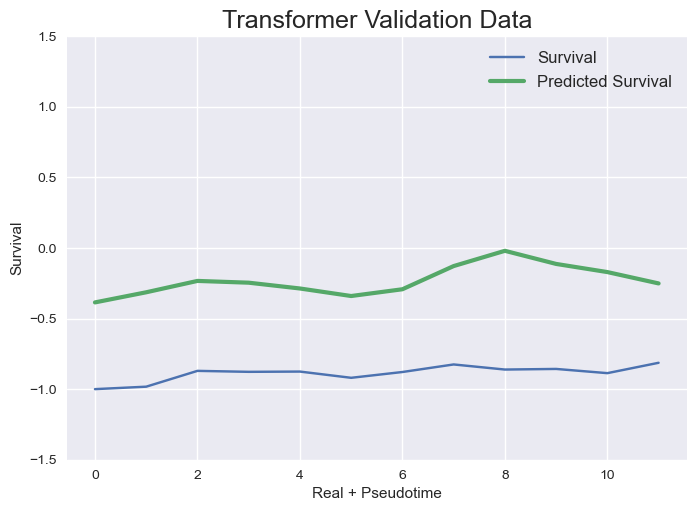

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


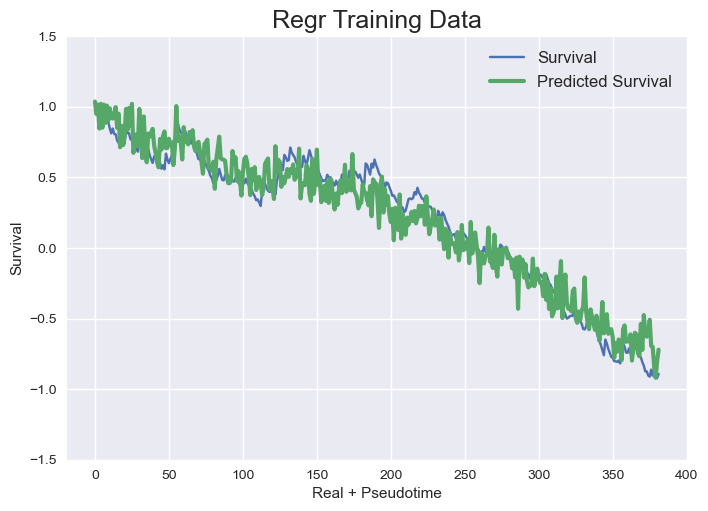

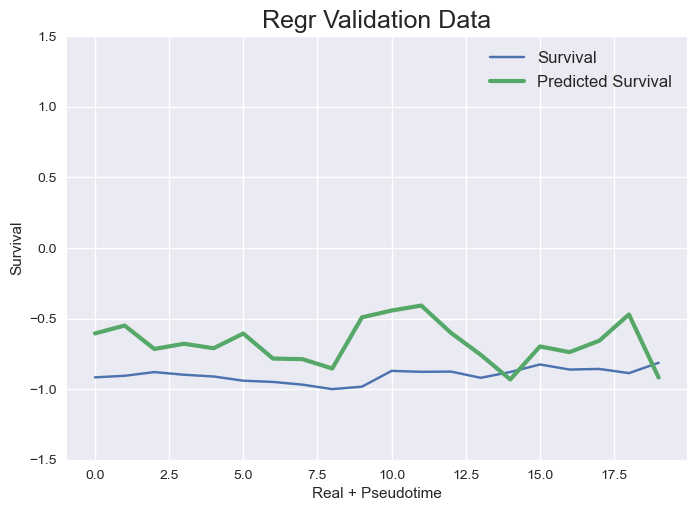

tf.Tensor(
[0.87887466 0.92811674 0.9515436  0.9374277  0.9929583  0.9426882
 0.97107214 1.0429968  0.83629894 1.2328686 ], shape=(10,), dtype=float32)
{0.75: [0.0012881290759330032, 0.4358457780982574, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.87887466 0.92811674 0.9515436  0.9374277  0.9929583  0.9426882
 0.97107214 1.0429968  0.83629894 1.2328686 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0276 - mean_squared_error: 0.0276
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 76ms/step - loss: 0.0269 - mean_squared_error: 0.0269 - val_loss: 0.0321 - val_mean_squared_error: 0.0321
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0108 - mean_squared_error: 0.0108
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [===========

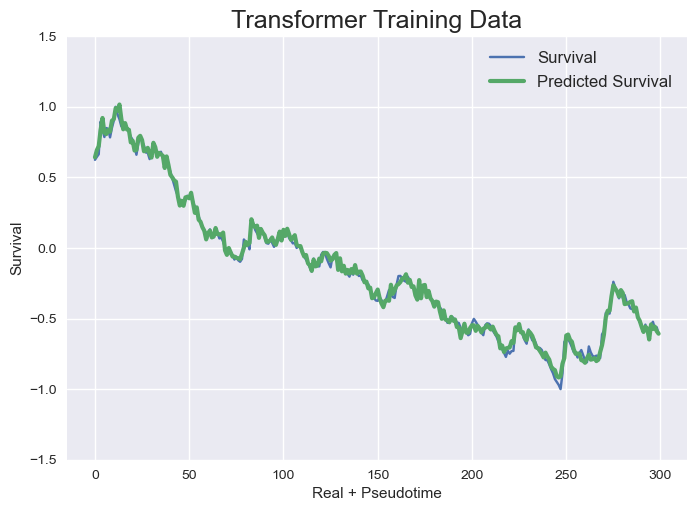

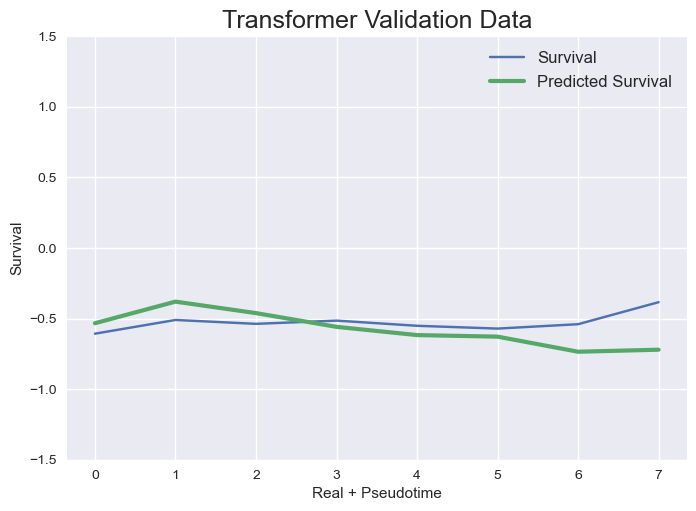

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


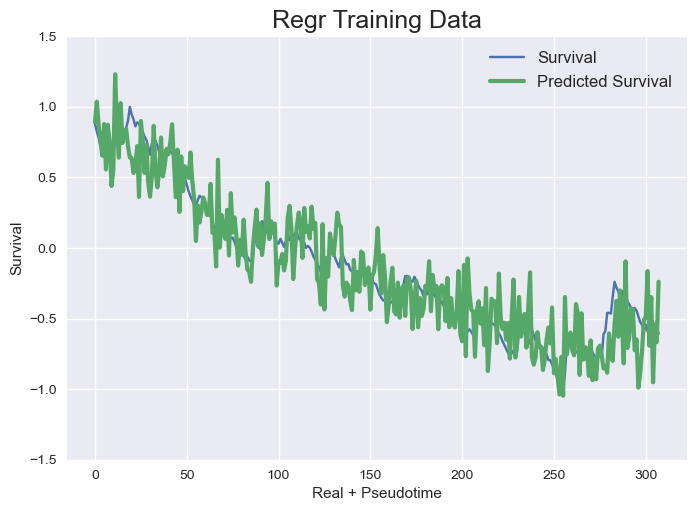

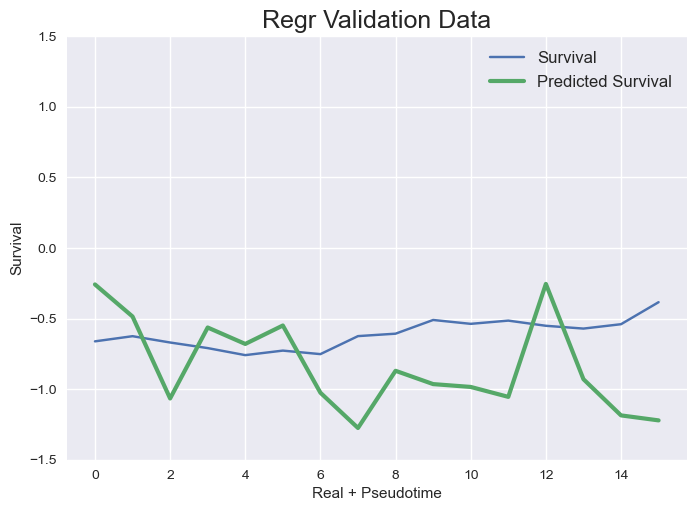

tf.Tensor(
[0.8738807  0.9277837  0.9517948  0.93859726 1.0009812  0.9384434
 0.9753353  1.0576378  0.8335823  1.240564  ], shape=(10,), dtype=float32)
{0.75: [0.0011434694600491217, 0.023635662502468905, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.8738807  0.9277837  0.9517948  0.93859726 1.0009812  0.9384434
 0.9753353  1.0576378  0.8335823  1.240564  ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0674 - mean_squared_error: 0.0674
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 36ms/step - loss: 0.0636 - mean_squared_error: 0.0636 - val_loss: 0.5124 - val_mean_squared_error: 0.5124
Epoch 2/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0149 - mean_squared_error: 0.0149
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [===========

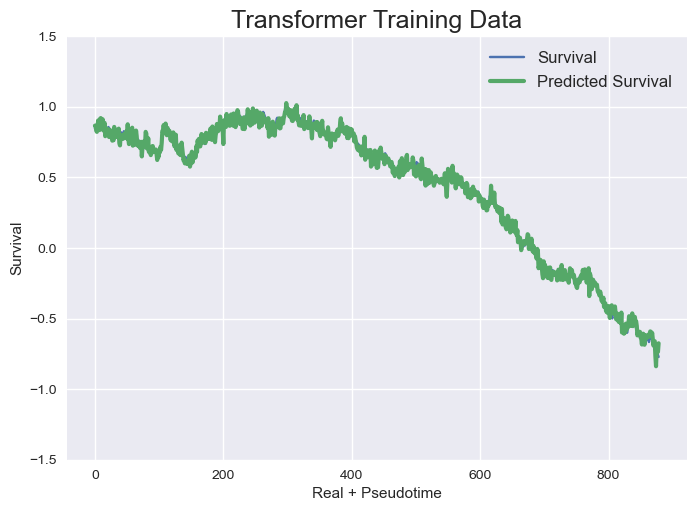

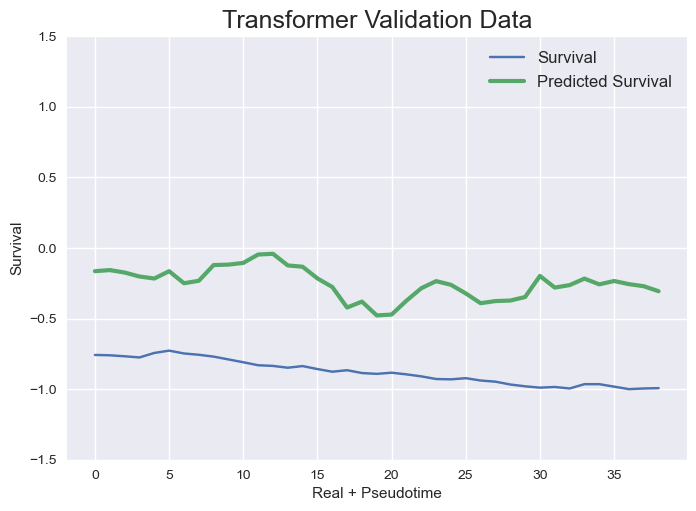

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


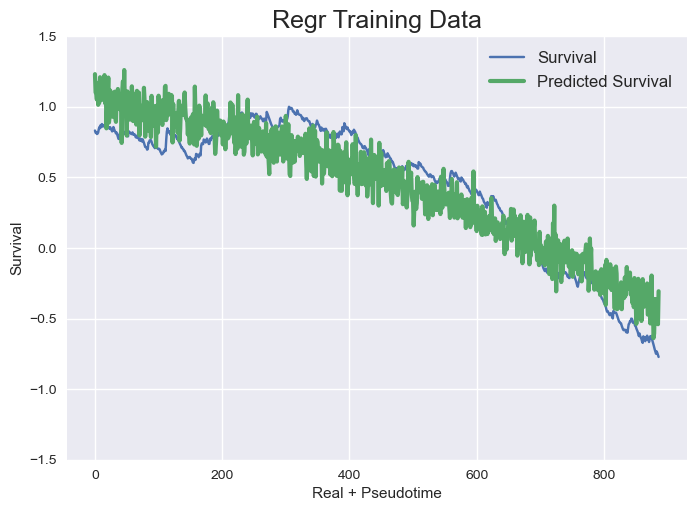

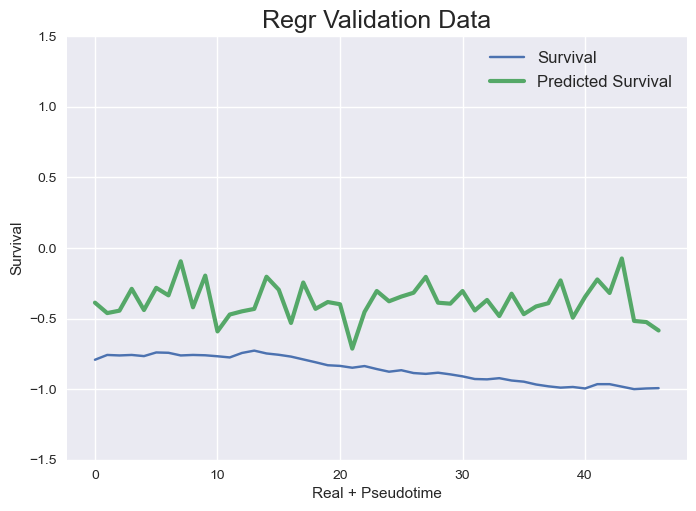

tf.Tensor(
[0.871807   0.9267665  0.96951413 0.9511472  1.0033177  0.95591974
 0.96228606 1.0762239  0.82614523 1.2364557 ], shape=(10,), dtype=float32)
{0.75: [0.0011117628249622525, 0.4069724087210847, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.871807   0.9267665  0.96951413 0.9511472  1.0033177  0.95591974
 0.96228606 1.0762239  0.82614523 1.2364557 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.3778 - mean_squared_error: 0.3778
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 30ms/step - loss: 0.3677 - mean_squared_error: 0.3677 - val_loss: 0.0489 - val_mean_squared_error: 0.0489
Epoch 2/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0272 - mean_squared_error: 0.0272
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [=========

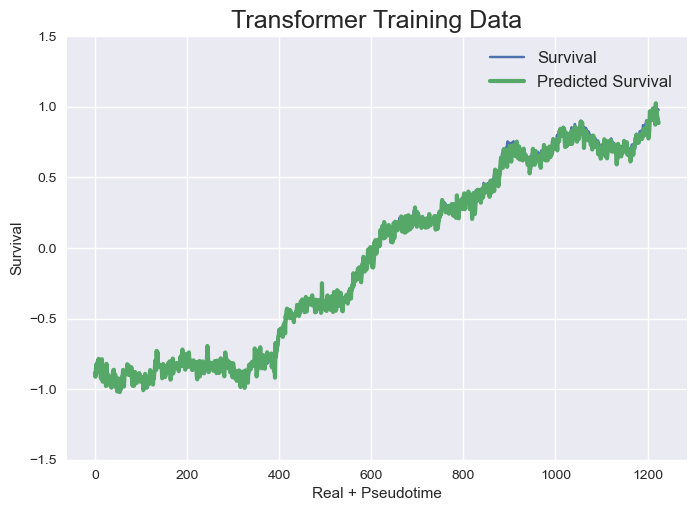

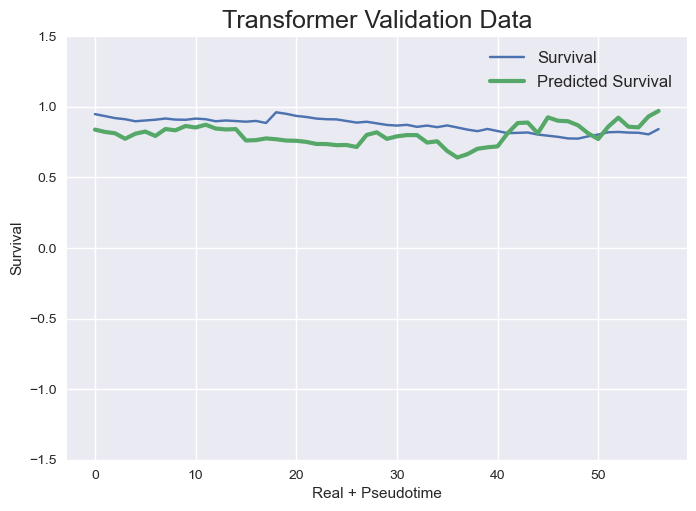

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


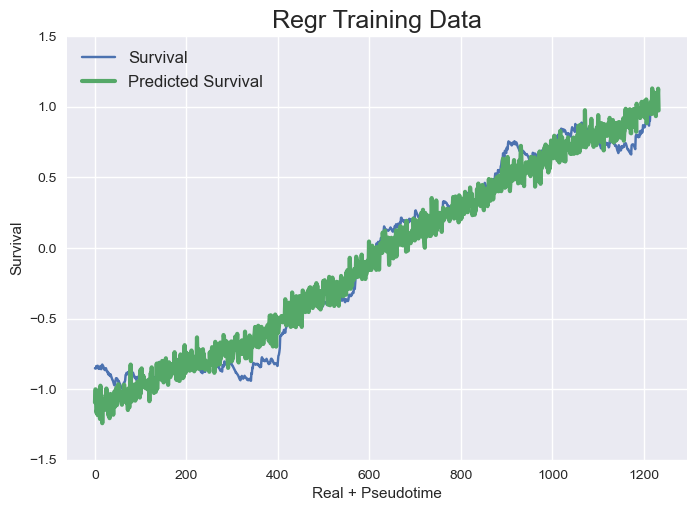

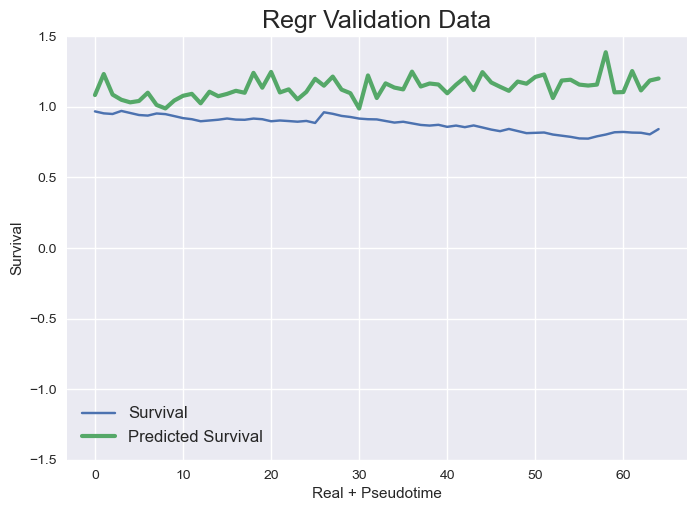

tf.Tensor(
[0.8858996  0.90865064 0.94019824 0.91901165 0.9780291  0.9383457
 0.98977983 1.034821   0.826642   1.2503662 ], shape=(10,), dtype=float32)
{0.75: [0.0017146320259778898, 0.013614910178312152, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.8858996  0.90865064 0.94019824 0.91901165 0.9780291  0.9383457
 0.98977983 1.034821   0.826642   1.2503662 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.1031 - mean_squared_error: 0.1031
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 30ms/step - loss: 0.0991 - mean_squared_error: 0.0991 - val_loss: 1.6539 - val_mean_squared_error: 1.6539
Epoch 2/10
30/32 [===========================>..] - ETA: 0s - loss: 0.0257 - mean_squared_error: 0.0257
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [=========

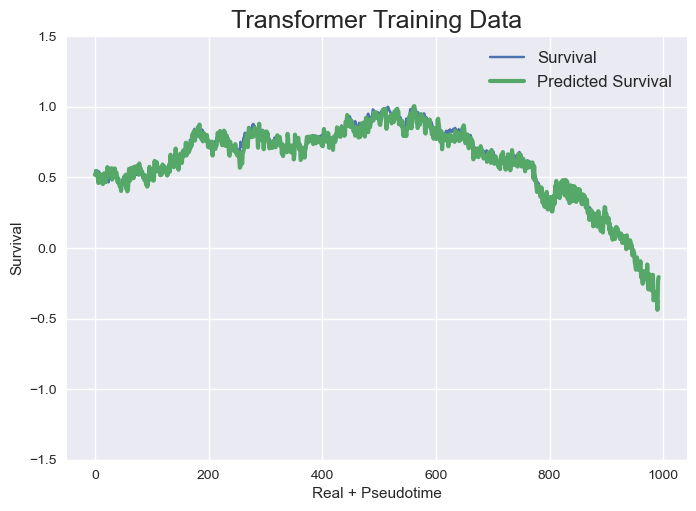

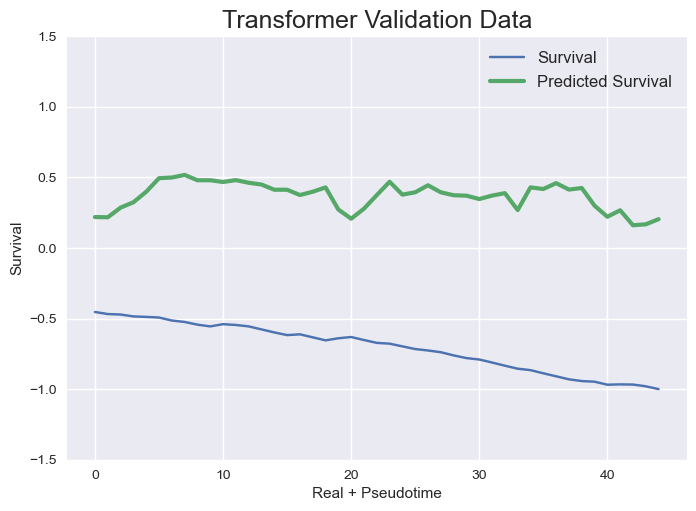

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


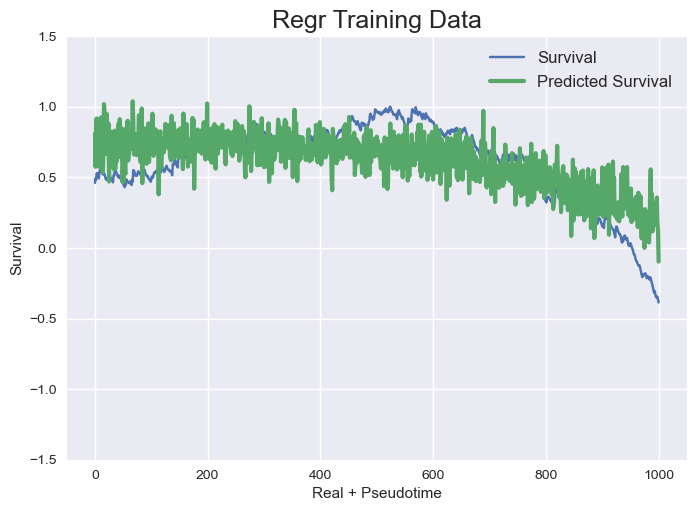

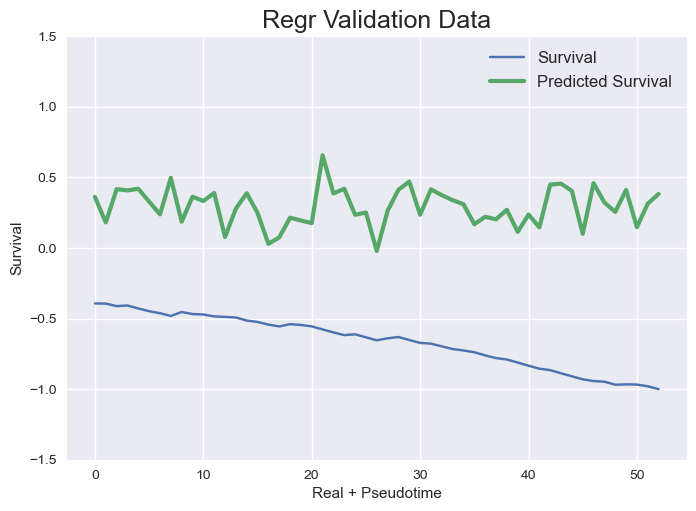

tf.Tensor(
[0.8771236  0.893332   0.9262133  0.8956238  0.9761972  0.9274659
 1.0044317  1.0342205  0.84636724 1.2613882 ], shape=(10,), dtype=float32)
{0.75: [0.0017033067038158913, 1.1767929035418794, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.8771236  0.893332   0.9262133  0.8956238  0.9761972  0.9274659
 1.0044317  1.0342205  0.84636724 1.2613882 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.1205 - mean_squared_error: 0.1205
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 28ms/step - loss: 0.1158 - mean_squared_error: 0.1158 - val_loss: 0.5457 - val_mean_squared_error: 0.5457
Epoch 2/10
46/48 [===========================>..] - ETA: 0s - loss: 0.0161 - mean_squared_error: 0.0161
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [===========

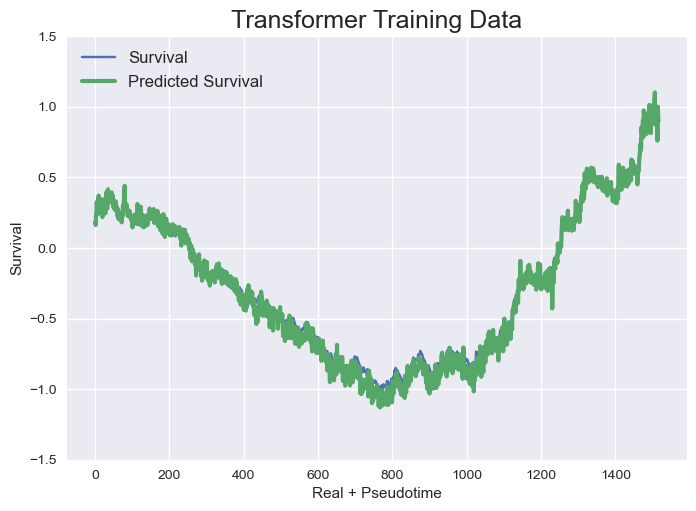

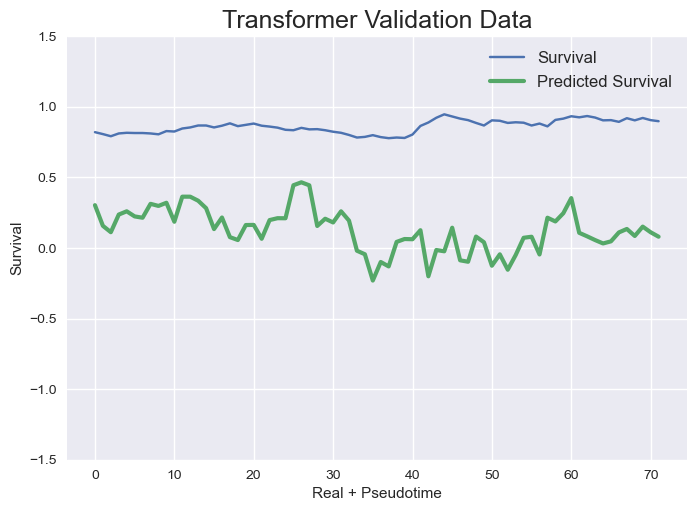

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


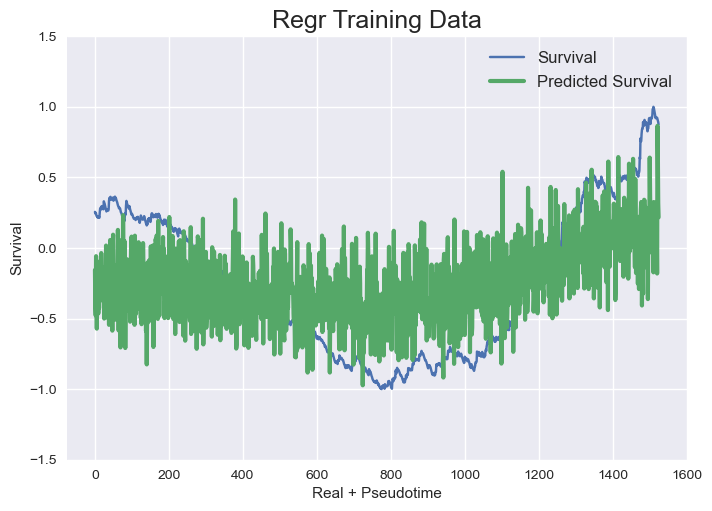

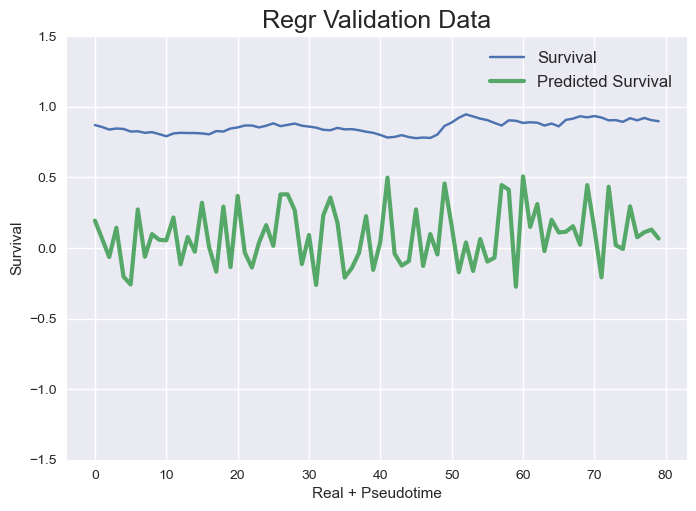

tf.Tensor(
[0.8732551  0.870638   0.91563934 0.8708015  0.99008816 0.90582335
 0.97874254 1.0519065  0.8318557  1.2688468 ], shape=(10,), dtype=float32)
{0.75: [0.0037414805359810214, 0.5651118291626234, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.8732551  0.870638   0.91563934 0.8708015  0.99008816 0.90582335
 0.97874254 1.0519065  0.8318557  1.2688468 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0257 - mean_squared_error: 0.0257
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 3s 43ms/step - loss: 0.0234 - mean_squared_error: 0.0234 - val_loss: 0.1480 - val_mean_squared_error: 0.1480
Epoch 2/10
18/20 [==========================>...] - ETA: 0s - loss: 0.0050 - mean_squared_error: 0.0050
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==========

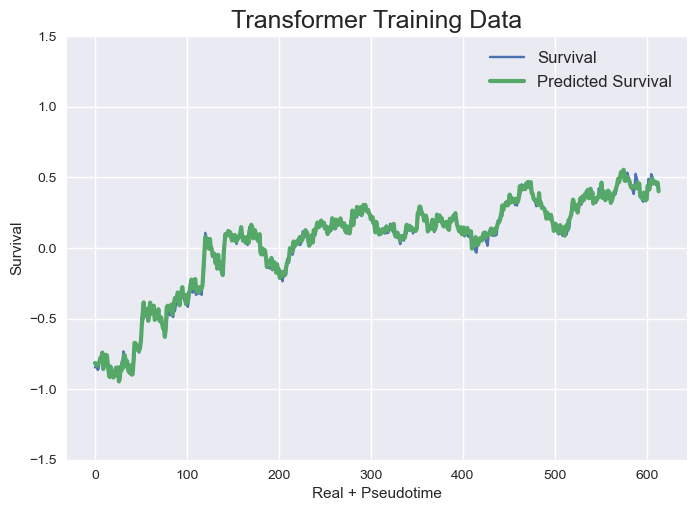

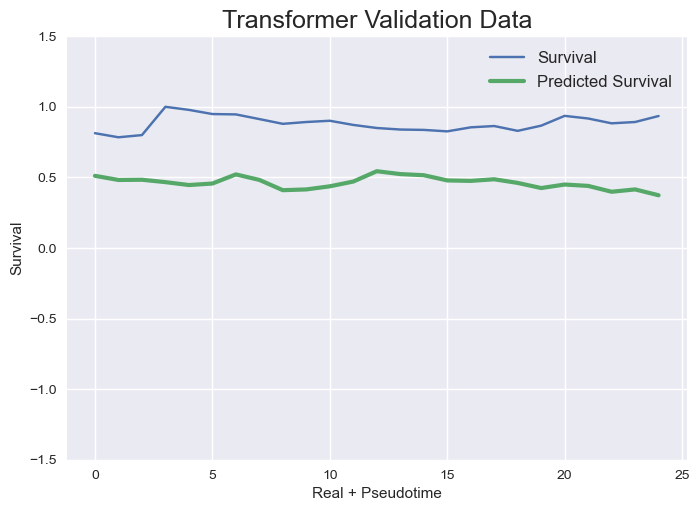

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


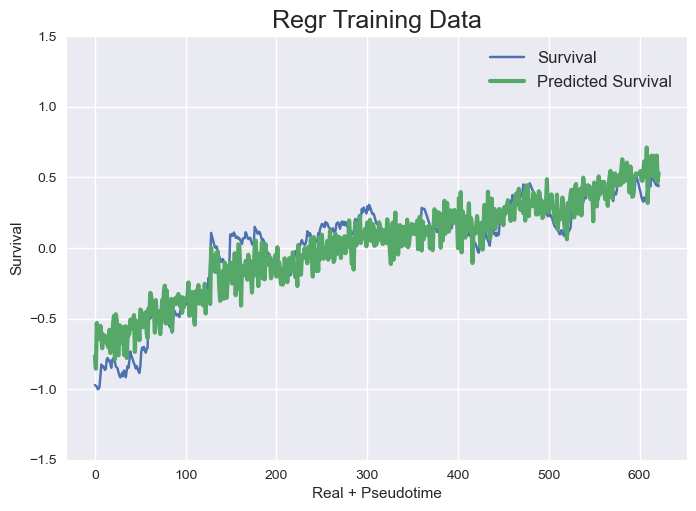

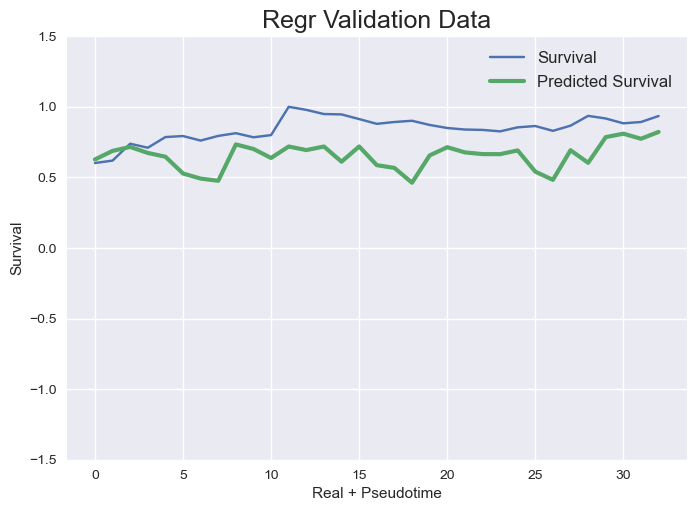

tf.Tensor(
[0.8794329  0.87553954 0.923269   0.88172346 0.9904442  0.9110426
 0.9840386  1.0303967  0.8323584  1.2634652 ], shape=(10,), dtype=float32)
{0.75: [0.0010543782170120022, 0.1825000804247277, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.8794329  0.87553954 0.923269   0.88172346 0.9904442  0.9110426
 0.9840386  1.0303967  0.8323584  1.2634652 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.2352 - mean_squared_error: 0.2352
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 75ms/step - loss: 0.2185 - mean_squared_error: 0.2185 - val_loss: 0.0081 - val_mean_squared_error: 0.0081
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0284 - mean_squared_error: 0.0284
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

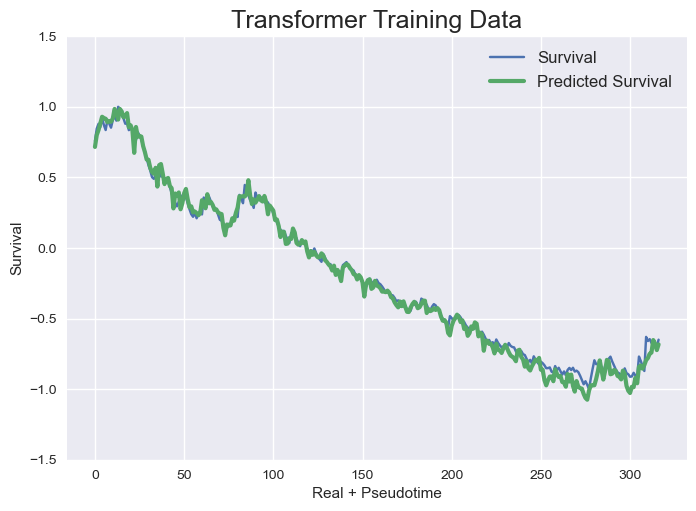

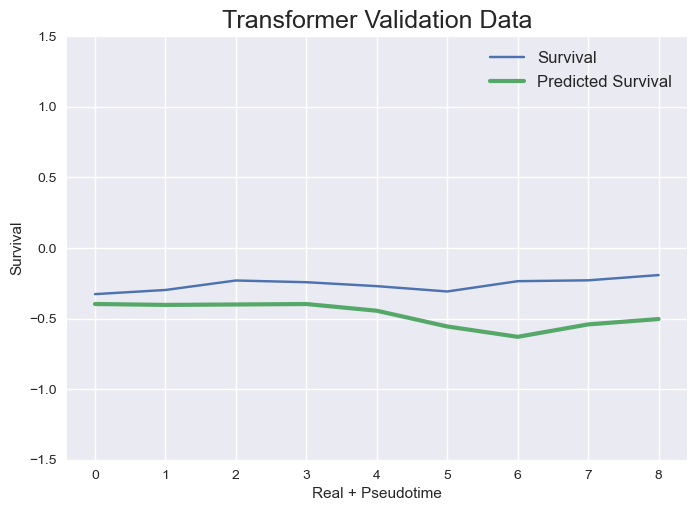

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


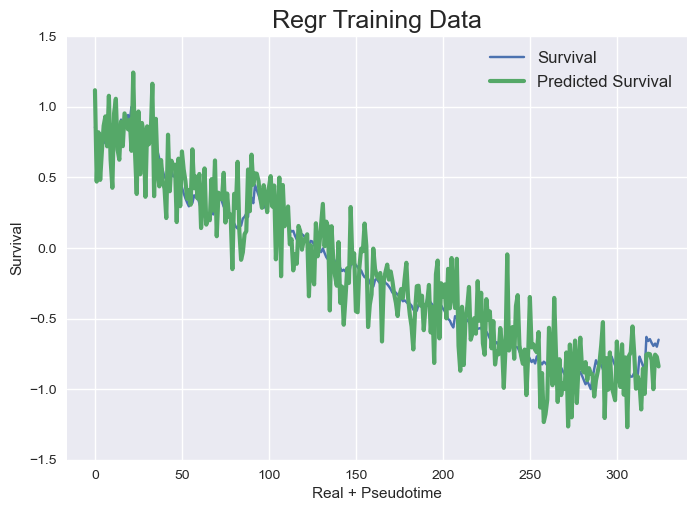

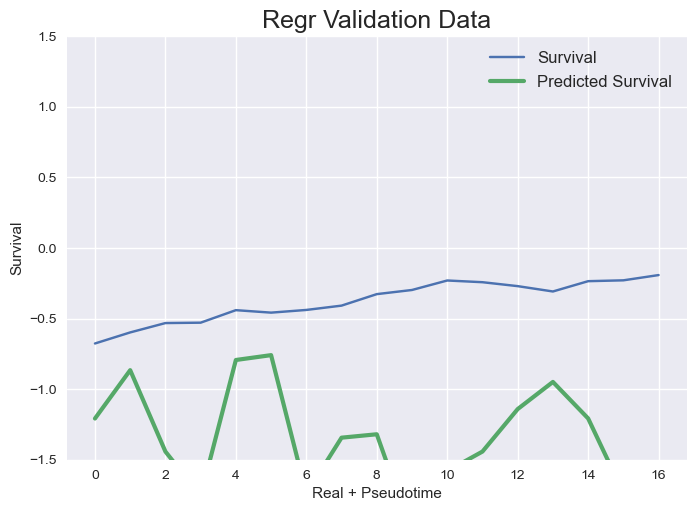

tf.Tensor(
[0.89995605 0.87687665 0.9215934  0.87503195 0.9802684  0.90118736
 0.99190676 1.0575453  0.8310194  1.2793621 ], shape=(10,), dtype=float32)
{0.75: [0.0024370713016989196, 0.05672862721321327, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.89995605 0.87687665 0.9215934  0.87503195 0.9802684  0.90118736
 0.99190676 1.0575453  0.8310194  1.2793621 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.1238 - mean_squared_error: 0.1238
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 47ms/step - loss: 0.1157 - mean_squared_error: 0.1157 - val_loss: 0.2959 - val_mean_squared_error: 0.2959
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0370 - mean_squared_error: 0.0370
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

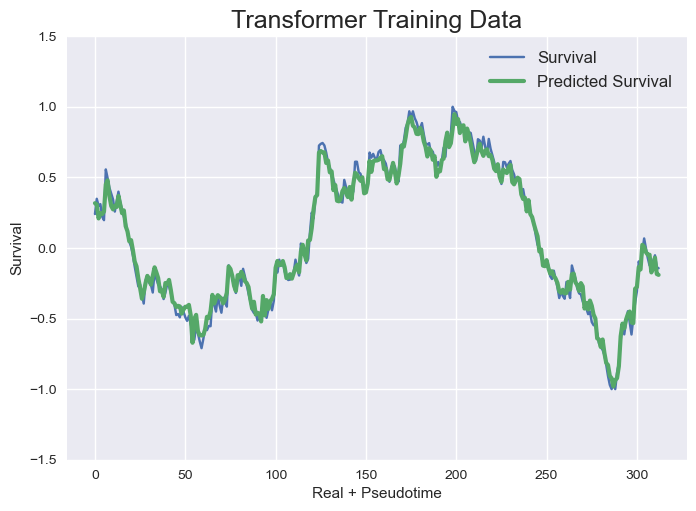

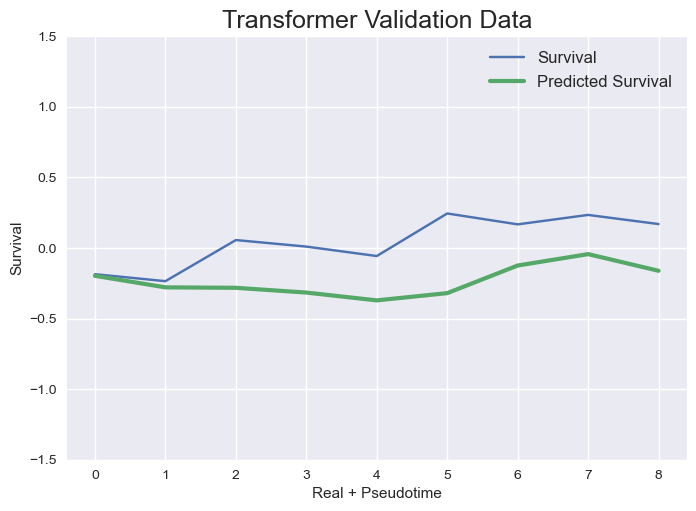

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


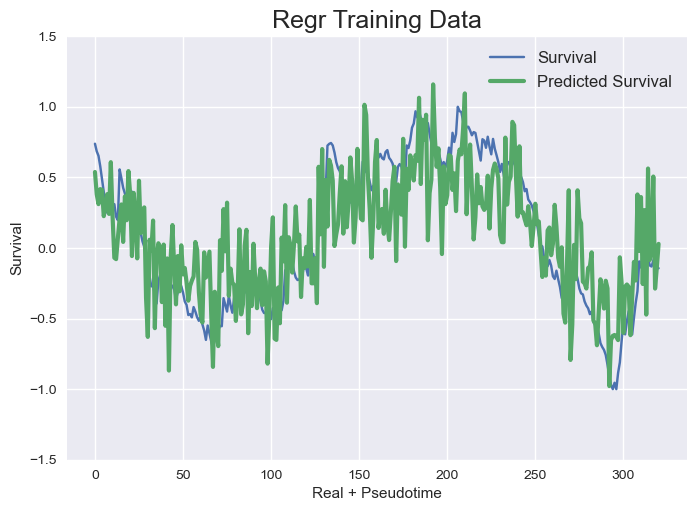

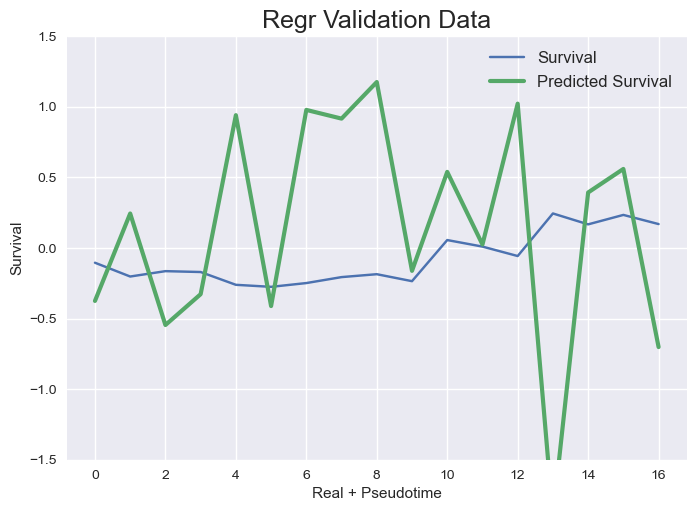

tf.Tensor(
[0.9004591  0.8709978  0.91657376 0.8697689  0.9733171  0.9086627
 0.9911911  1.0381316  0.82805073 1.271439  ], shape=(10,), dtype=float32)
{0.75: [0.002883982214934148, 0.10127431778443205, 0.09963663912416548, 0.7911836007528895]}
4 
 4 
 4



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.9004591  0.8709978  0.91657376 0.8697689  0.9733171  0.9086627
 0.9911911  1.0381316  0.82805073 1.271439  ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0434 - mean_squared_error: 0.0434
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 65ms/step - loss: 0.0375 - mean_squared_error: 0.0375 - val_loss: 0.4012 - val_mean_squared_error: 0.4012
Epoch 2/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0155 - mean_squared_error: 0.0155
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [==

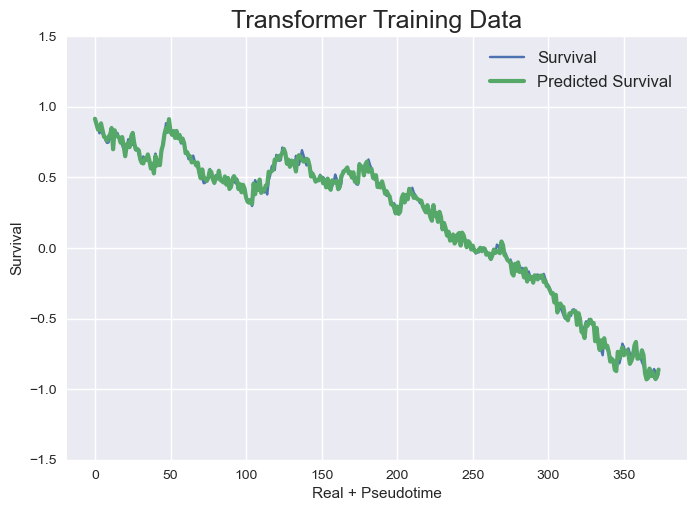

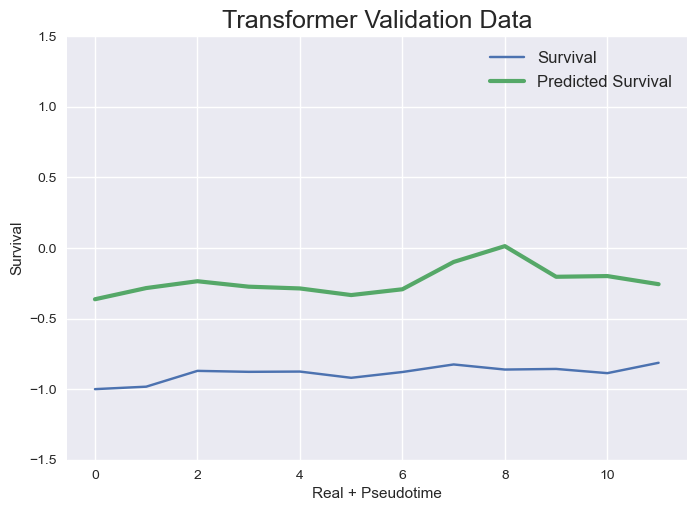

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


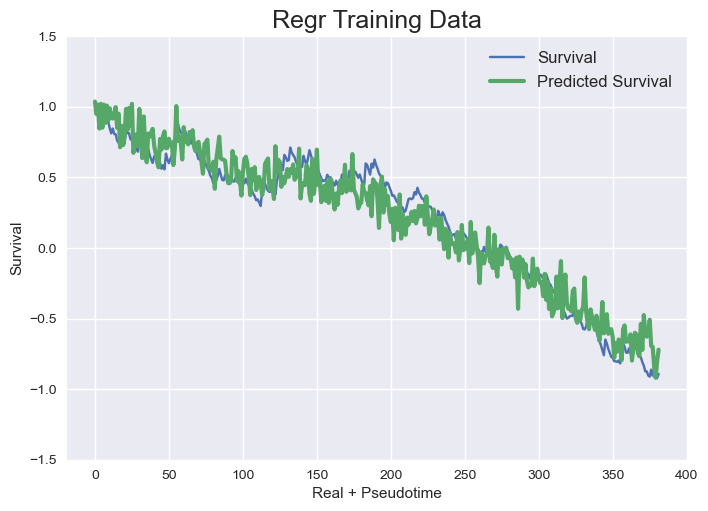

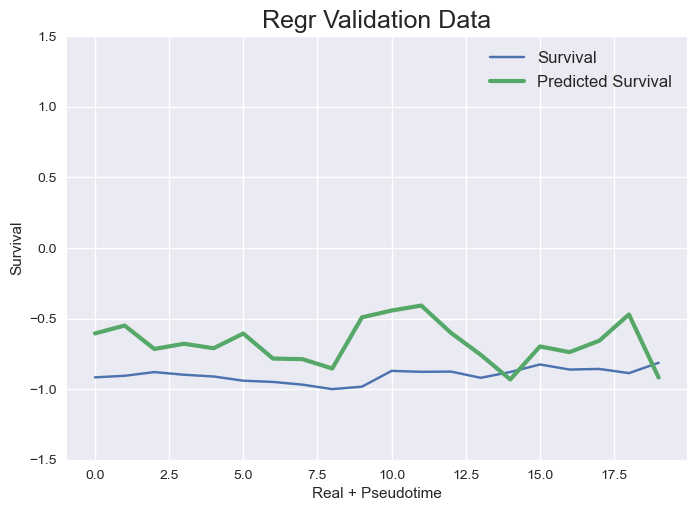

tf.Tensor(
[0.89302194 0.86152846 0.9236251  0.8768485  0.9802465  0.91525185
 0.999732   1.0514114  0.82895994 1.2692761 ], shape=(10,), dtype=float32)
{0.75: [0.0011057518561961314, 0.4329124546685493, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.89302194 0.86152846 0.9236251  0.8768485  0.9802465  0.91525185
 0.999732   1.0514114  0.82895994 1.2692761 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0348 - mean_squared_error: 0.0348
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 46ms/step - loss: 0.0339 - mean_squared_error: 0.0339 - val_loss: 0.0401 - val_mean_squared_error: 0.0401
Epoch 2/10
 8/10 [=======================>......] - ETA: 0s - loss: 0.0152 - mean_squared_error: 0.0152
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=========

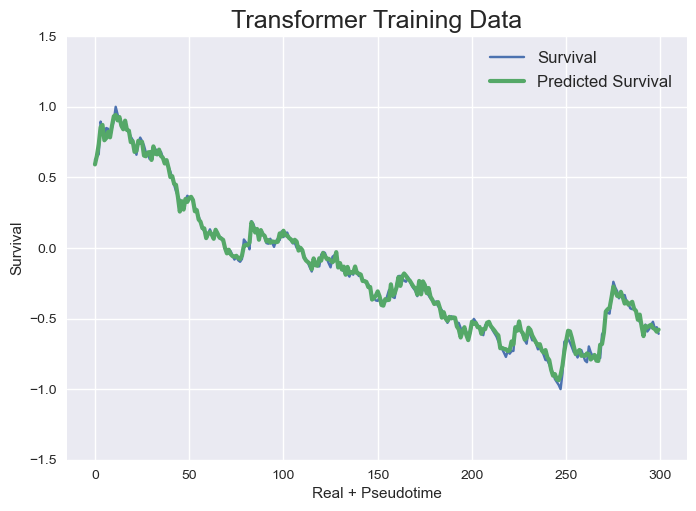

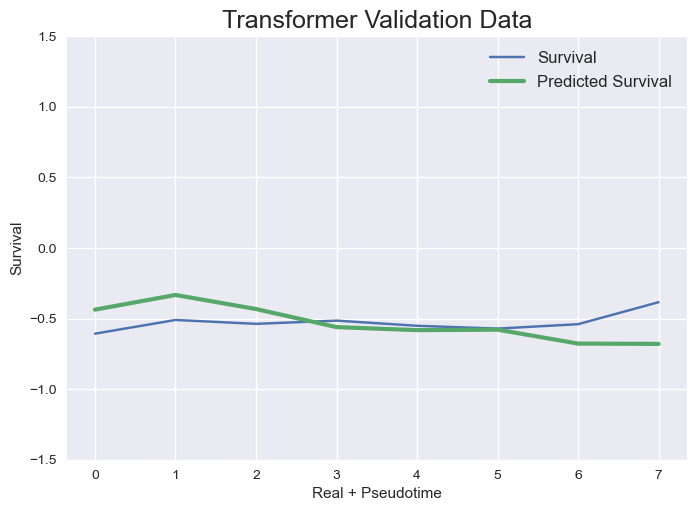

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


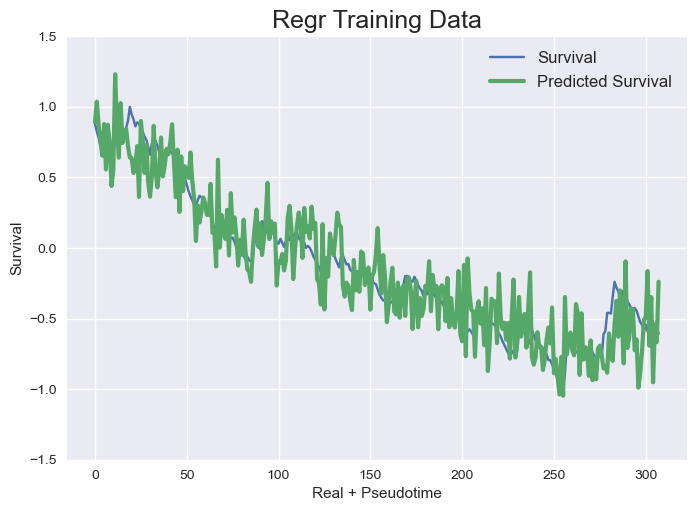

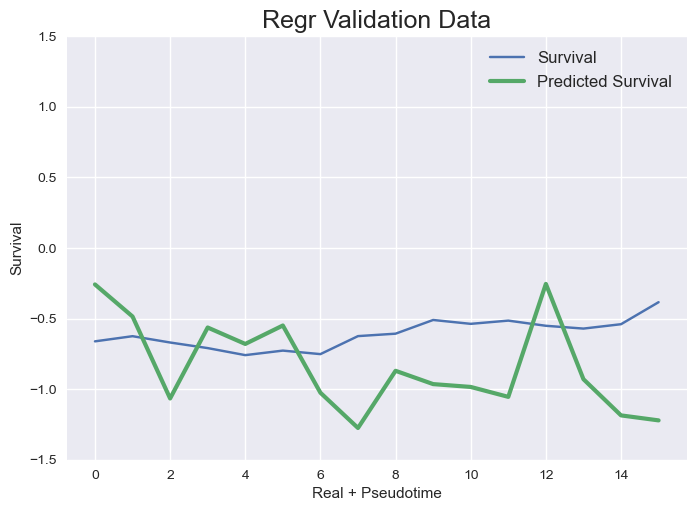

tf.Tensor(
[0.8871594  0.8556623  0.9212184  0.8725731  0.979989   0.9047129
 0.99492705 1.0641899  0.82774824 1.272357  ], shape=(10,), dtype=float32)
{0.75: [0.000985248276654612, 0.02258183899620788, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.8871594  0.8556623  0.9212184  0.8725731  0.979989   0.9047129
 0.99492705 1.0641899  0.82774824 1.272357  ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0705 - mean_squared_error: 0.0705
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 28ms/step - loss: 0.0682 - mean_squared_error: 0.0682 - val_loss: 0.5129 - val_mean_squared_error: 0.5129
Epoch 2/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0157 - mean_squared_error: 0.0157
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [=============

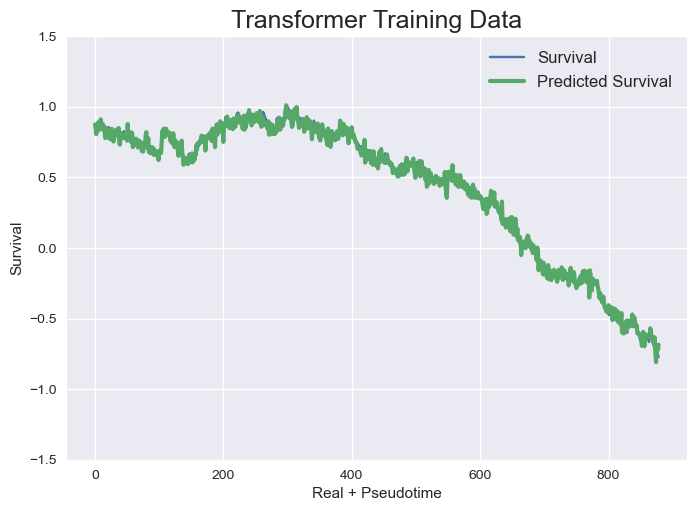

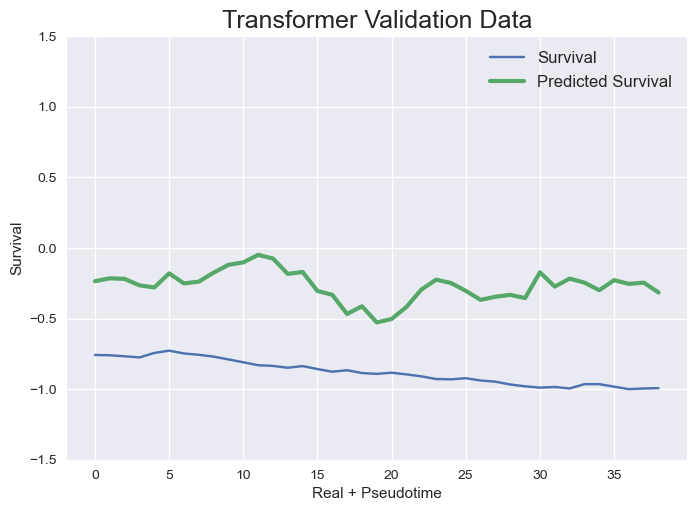

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


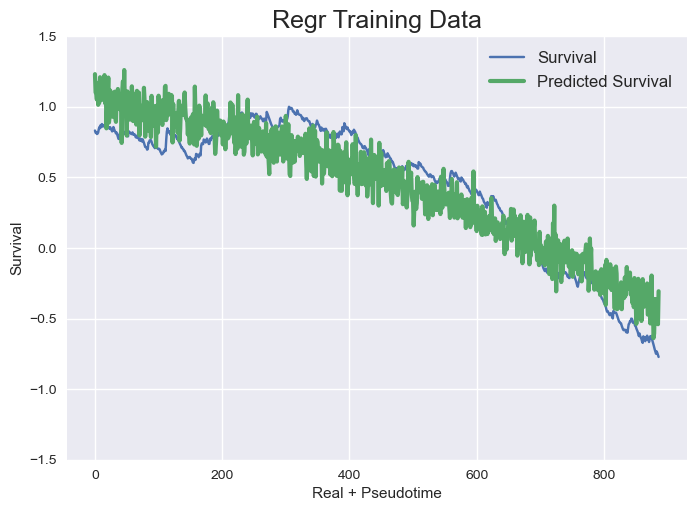

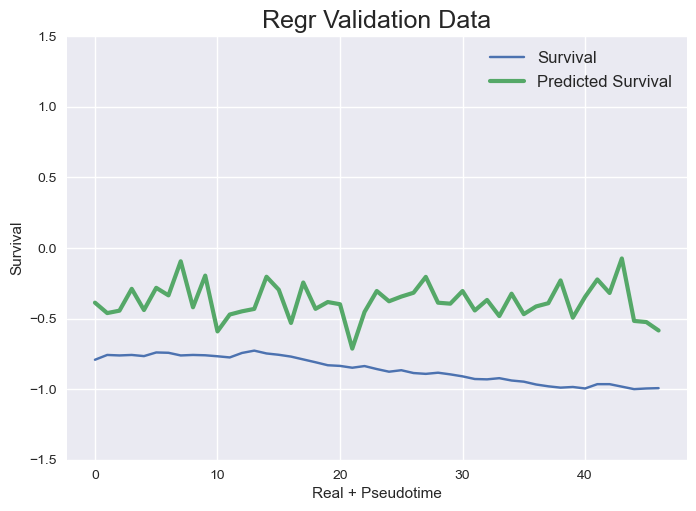

tf.Tensor(
[0.8869158  0.85151154 0.9377564  0.8958775  0.9891375  0.91851205
 0.97741693 1.0813981  0.82484114 1.2672642 ], shape=(10,), dtype=float32)
{0.75: [0.0011299639868543544, 0.3876930539329701, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.8869158  0.85151154 0.9377564  0.8958775  0.9891375  0.91851205
 0.97741693 1.0813981  0.82484114 1.2672642 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.2241 - mean_squared_error: 0.2241
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 29ms/step - loss: 0.2175 - mean_squared_error: 0.2175 - val_loss: 0.0358 - val_mean_squared_error: 0.0358
Epoch 2/10
38/39 [============================>.] - ETA: 0s - loss: 0.0169 - mean_squared_error: 0.0169
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [=========

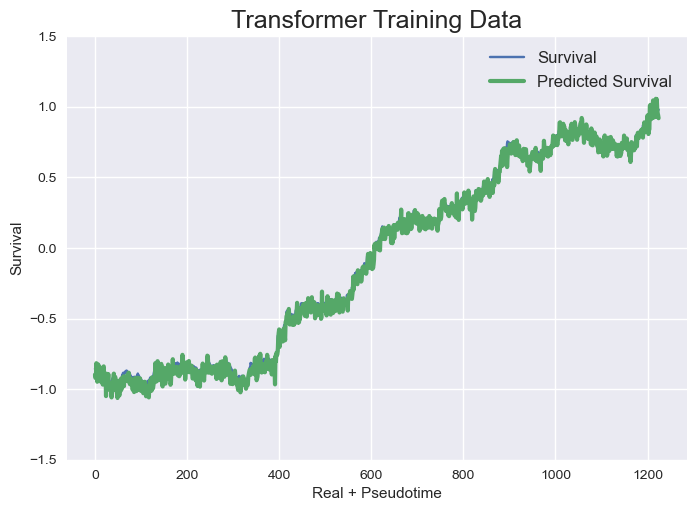

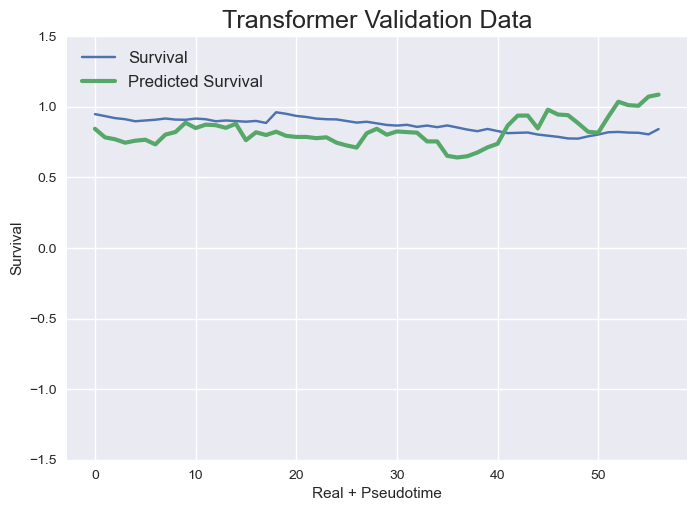

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


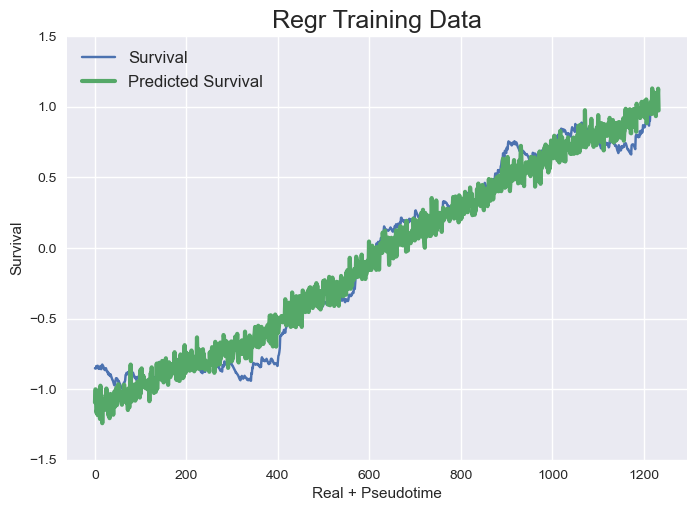

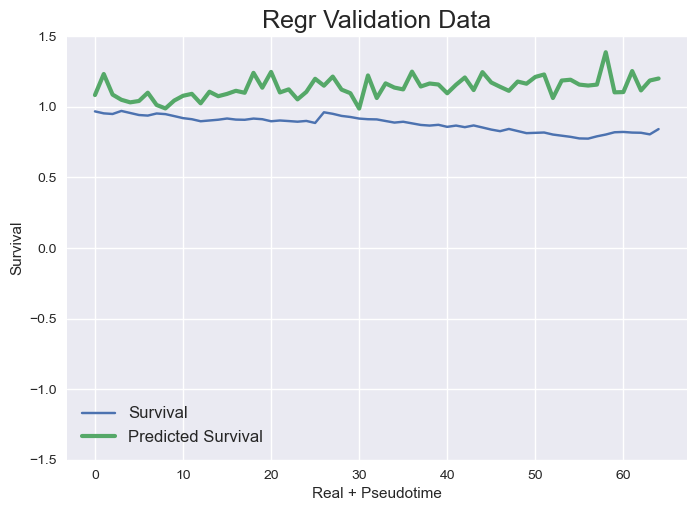

tf.Tensor(
[0.9165193  0.8572968  0.9084702  0.867585   0.9509464  0.90180683
 0.99536294 1.0355359  0.8225391  1.2737141 ], shape=(10,), dtype=float32)
{0.75: [0.0021421148266891586, 0.018184545129370164, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.9165193  0.8572968  0.9084702  0.867585   0.9509464  0.90180683
 0.99536294 1.0355359  0.8225391  1.2737141 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.1082 - mean_squared_error: 0.1082
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 25ms/step - loss: 0.1053 - mean_squared_error: 0.1053 - val_loss: 2.0143 - val_mean_squared_error: 2.0143
Epoch 2/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0314 - mean_squared_error: 0.0314
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [=======

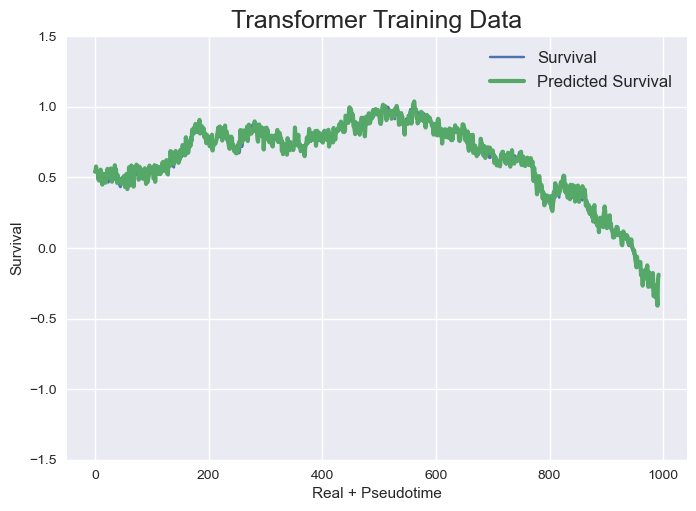

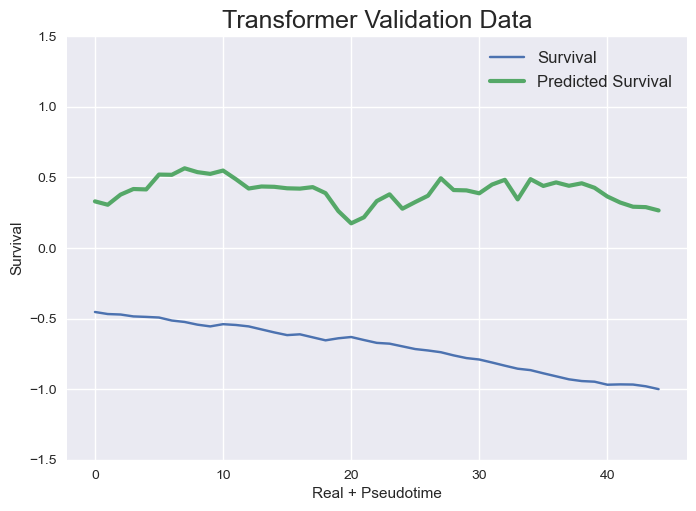

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


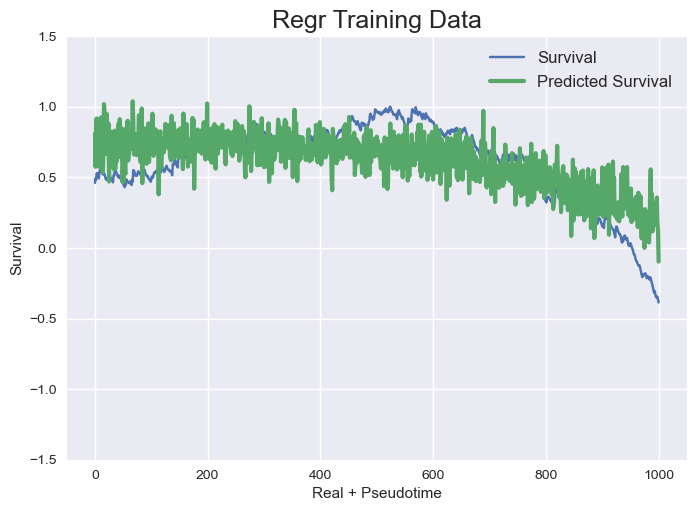

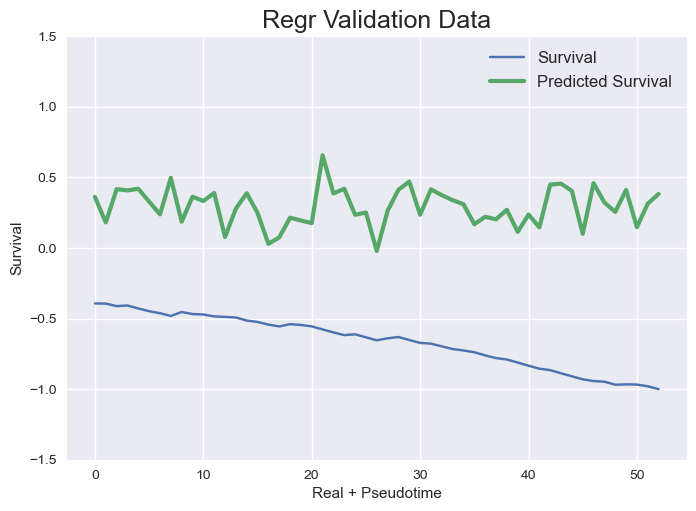

tf.Tensor(
[0.91263276 0.8606853  0.8878027  0.8571999  0.9541359  0.88308674
 0.9945368  1.0463262  0.81500053 1.2971755 ], shape=(10,), dtype=float32)
{0.75: [0.0012695567288765993, 1.2513776110368158, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.91263276 0.8606853  0.8878027  0.8571999  0.9541359  0.88308674
 0.9945368  1.0463262  0.81500053 1.2971755 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0647 - mean_squared_error: 0.0647
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 27ms/step - loss: 0.0624 - mean_squared_error: 0.0624 - val_loss: 0.6493 - val_mean_squared_error: 0.6493
Epoch 2/10
46/48 [===========================>..] - ETA: 0s - loss: 0.0118 - mean_squared_error: 0.0118
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [=========

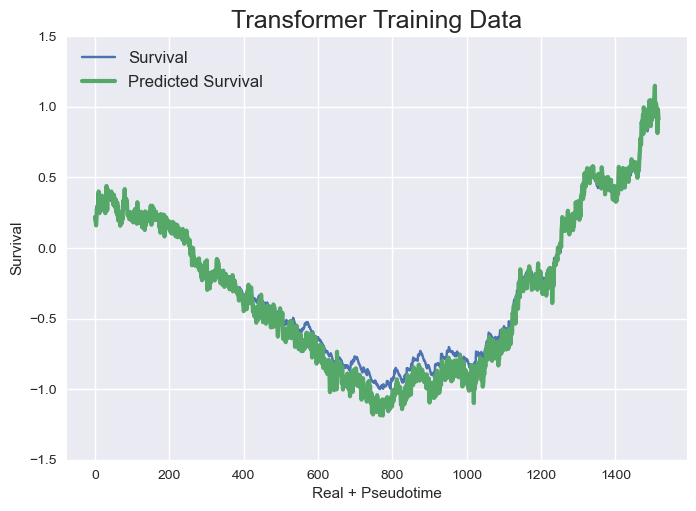

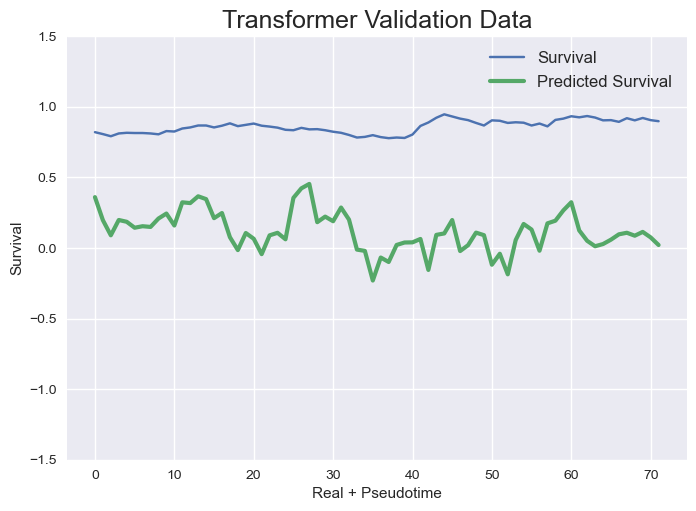

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


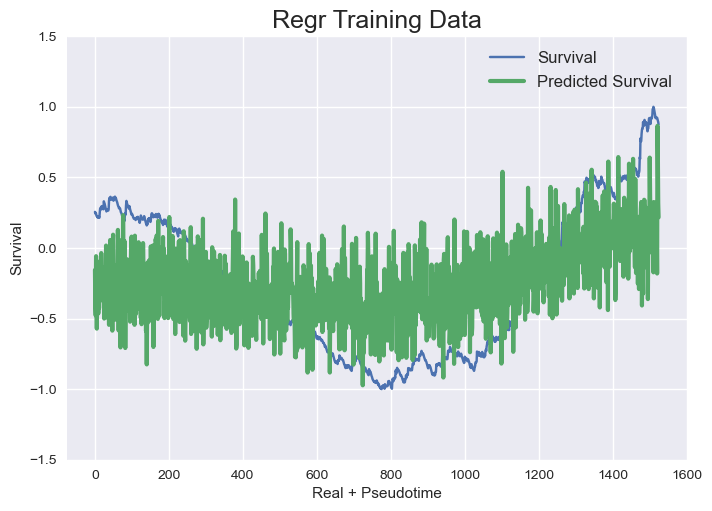

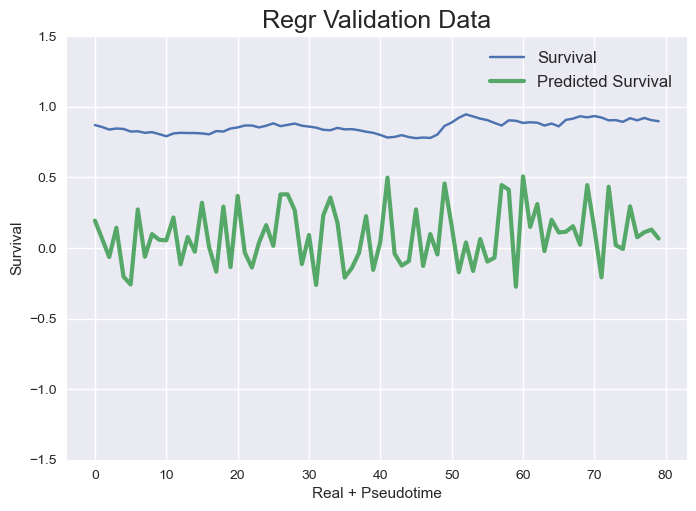

tf.Tensor(
[0.910412   0.816875   0.8824363  0.845423   0.95544153 0.88744473
 0.98777574 1.0588825  0.8086229  1.3011813 ], shape=(10,), dtype=float32)
{0.75: [0.00797798767073371, 0.5720731401484009, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.910412   0.816875   0.8824363  0.845423   0.95544153 0.88744473
 0.98777574 1.0588825  0.8086229  1.3011813 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0188 - mean_squared_error: 0.0188
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 3s 68ms/step - loss: 0.0173 - mean_squared_error: 0.0173 - val_loss: 0.1643 - val_mean_squared_error: 0.1643
Epoch 2/10
19/20 [===========================>..] - ETA: 0s - loss: 0.0047 - mean_squared_error: 0.0047
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [============

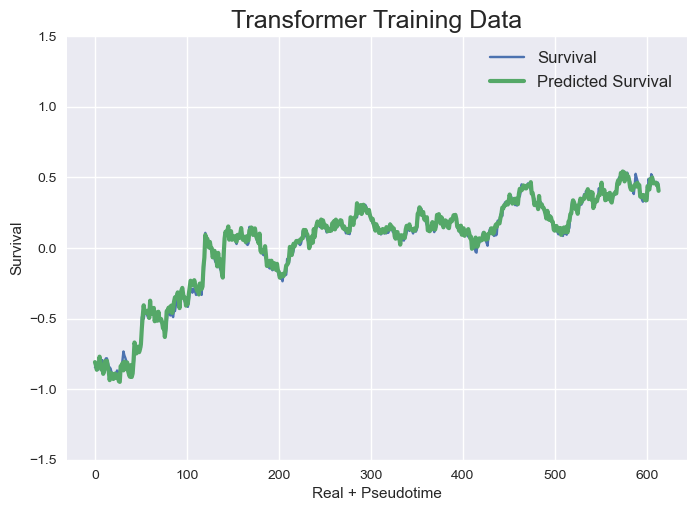

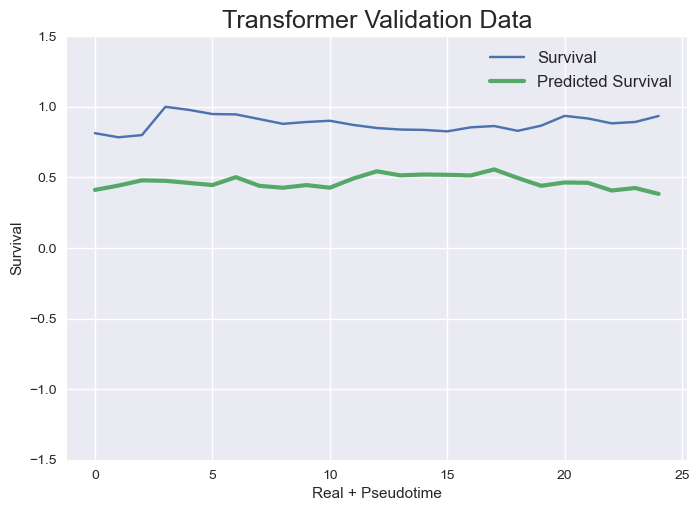

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


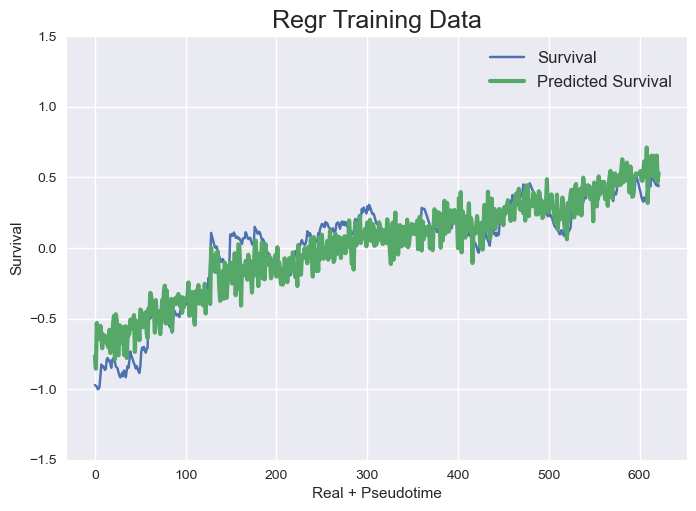

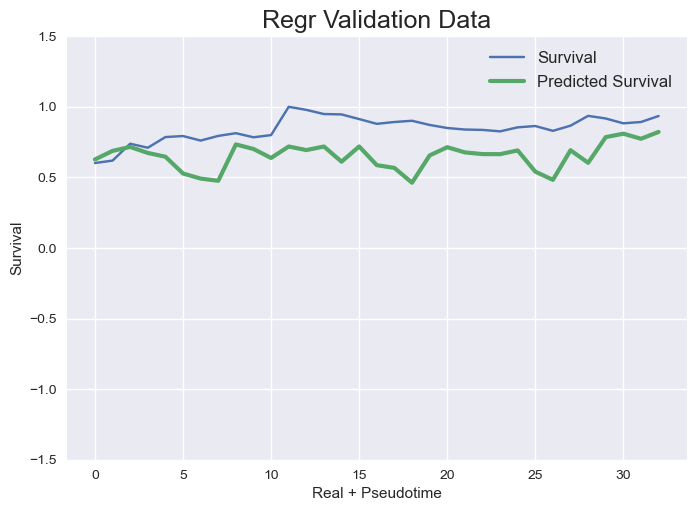

tf.Tensor(
[0.918169   0.82671595 0.88550174 0.8559224  0.9520685  0.8908126
 0.9879853  1.0442393  0.8075694  1.2920318 ], shape=(10,), dtype=float32)
{0.75: [0.001003660777111491, 0.17795837861439298, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.918169   0.82671595 0.88550174 0.8559224  0.9520685  0.8908126
 0.9879853  1.0442393  0.8075694  1.2920318 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.1688 - mean_squared_error: 0.1688
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 48ms/step - loss: 0.1593 - mean_squared_error: 0.1593 - val_loss: 0.1453 - val_mean_squared_error: 0.1453
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0405 - mean_squared_error: 0.0405
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

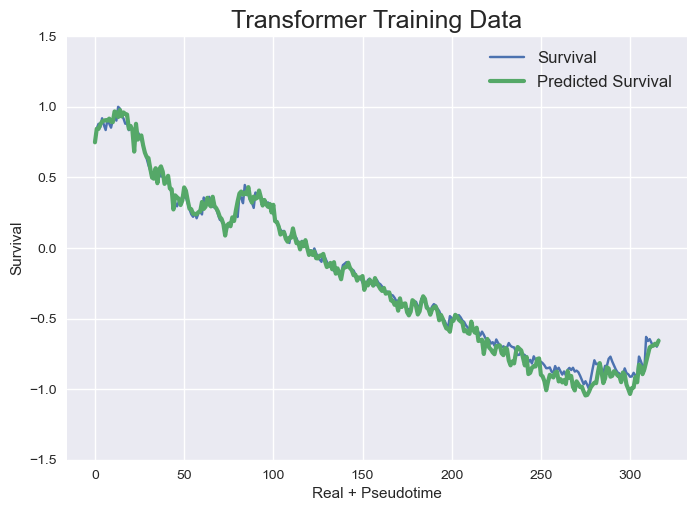

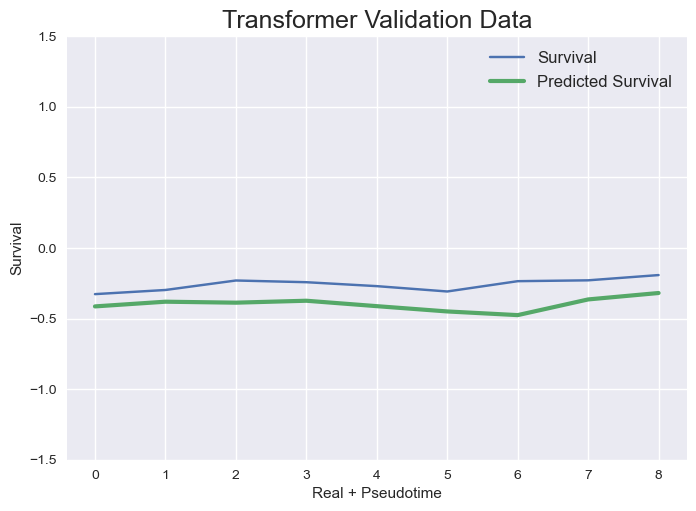

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


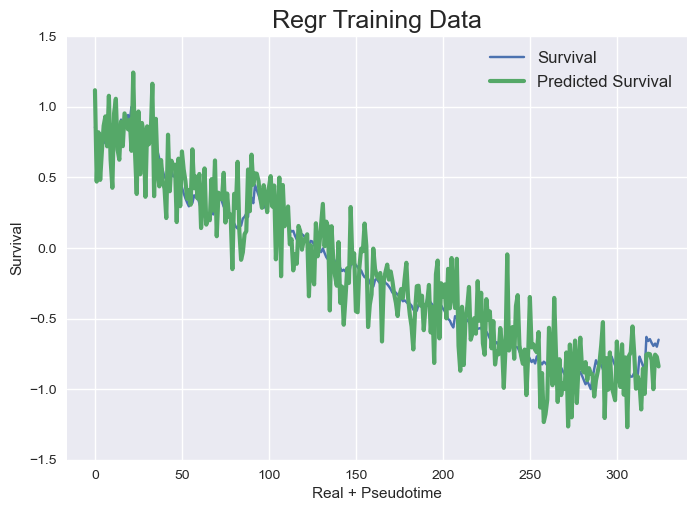

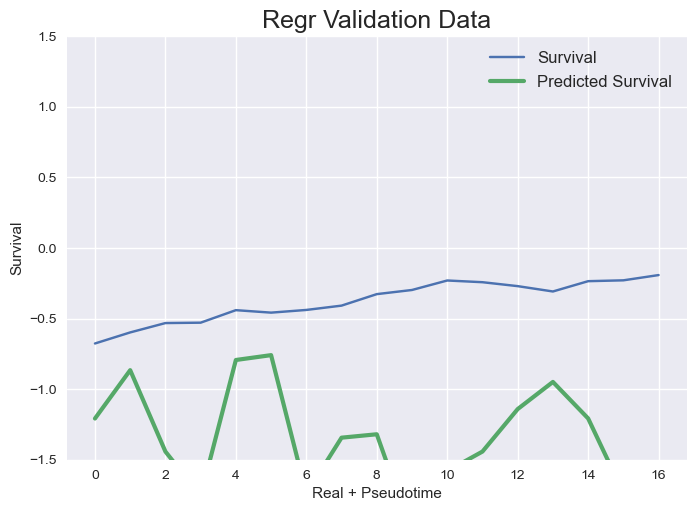

tf.Tensor(
[0.9208325  0.82298183 0.8738275  0.8604752  0.93457824 0.8813318
 0.9936517  1.0684675  0.8119433  1.3002203 ], shape=(10,), dtype=float32)
{0.75: [0.0026233116244701645, 0.020972162938280556, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9208325  0.82298183 0.8738275  0.8604752  0.93457824 0.8813318
 0.9936517  1.0684675  0.8119433  1.3002203 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.1027 - mean_squared_error: 0.1027
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 46ms/step - loss: 0.0979 - mean_squared_error: 0.0979 - val_loss: 0.1320 - val_mean_squared_error: 0.1320
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0362 - mean_squared_error: 0.0362
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [===========

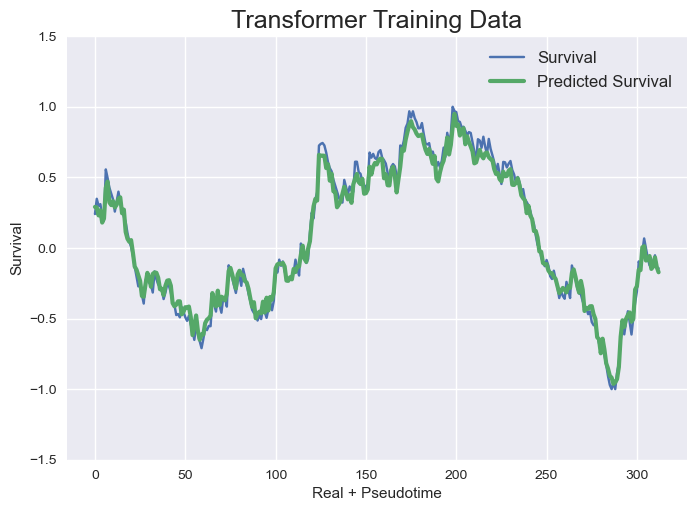

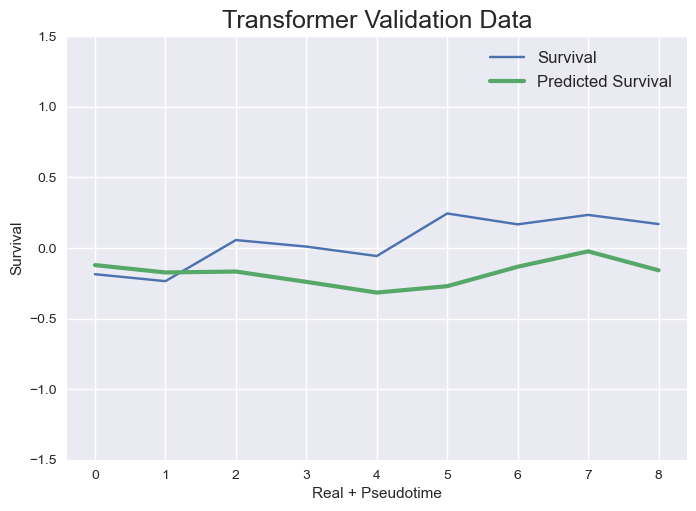

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


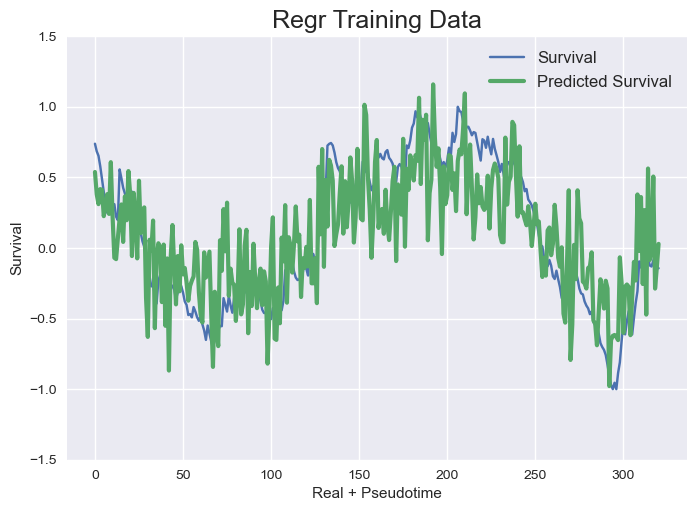

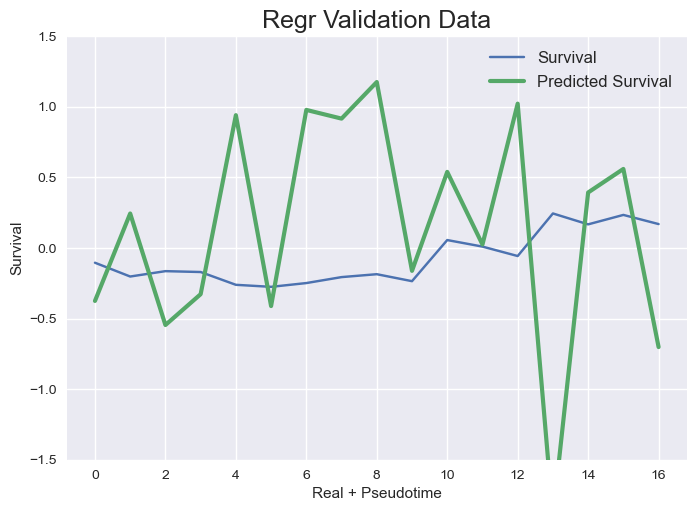

tf.Tensor(
[0.9088091  0.8279411  0.86902505 0.8643032  0.9313379  0.9098897
 1.0099338  1.059108   0.79588705 1.2961298 ], shape=(10,), dtype=float32)
{0.75: [0.003518412191491573, 0.079635654523578, 0.09963663912416548, 0.7911836007528895]}
5 
 5 
 5



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.9088091  0.8279411  0.86902505 0.8643032  0.9313379  0.9098897
 1.0099338  1.059108   0.79588705 1.2961298 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0520 - mean_squared_error: 0.0520
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 115ms/step - loss: 0.0447 - mean_squared_error: 0.0447 - val_loss: 0.4611 - val_mean_squared_error: 0.4611
Epoch 2/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0225 - mean_squared_error: 0.0225
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [===

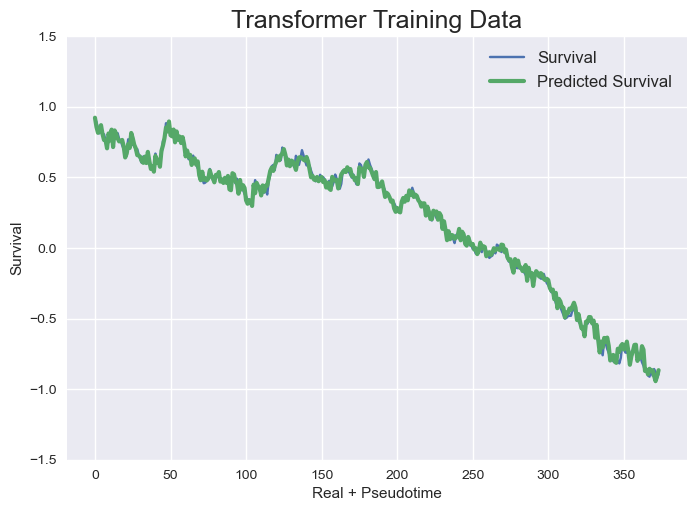

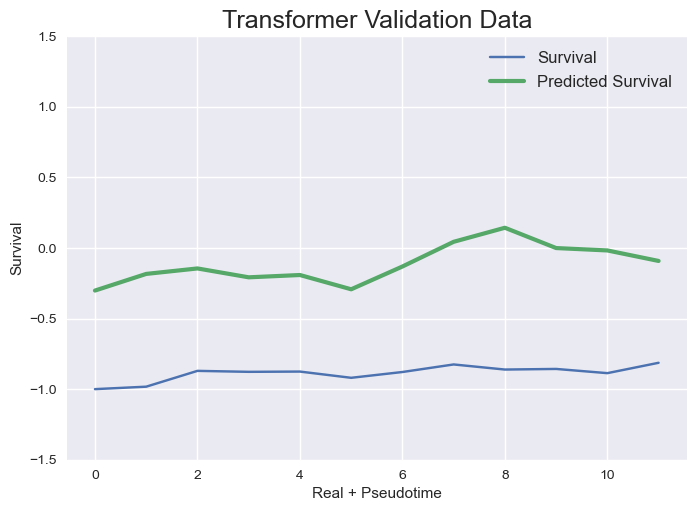

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


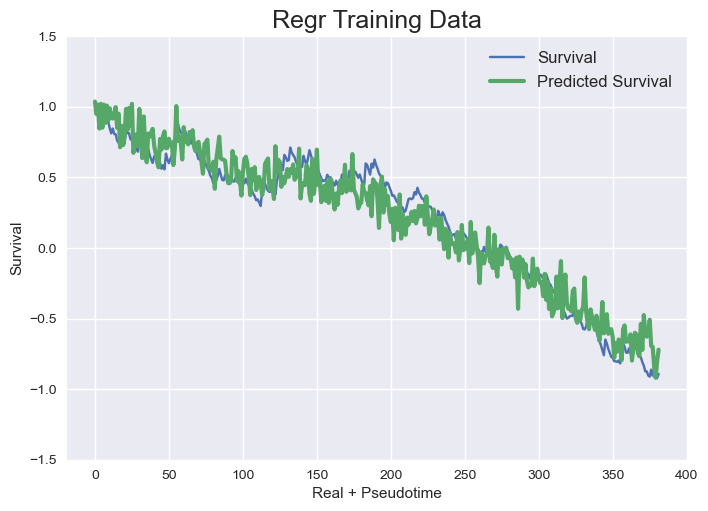

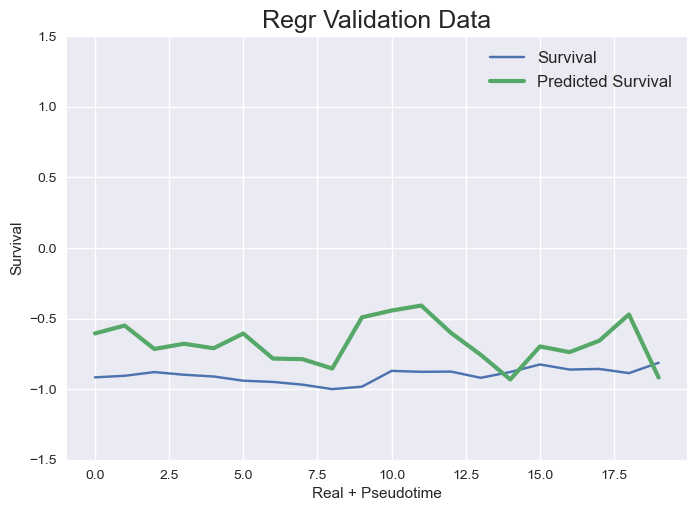

tf.Tensor(
[0.90232944 0.8138138  0.8772117  0.8784151  0.9357015  0.9129478
 1.0145328  1.0740376  0.7930508  1.2921308 ], shape=(10,), dtype=float32)
{0.75: [0.001155320704512524, 0.6077255924145427, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.90232944 0.8138138  0.8772117  0.8784151  0.9357015  0.9129478
 1.0145328  1.0740376  0.7930508  1.2921308 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0403 - mean_squared_error: 0.0403
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 46ms/step - loss: 0.0391 - mean_squared_error: 0.0391 - val_loss: 0.0411 - val_mean_squared_error: 0.0411
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0145 - mean_squared_error: 0.0145
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [============

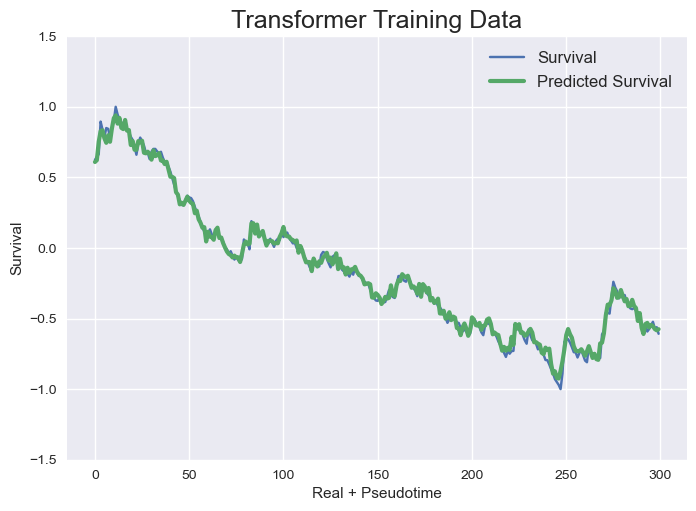

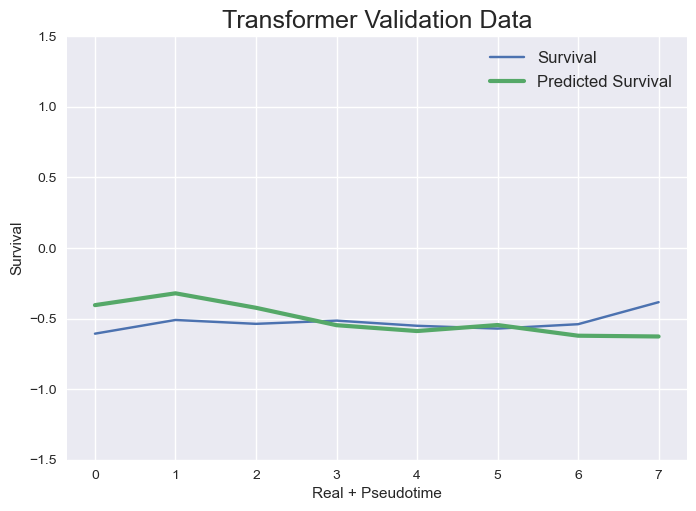

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


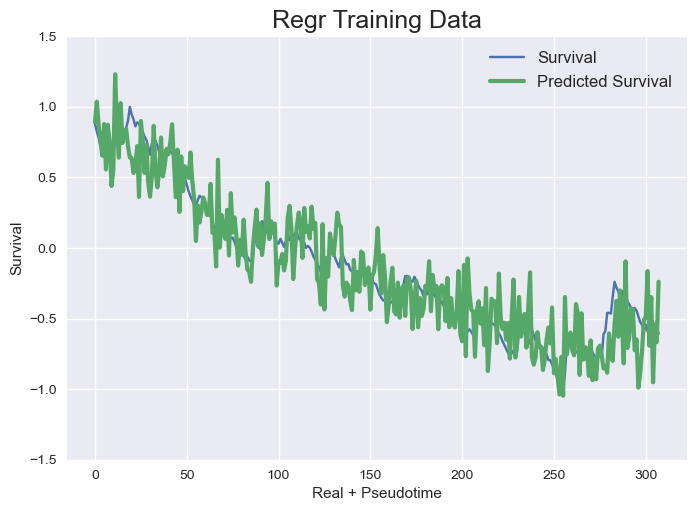

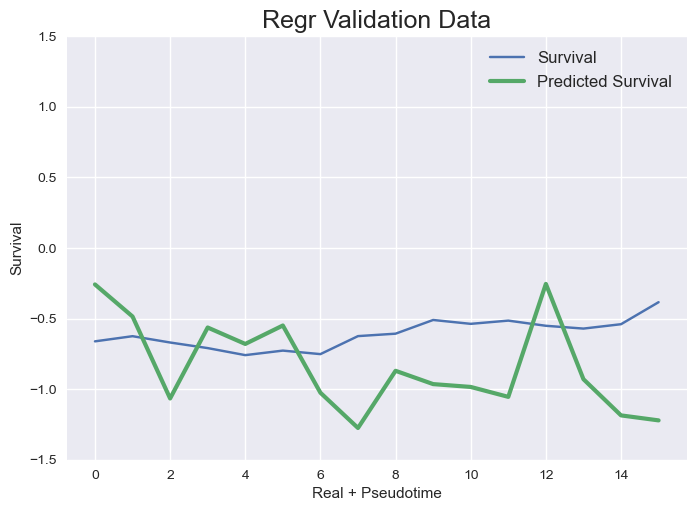

tf.Tensor(
[0.8995574  0.82149386 0.8780151  0.8774888  0.9343329  0.9066271
 1.0089431  1.0884094  0.78927463 1.2925223 ], shape=(10,), dtype=float32)
{0.75: [0.0012295472741397889, 0.01977854562586461, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.8995574  0.82149386 0.8780151  0.8774888  0.9343329  0.9066271
 1.0089431  1.0884094  0.78927463 1.2925223 ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0687 - mean_squared_error: 0.0687
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 35ms/step - loss: 0.0665 - mean_squared_error: 0.0665 - val_loss: 0.5209 - val_mean_squared_error: 0.5209
Epoch 2/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0166 - mean_squared_error: 0.0166
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [============

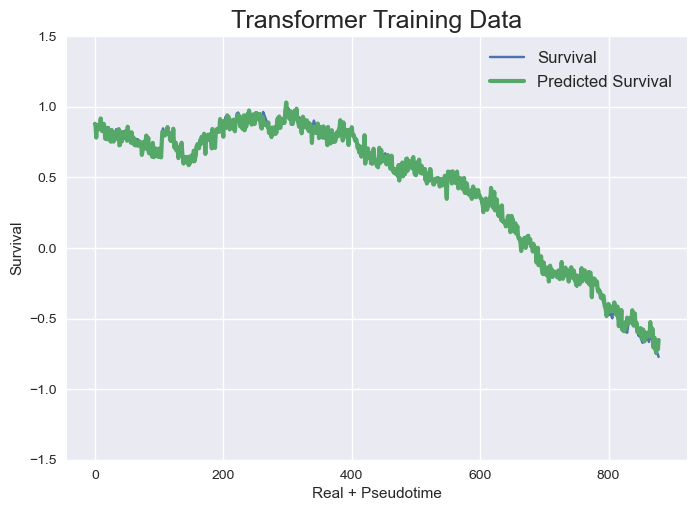

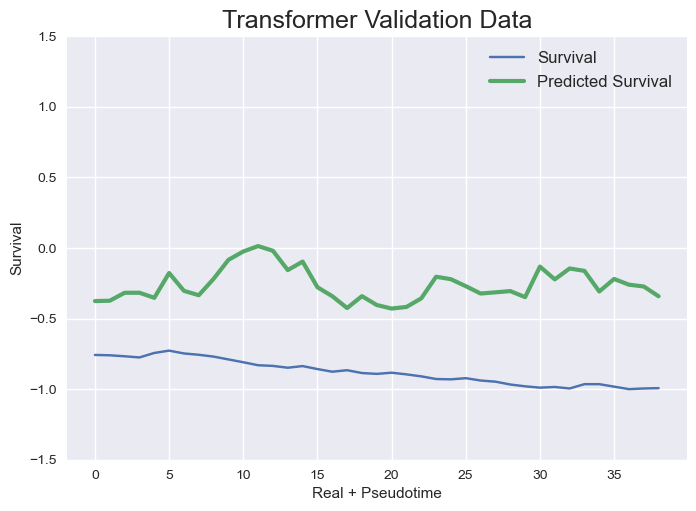

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


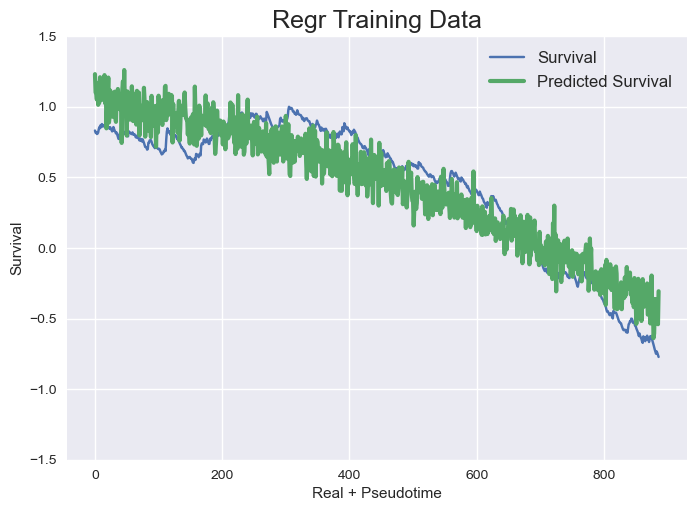

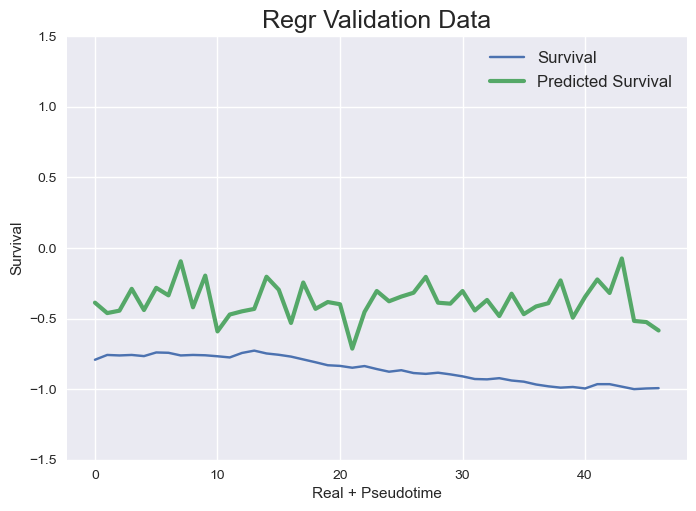

tf.Tensor(
[0.8952585  0.81709784 0.89376575 0.90175605 0.9511021  0.9189986
 1.0150182  1.0972285  0.78350234 1.2886797 ], shape=(10,), dtype=float32)
{0.75: [0.0012784058644831626, 0.40273700815740227, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.8952585  0.81709784 0.89376575 0.90175605 0.9511021  0.9189986
 1.0150182  1.0972285  0.78350234 1.2886797 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.1372 - mean_squared_error: 0.1372
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 24ms/step - loss: 0.1330 - mean_squared_error: 0.1330 - val_loss: 0.0215 - val_mean_squared_error: 0.0215
Epoch 2/10
38/39 [============================>.] - ETA: 0s - loss: 0.0123 - mean_squared_error: 0.0123
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [==========

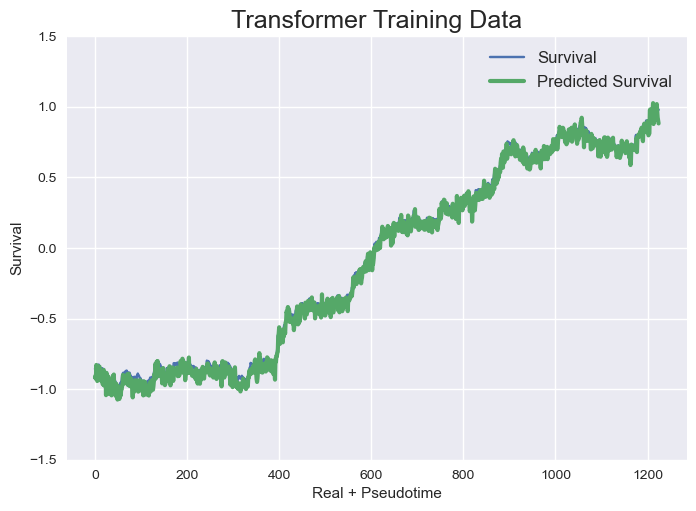

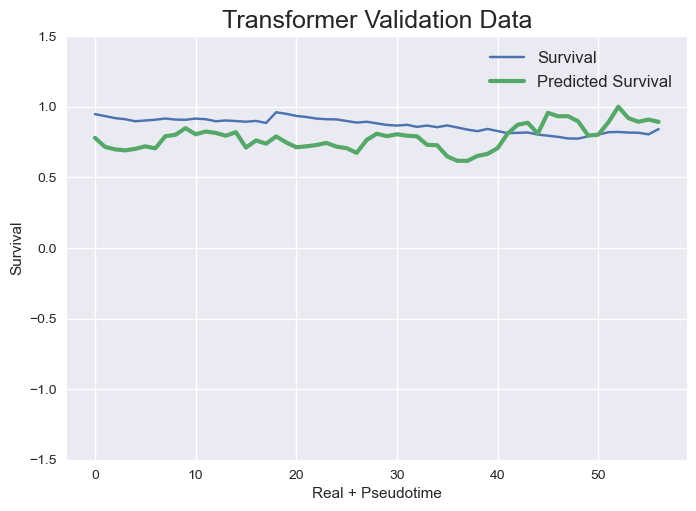

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


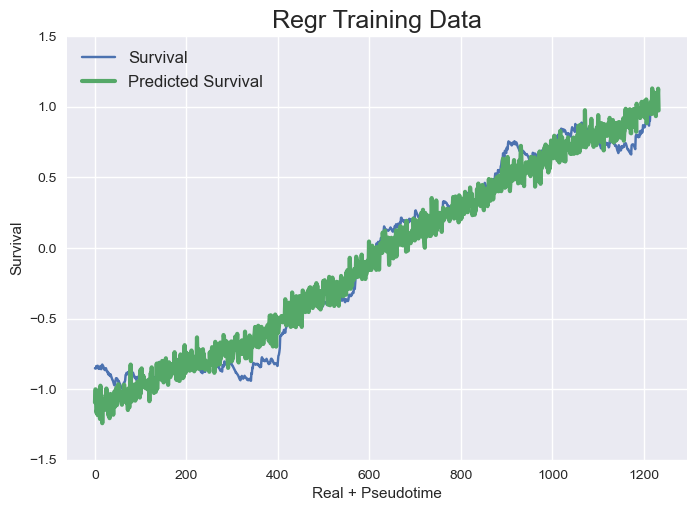

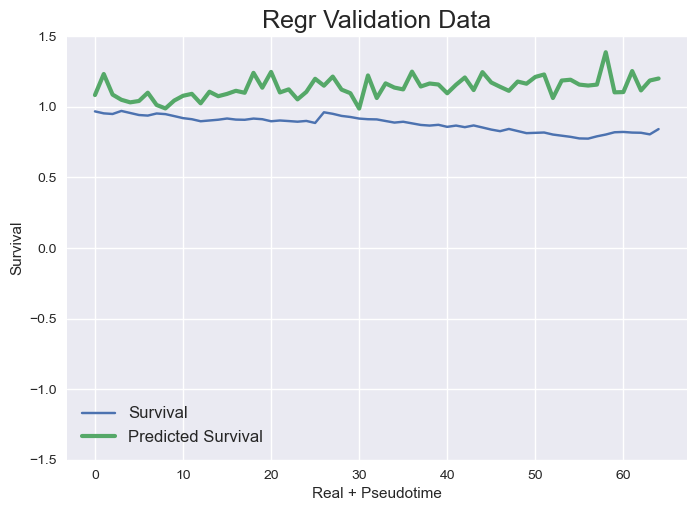

tf.Tensor(
[0.90814024 0.8176231  0.87485975 0.8844104  0.9345629  0.91776615
 1.0406706  1.0554134  0.7890831  1.2930447 ], shape=(10,), dtype=float32)
{0.75: [0.0023980503402666665, 0.02196965783977532, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.90814024 0.8176231  0.87485975 0.8844104  0.9345629  0.91776615
 1.0406706  1.0554134  0.7890831  1.2930447 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.1009 - mean_squared_error: 0.1009
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 33ms/step - loss: 0.0983 - mean_squared_error: 0.0983 - val_loss: 1.9875 - val_mean_squared_error: 1.9875
Epoch 2/10
31/32 [============================>.] - ETA: 0s - loss: 0.0322 - mean_squared_error: 0.0322
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [========

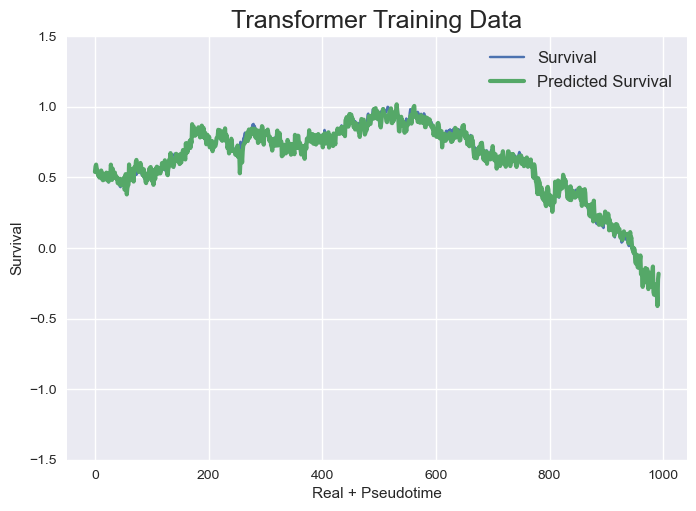

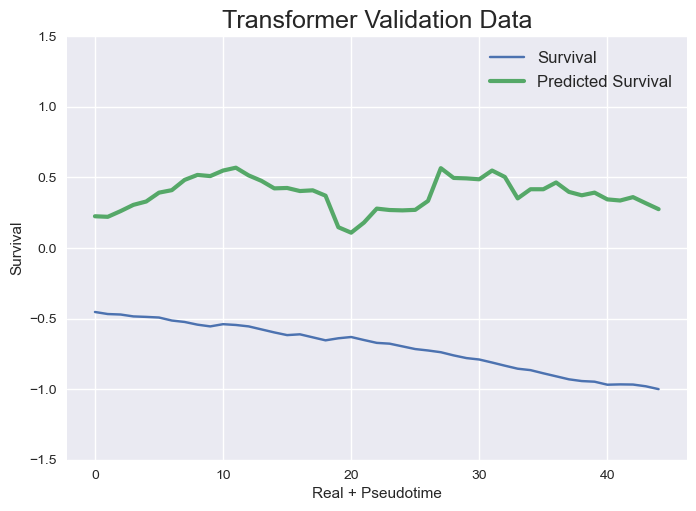

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


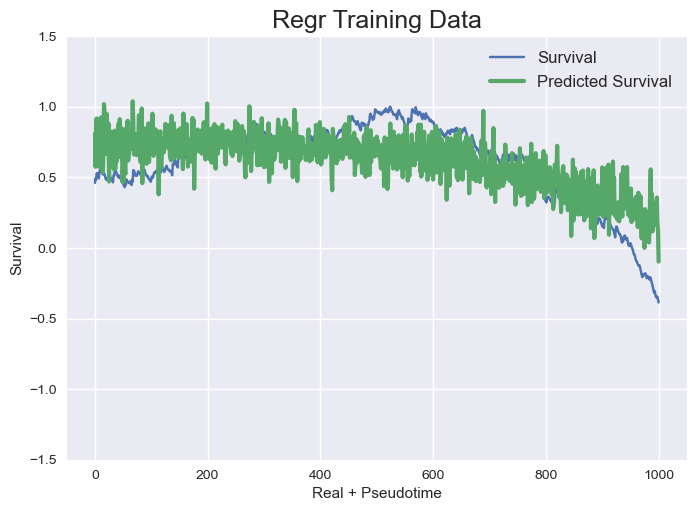

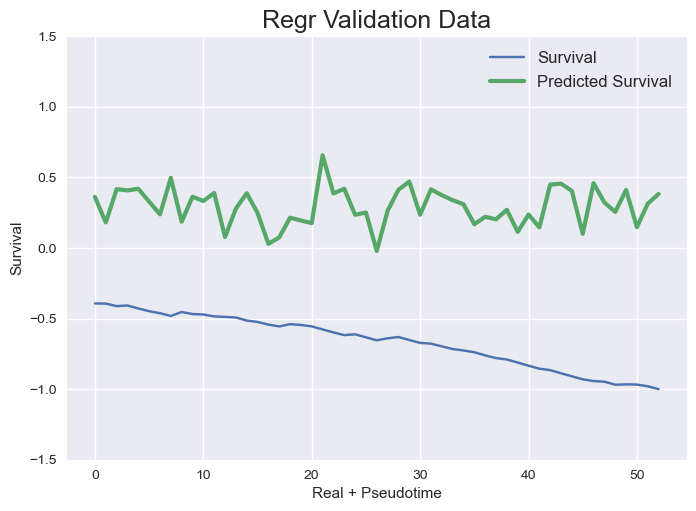

tf.Tensor(
[0.90792686 0.82572144 0.8545331  0.8674133  0.9408454  0.9062981
 1.0281423  1.0727667  0.78839344 1.3091878 ], shape=(10,), dtype=float32)
{0.75: [0.0013846993111614075, 1.2210241728372857, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.90792686 0.82572144 0.8545331  0.8674133  0.9408454  0.9062981
 1.0281423  1.0727667  0.78839344 1.3091878 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0842 - mean_squared_error: 0.0842
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 27ms/step - loss: 0.0809 - mean_squared_error: 0.0809 - val_loss: 0.7776 - val_mean_squared_error: 0.7776
Epoch 2/10
46/48 [===========================>..] - ETA: 0s - loss: 0.0125 - mean_squared_error: 0.0125
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [===========

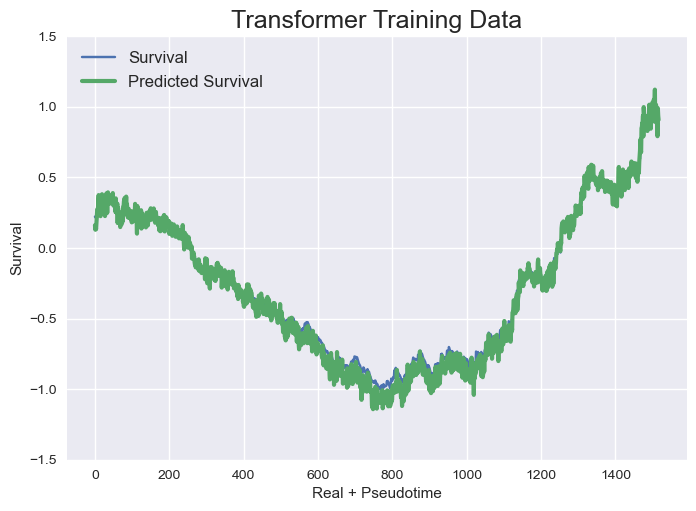

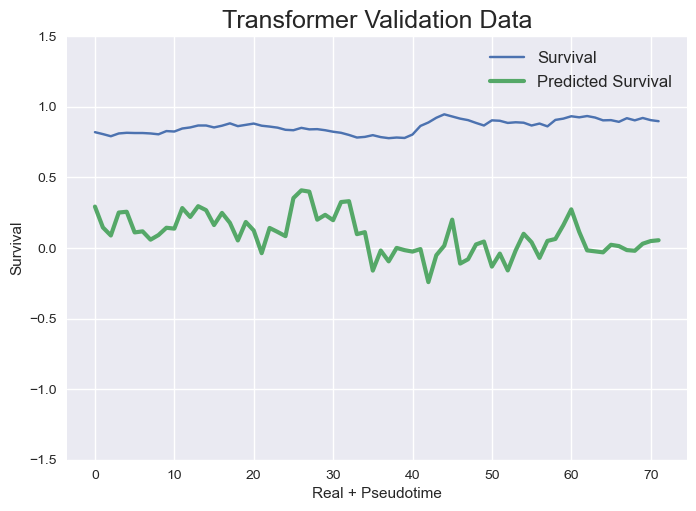

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


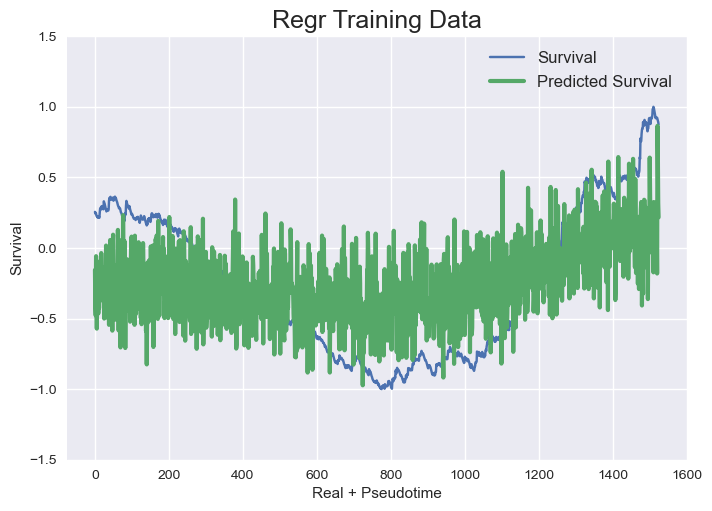

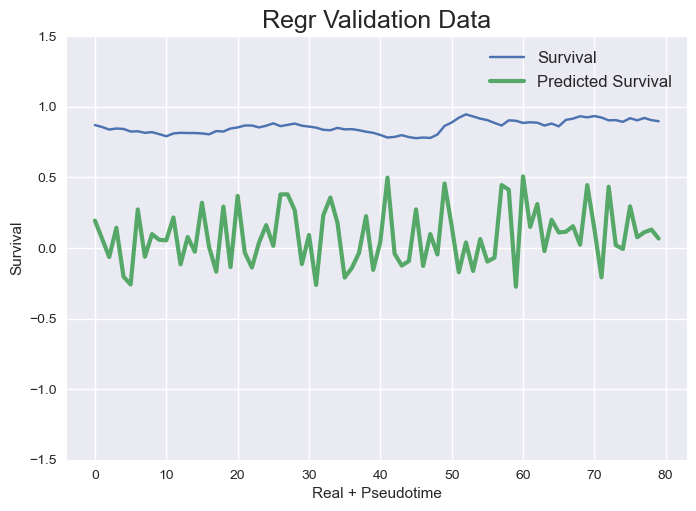

tf.Tensor(
[0.91082793 0.7937832  0.8416923  0.8512095  0.9592033  0.9048185
 1.0144212  1.0861913  0.77780086 1.3125721 ], shape=(10,), dtype=float32)
{0.75: [0.0038159480184293375, 0.6155069621636146, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.91082793 0.7937832  0.8416923  0.8512095  0.9592033  0.9048185
 1.0144212  1.0861913  0.77780086 1.3125721 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0167 - mean_squared_error: 0.0167
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 3s 46ms/step - loss: 0.0155 - mean_squared_error: 0.0155 - val_loss: 0.1665 - val_mean_squared_error: 0.1665
Epoch 2/10
19/20 [===========================>..] - ETA: 0s - loss: 0.0046 - mean_squared_error: 0.0046
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [============

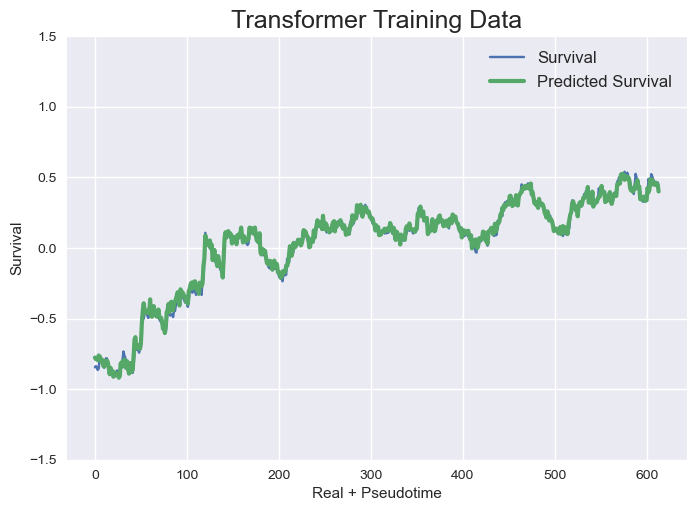

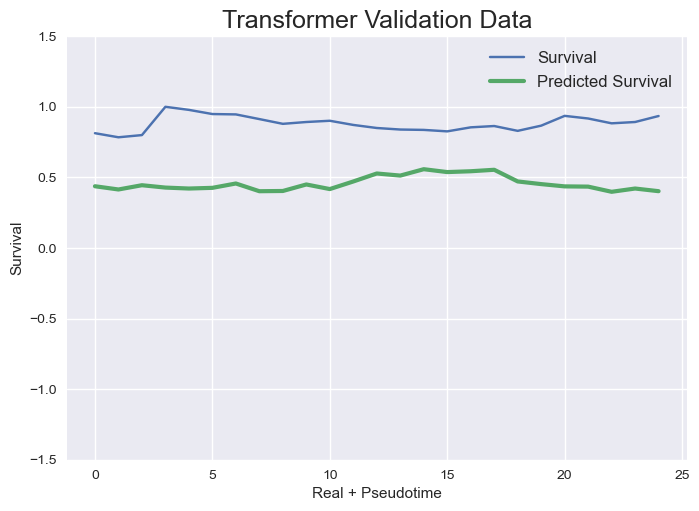

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


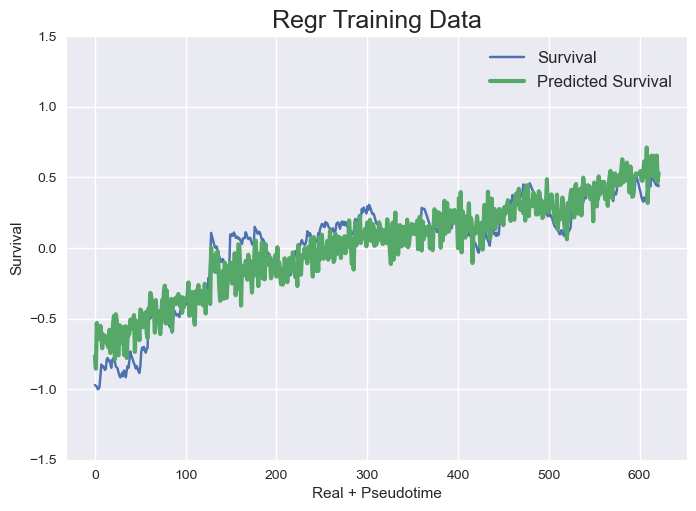

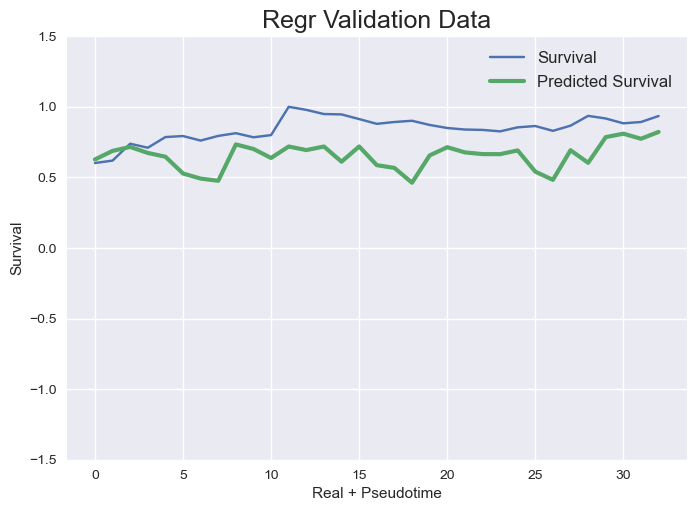

tf.Tensor(
[0.9167893  0.79241824 0.8460319  0.8523817  0.95936024 0.912049
 1.0157604  1.06949    0.7730964  1.3041767 ], shape=(10,), dtype=float32)
{0.75: [0.0009701278707719912, 0.18877978894475456, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9167893  0.79241824 0.8460319  0.8523817  0.95936024 0.912049
 1.0157604  1.06949    0.7730964  1.3041767 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0951 - mean_squared_error: 0.0951
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 41ms/step - loss: 0.0916 - mean_squared_error: 0.0916 - val_loss: 0.2411 - val_mean_squared_error: 0.2411
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0358 - mean_squared_error: 0.0358
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [===========

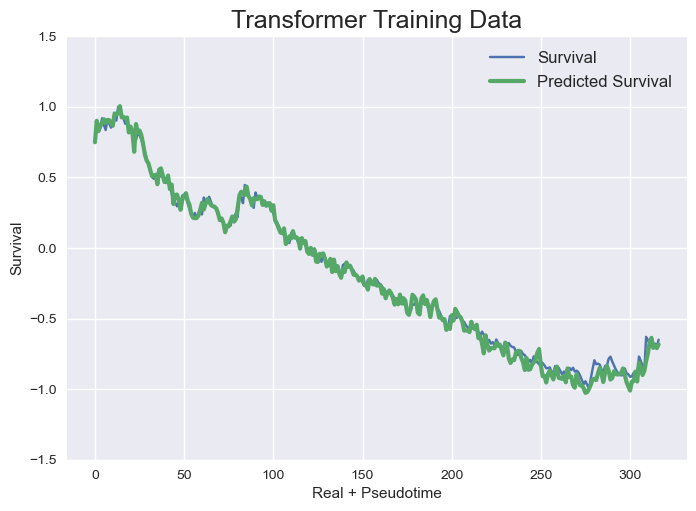

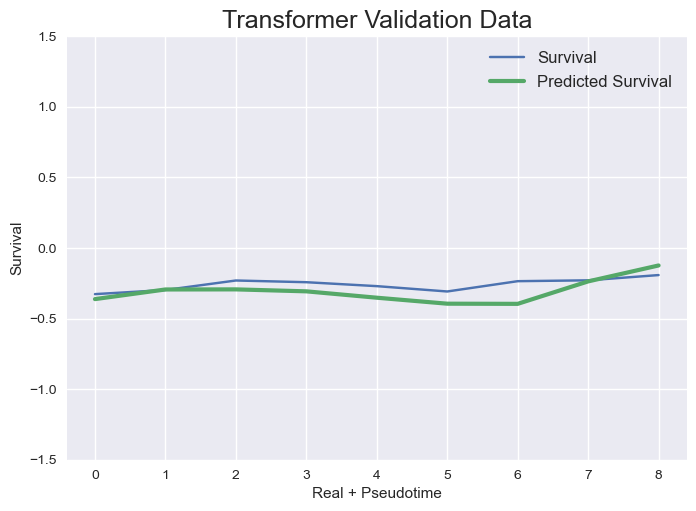

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


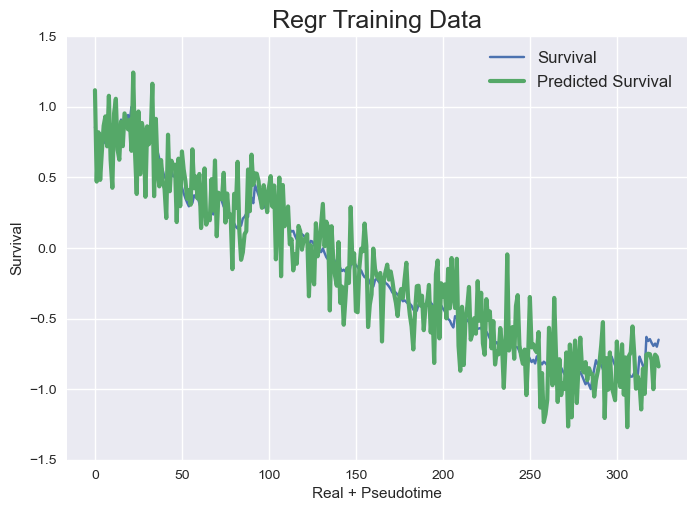

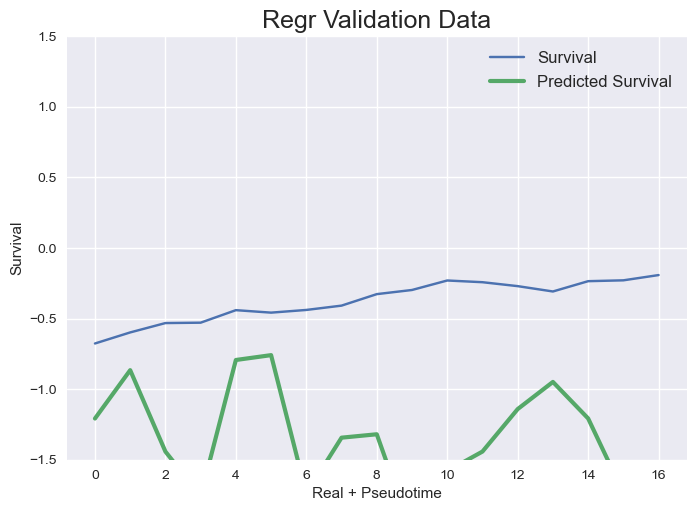

tf.Tensor(
[0.9242457  0.79682624 0.8425544  0.8497613  0.9565093  0.913723
 1.0161741  1.0978451  0.7785697  1.3182566 ], shape=(10,), dtype=float32)
{0.75: [0.0020970662336225044, 0.006009189148964769, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9242457  0.79682624 0.8425544  0.8497613  0.9565093  0.913723
 1.0161741  1.0978451  0.7785697  1.3182566 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0629 - mean_squared_error: 0.0629
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 46ms/step - loss: 0.0606 - mean_squared_error: 0.0606 - val_loss: 0.2262 - val_mean_squared_error: 0.2262
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0302 - mean_squared_error: 0.0302
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=============

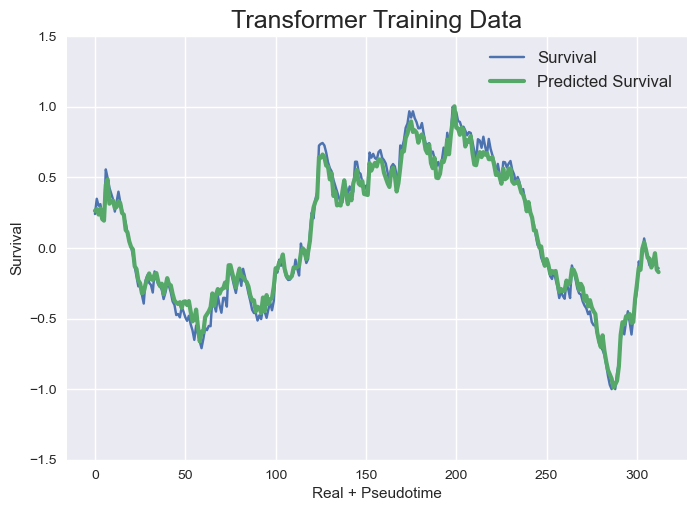

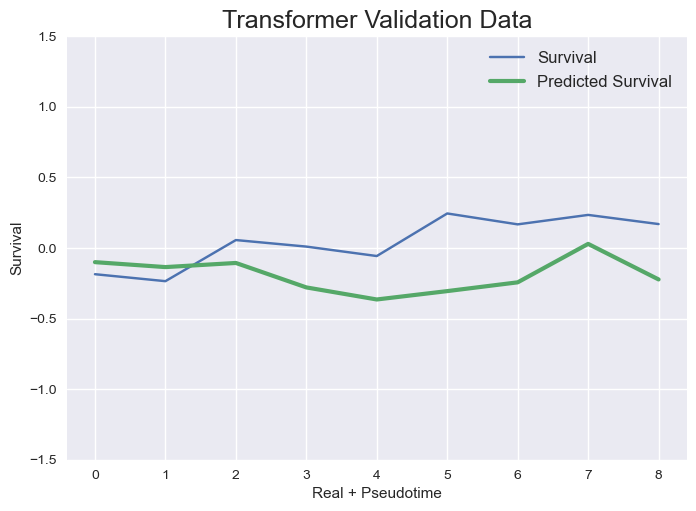

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


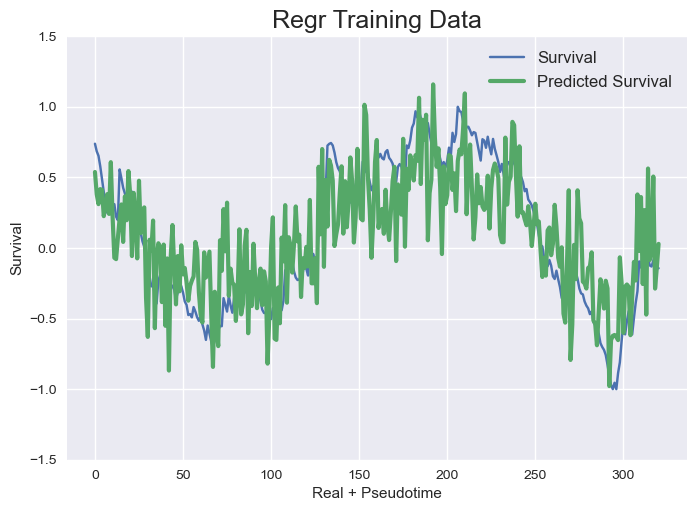

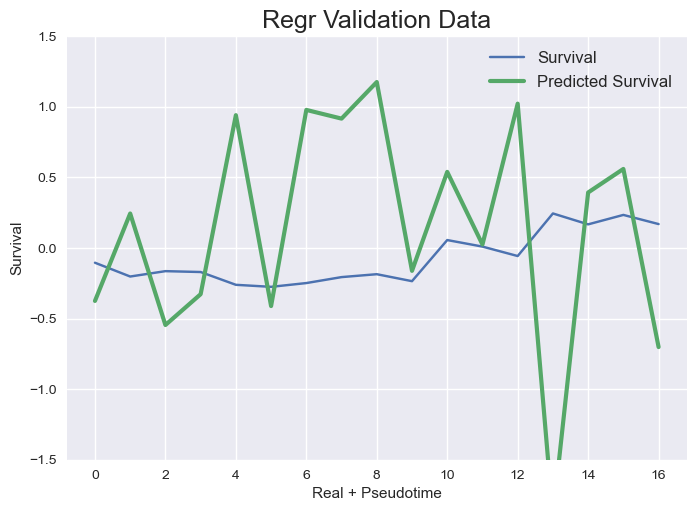

tf.Tensor(
[0.9201618  0.79338044 0.84506243 0.865784   0.9467804  0.9195951
 1.0160656  1.0893749  0.78112084 1.3135741 ], shape=(10,), dtype=float32)
{0.75: [0.003969845923539965, 0.098785622244713, 0.09963663912416548, 0.7911836007528895]}
6 
 6 
 6



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.9201618  0.79338044 0.84506243 0.865784   0.9467804  0.9195951
 1.0160656  1.0893749  0.78112084 1.3135741 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0485 - mean_squared_error: 0.0485
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 68ms/step - loss: 0.0434 - mean_squared_error: 0.0434 - val_loss: 0.5447 - val_mean_squared_error: 0.5447
Epoch 2/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0183 - mean_squared_error: 0.0183
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [====

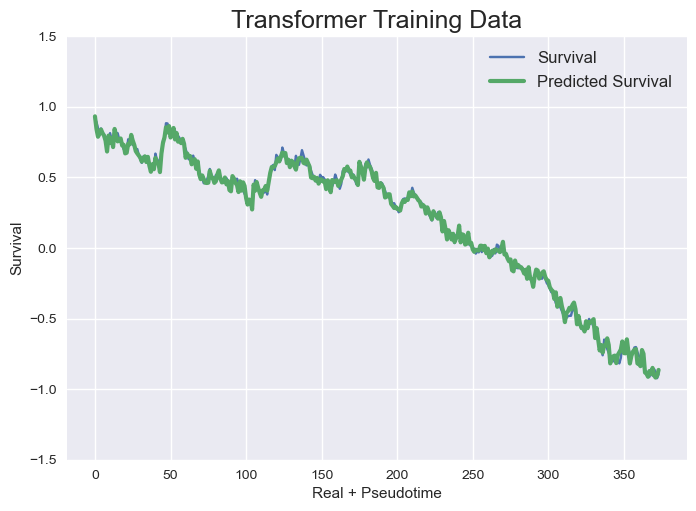

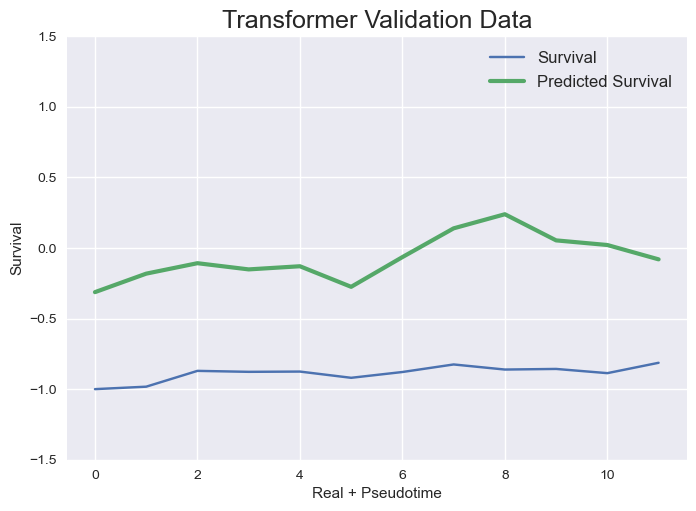

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


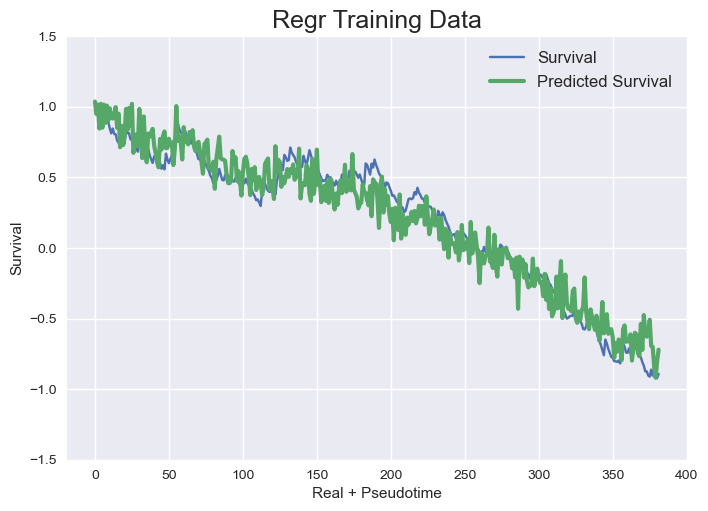

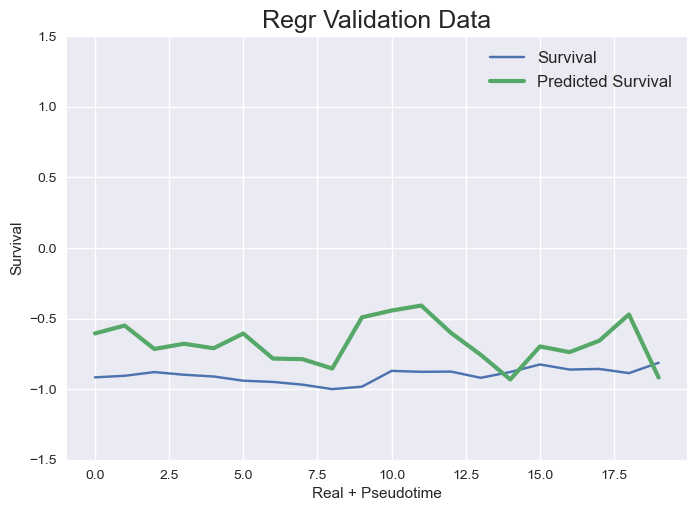

tf.Tensor(
[0.91281486 0.78684485 0.8487666  0.8795617  0.9475526  0.92328364
 1.0169094  1.1053475  0.77808917 1.308162  ], shape=(10,), dtype=float32)
{0.75: [0.0010046610763098532, 0.6821664465898963, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.91281486 0.78684485 0.8487666  0.8795617  0.9475526  0.92328364
 1.0169094  1.1053475  0.77808917 1.308162  ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0376 - mean_squared_error: 0.0376
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 75ms/step - loss: 0.0365 - mean_squared_error: 0.0365 - val_loss: 0.0313 - val_mean_squared_error: 0.0313
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0164 - mean_squared_error: 0.0164
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=========

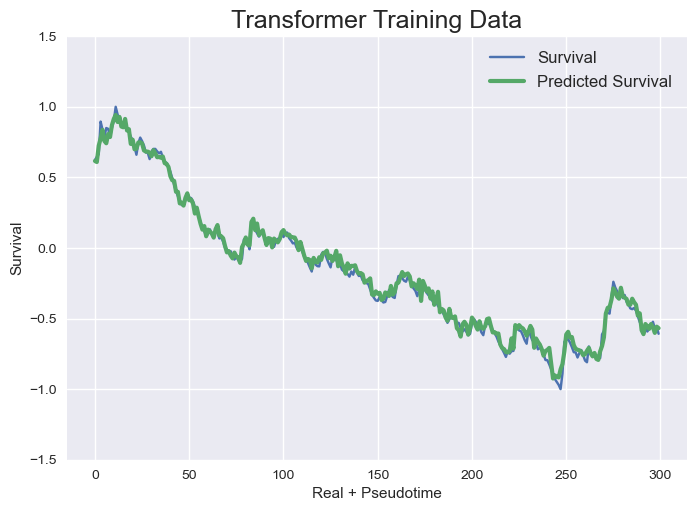

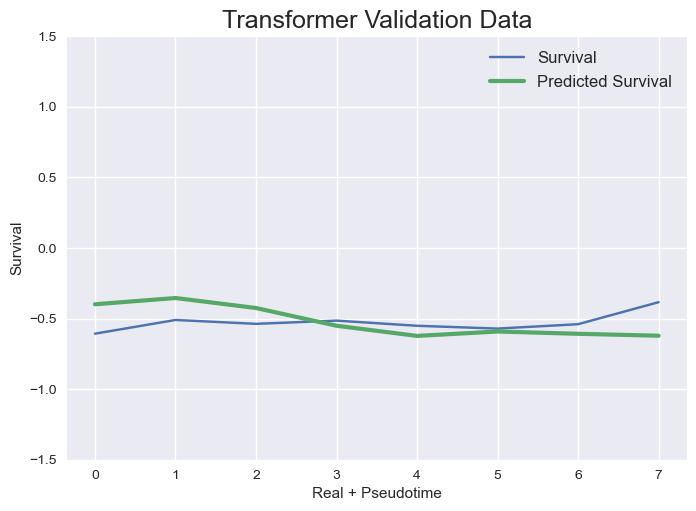

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


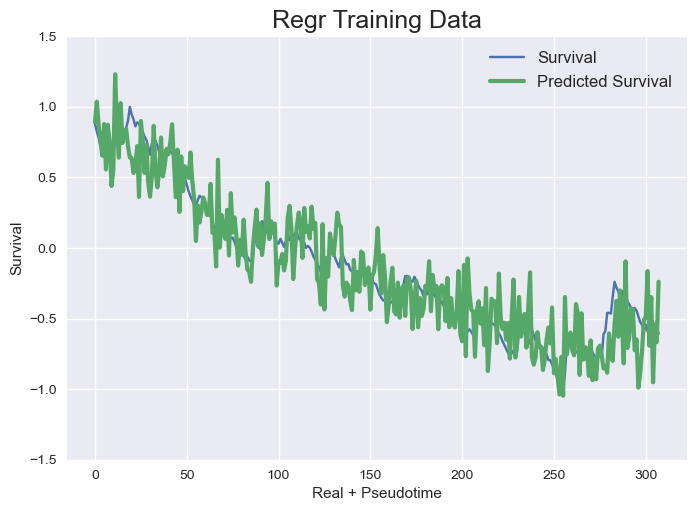

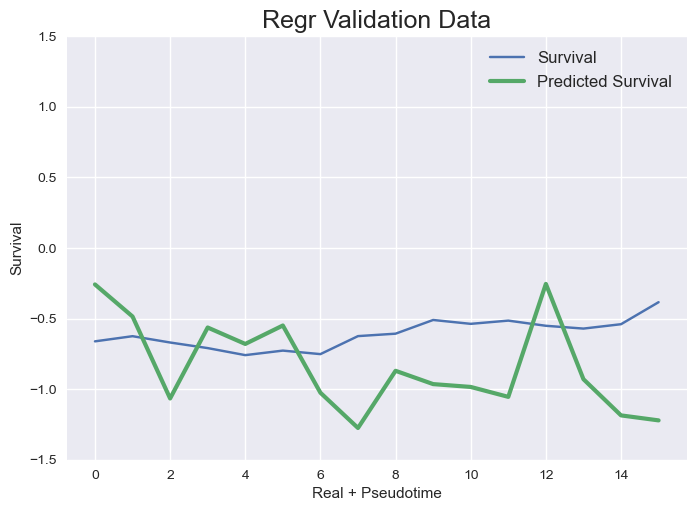

tf.Tensor(
[0.9127412  0.79558325 0.84666383 0.8714338  0.9544549  0.9222002
 1.0172329  1.1152103  0.77116686 1.3117478 ], shape=(10,), dtype=float32)
{0.75: [0.0015048441206650953, 0.01851312585195193, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.9127412  0.79558325 0.84666383 0.8714338  0.9544549  0.9222002
 1.0172329  1.1152103  0.77116686 1.3117478 ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0557 - mean_squared_error: 0.0557
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 35ms/step - loss: 0.0541 - mean_squared_error: 0.0541 - val_loss: 0.4626 - val_mean_squared_error: 0.4626
Epoch 2/10
27/28 [===========================>..] - ETA: 0s - loss: 0.0121 - mean_squared_error: 0.0121
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [============

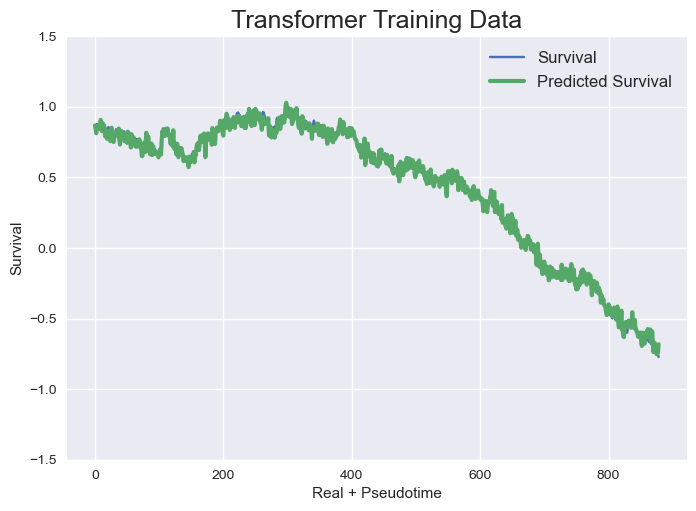

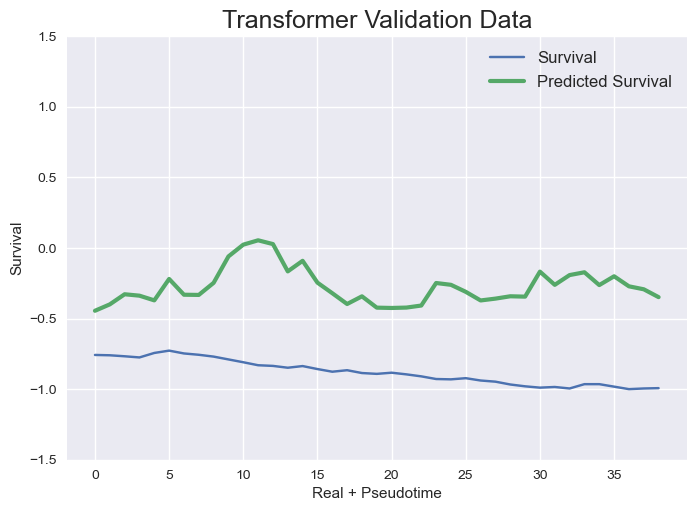

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


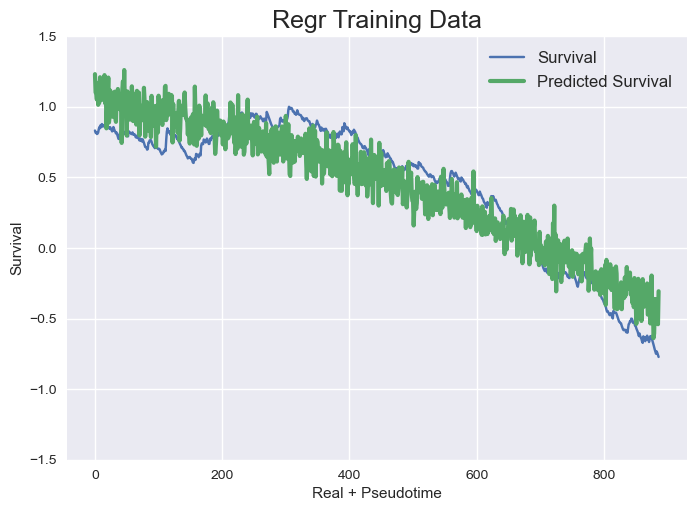

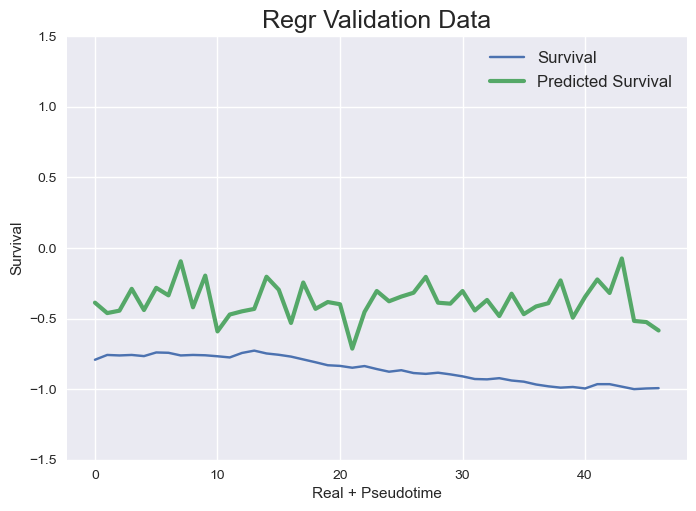

tf.Tensor(
[0.9088615  0.796021   0.85893047 0.9007442  0.96321213 0.9390309
 1.0265046  1.1262879  0.7682702  1.31309   ], shape=(10,), dtype=float32)
{0.75: [0.0011432931351769077, 0.3917564708543831, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.9088615  0.796021   0.85893047 0.9007442  0.96321213 0.9390309
 1.0265046  1.1262879  0.7682702  1.31309   ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0920 - mean_squared_error: 0.0920
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 31ms/step - loss: 0.0893 - mean_squared_error: 0.0893 - val_loss: 0.0359 - val_mean_squared_error: 0.0359
Epoch 2/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0080 - mean_squared_error: 0.0080
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [===========

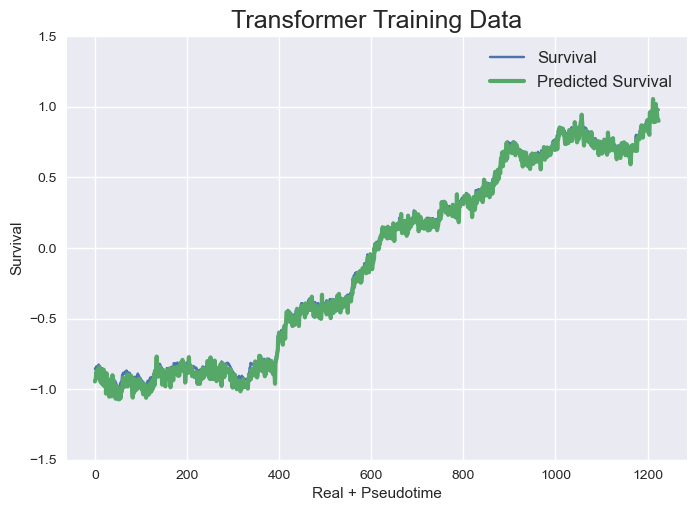

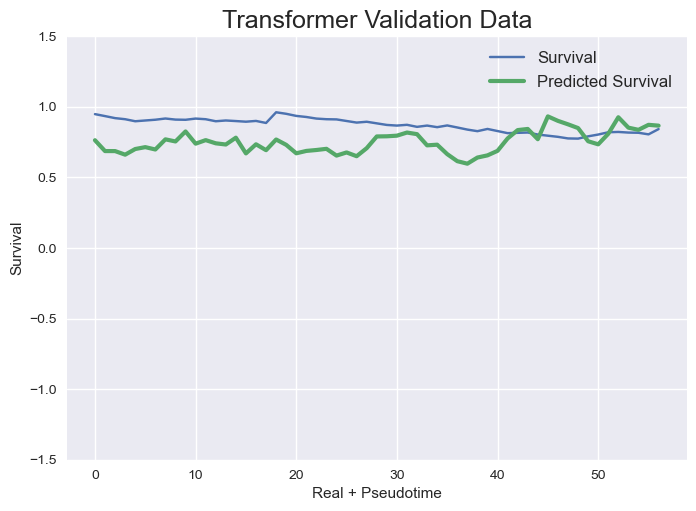

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


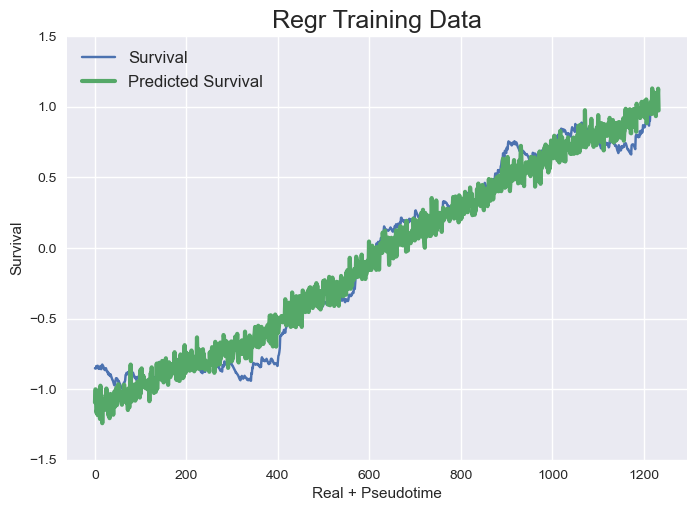

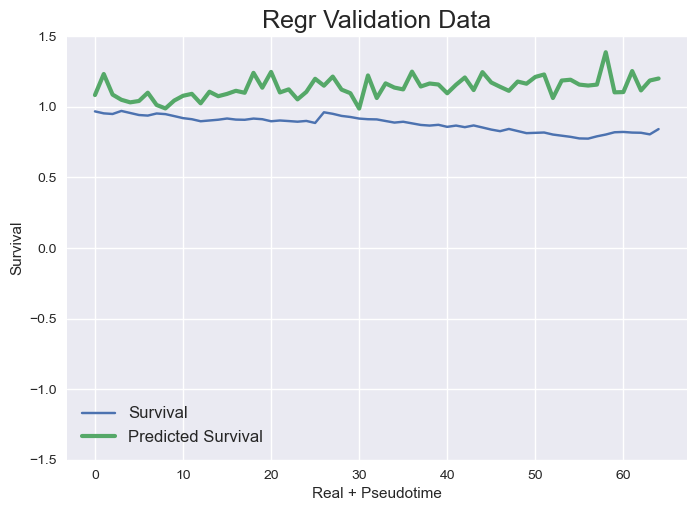

tf.Tensor(
[0.90910405 0.80874497 0.8534658  0.89530575 0.9595405  0.93703353
 1.0515931  1.0767857  0.7682809  1.327403  ], shape=(10,), dtype=float32)
{0.75: [0.002357847795262649, 0.026595223726780467, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.90910405 0.80874497 0.8534658  0.89530575 0.9595405  0.93703353
 1.0515931  1.0767857  0.7682809  1.327403  ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0805 - mean_squared_error: 0.0805
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 26ms/step - loss: 0.0778 - mean_squared_error: 0.0778 - val_loss: 1.9419 - val_mean_squared_error: 1.9419
Epoch 2/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0182 - mean_squared_error: 0.0182
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [========

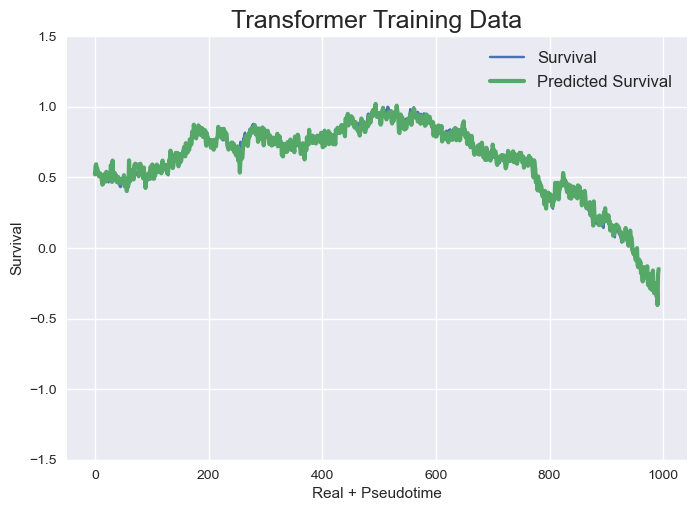

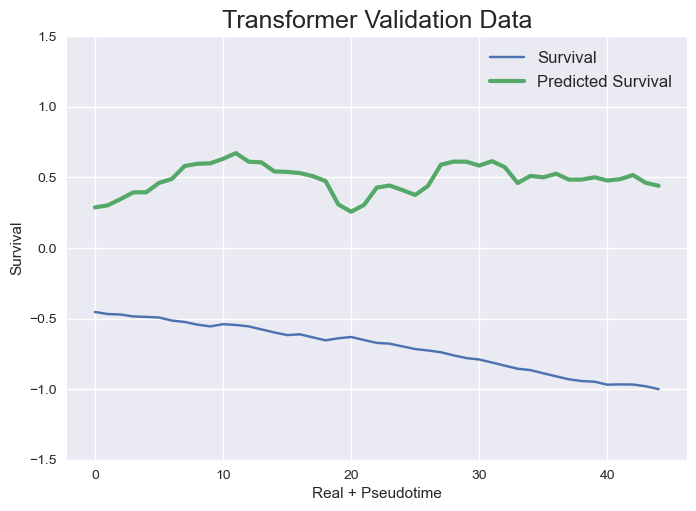

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


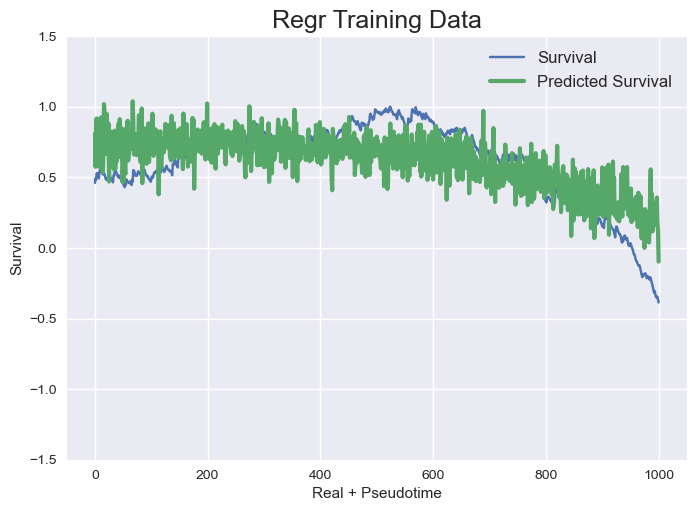

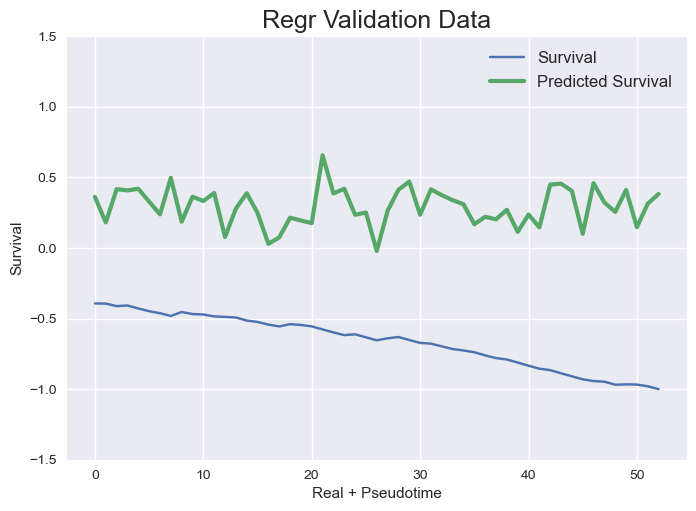

tf.Tensor(
[0.9086386  0.8139552  0.8342762  0.87528527 0.95536506 0.92083985
 1.058508   1.1012183  0.77378523 1.3550799 ], shape=(10,), dtype=float32)
{0.75: [0.0012491381661303932, 1.4643806439177722, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.9086386  0.8139552  0.8342762  0.87528527 0.95536506 0.92083985
 1.058508   1.1012183  0.77378523 1.3550799 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0688 - mean_squared_error: 0.0688
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 23ms/step - loss: 0.0659 - mean_squared_error: 0.0659 - val_loss: 0.7351 - val_mean_squared_error: 0.7351
Epoch 2/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0117 - mean_squared_error: 0.0117
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [=========

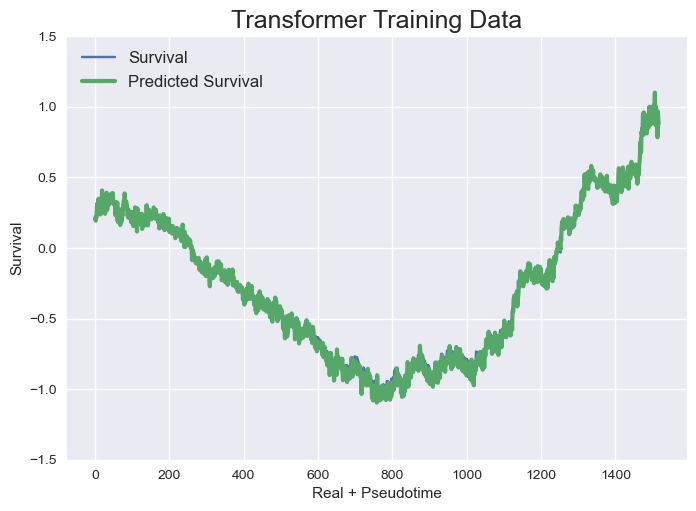

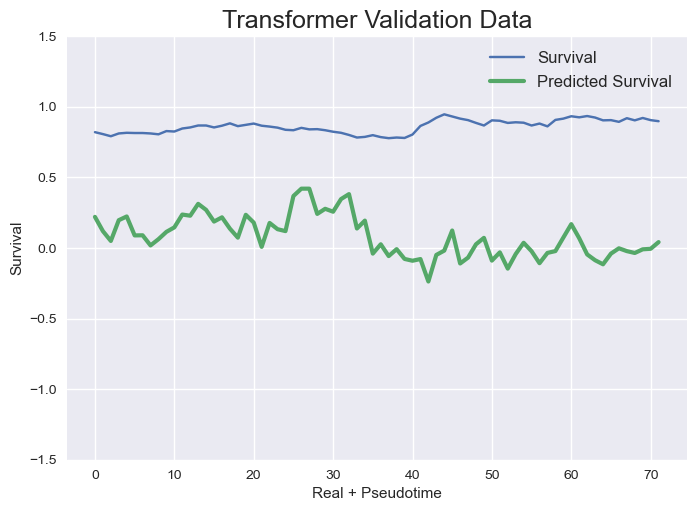

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


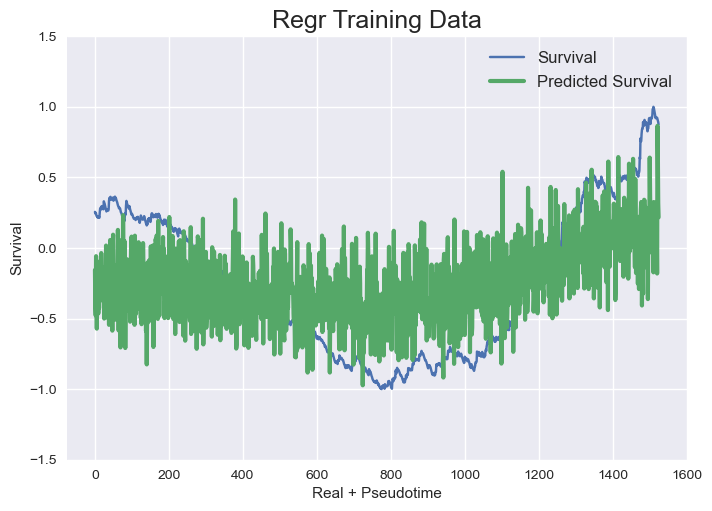

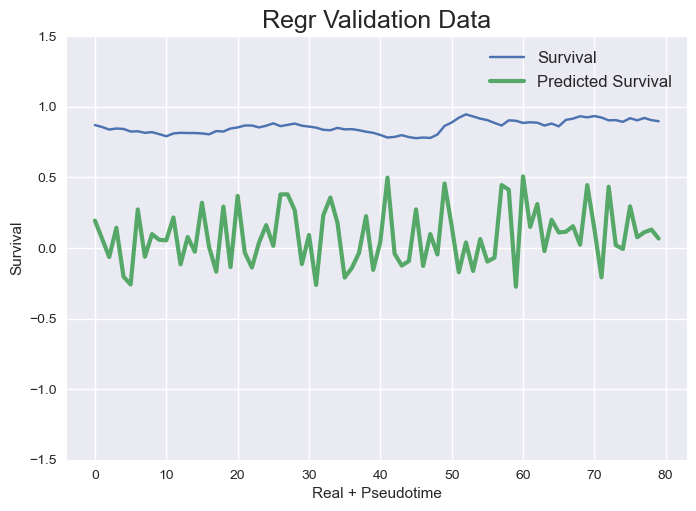

tf.Tensor(
[0.9168185  0.7899698  0.8161447  0.8426651  0.9789018  0.90617293
 1.0349394  1.1021795  0.7775457  1.3588953 ], shape=(10,), dtype=float32)
{0.75: [0.0019858722613962563, 0.6354376039892227, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.9168185  0.7899698  0.8161447  0.8426651  0.9789018  0.90617293
 1.0349394  1.1021795  0.7775457  1.3588953 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0152 - mean_squared_error: 0.0152
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 3s 43ms/step - loss: 0.0143 - mean_squared_error: 0.0143 - val_loss: 0.2070 - val_mean_squared_error: 0.2070
Epoch 2/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0049 - mean_squared_error: 0.0049
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==========

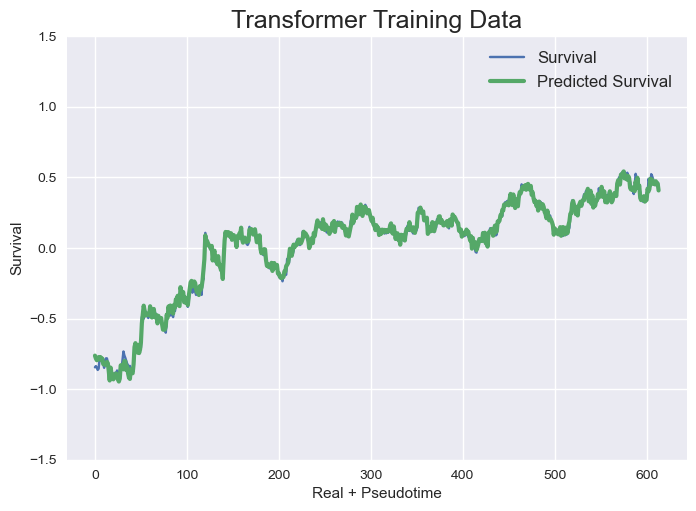

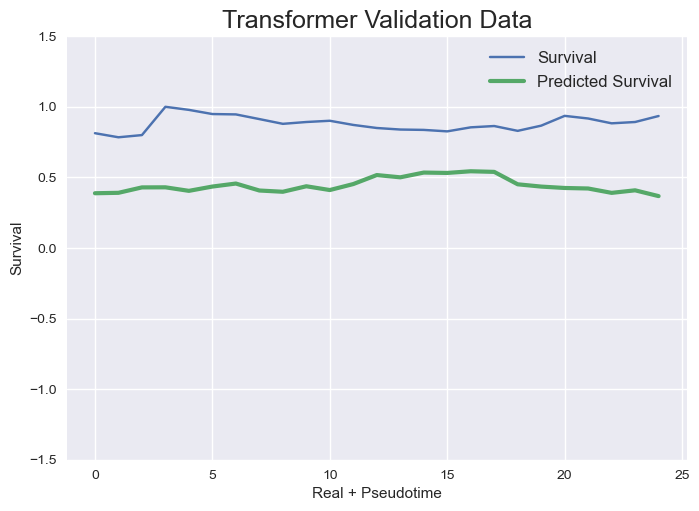

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


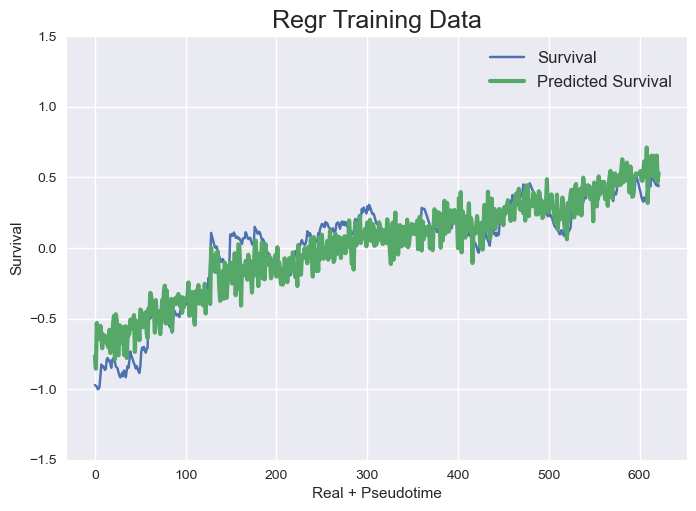

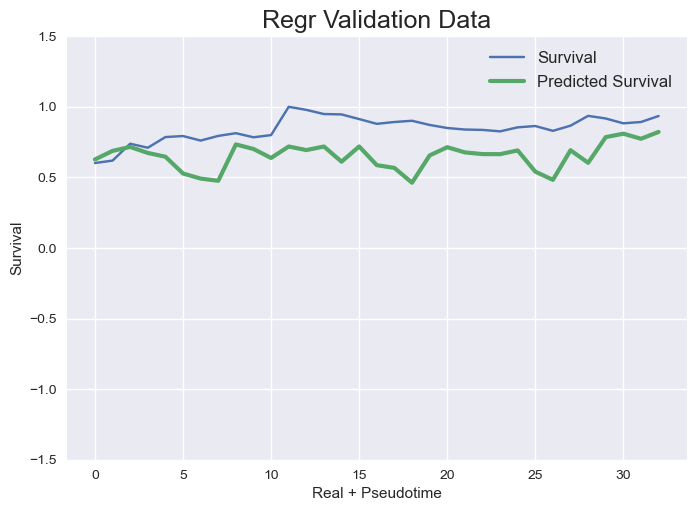

tf.Tensor(
[0.92123294 0.7924183  0.821368   0.8371492  0.9749874  0.9064848
 1.0377613  1.0956073  0.777217   1.3596969 ], shape=(10,), dtype=float32)
{0.75: [0.0008197788860479028, 0.19933391616938256, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.92123294 0.7924183  0.821368   0.8371492  0.9749874  0.9064848
 1.0377613  1.0956073  0.777217   1.3596969 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0582 - mean_squared_error: 0.0582
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 41ms/step - loss: 0.0563 - mean_squared_error: 0.0563 - val_loss: 0.2045 - val_mean_squared_error: 0.2045
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0267 - mean_squared_error: 0.0267
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=========

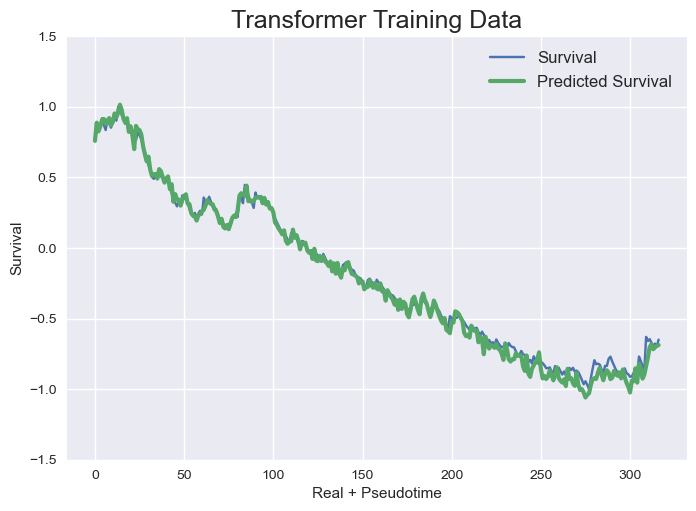

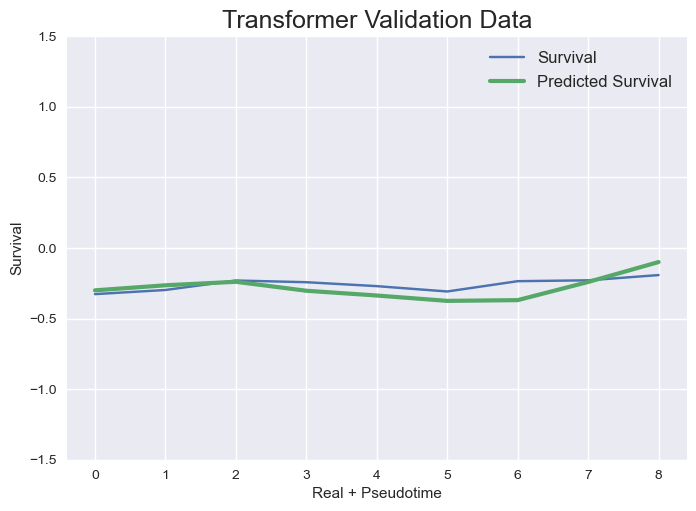

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


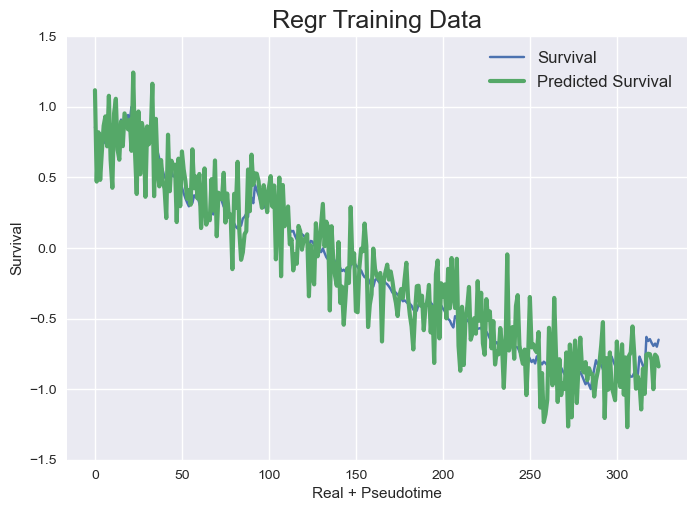

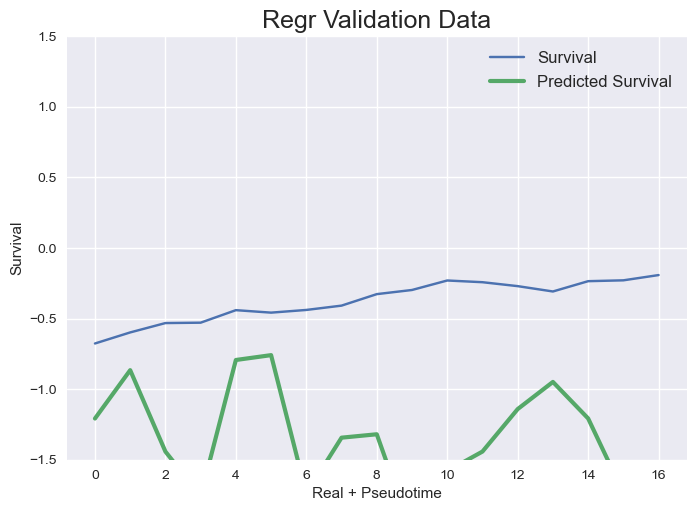

tf.Tensor(
[0.92954886 0.7969648  0.8141343  0.8493863  0.9746856  0.90617275
 1.0416505  1.1200165  0.7813572  1.3635151 ], shape=(10,), dtype=float32)
{0.75: [0.002286687225418883, 0.004565145947624874, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.92954886 0.7969648  0.8141343  0.8493863  0.9746856  0.90617275
 1.0416505  1.1200165  0.7813572  1.3635151 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0424 - mean_squared_error: 0.0424
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 80ms/step - loss: 0.0405 - mean_squared_error: 0.0405 - val_loss: 0.1791 - val_mean_squared_error: 0.1791
Epoch 2/10
 7/10 [====================>.........] - ETA: 0s - loss: 0.0211 - mean_squared_error: 0.0211
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

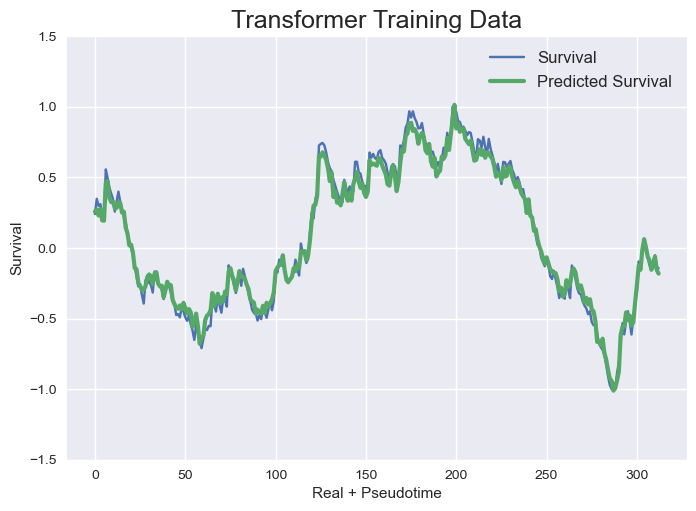

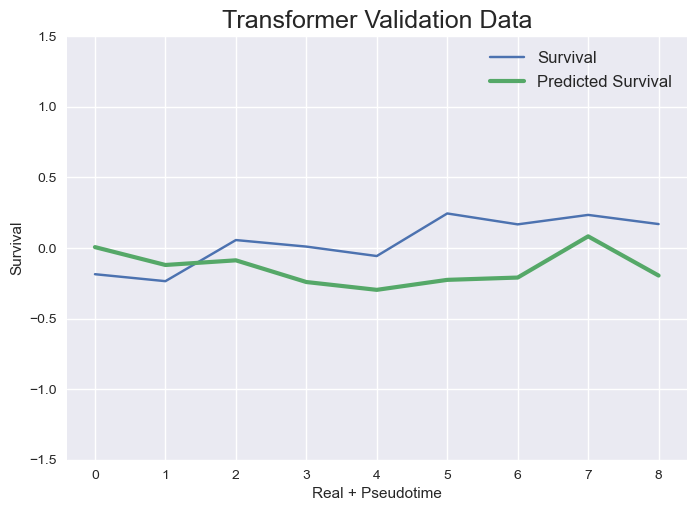

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


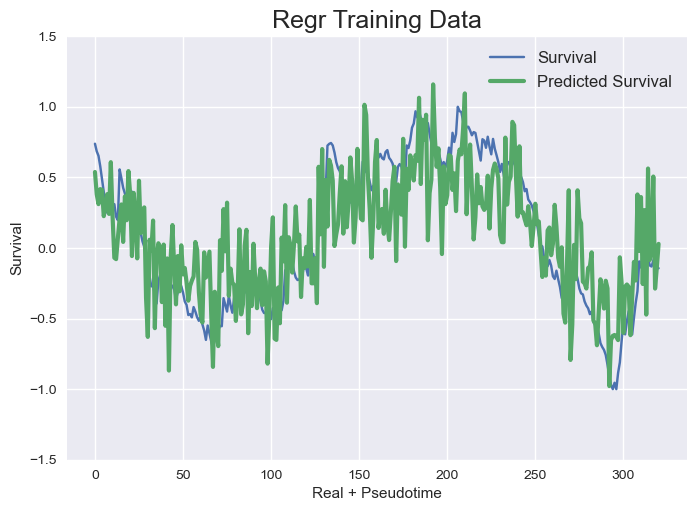

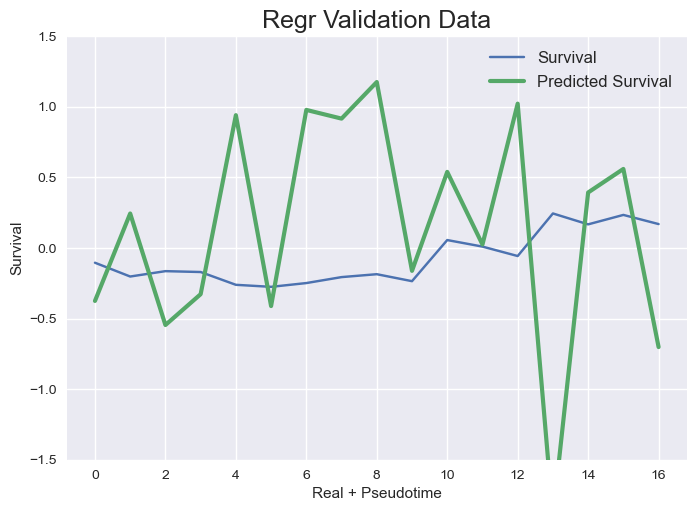

tf.Tensor(
[0.9273834  0.7931015  0.82061464 0.85807556 0.96266574 0.9194224
 1.0448166  1.1087273  0.7773198  1.3585545 ], shape=(10,), dtype=float32)
{0.75: [0.0028904272835007182, 0.0789204014565126, 0.09963663912416548, 0.7911836007528895]}
7 
 7 
 7



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.9273834  0.7931015  0.82061464 0.85807556 0.96266574 0.9194224
 1.0448166  1.1087273  0.7773198  1.3585545 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0305 - mean_squared_error: 0.0305
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 68ms/step - loss: 0.0275 - mean_squared_error: 0.0275 - val_loss: 0.8112 - val_mean_squared_error: 0.8112
Epoch 2/10
11/12 [==========================>...] - ETA: 0s - loss: 0.0120 - mean_squared_error: 0.0120
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [==

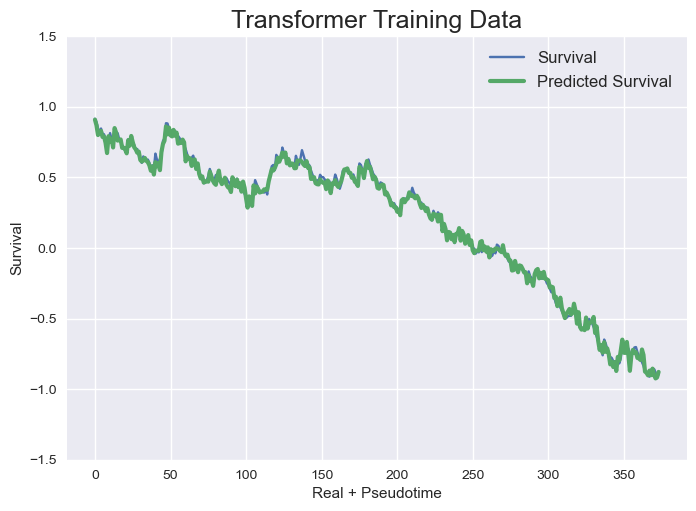

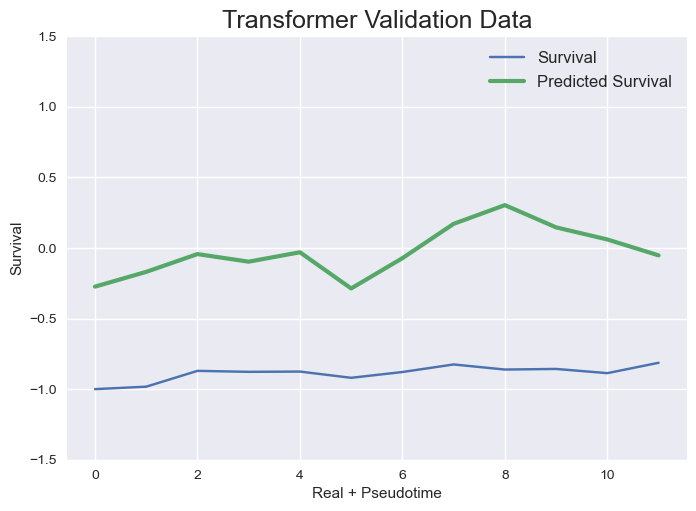

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


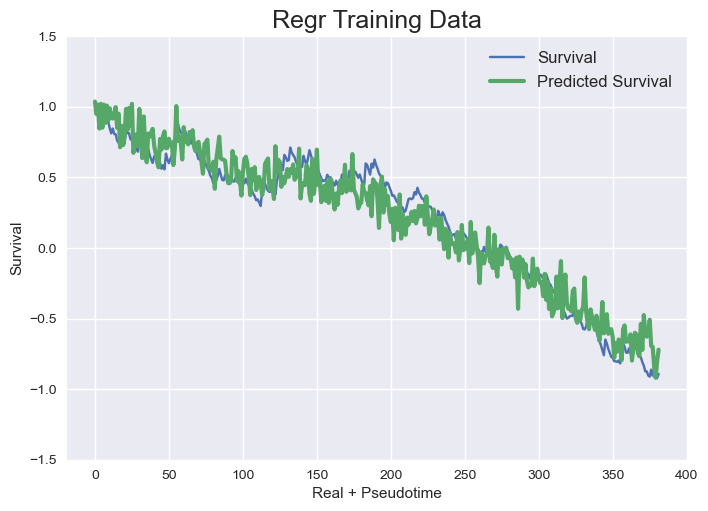

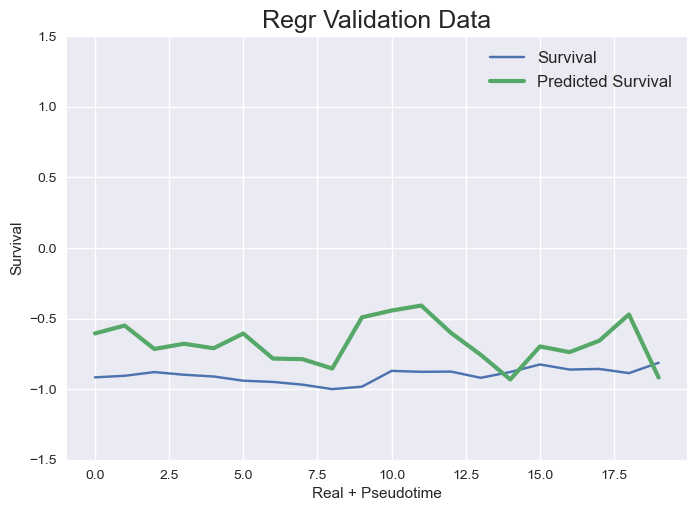

tf.Tensor(
[0.9210646  0.793122   0.82566285 0.8629462  0.96046805 0.91594535
 1.0443666  1.1243839  0.77778876 1.3464563 ], shape=(10,), dtype=float32)
{0.75: [0.001002531056831606, 0.7564347568902287, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.9210646  0.793122   0.82566285 0.8629462  0.96046805 0.91594535
 1.0443666  1.1243839  0.77778876 1.3464563 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0360 - mean_squared_error: 0.0360
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 46ms/step - loss: 0.0352 - mean_squared_error: 0.0352 - val_loss: 0.0455 - val_mean_squared_error: 0.0455
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0170 - mean_squared_error: 0.0170
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

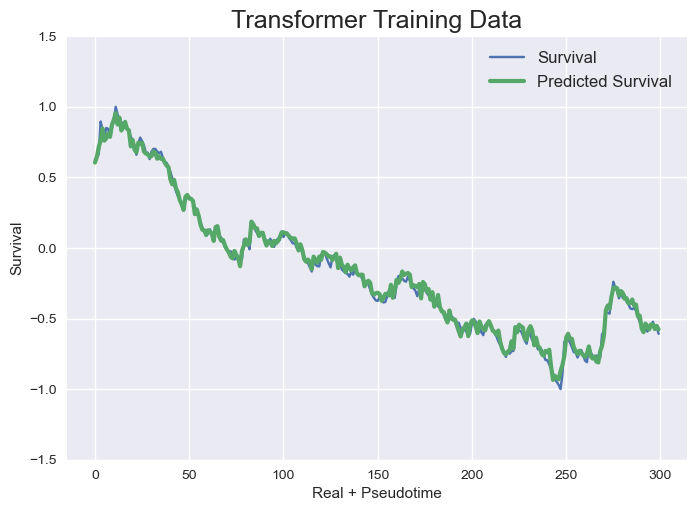

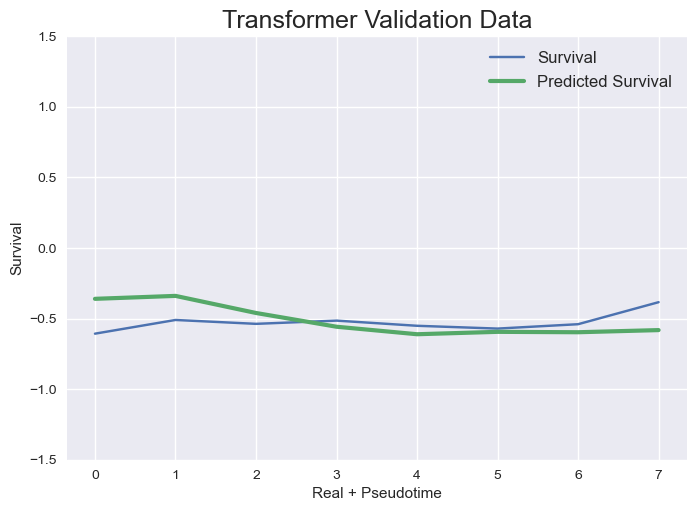

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


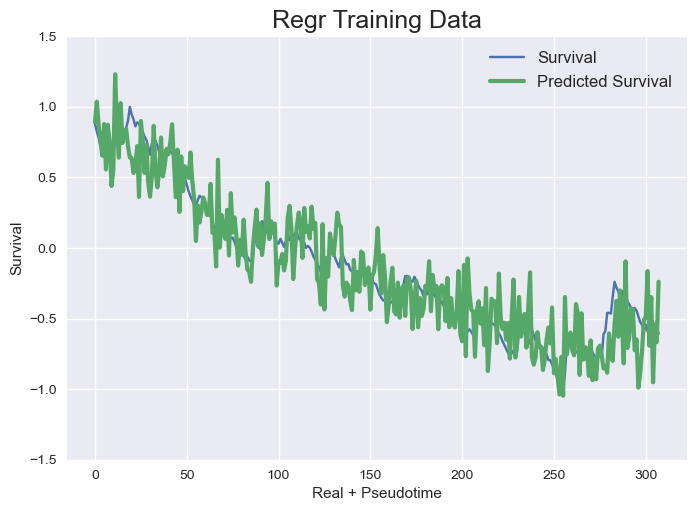

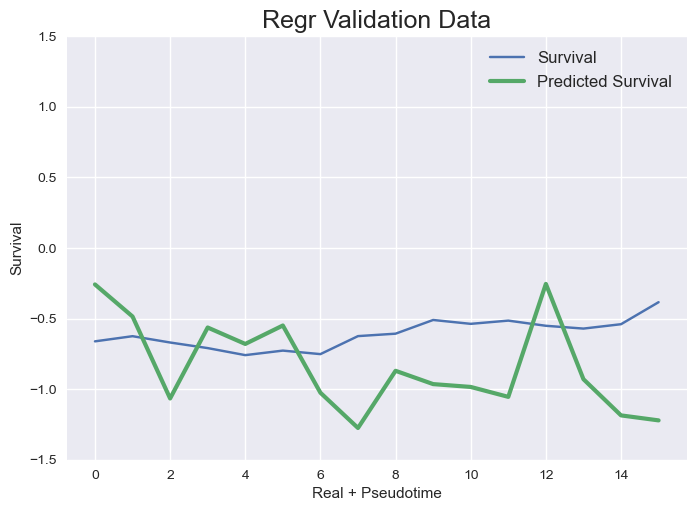

tf.Tensor(
[0.9231178  0.8097383  0.82247764 0.8530034  0.9684671  0.911178
 1.045456   1.1372427  0.76685333 1.3419034 ], shape=(10,), dtype=float32)
{0.75: [0.0012647514661062286, 0.018036905204782076, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.9231178  0.8097383  0.82247764 0.8530034  0.9684671  0.911178
 1.045456   1.1372427  0.76685333 1.3419034 ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0392 - mean_squared_error: 0.0392
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 35ms/step - loss: 0.0376 - mean_squared_error: 0.0376 - val_loss: 0.4885 - val_mean_squared_error: 0.4885
Epoch 2/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0092 - mean_squared_error: 0.0092
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [=============

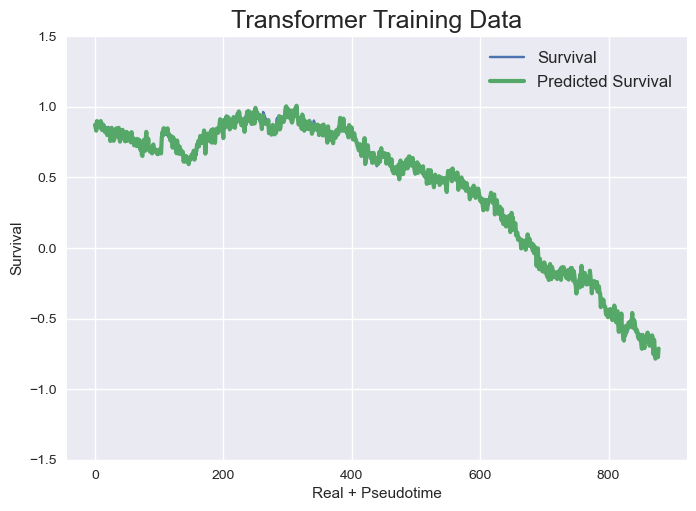

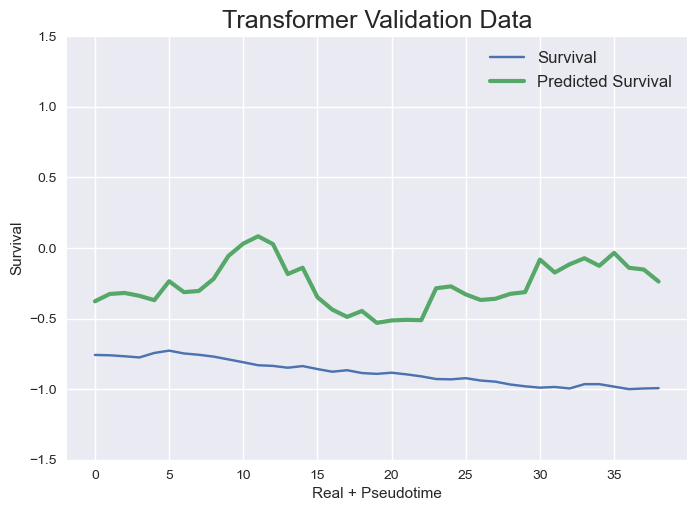

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


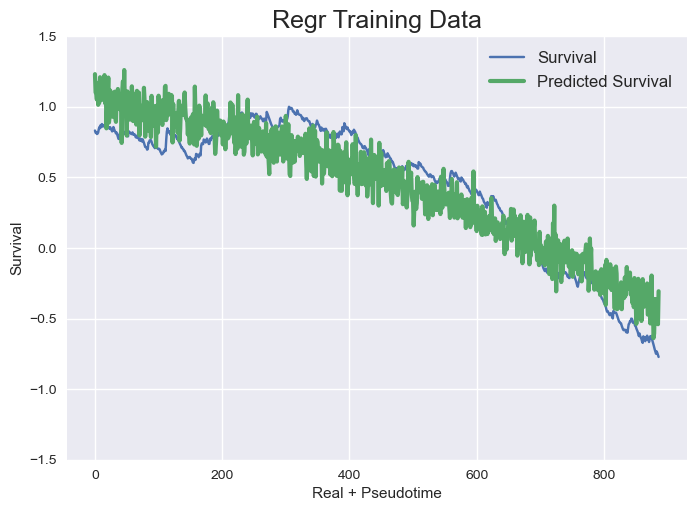

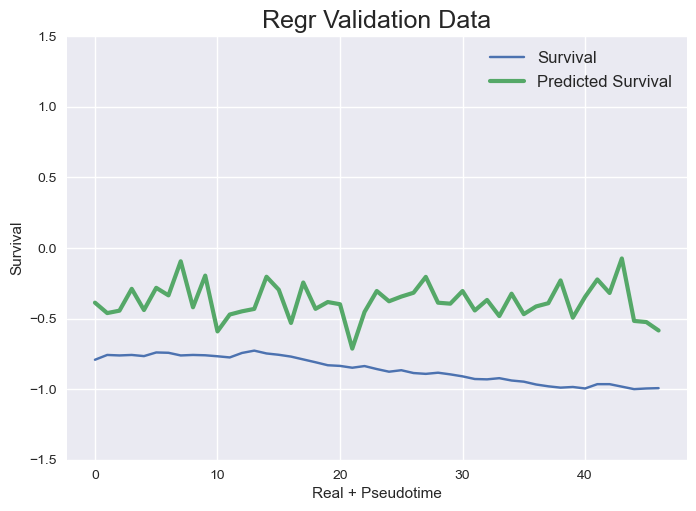

tf.Tensor(
[0.9180953  0.81817555 0.83797705 0.87721026 0.9694355  0.9286558
 1.0521898  1.1509892  0.76057464 1.3334194 ], shape=(10,), dtype=float32)
{0.75: [0.0009523937795010859, 0.41825244375886683, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.9180953  0.81817555 0.83797705 0.87721026 0.9694355  0.9286558
 1.0521898  1.1509892  0.76057464 1.3334194 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0727 - mean_squared_error: 0.0727
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 29ms/step - loss: 0.0707 - mean_squared_error: 0.0707 - val_loss: 0.0532 - val_mean_squared_error: 0.0532
Epoch 2/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0078 - mean_squared_error: 0.0078
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [==========

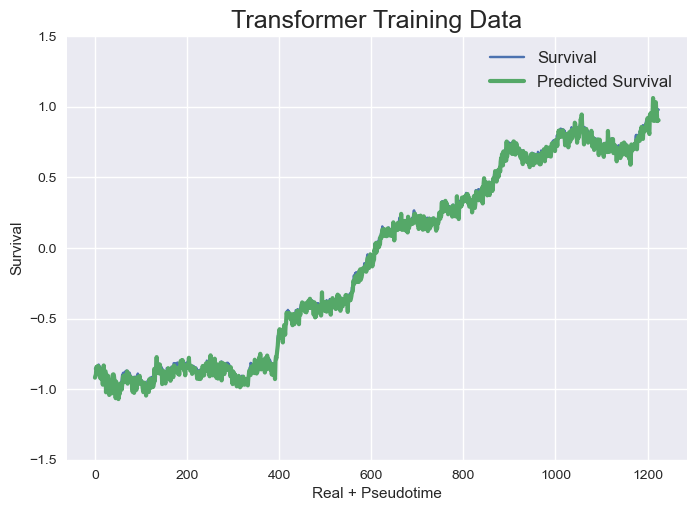

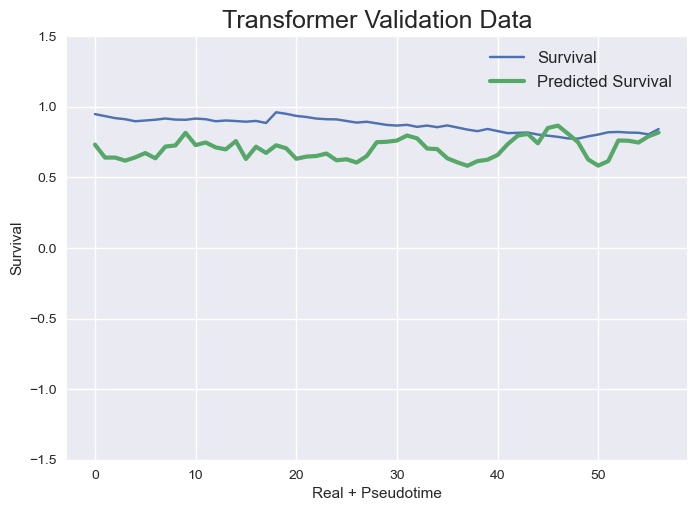

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


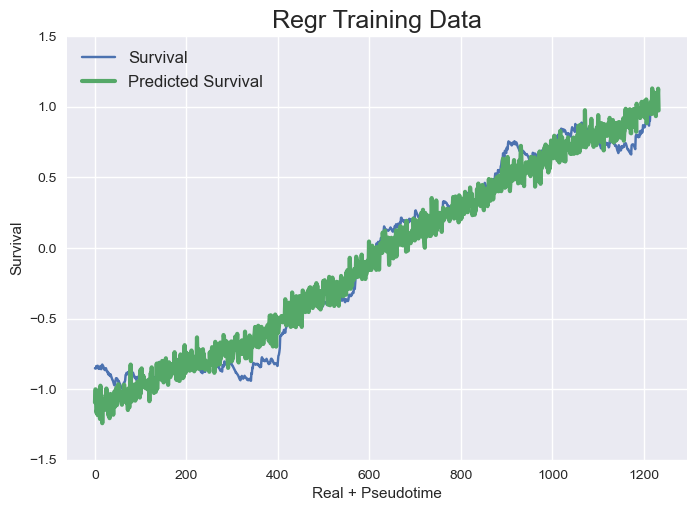

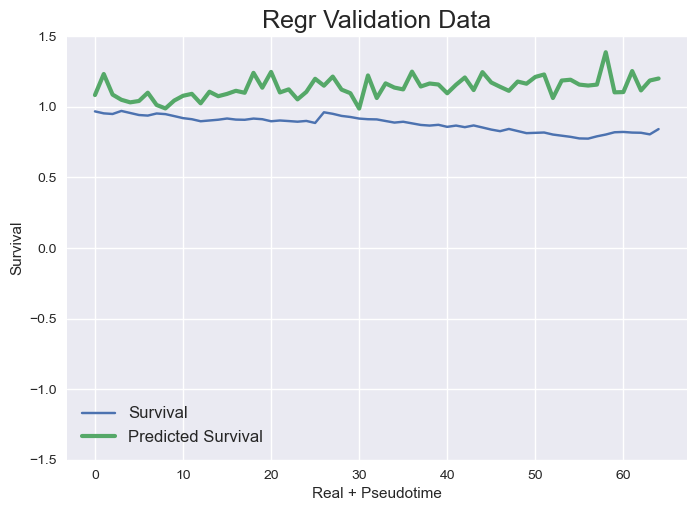

tf.Tensor(
[0.91375905 0.8183485  0.8447554  0.88537246 0.97929335 0.9302032
 1.0592926  1.1010523  0.75444216 1.3382217 ], shape=(10,), dtype=float32)
{0.75: [0.0016133374356945042, 0.0377139026844397, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.91375905 0.8183485  0.8447554  0.88537246 0.97929335 0.9302032
 1.0592926  1.1010523  0.75444216 1.3382217 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0503 - mean_squared_error: 0.0503
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 34ms/step - loss: 0.0475 - mean_squared_error: 0.0475 - val_loss: 1.4352 - val_mean_squared_error: 1.4352
Epoch 2/10
31/32 [============================>.] - ETA: 0s - loss: 0.0099 - mean_squared_error: 0.0099
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [===========

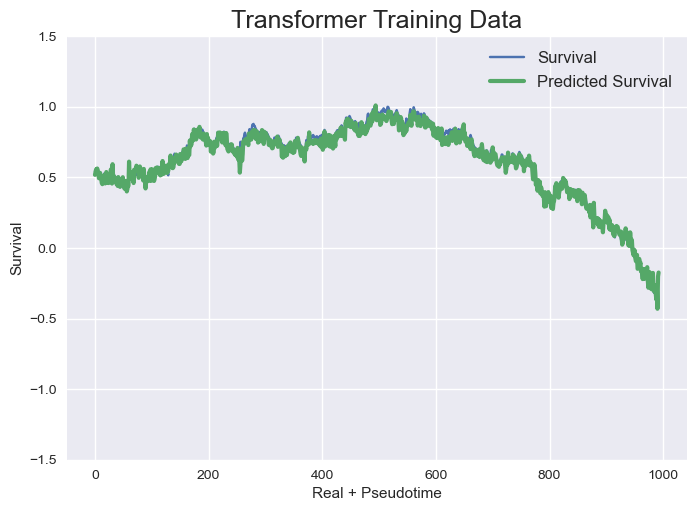

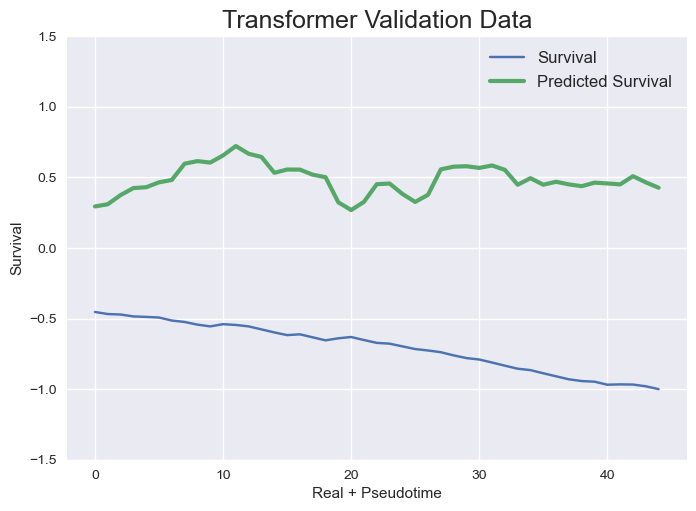

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


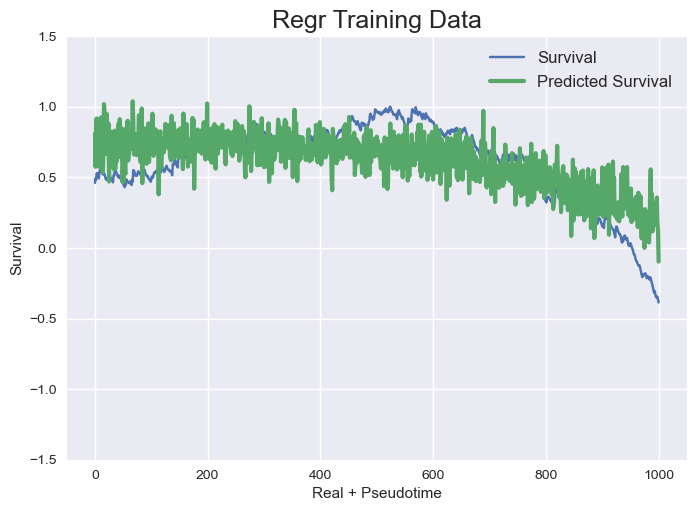

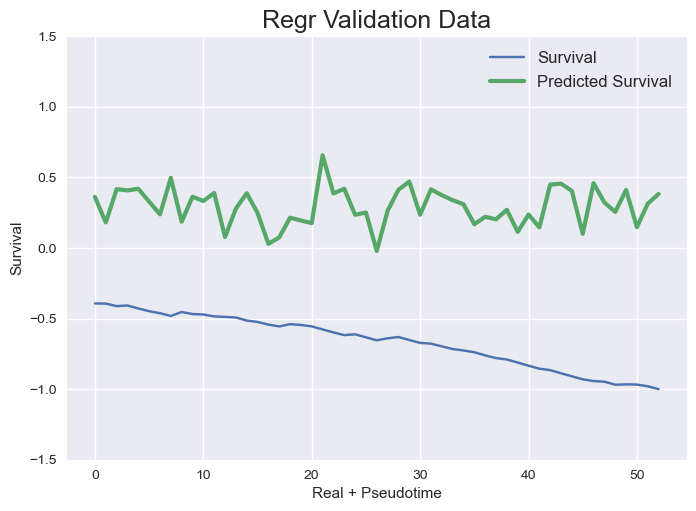

tf.Tensor(
[0.9124697  0.8099894  0.83203566 0.8701433  0.9789958  0.91966397
 1.0676669  1.1183385  0.7593301  1.3715535 ], shape=(10,), dtype=float32)
{0.75: [0.0014547681272265437, 1.4493390548525868, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.9124697  0.8099894  0.83203566 0.8701433  0.9789958  0.91966397
 1.0676669  1.1183385  0.7593301  1.3715535 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0611 - mean_squared_error: 0.0611
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 22ms/step - loss: 0.0586 - mean_squared_error: 0.0586 - val_loss: 0.7199 - val_mean_squared_error: 0.7199
Epoch 2/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0086 - mean_squared_error: 0.0086
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [=========

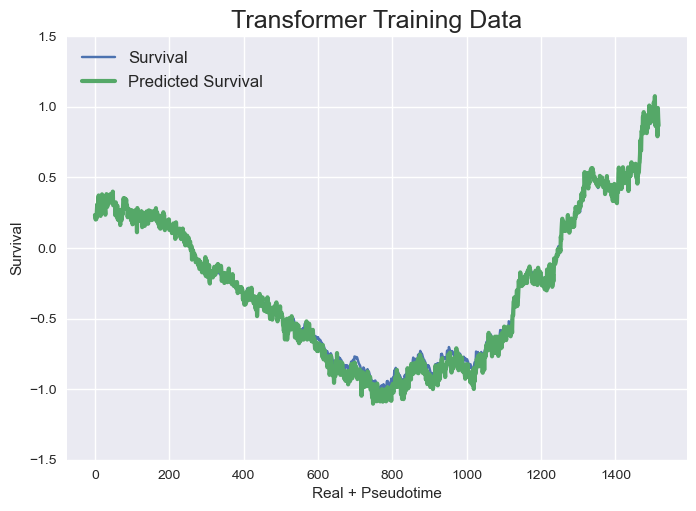

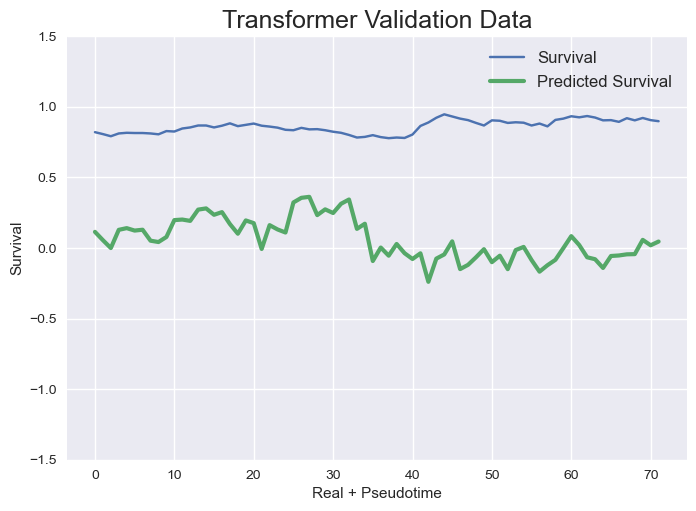

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


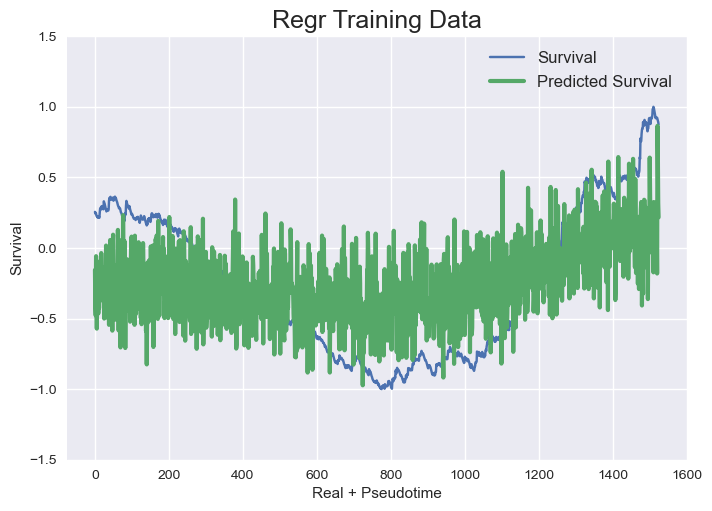

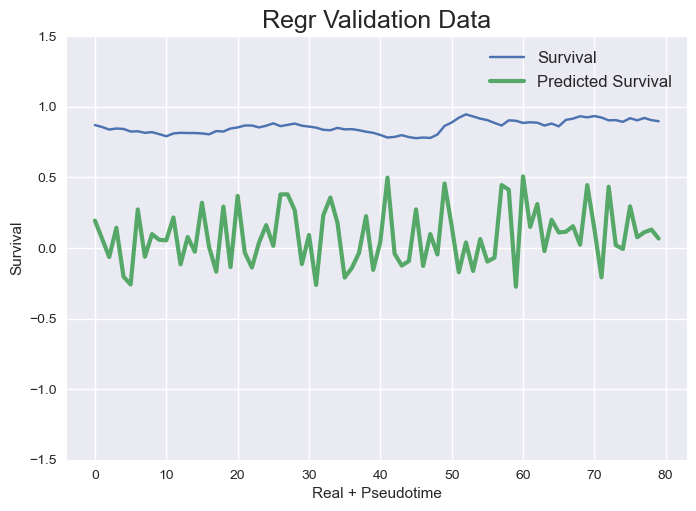

tf.Tensor(
[0.9236101  0.7991819  0.8243224  0.8408891  0.99327916 0.89502513
 1.0440258  1.1116244  0.76567465 1.3647357 ], shape=(10,), dtype=float32)
{0.75: [0.0025320277147118106, 0.6681799758117601, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.9236101  0.7991819  0.8243224  0.8408891  0.99327916 0.89502513
 1.0440258  1.1116244  0.76567465 1.3647357 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0112 - mean_squared_error: 0.0112
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 2s 29ms/step - loss: 0.0105 - mean_squared_error: 0.0105 - val_loss: 0.2305 - val_mean_squared_error: 0.2305
Epoch 2/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0044 - mean_squared_error: 0.0044
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==========

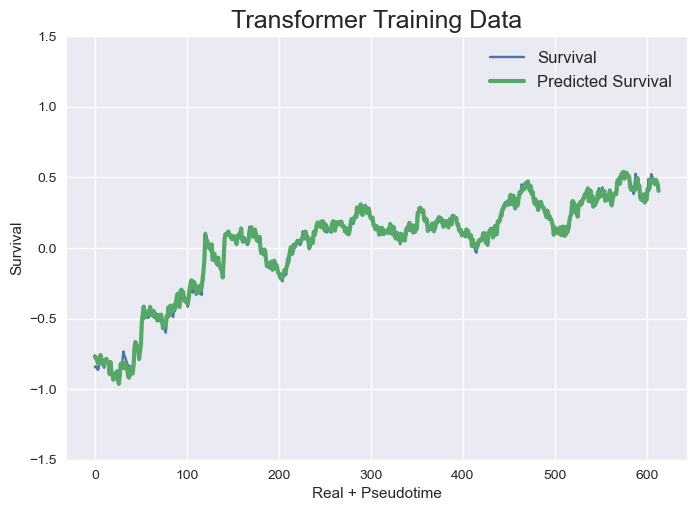

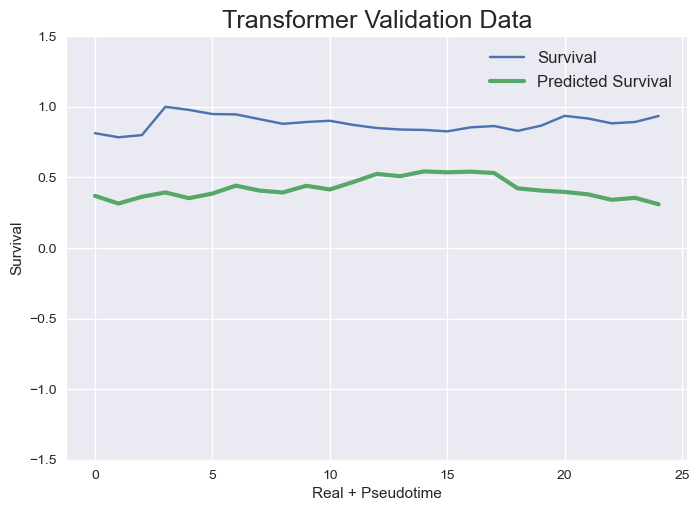

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


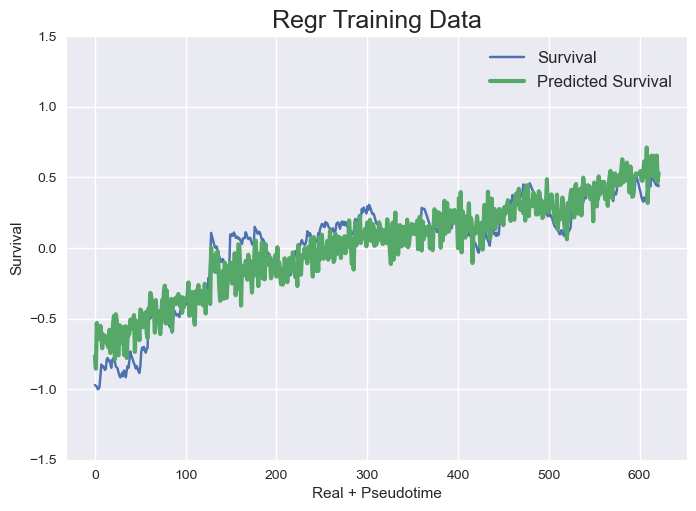

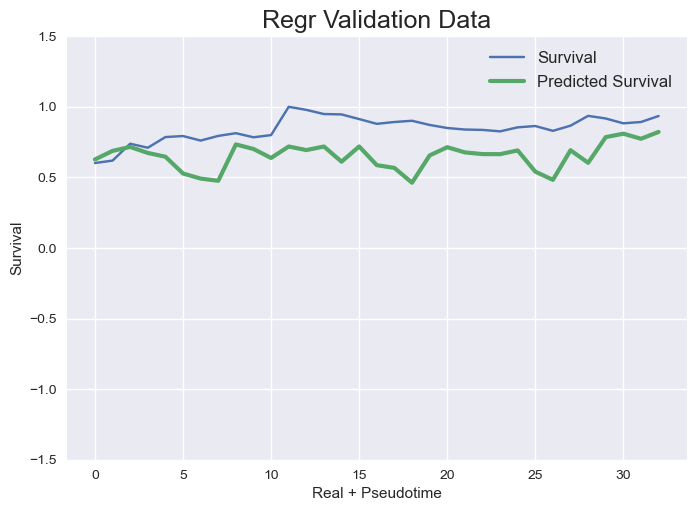

tf.Tensor(
[0.9249909  0.7991549  0.8237517  0.83463246 0.9880396  0.89636797
 1.0479261  1.1054438  0.76623046 1.3713344 ], shape=(10,), dtype=float32)
{0.75: [0.0007177476006196336, 0.2224301146491516, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9249909  0.7991549  0.8237517  0.83463246 0.9880396  0.89636797
 1.0479261  1.1054438  0.76623046 1.3713344 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0389 - mean_squared_error: 0.0389
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 48ms/step - loss: 0.0375 - mean_squared_error: 0.0375 - val_loss: 0.2034 - val_mean_squared_error: 0.2034
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0136 - mean_squared_error: 0.0136
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [========

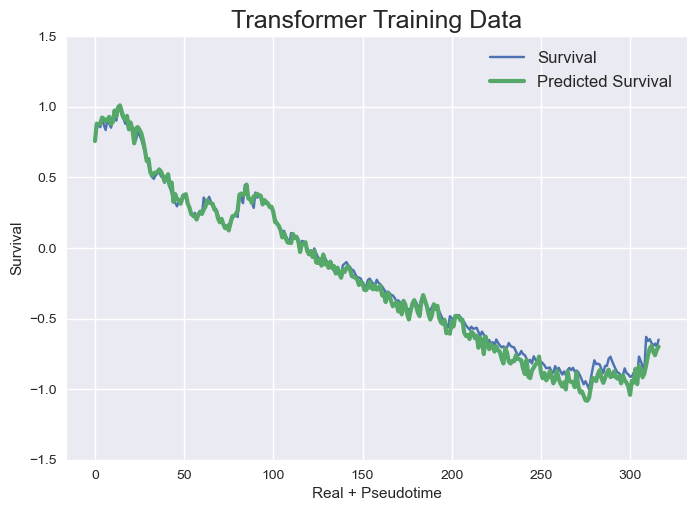

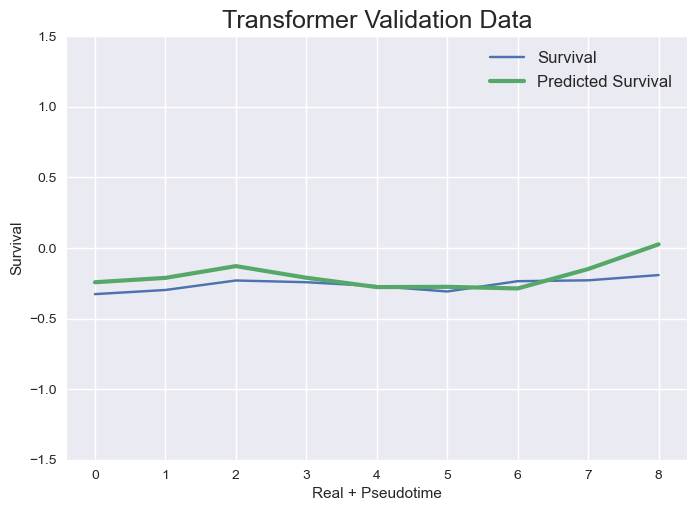

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


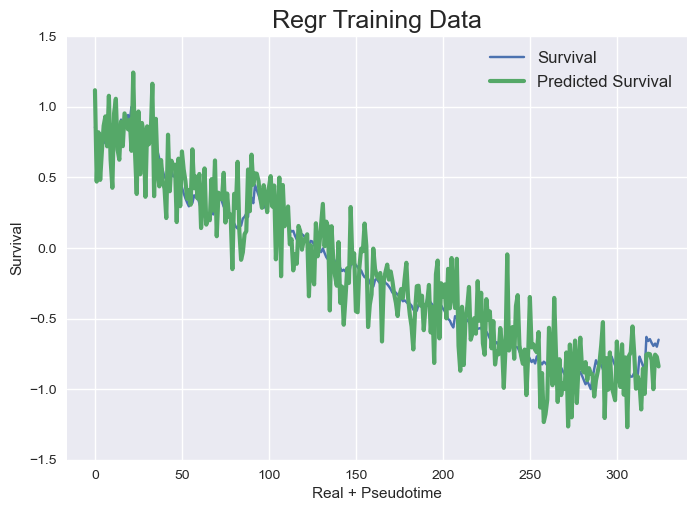

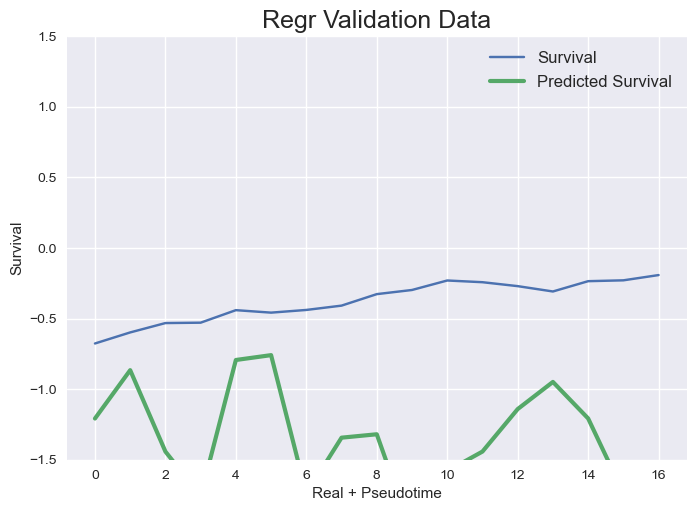

tf.Tensor(
[0.9318187  0.8033944  0.81760734 0.84431344 0.98208565 0.89460766
 1.0479482  1.1165007  0.7645334  1.3676147 ], shape=(10,), dtype=float32)
{0.75: [0.002876700198490673, 0.009271297676556973, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9318187  0.8033944  0.81760734 0.84431344 0.98208565 0.89460766
 1.0479482  1.1165007  0.7645334  1.3676147 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0250 - mean_squared_error: 0.0250
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 81ms/step - loss: 0.0238 - mean_squared_error: 0.0238 - val_loss: 0.1480 - val_mean_squared_error: 0.1480
Epoch 2/10
 7/10 [====================>.........] - ETA: 0s - loss: 0.0115 - mean_squared_error: 0.0115
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

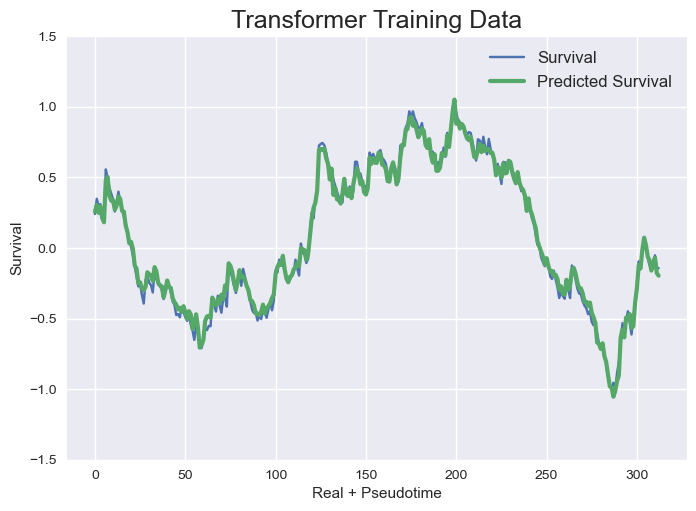

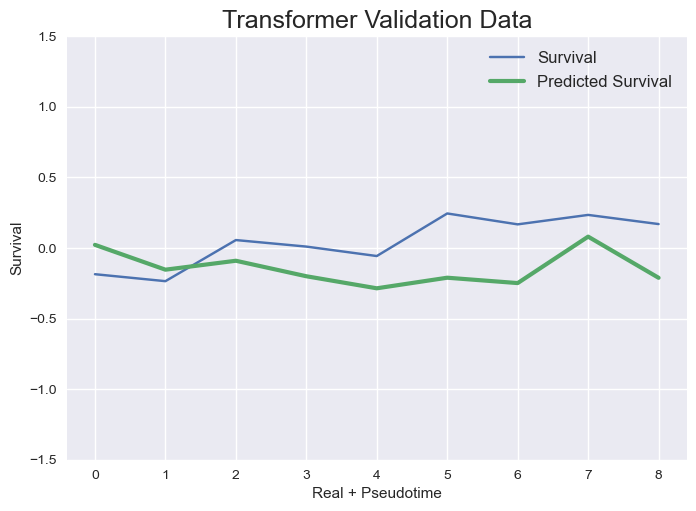

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


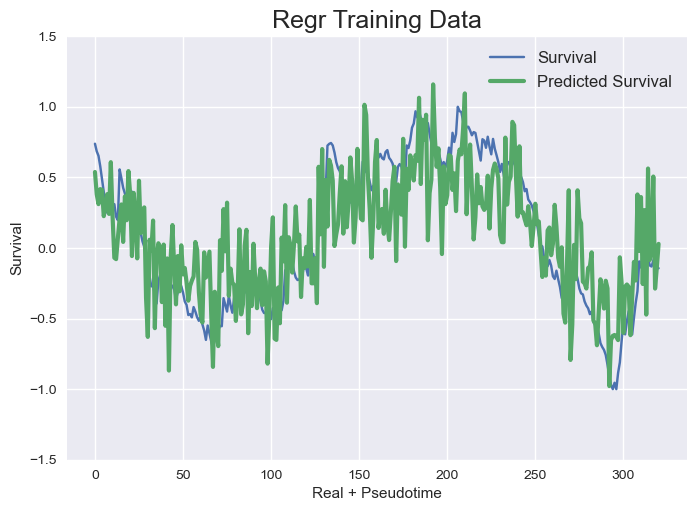

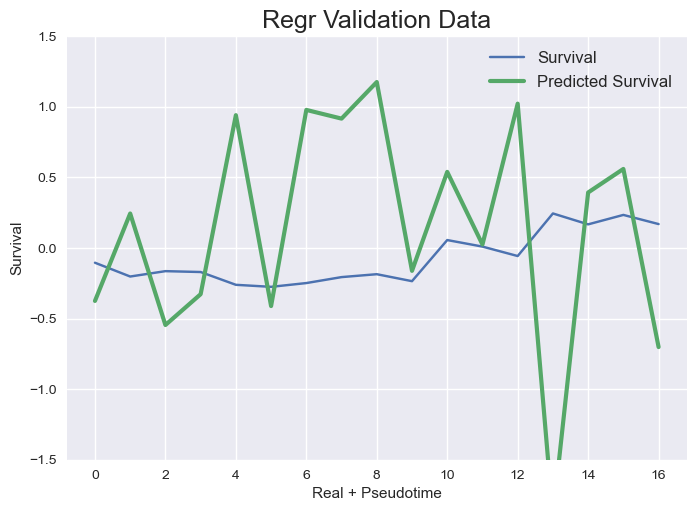

tf.Tensor(
[0.92930627 0.80277985 0.821613   0.8502803  0.97884554 0.906806
 1.0465722  1.1152551  0.7611504  1.3679698 ], shape=(10,), dtype=float32)
{0.75: [0.0018267861344539872, 0.07961294786540335, 0.09963663912416548, 0.7911836007528895]}
8 
 8 
 8



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.92930627 0.80277985 0.821613   0.8502803  0.97884554 0.906806
 1.0465722  1.1152551  0.7611504  1.3679698 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0236 - mean_squared_error: 0.0236
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 68ms/step - loss: 0.0211 - mean_squared_error: 0.0211 - val_loss: 1.0758 - val_mean_squared_error: 1.0758
Epoch 2/10
11/12 [==========================>...] - ETA: 0s - loss: 0.0111 - mean_squared_error: 0.0111
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [===

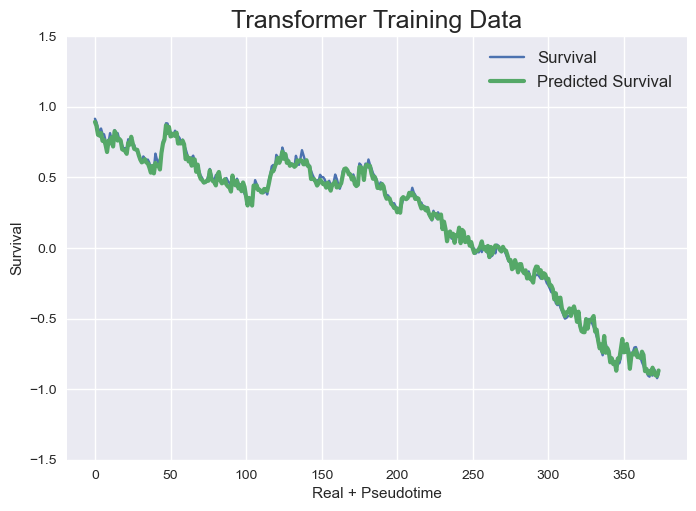

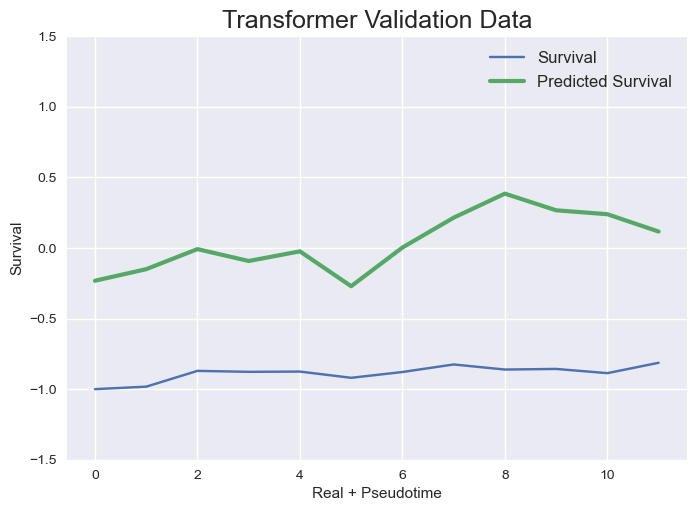

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


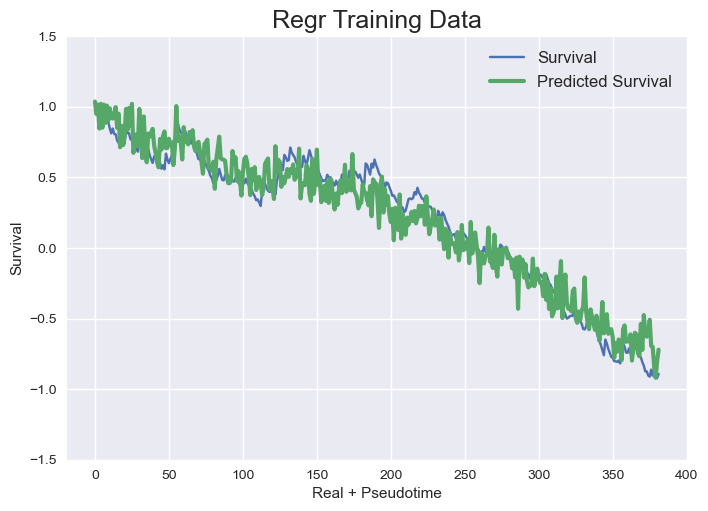

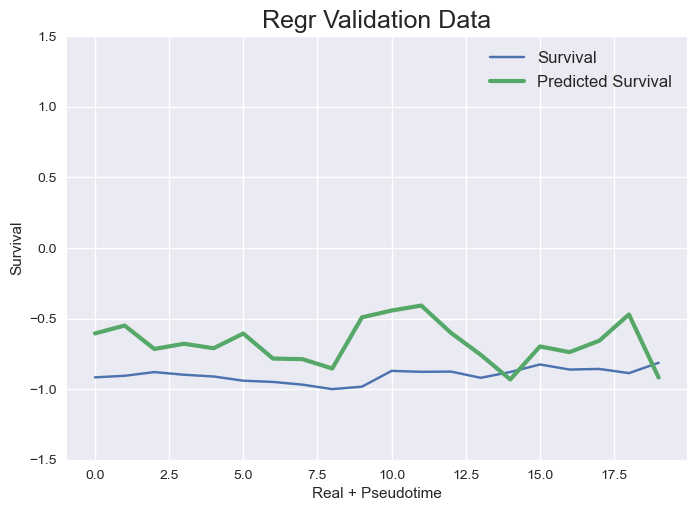

tf.Tensor(
[0.92474264 0.8063262  0.82529926 0.8480686  0.979806   0.91018295
 1.0469708  1.1260582  0.7583066  1.3612938 ], shape=(10,), dtype=float32)
{0.75: [0.0009564325095978668, 0.882883548754661, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.92474264 0.8063262  0.82529926 0.8480686  0.979806   0.91018295
 1.0469708  1.1260582  0.7583066  1.3612938 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0298 - mean_squared_error: 0.0298
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 78ms/step - loss: 0.0291 - mean_squared_error: 0.0291 - val_loss: 0.0448 - val_mean_squared_error: 0.0448
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0150 - mean_squared_error: 0.0150
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [==========

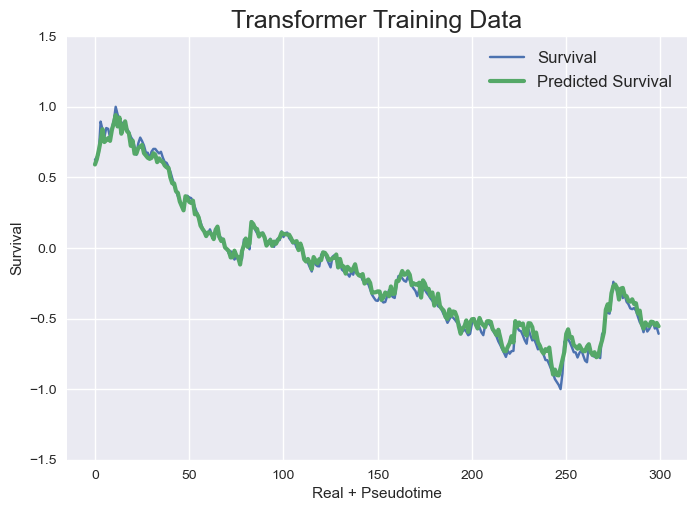

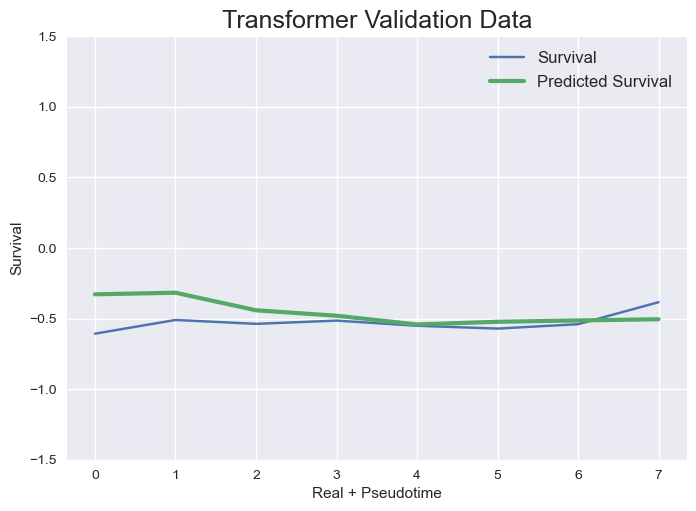

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


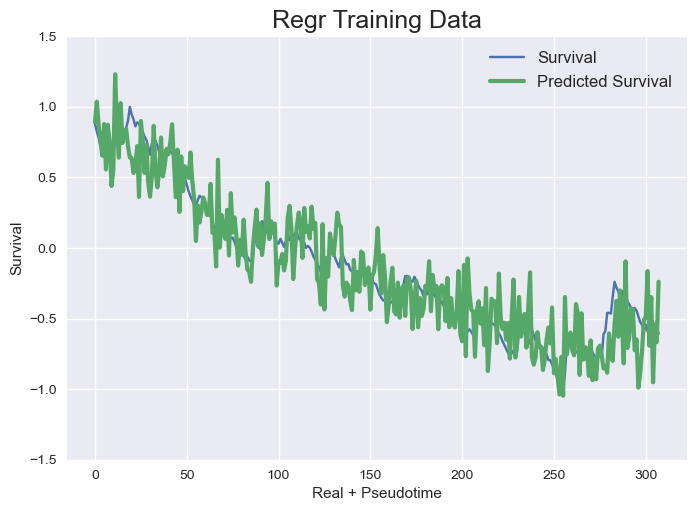

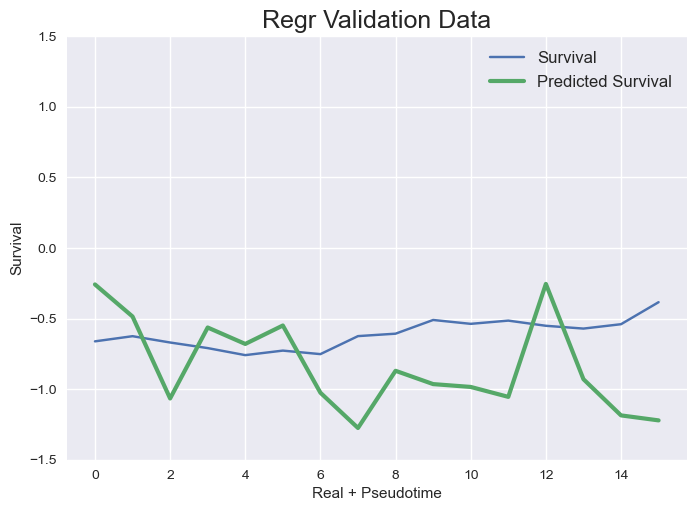

tf.Tensor(
[0.9270994  0.8183426  0.81981677 0.8470316  0.9887814  0.9092199
 1.04709    1.1306322  0.75991184 1.3663038 ], shape=(10,), dtype=float32)
{0.75: [0.001741428634805738, 0.01789197251581352, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.9270994  0.8183426  0.81981677 0.8470316  0.9887814  0.9092199
 1.04709    1.1306322  0.75991184 1.3663038 ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0297 - mean_squared_error: 0.0297
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 35ms/step - loss: 0.0278 - mean_squared_error: 0.0278 - val_loss: 0.5336 - val_mean_squared_error: 0.5336
Epoch 2/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0068 - mean_squared_error: 0.0068
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [=============

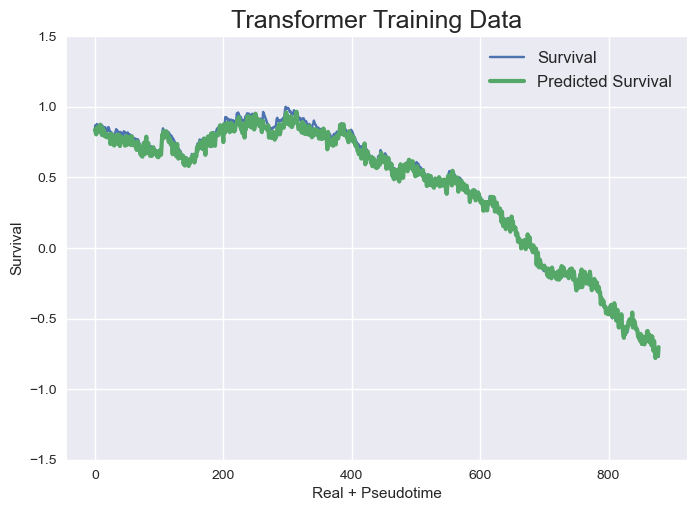

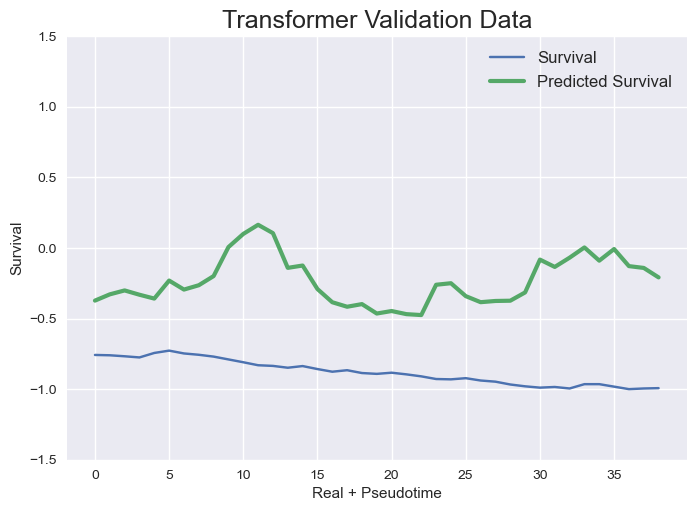

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


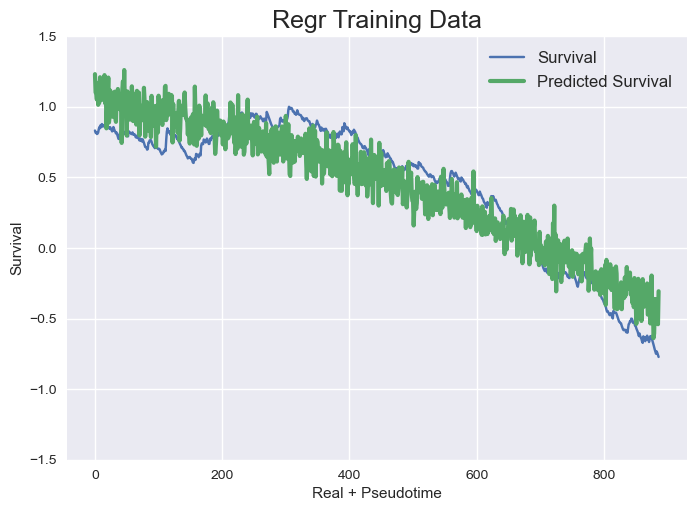

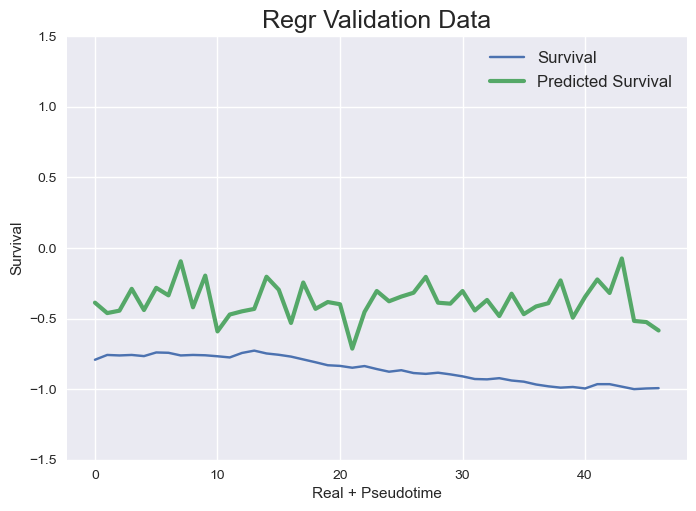

tf.Tensor(
[0.9223012  0.8271431  0.83497745 0.86792916 0.98541987 0.9271475
 1.0509393  1.1466029  0.7542834  1.3567687 ], shape=(10,), dtype=float32)
{0.75: [0.0016228366743818322, 0.45755848894459505, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.9223012  0.8271431  0.83497745 0.86792916 0.98541987 0.9271475
 1.0509393  1.1466029  0.7542834  1.3567687 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0572 - mean_squared_error: 0.0572
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 24ms/step - loss: 0.0556 - mean_squared_error: 0.0556 - val_loss: 0.0460 - val_mean_squared_error: 0.0460
Epoch 2/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0065 - mean_squared_error: 0.0065
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [==========

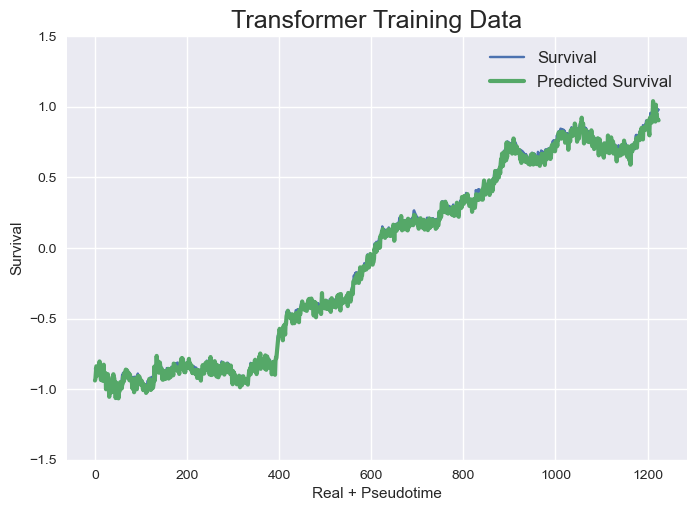

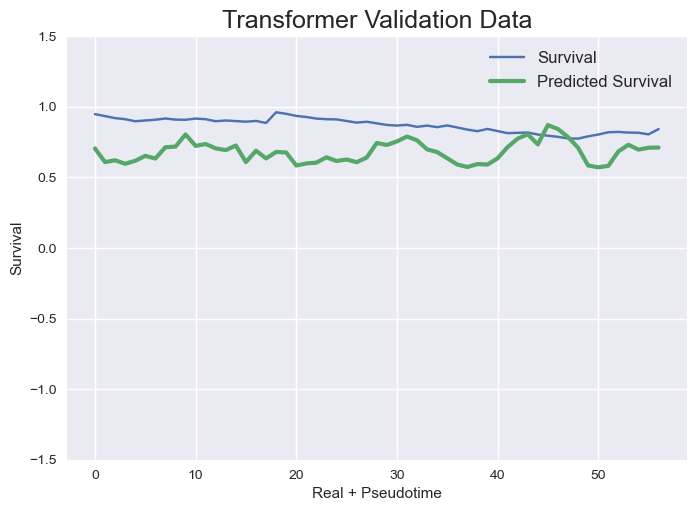

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


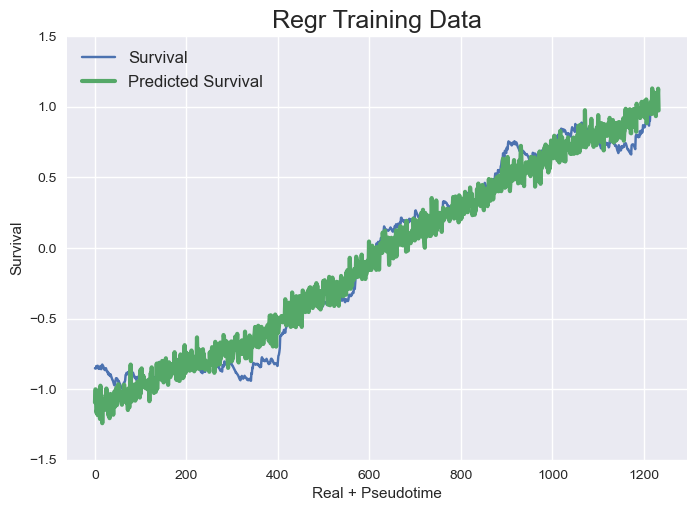

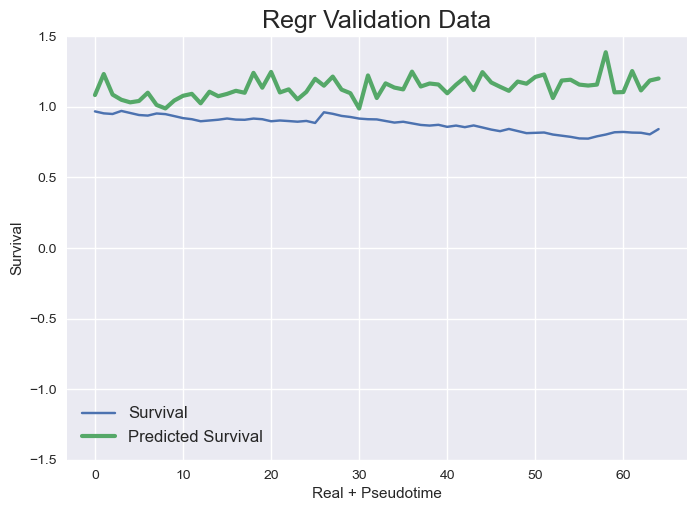

tf.Tensor(
[0.91917217 0.84113324 0.84048295 0.8875735  0.9938792  0.9232756
 1.0572349  1.1044202  0.7482794  1.3669844 ], shape=(10,), dtype=float32)
{0.75: [0.0014525640758115232, 0.045859184324099, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.91917217 0.84113324 0.84048295 0.8875735  0.9938792  0.9232756
 1.0572349  1.1044202  0.7482794  1.3669844 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0207 - mean_squared_error: 0.0207
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 33ms/step - loss: 0.0197 - mean_squared_error: 0.0197 - val_loss: 1.6257 - val_mean_squared_error: 1.6257
Epoch 2/10
31/32 [============================>.] - ETA: 0s - loss: 0.0055 - mean_squared_error: 0.0055
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [============

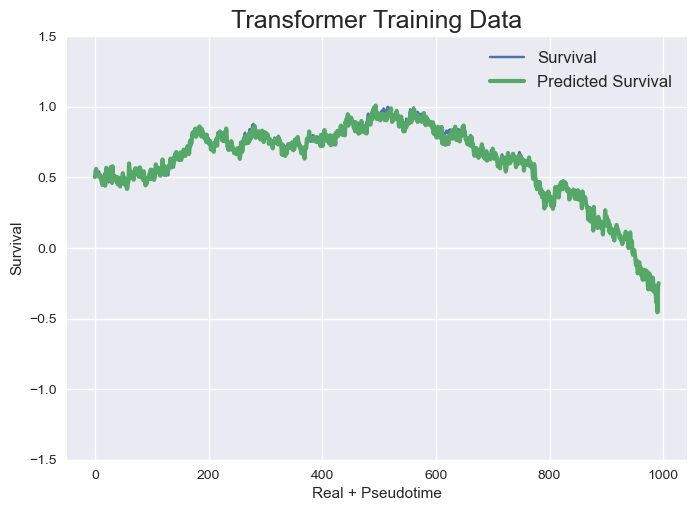

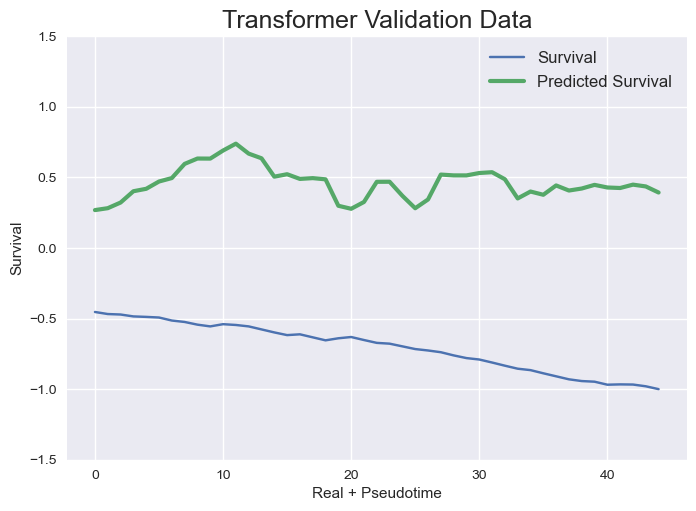

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


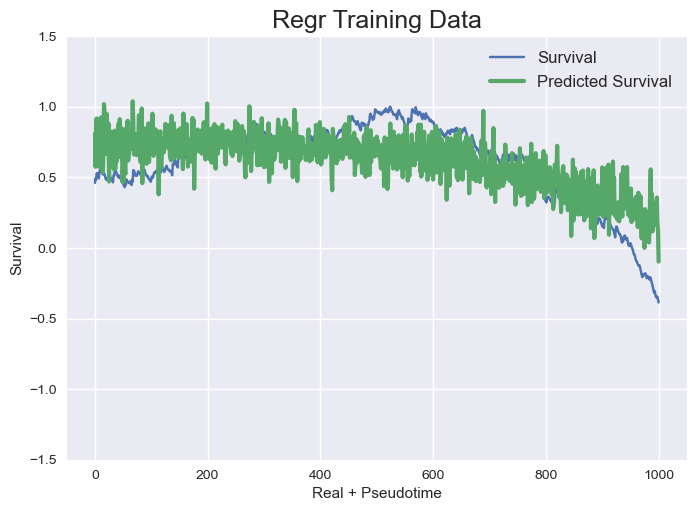

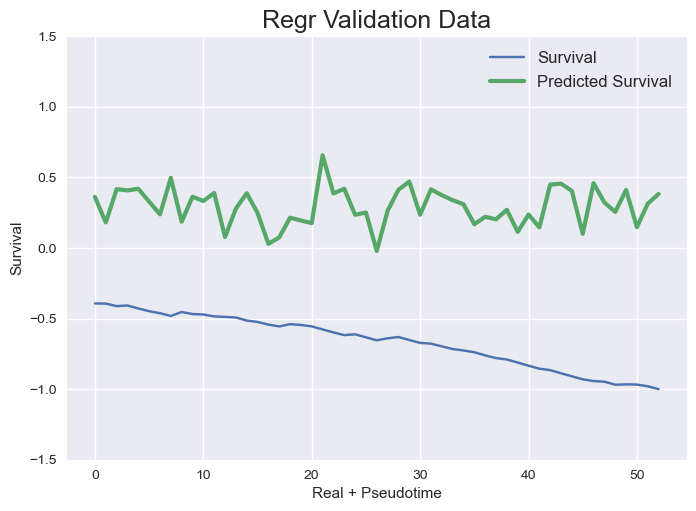

tf.Tensor(
[0.9146061  0.83822215 0.8321786  0.87254447 0.9928223  0.9204262
 1.0634927  1.1116974  0.7561105  1.3835067 ], shape=(10,), dtype=float32)
{0.75: [0.0009382391926794898, 1.386900612625971, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.9146061  0.83822215 0.8321786  0.87254447 0.9928223  0.9204262
 1.0634927  1.1116974  0.7561105  1.3835067 ], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0505 - mean_squared_error: 0.0505
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 27ms/step - loss: 0.0485 - mean_squared_error: 0.0485 - val_loss: 0.6846 - val_mean_squared_error: 0.6846
Epoch 2/10
47/48 [============================>.] - ETA: 0s - loss: 0.0073 - mean_squared_error: 0.0073
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [============

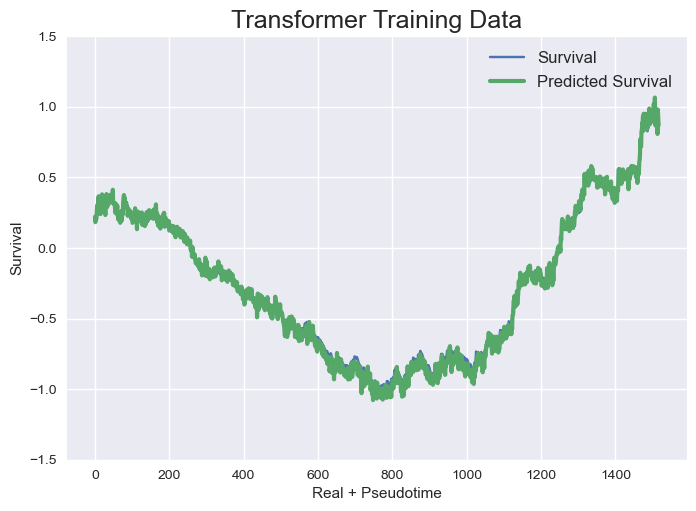

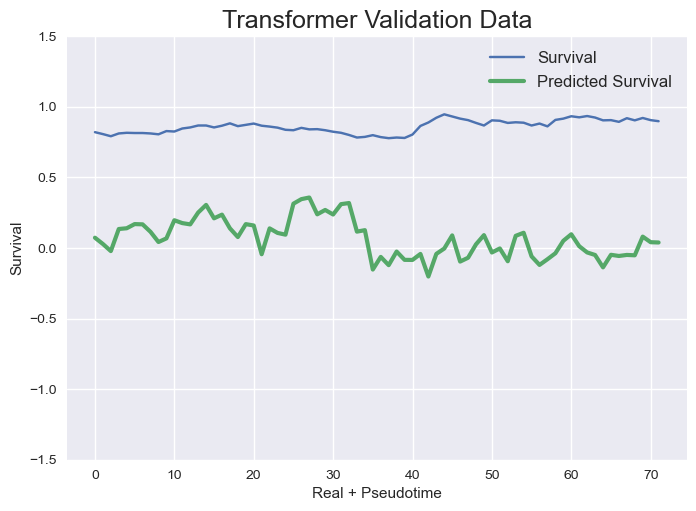

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


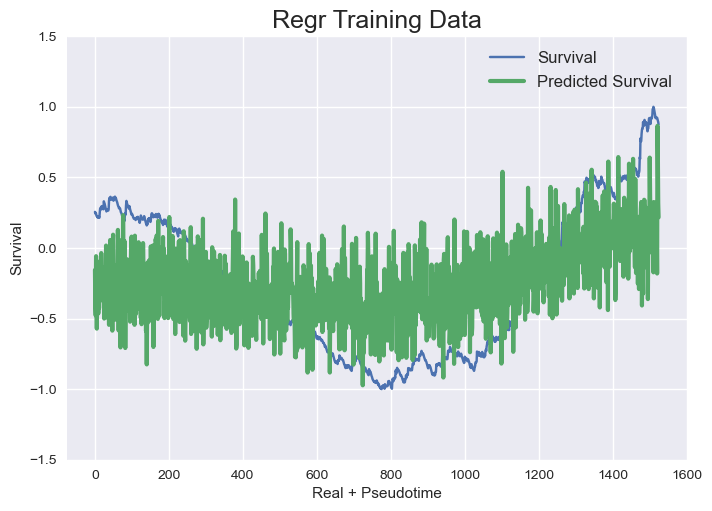

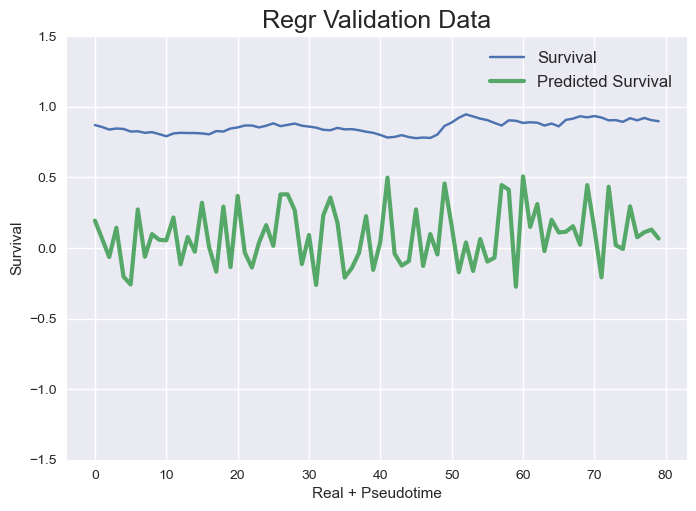

tf.Tensor(
[0.92600983 0.8284719  0.8232205  0.8619151  0.99412614 0.90571827
 1.0509126  1.115061   0.75717145 1.3767016 ], shape=(10,), dtype=float32)
{0.75: [0.0017981955246189178, 0.6527437487594333, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.92600983 0.8284719  0.8232205  0.8619151  0.99412614 0.90571827
 1.0509126  1.115061   0.75717145 1.3767016 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0086 - mean_squared_error: 0.0086
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 3s 46ms/step - loss: 0.0080 - mean_squared_error: 0.0080 - val_loss: 0.2349 - val_mean_squared_error: 0.2349
Epoch 2/10
18/20 [==========================>...] - ETA: 0s - loss: 0.0034 - mean_squared_error: 0.0034
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==========

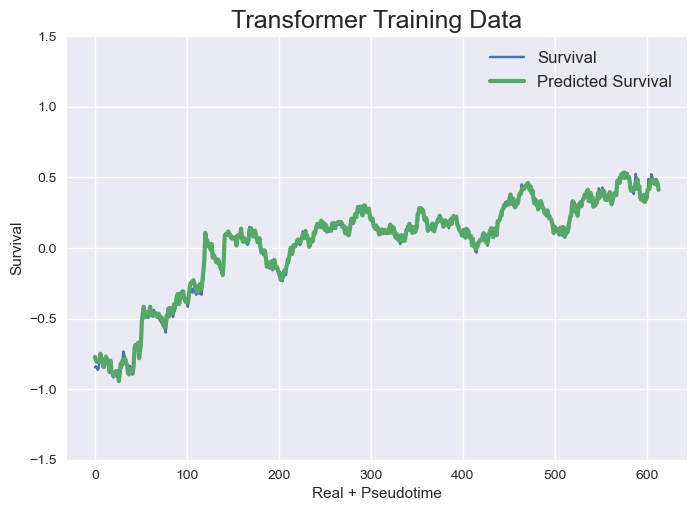

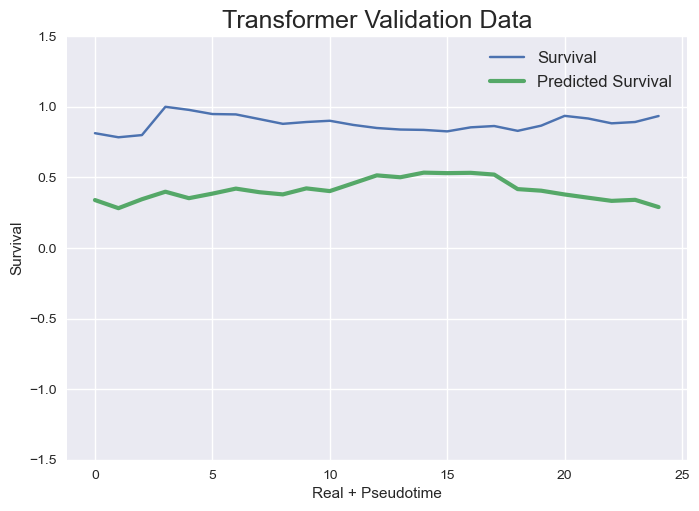

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


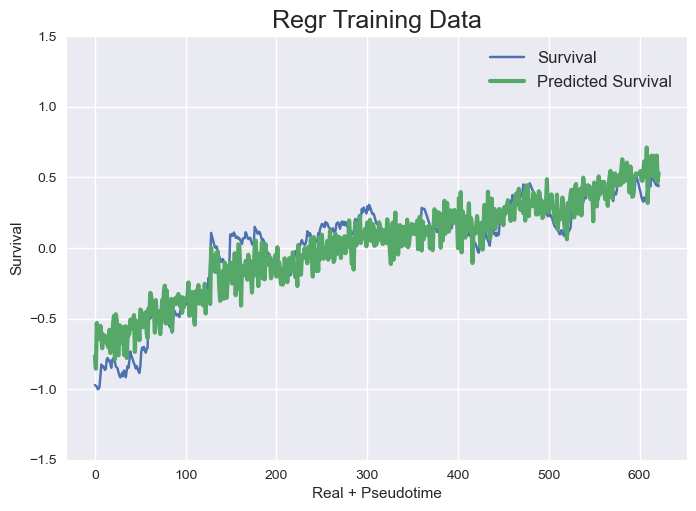

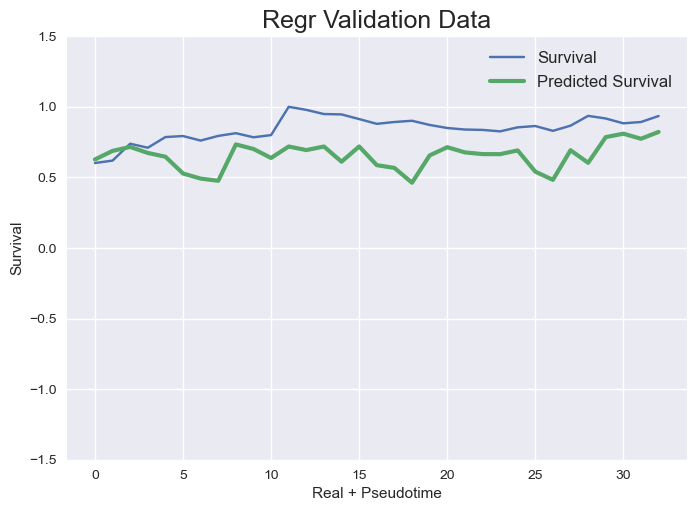

tf.Tensor(
[0.9265516  0.8276386  0.82433224 0.86285454 0.99308485 0.90433466
 1.0533062  1.1105703  0.7579523  1.3794667 ], shape=(10,), dtype=float32)
{0.75: [0.0005928802438271325, 0.23383764145918182, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9265516  0.8276386  0.82433224 0.86285454 0.99308485 0.90433466
 1.0533062  1.1105703  0.7579523  1.3794667 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0309 - mean_squared_error: 0.0309
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 75ms/step - loss: 0.0301 - mean_squared_error: 0.0301 - val_loss: 0.1978 - val_mean_squared_error: 0.1978
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0111 - mean_squared_error: 0.0111
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=======

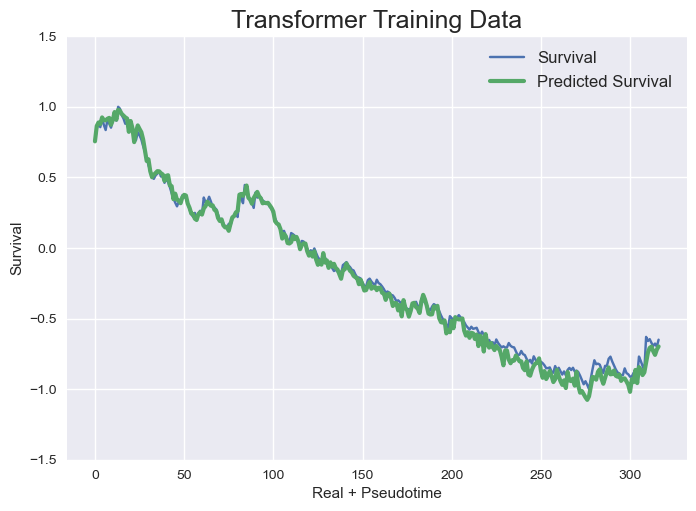

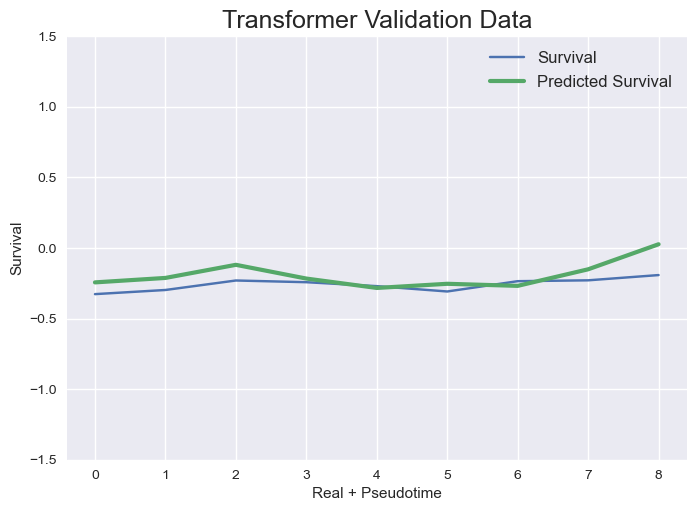

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


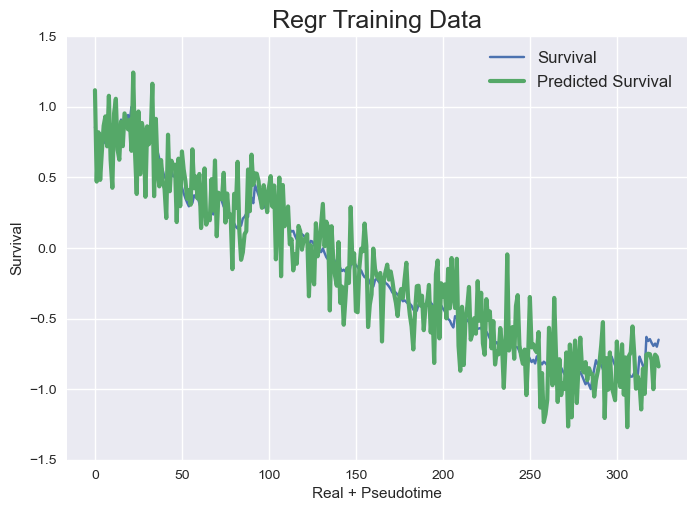

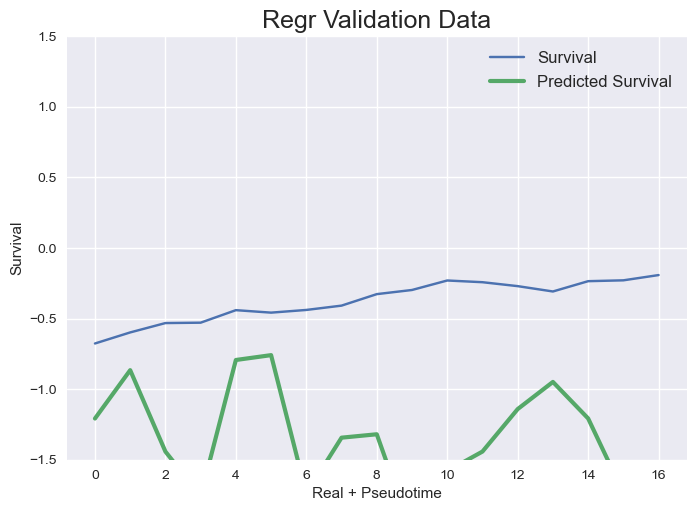

tf.Tensor(
[0.93065    0.8246545  0.81890345 0.86949915 0.98476726 0.90375847
 1.0548626  1.1281531  0.7573648  1.3803879 ], shape=(10,), dtype=float32)
{0.75: [0.0023479673390124855, 0.009469524214741346, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.93065    0.8246545  0.81890345 0.86949915 0.98476726 0.90375847
 1.0548626  1.1281531  0.7573648  1.3803879 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0188 - mean_squared_error: 0.0188
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 72ms/step - loss: 0.0180 - mean_squared_error: 0.0180 - val_loss: 0.1013 - val_mean_squared_error: 0.1013
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0081 - mean_squared_error: 0.0081
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=========

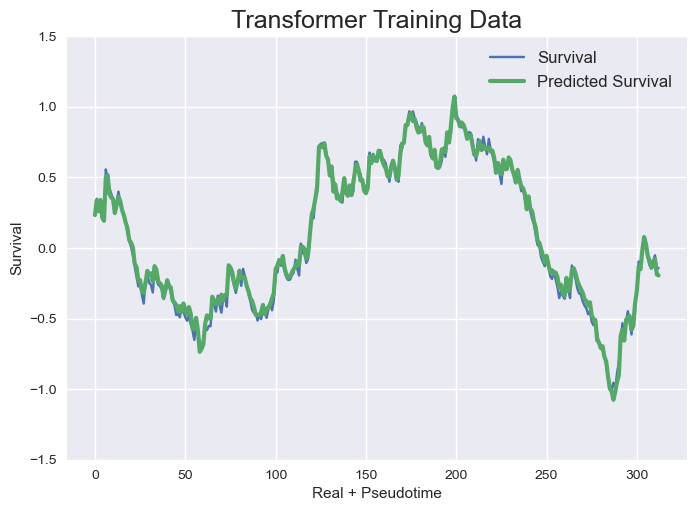

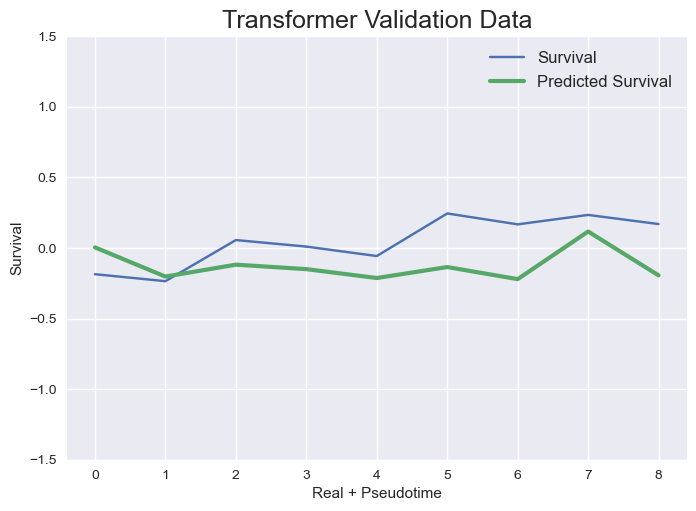

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


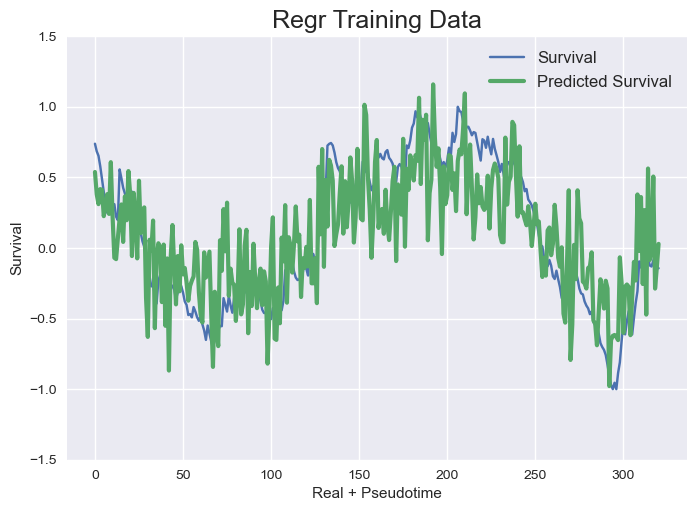

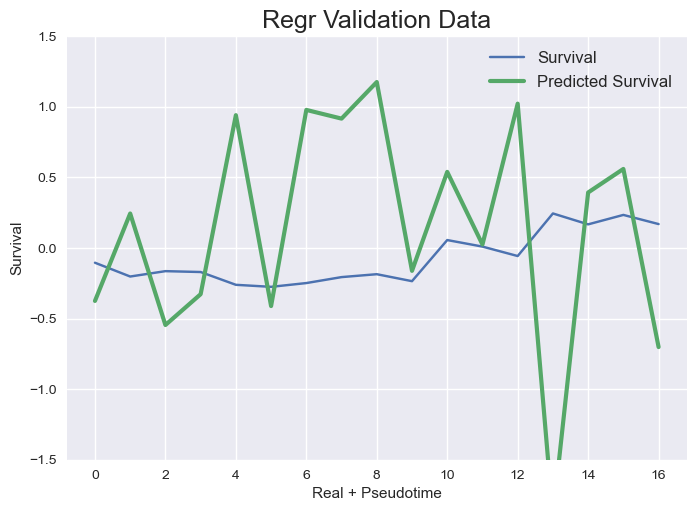

tf.Tensor(
[0.9295405  0.823912   0.819608   0.87066156 0.9809615  0.9097507
 1.0520557  1.1263931  0.75332206 1.3779668 ], shape=(10,), dtype=float32)
{0.75: [0.001584709412200812, 0.06197982302929613, 0.09963663912416548, 0.7911836007528895]}
9 
 9 
 9



GFPBC_libB_83026
Transformer Training/Val set shapes (varies depending on barcode)  (374, 8, 222) (12, 8, 222)
tf.Tensor(
[0.9295405  0.823912   0.819608   0.87066156 0.9809615  0.9097507
 1.0520557  1.1263931  0.75332206 1.3779668 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/12 [=====================>........] - ETA: 0s - loss: 0.0139 - mean_squared_error: 0.0139
Epoch 1: saving model to model_training_weights/cp.ckpt
12/12 [==============================] - 3s 69ms/step - loss: 0.0125 - mean_squared_error: 0.0125 - val_loss: 1.1436 - val_mean_squared_error: 1.1436
Epoch 2/10
11/12 [==========================>...] - ETA: 0s - loss: 0.0076 - mean_squared_error: 0.0076
Epoch 2: saving model to model_training_weights/cp.ckpt
12/12 [==

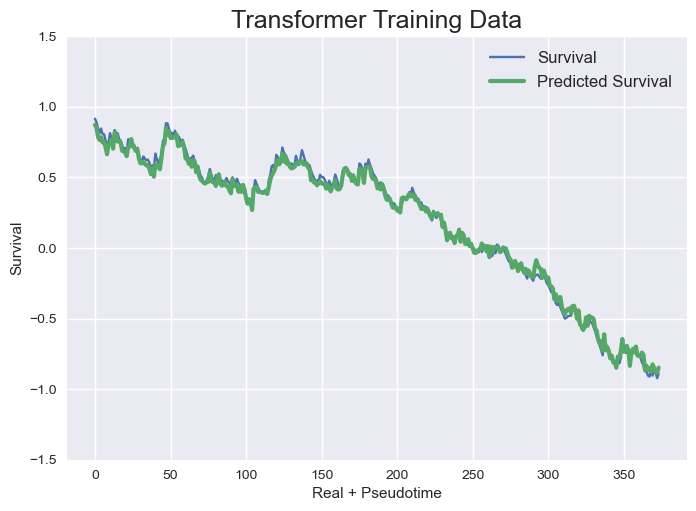

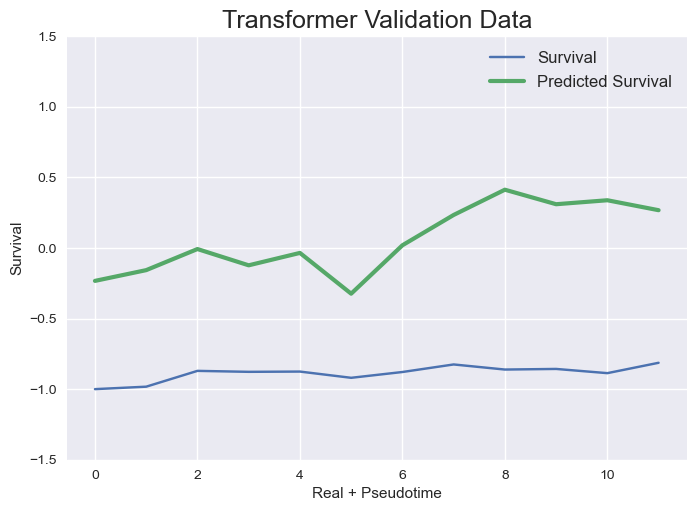

Regr Training/Val set shapes (varies depending on barcode)  (382, 222) (20, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0178
Regr Validation Data - MSE: 0.0768


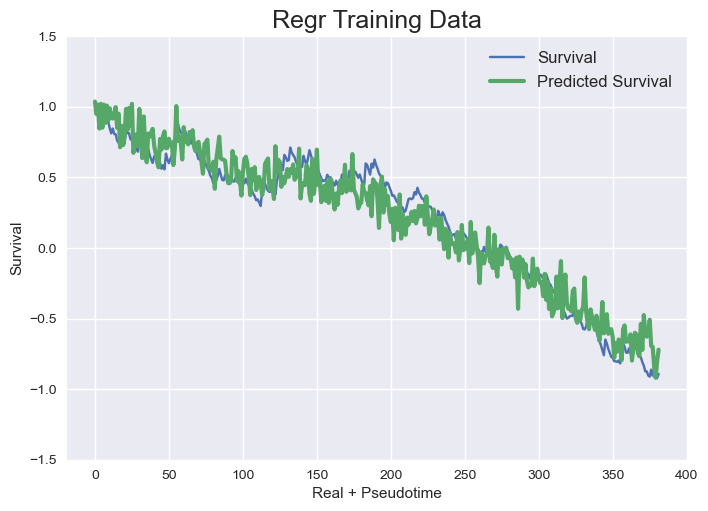

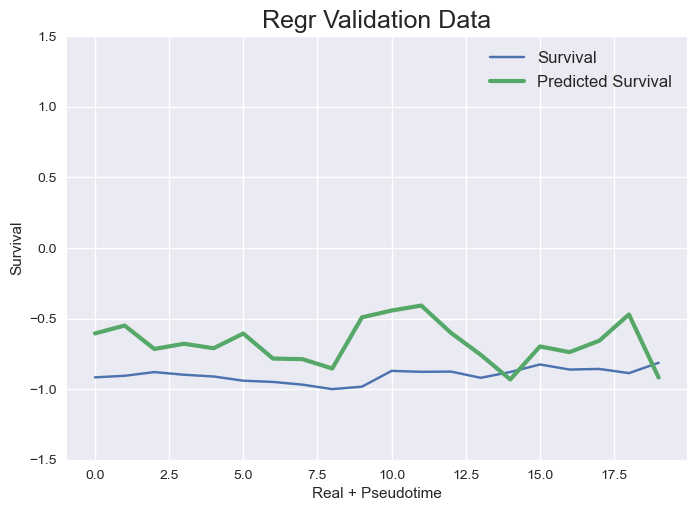

tf.Tensor(
[0.92645276 0.8201464  0.82078665 0.8705234  0.9835486  0.916852
 1.0537727  1.1312631  0.75119656 1.3705409 ], shape=(10,), dtype=float32)
{0.75: [0.0012080249482477345, 0.9354389490435341, 0.017775684402237615, 0.07679573915767544]}



GFPBC_libB_40758
Transformer Training/Val set shapes (varies depending on barcode)  (300, 8, 222) (8, 8, 222)
tf.Tensor(
[0.92645276 0.8201464  0.82078665 0.8705234  0.9835486  0.916852
 1.0537727  1.1312631  0.75119656 1.3705409 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0219 - mean_squared_error: 0.0219
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 2s 50ms/step - loss: 0.0213 - mean_squared_error: 0.0213 - val_loss: 0.0438 - val_mean_squared_error: 0.0438
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0111 - mean_squared_error: 0.0111
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=============

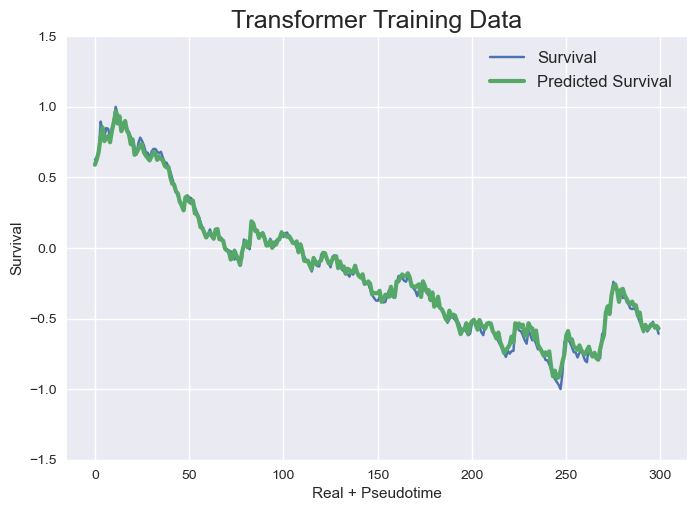

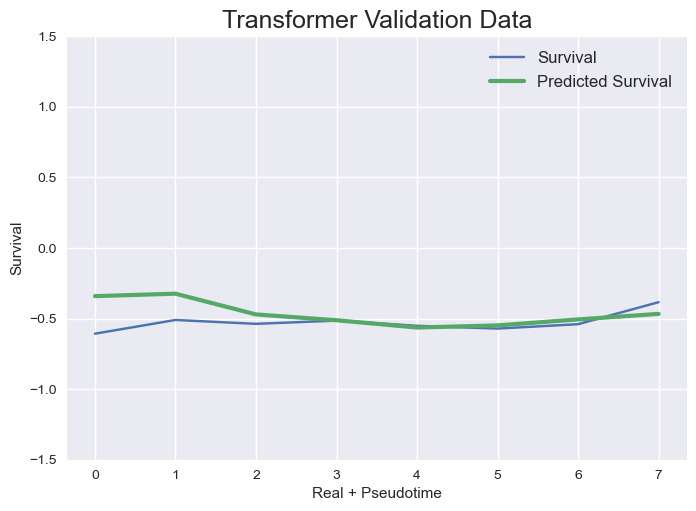

Regr Training/Val set shapes (varies depending on barcode)  (308, 222) (16, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0384
Regr Validation Data - MSE: 0.1874


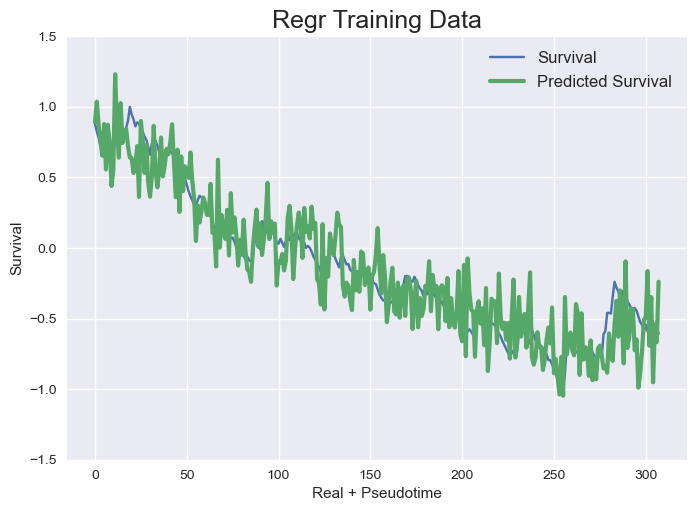

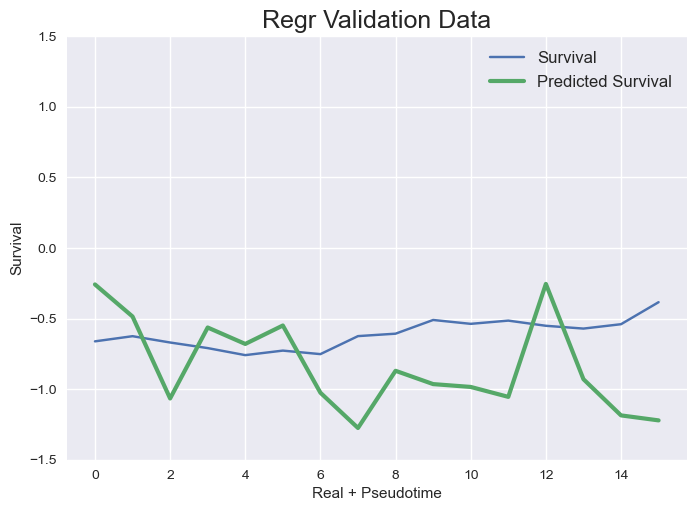

tf.Tensor(
[0.9284097  0.8246333  0.8178839  0.86856896 0.9881316  0.9147641
 1.0528592  1.1360137  0.7534523  1.3733943 ], shape=(10,), dtype=float32)
{0.75: [0.0012134516068192285, 0.014817170616447476, 0.0384042933028855, 0.1874125348553044]}



GFPBC_libB_20182
Transformer Training/Val set shapes (varies depending on barcode)  (879, 8, 222) (39, 8, 222)
tf.Tensor(
[0.9284097  0.8246333  0.8178839  0.86856896 0.9881316  0.9147641
 1.0528592  1.1360137  0.7534523  1.3733943 ], shape=(10,), dtype=float32)
Epoch 1/10
25/28 [=========================>....] - ETA: 0s - loss: 0.0215 - mean_squared_error: 0.0215
Epoch 1: saving model to model_training_weights/cp.ckpt
28/28 [==============================] - 3s 34ms/step - loss: 0.0201 - mean_squared_error: 0.0201 - val_loss: 0.5203 - val_mean_squared_error: 0.5203
Epoch 2/10
27/28 [===========================>..] - ETA: 0s - loss: 0.0055 - mean_squared_error: 0.0055
Epoch 2: saving model to model_training_weights/cp.ckpt
28/28 [===========

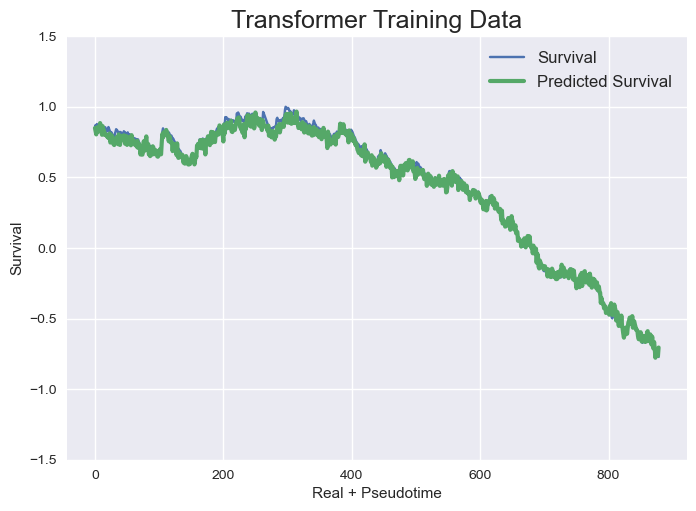

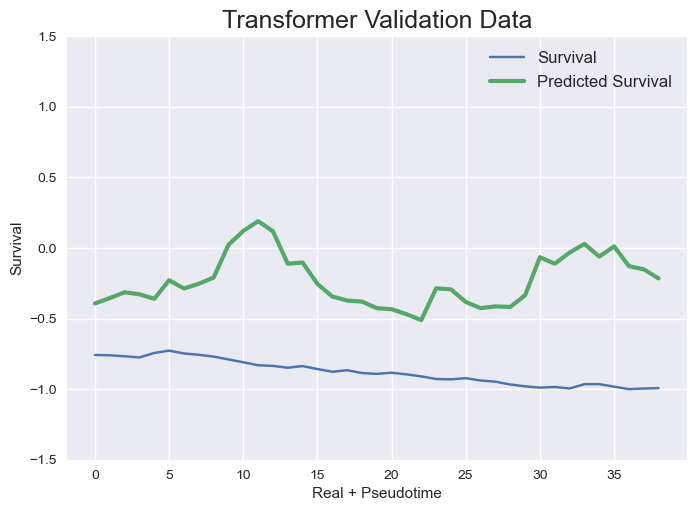

Regr Training/Val set shapes (varies depending on barcode)  (887, 222) (47, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 0.2539


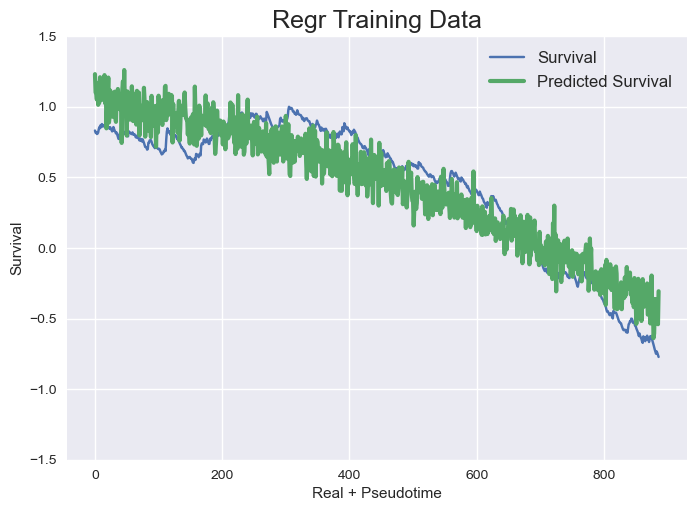

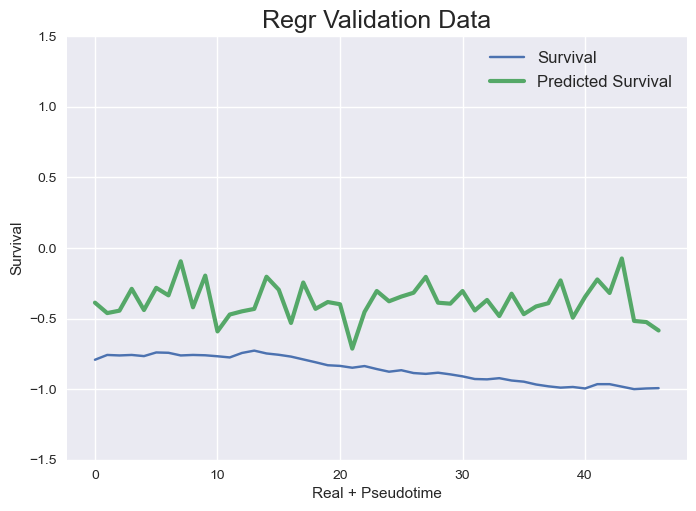

tf.Tensor(
[0.92543685 0.8301601  0.8342567  0.88477284 0.99147356 0.9303968
 1.0547132  1.1614349  0.747611   1.3627071 ], shape=(10,), dtype=float32)
{0.75: [0.0013002357476885593, 0.46473371710814515, 0.03995553320591314, 0.2538629562335835]}



GFPBC_libB_90850
Transformer Training/Val set shapes (varies depending on barcode)  (1225, 8, 222) (57, 8, 222)
tf.Tensor(
[0.92543685 0.8301601  0.8342567  0.88477284 0.99147356 0.9303968
 1.0547132  1.1614349  0.747611   1.3627071 ], shape=(10,), dtype=float32)
Epoch 1/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0471 - mean_squared_error: 0.0471
Epoch 1: saving model to model_training_weights/cp.ckpt
39/39 [==============================] - 3s 24ms/step - loss: 0.0459 - mean_squared_error: 0.0459 - val_loss: 0.0588 - val_mean_squared_error: 0.0588
Epoch 2/10
37/39 [===========================>..] - ETA: 0s - loss: 0.0067 - mean_squared_error: 0.0067
Epoch 2: saving model to model_training_weights/cp.ckpt
39/39 [==========

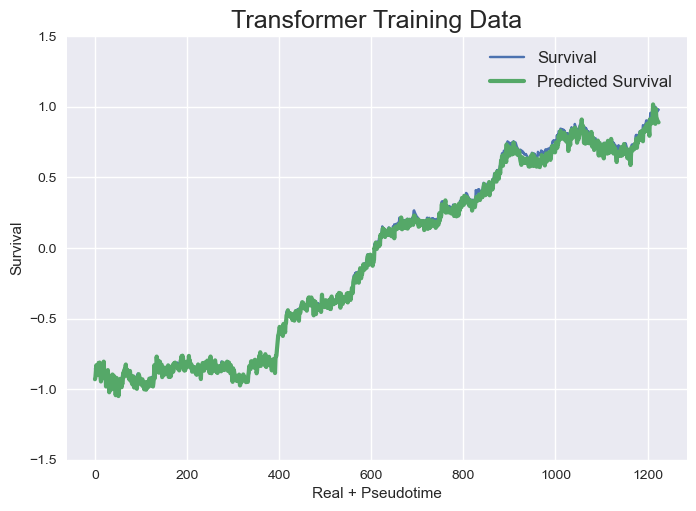

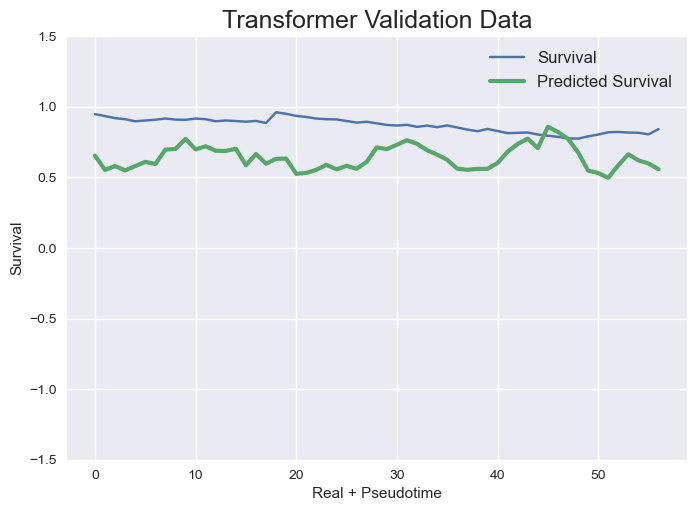

Regr Training/Val set shapes (varies depending on barcode)  (1233, 222) (65, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0157
Regr Validation Data - MSE: 0.0770


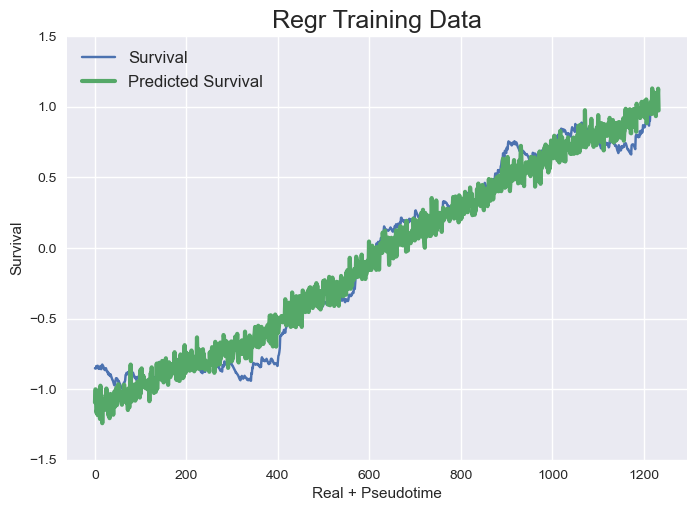

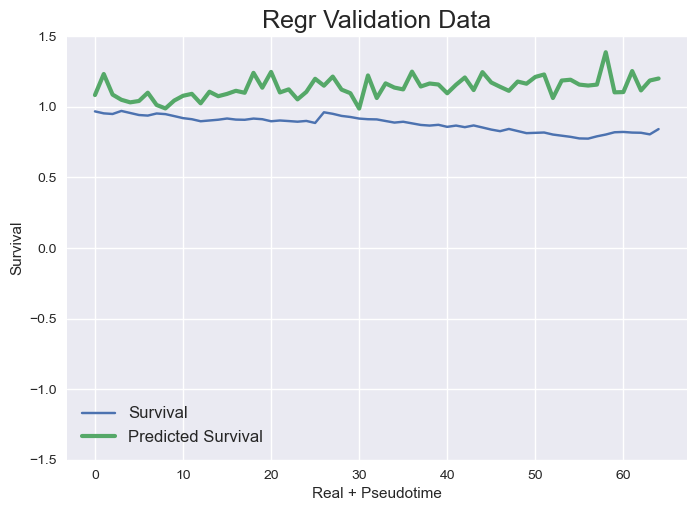

tf.Tensor(
[0.9234644  0.8498318  0.8397997  0.89692515 0.99709624 0.92655325
 1.0585309  1.1226422  0.7434967  1.3687394 ], shape=(10,), dtype=float32)
{0.75: [0.0013488029728607382, 0.06372768875467126, 0.01574872261148871, 0.07704258441094206]}



GFPBC_libB_37798
Transformer Training/Val set shapes (varies depending on barcode)  (993, 8, 222) (45, 8, 222)
tf.Tensor(
[0.9234644  0.8498318  0.8397997  0.89692515 0.99709624 0.92655325
 1.0585309  1.1226422  0.7434967  1.3687394 ], shape=(10,), dtype=float32)
Epoch 1/10
29/32 [==========================>...] - ETA: 0s - loss: 0.0111 - mean_squared_error: 0.0111
Epoch 1: saving model to model_training_weights/cp.ckpt
32/32 [==============================] - 3s 32ms/step - loss: 0.0107 - mean_squared_error: 0.0107 - val_loss: 1.5473 - val_mean_squared_error: 1.5473
Epoch 2/10
31/32 [============================>.] - ETA: 0s - loss: 0.0044 - mean_squared_error: 0.0044
Epoch 2: saving model to model_training_weights/cp.ckpt
32/32 [========

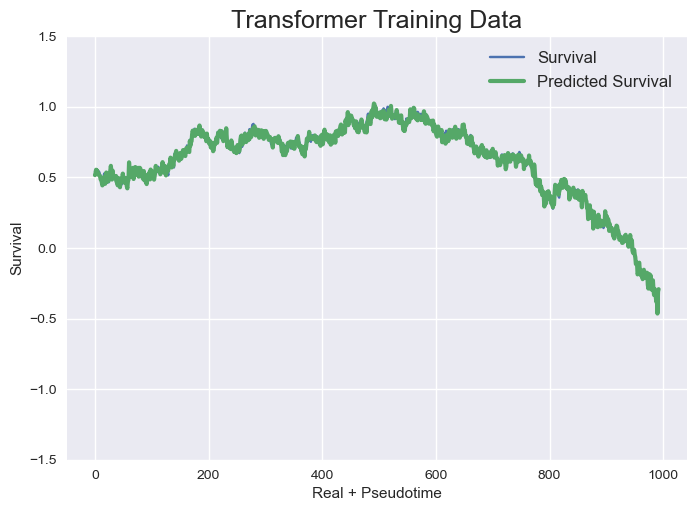

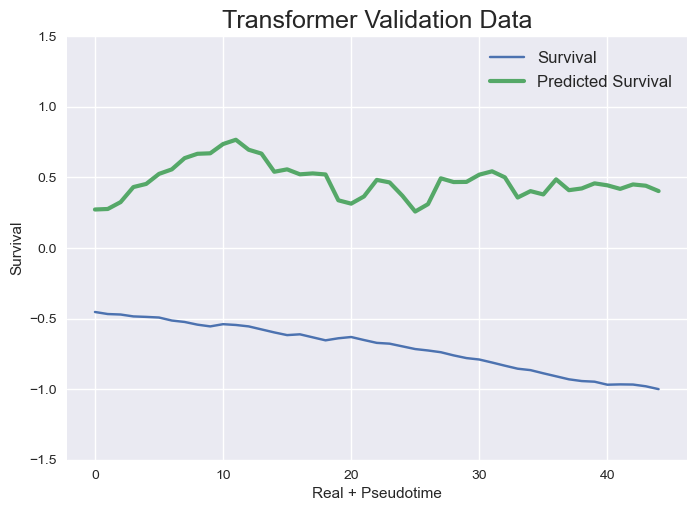

Regr Training/Val set shapes (varies depending on barcode)  (1001, 222) (53, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0455
Regr Validation Data - MSE: 0.9663


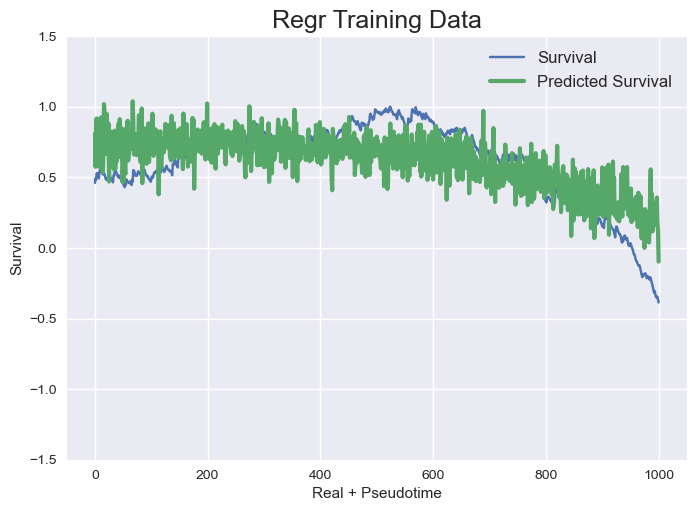

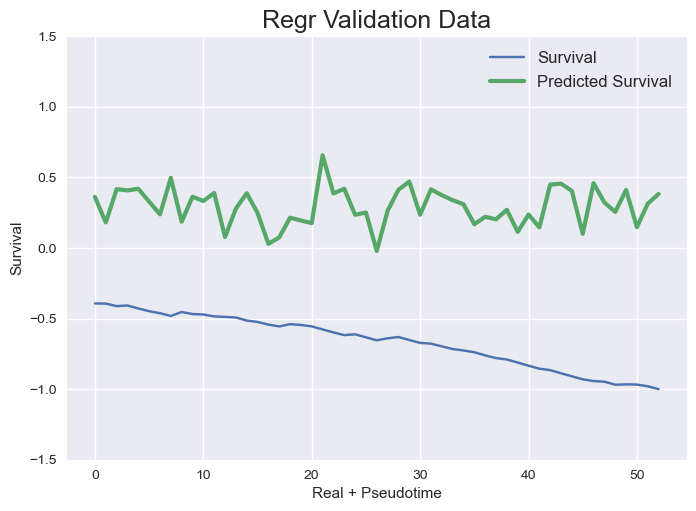

tf.Tensor(
[0.9190916 0.845671  0.8369301 0.8859259 0.9907339 0.9217415 1.0645883
 1.1258225 0.7502286 1.3758084], shape=(10,), dtype=float32)
{0.75: [0.0006689000299699368, 1.419008332345033, 0.04546866648275204, 0.9663087785396409]}



GFPBC_libB_92196
Transformer Training/Val set shapes (varies depending on barcode)  (1517, 8, 222) (72, 8, 222)
tf.Tensor(
[0.9190916 0.845671  0.8369301 0.8859259 0.9907339 0.9217415 1.0645883
 1.1258225 0.7502286 1.3758084], shape=(10,), dtype=float32)
Epoch 1/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0297 - mean_squared_error: 0.0297
Epoch 1: saving model to model_training_weights/cp.ckpt
48/48 [==============================] - 3s 22ms/step - loss: 0.0286 - mean_squared_error: 0.0286 - val_loss: 0.7068 - val_mean_squared_error: 0.7068
Epoch 2/10
45/48 [===========================>..] - ETA: 0s - loss: 0.0059 - mean_squared_error: 0.0059
Epoch 2: saving model to model_training_weights/cp.ckpt
48/48 [==============================

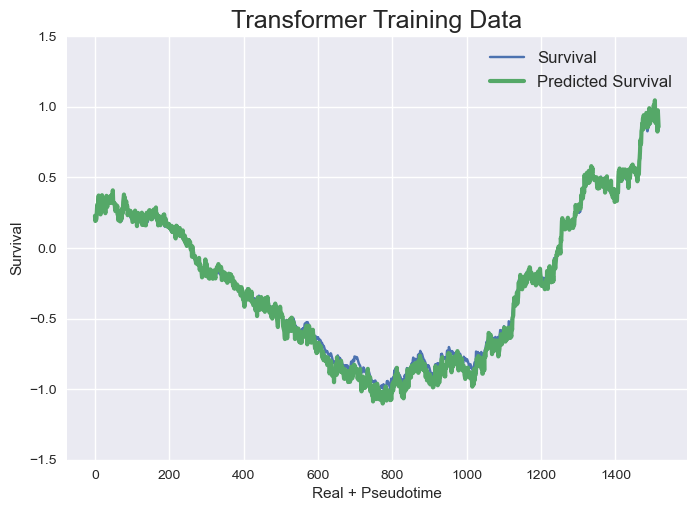

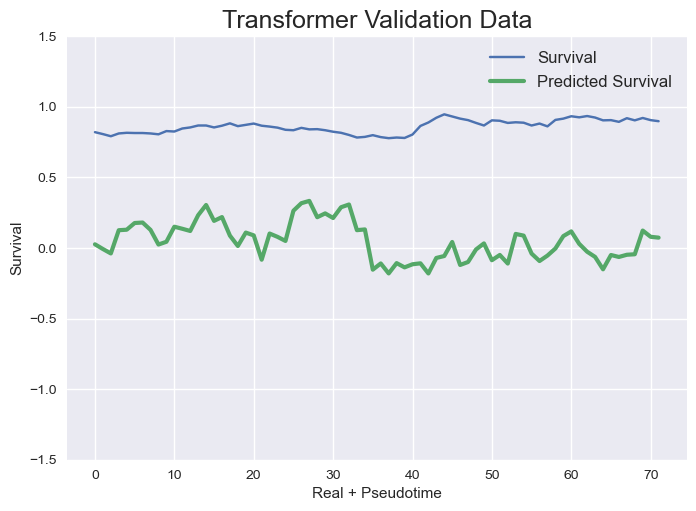

Regr Training/Val set shapes (varies depending on barcode)  (1525, 222) (80, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.1908
Regr Validation Data - MSE: 0.6402


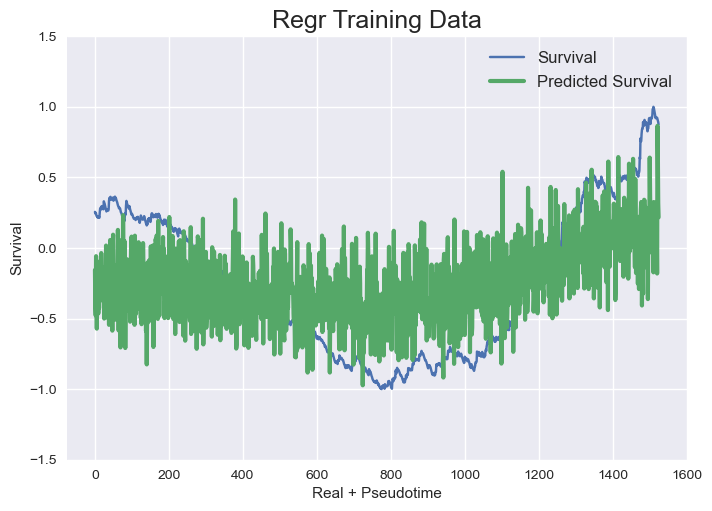

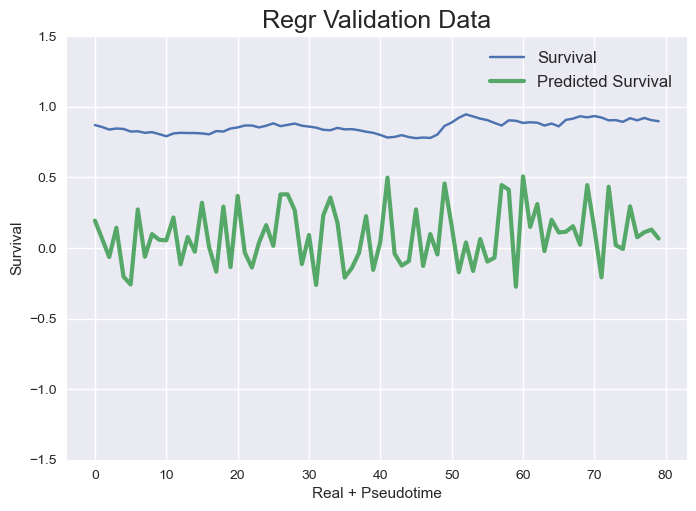

tf.Tensor(
[0.92879975 0.8404914  0.826168   0.8846858  0.9957743  0.908263
 1.0513787  1.1413333  0.7545733  1.3696959 ], shape=(10,), dtype=float32)
{0.75: [0.0024206522398734515, 0.6819035544829335, 0.19077083008474877, 0.6402264496001513]}



GFPBC_libB_10678
Transformer Training/Val set shapes (varies depending on barcode)  (614, 8, 222) (25, 8, 222)
tf.Tensor(
[0.92879975 0.8404914  0.826168   0.8846858  0.9957743  0.908263
 1.0513787  1.1413333  0.7545733  1.3696959 ], shape=(10,), dtype=float32)
Epoch 1/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0065 - mean_squared_error: 0.0065
Epoch 1: saving model to model_training_weights/cp.ckpt
20/20 [==============================] - 2s 28ms/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.2578 - val_mean_squared_error: 0.2578
Epoch 2/10
17/20 [========================>.....] - ETA: 0s - loss: 0.0027 - mean_squared_error: 0.0027
Epoch 2: saving model to model_training_weights/cp.ckpt
20/20 [==============

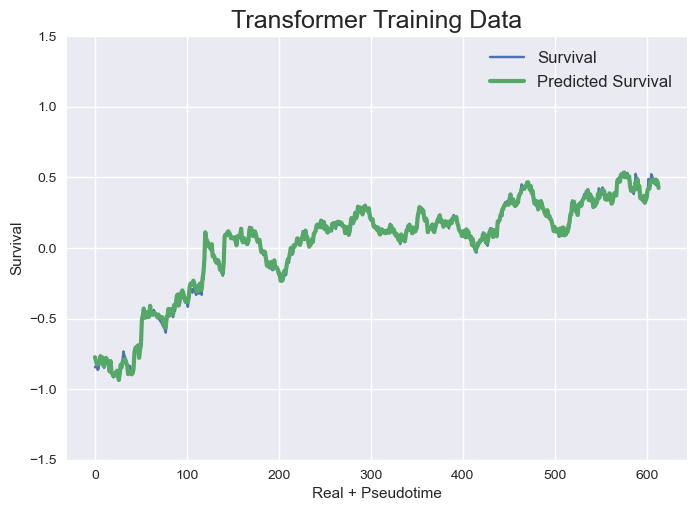

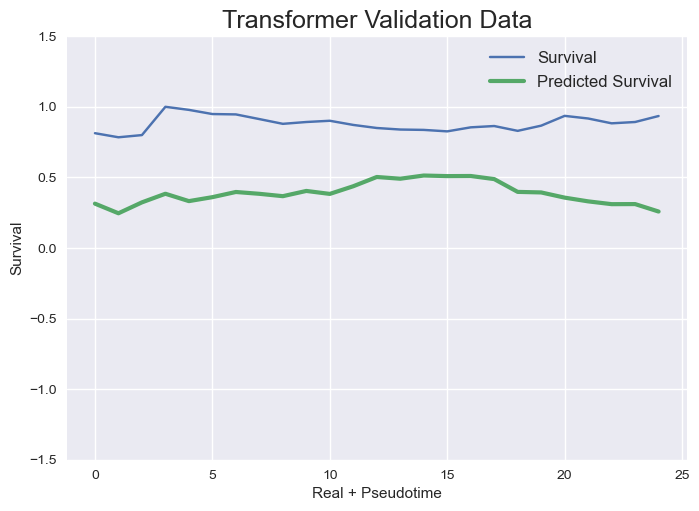

Regr Training/Val set shapes (varies depending on barcode)  (622, 222) (33, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0212
Regr Validation Data - MSE: 0.0499


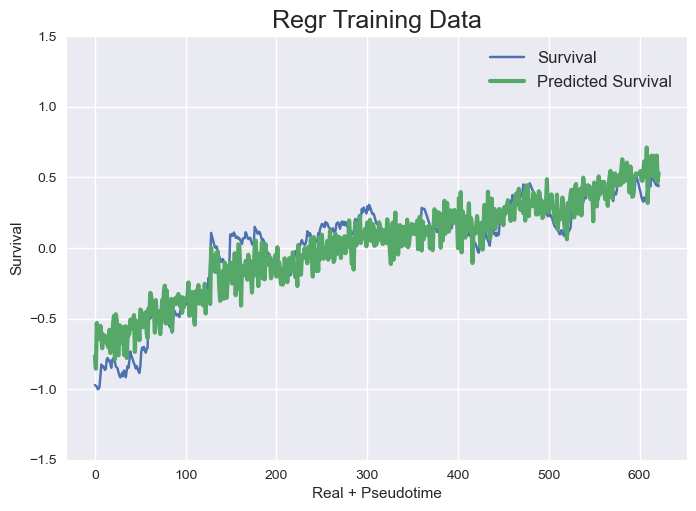

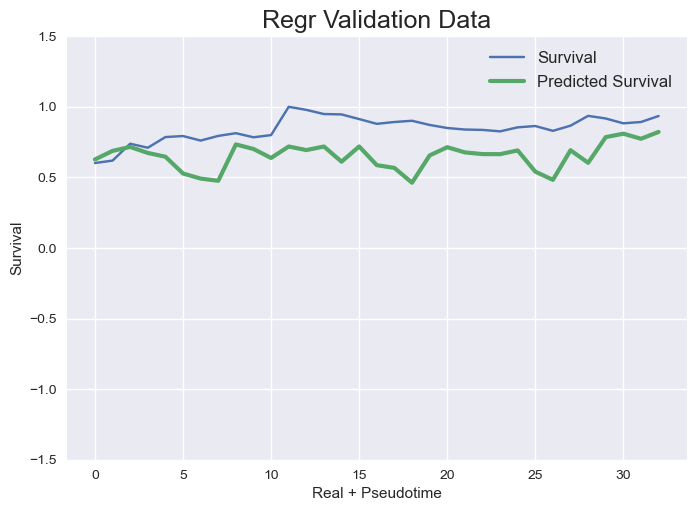

tf.Tensor(
[0.9281292  0.83829236 0.82815707 0.88370264 0.9979968  0.9060719
 1.0547123  1.1327957  0.7583055  1.3759366 ], shape=(10,), dtype=float32)
{0.75: [0.0004976255944731488, 0.25486444181975654, 0.021231450426700903, 0.049885319000513496]}



GFPBC_libB_94397
Transformer Training/Val set shapes (varies depending on barcode)  (317, 8, 222) (9, 8, 222)
tf.Tensor(
[0.9281292  0.83829236 0.82815707 0.88370264 0.9979968  0.9060719
 1.0547123  1.1327957  0.7583055  1.3759366 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0247 - mean_squared_error: 0.0247
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 79ms/step - loss: 0.0241 - mean_squared_error: 0.0241 - val_loss: 0.1802 - val_mean_squared_error: 0.1802
Epoch 2/10
10/10 [==============================] - ETA: 0s - loss: 0.0086 - mean_squared_error: 0.0086
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [=========

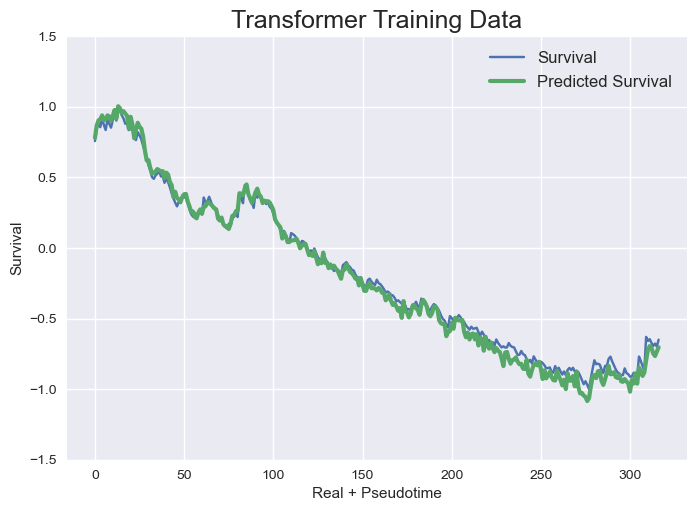

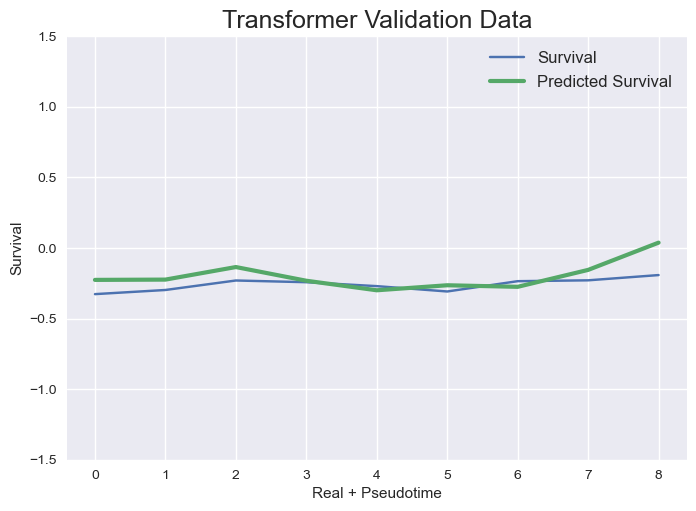

Regr Training/Val set shapes (varies depending on barcode)  (325, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0400
Regr Validation Data - MSE: 1.1421


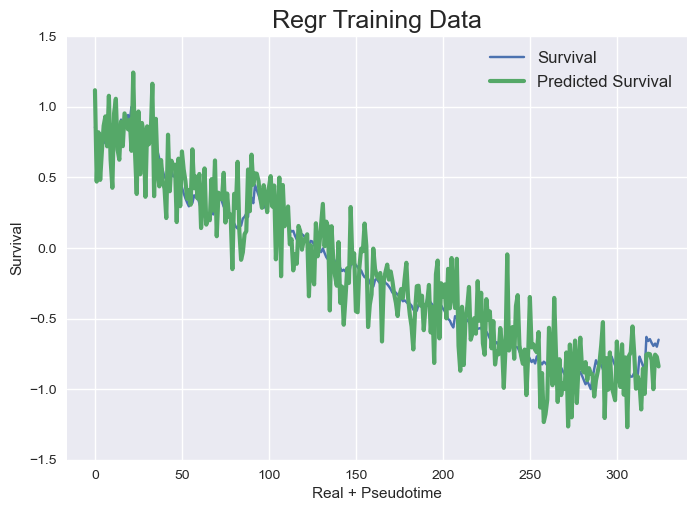

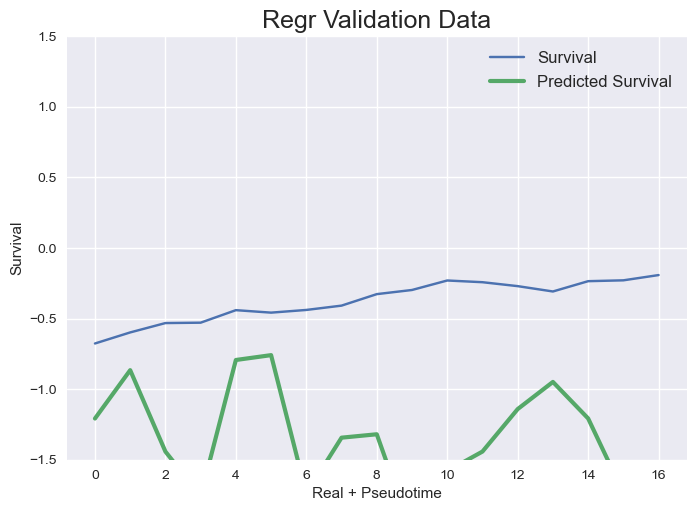

tf.Tensor(
[0.93309325 0.83757883 0.82254845 0.89234287 0.9914459  0.9047709
 1.0567493  1.1518338  0.7560351  1.3798345 ], shape=(10,), dtype=float32)
{0.75: [0.0026485782785476354, 0.009711426969415222, 0.03996887214055618, 1.1420841142882547]}



GFPBC_libB_31581
Transformer Training/Val set shapes (varies depending on barcode)  (313, 8, 222) (9, 8, 222)
tf.Tensor(
[0.93309325 0.83757883 0.82254845 0.89234287 0.9914459  0.9047709
 1.0567493  1.1518338  0.7560351  1.3798345 ], shape=(10,), dtype=float32)
Epoch 1/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0150 - mean_squared_error: 0.0150
Epoch 1: saving model to model_training_weights/cp.ckpt
10/10 [==============================] - 3s 79ms/step - loss: 0.0142 - mean_squared_error: 0.0142 - val_loss: 0.0634 - val_mean_squared_error: 0.0634
Epoch 2/10
 9/10 [==========================>...] - ETA: 0s - loss: 0.0061 - mean_squared_error: 0.0061
Epoch 2: saving model to model_training_weights/cp.ckpt
10/10 [===========

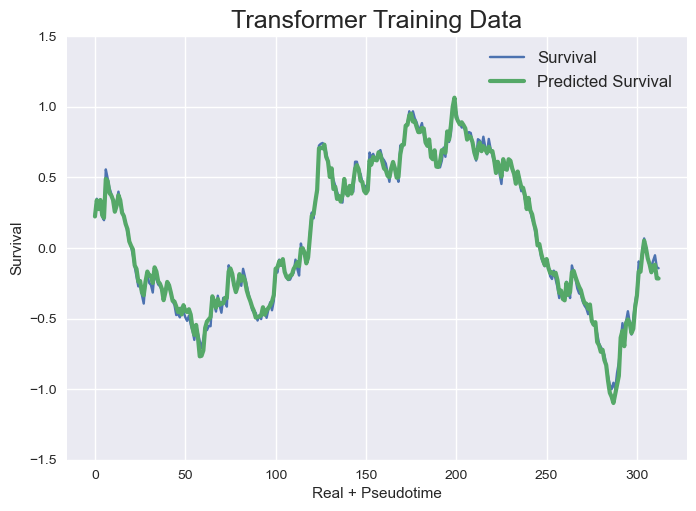

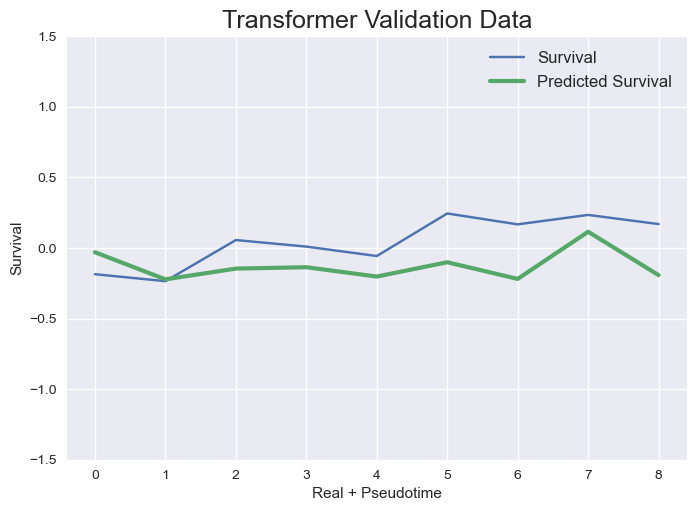

Regr Training/Val set shapes (varies depending on barcode)  (321, 222) (17, 222)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.0996
Regr Validation Data - MSE: 0.7912


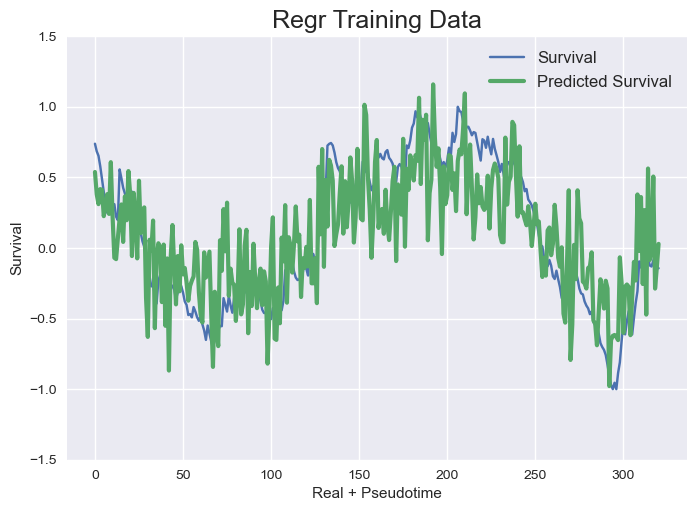

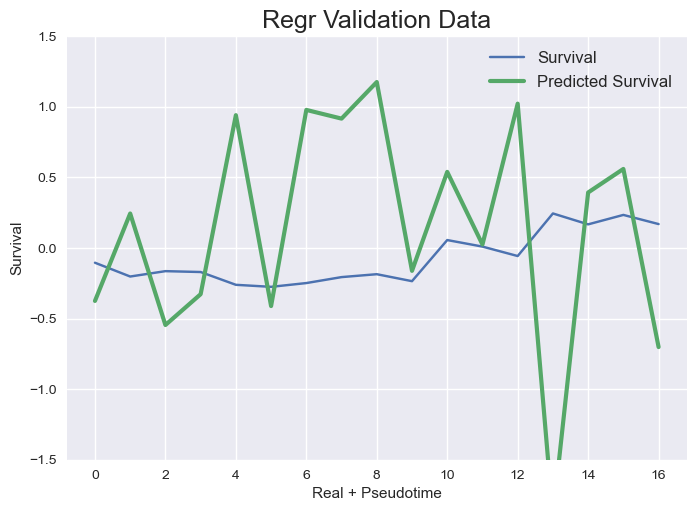

tf.Tensor(
[0.9315579  0.83370984 0.82287264 0.89020723 0.9847354  0.9075082
 1.053168   1.1491152  0.7551961  1.3774296 ], shape=(10,), dtype=float32)
{0.75: [0.0013372532127857407, 0.05795166735634402, 0.09963663912416548, 0.7911836007528895]}
{'GFPBC_libB_83026': {0.75: [0.0012080249482477345, 0.9354389490435341, 0.017775684402237615, 0.07679573915767544]}, 'GFPBC_libB_40758': {0.75: [0.0012134516068192285, 0.014817170616447476, 0.0384042933028855, 0.1874125348553044]}, 'GFPBC_libB_20182': {0.75: [0.0013002357476885593, 0.46473371710814515, 0.03995553320591314, 0.2538629562335835]}, 'GFPBC_libB_90850': {0.75: [0.0013488029728607382, 0.06372768875467126, 0.01574872261148871, 0.07704258441094206]}, 'GFPBC_libB_37798': {0.75: [0.0006689000299699368, 1.419008332345033, 0.04546866648275204, 0.9663087785396409]}, 'GFPBC_libB_92196': {0.75: [0.0024206522398734515, 0.6819035544829335, 0.19077083008474877, 0.6402264496001513]}, 'GFPBC_libB_10678': {0.75: [0.0004976255944731488, 0.25486444181

In [28]:
# use partial_fit to train multiple times, could be different barcodes in our case
frac_val = 0.20
test_barcodes = ['GFPBC_libB_90850'] #, 'GFPBC_libB_90850', 'GFPBC_libB_20182'] #'GFPBC_libB_78143', 'GFPBC_libB_78143', 'GFPBC_libB_78143']
surv_barcodes = ['GFPBC_libB_90850', 'GFPBC_libB_10678', 'GFPBC_libB_92196', 'GFPBC_libB_37798']
depl_barcodes = ['GFPBC_libB_20182', 'GFPBC_libB_83026', 'GFPBC_libB_94397', 'GFPBC_libB_40758', 'GFPBC_libB_31581']
extra_var_bool = [True, True, True] # 0-realtime, 1-barcode, 2-pseudotime

#intervals = [0.25, 0.5, 0.75, 1]
intervals = [0.75]
#pct_test = frac_val/len(intervals) # comment out and use frac_val for last 20%
pct_test = frac_val/4

mse_dict = {} # structure is {barcode: {day_0: [trans_train, trans_val, regr_train, regr_val], day_n...}, barcode_n: ...}

first_iter = False
for i in range(10):
    print(i,'\n',i,'\n',i)
    for bar in new_barcodes: #test_bars: #new_barcodes:

        print('\n\n')
        print(bar)
        mse_dict[bar] = {}


        for v in intervals:
            # make the training and validation data
            X_train, y_train, X_val, y_val, COLS = transformer_train_test_split_dayiter(bar, pct_test, extra_var_bool, v)

            # build and compile model
            input_shape = X_train.shape[1:]
            model = build_model(
                input_shape,
                head_size=n_head_size, # Embedding size for attention
                num_heads=n_heads, # Number of attention heads
                ff_dim=n_ff_dim, # Hidden layer size in feed forward network inside transformer
                num_transformer_blocks=3, # six layers doesn't add or subtract much so best to keep simple
                mlp_units=[256],
                mlp_dropout=0.4, # unclear if increasing or decreasing has sizable effect
                dropout=0.14 # unclear if increasing or decreasing has sizable effect
            )
            model.compile(
                loss="mean_squared_error",
                optimizer=keras.optimizers.Adam(learning_rate=1e-3),  # was 1e-4
                metrics=["mean_squared_error"],
            )

            if first_iter:
                # Loads the weights
                model.load_weights(checkpoint_path)

            print(model.weights[0][:10])

            # fit the model
            history = model.fit(X_train, y_train, 
                            batch_size=batch_size, 
                            epochs=10,
                            validation_data=(X_val, y_val),
                            callbacks=[cp_callback]) 

            if X_val.shape[0] > 0:

                # predictions and loss
                train_mse, val_mse = plot_transformer_predictions_losses(X_train, y_train, X_val, y_val, bar, 'barmodels_ptime_BREASTsd/transformer_ptime_')

                # build multivariate regression model
                X, y, X_test, y_test = regr_train_test_split_dayiter(bar, pct_test, extra_var_bool, v)
                regr = linear_model.LinearRegression()
                regr.fit(X, y)
                regr_train_mse, regr_val_mse = plot_regr_predictions_losses(X, y, X_test, y_test, bar, 'barmodels_ptime_BREASTsd/regr_ptime_')

                # add to mse dictionary
                mse_dict[bar][v] = [train_mse, val_mse, regr_train_mse, regr_val_mse]

                # SHAP values
                #regr_SHAPvals(X_test, y_test, bar, COLS, 'barmodels_ptime7/regr_'+str(v))
                #SHAPvals(X_val, y_val, bar, COLS, 'barmodels_ptime_BREASTsurvdepl/transformer_'+str(v))

            print(model.weights[0][:10])
            first_iter = True        

        print(mse_dict[bar])
    
print(mse_dict)

Transformer Training/Val set shapes (varies depending on barcode)  (1921, 8, 219) (94, 8, 219)
tf.Tensor(
[0.59809154 0.67790365 0.979881   1.1049429  1.0488986  0.8229815
 0.72425133 0.7858603  0.58436704 0.8794899 ], shape=(10,), dtype=float32)
(1921, 8, 219) (94, 8, 219)
3/3 [==============================] - 0s 8ms/step
 
Transformer Evaluation metrics
Transformer Training MSE - MSE: 0.0385
Transformer Validation MSE - MSE: 1.3756


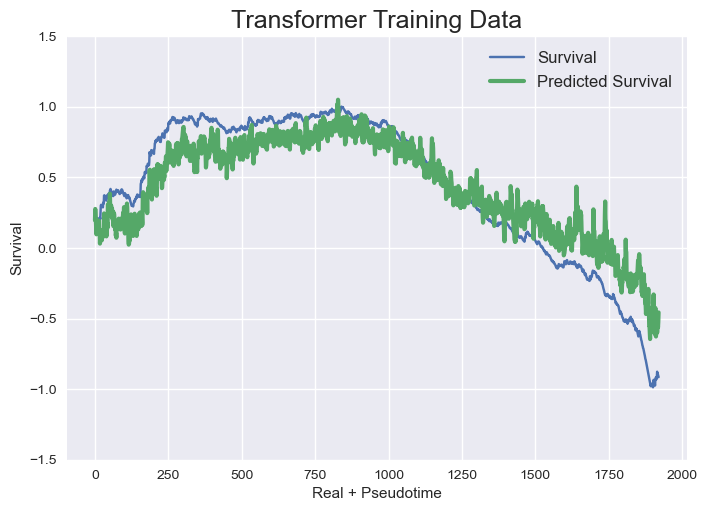

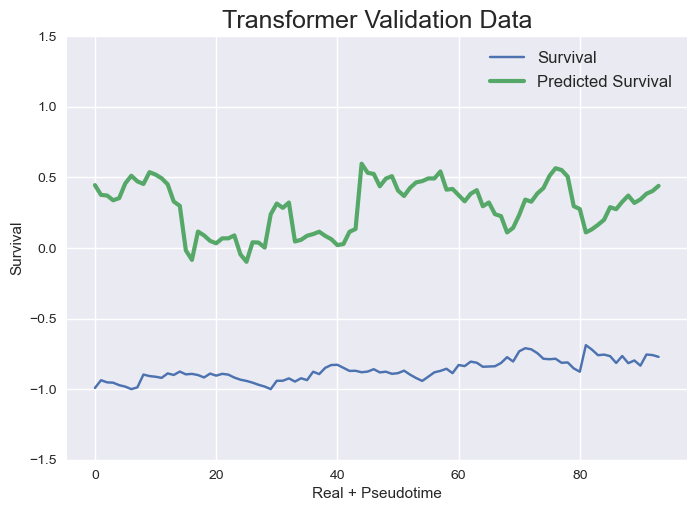

Transformer Training/Val set shapes (varies depending on barcode)  (980, 8, 219) (44, 8, 219)
tf.Tensor(
[0.59809154 0.67790365 0.979881   1.1049429  1.0488986  0.8229815
 0.72425133 0.7858603  0.58436704 0.8794899 ], shape=(10,), dtype=float32)
(980, 8, 219) (44, 8, 219)
2/2 [==============================] - 0s 7ms/step
 
Transformer Evaluation metrics
Transformer Training MSE - MSE: 0.0474
Transformer Validation MSE - MSE: 0.5875


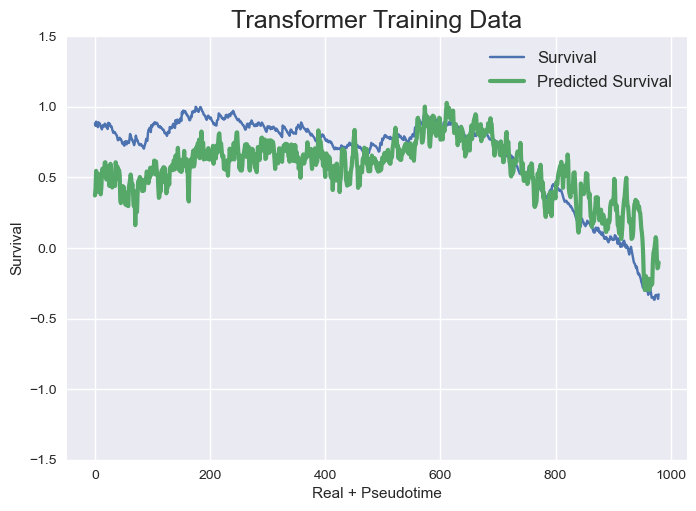

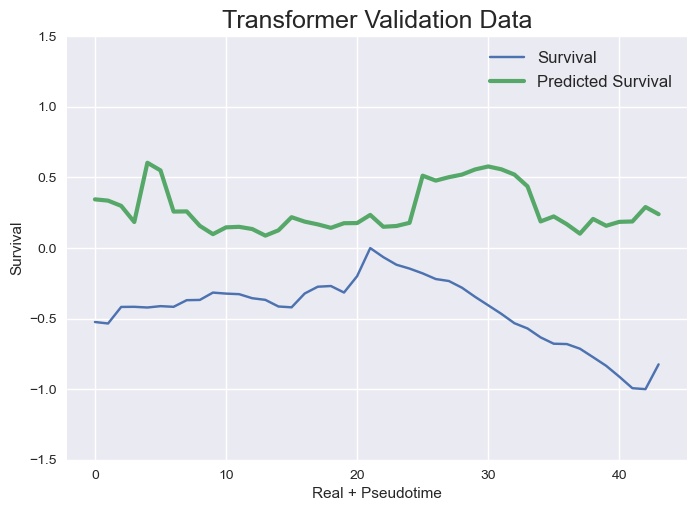

Transformer Training/Val set shapes (varies depending on barcode)  (2588, 8, 219) (129, 8, 219)
tf.Tensor(
[0.59809154 0.67790365 0.979881   1.1049429  1.0488986  0.8229815
 0.72425133 0.7858603  0.58436704 0.8794899 ], shape=(10,), dtype=float32)
(2588, 8, 219) (129, 8, 219)
5/5 [==============================] - 0s 7ms/step
 
Transformer Evaluation metrics
Transformer Training MSE - MSE: 0.0255
Transformer Validation MSE - MSE: 0.3903


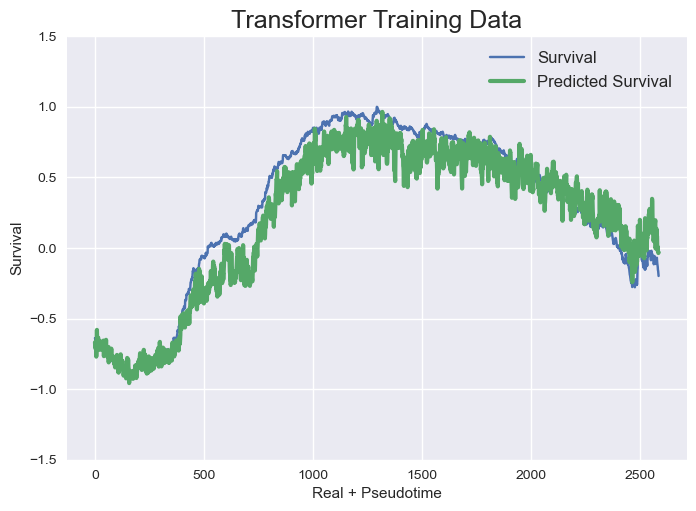

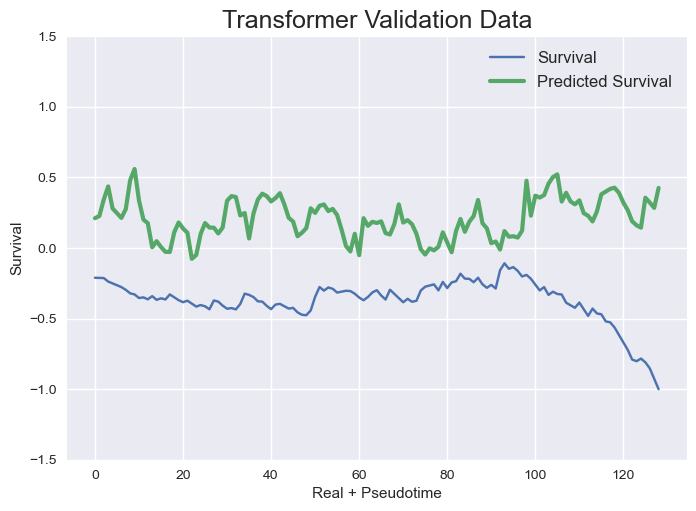

Transformer Training/Val set shapes (varies depending on barcode)  (1578, 8, 219) (76, 8, 219)
tf.Tensor(
[0.59809154 0.67790365 0.979881   1.1049429  1.0488986  0.8229815
 0.72425133 0.7858603  0.58436704 0.8794899 ], shape=(10,), dtype=float32)
(1578, 8, 219) (76, 8, 219)
3/3 [==============================] - 0s 7ms/step
 
Transformer Evaluation metrics
Transformer Training MSE - MSE: 0.0011
Transformer Validation MSE - MSE: 0.1915


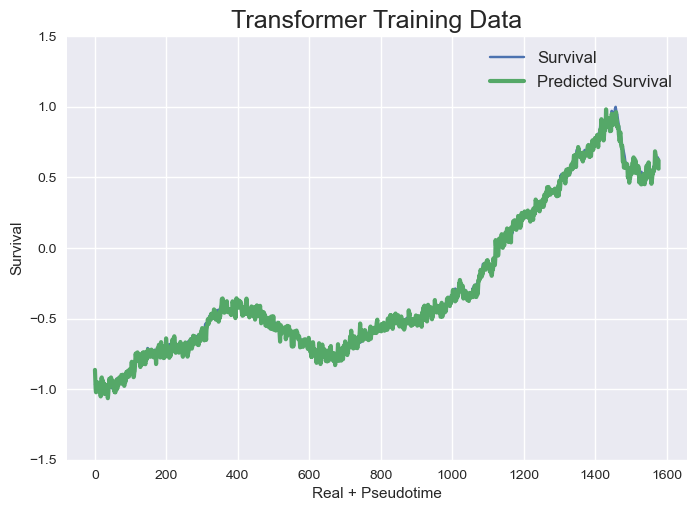

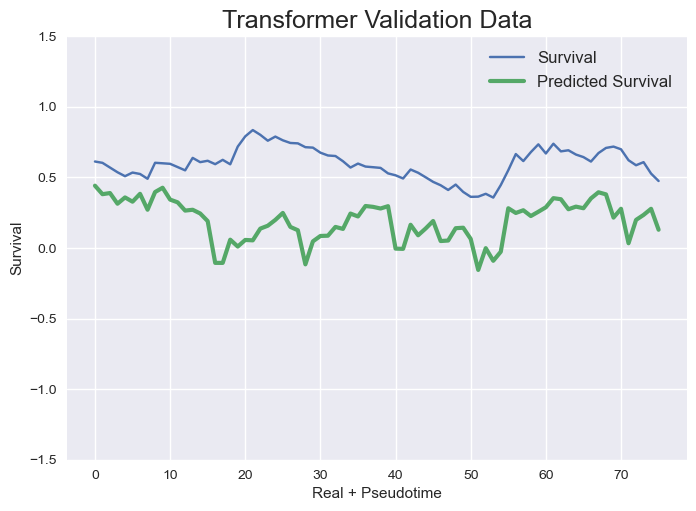

In [53]:
# plot model predictions for barcodes after all have been trained on

for bar in surv_barcodes:
    
    # make the training and validation data
    X_train, y_train, X_val, y_val, COLS = transformer_train_test_split_dayiter(bar, pct_test, extra_var_bool, 1)
    
    print(model.weights[0][:10])
    
    # predictions and loss
    train_mse, val_mse = plot_transformer_predictions_losses(X_train, y_train, X_val, y_val, bar, 'barmodels_ptime_BREASTsd/transformer_ptime_')


Regr Training/Val set shapes (varies depending on barcode)  (1929, 219) (102, 219)
Regr Training/Val set shapes (varies depending on barcode)  (988, 219) (52, 219)
Regr Training/Val set shapes (varies depending on barcode)  (2596, 219) (137, 219)
Regr Training/Val set shapes (varies depending on barcode)  (1586, 219) (84, 219)
(7099, 219) (7099,)
 
Evaluation metrics Regr
Regr Training Data - MSE: 0.2325
Regr Validation Data - MSE: 0.7322


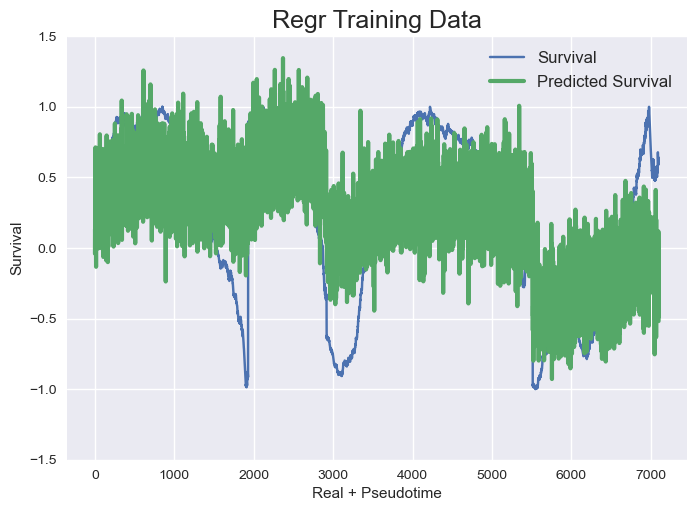

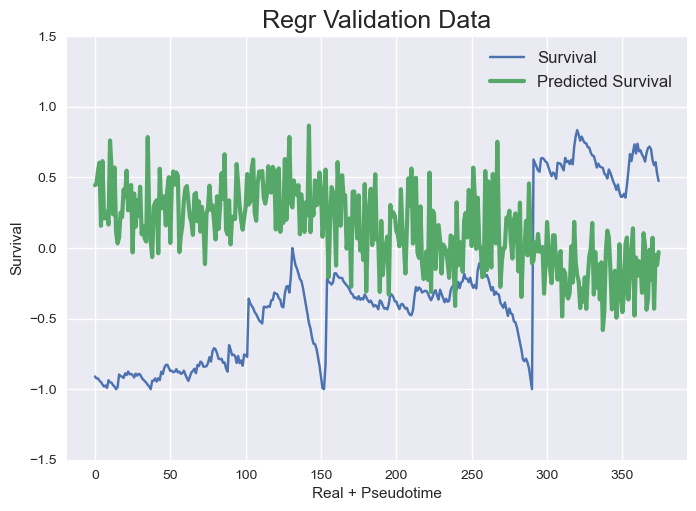

In [52]:
# plot model predictions for regression model based on all barcodes

#Xfull = np.array()
first_iter = False
for bar in surv_barcodes:
    
    # make the training and validation data
    X, y, X_test, y_test = regr_train_test_split_dayiter(bar, pct_test, extra_var_bool, 1)
    if first_iter:
        Xfull = np.concatenate((Xfull, X), axis=0)
        yfull = np.concatenate((yfull, y), axis=0)
        Xfulltest = np.concatenate((Xfulltest, X_test), axis=0)
        yfulltest = np.concatenate((yfulltest, y_test), axis=0)
        
    else:
        Xfull = X
        yfull = y
        Xfulltest = X_test
        yfulltest = y_test
    first_iter = True

# fit model
regr = linear_model.LinearRegression()
print(Xfull.shape, yfull.shape)
regr.fit(Xfull, yfull)

# predictions and loss
regr_train_mse, regr_val_mse = plot_regr_predictions_losses(Xfull, yfull, Xfulltest, yfulltest, 'full', 'barmodels_ptime_BREASTsd/regr_ptime_')

In [29]:
mse = pd.DataFrame(mse_dict)
mse

,GFPBC_libB_83026,GFPBC_libB_40758,GFPBC_libB_20182,GFPBC_libB_90850,GFPBC_libB_37798,GFPBC_libB_92196,GFPBC_libB_10678,GFPBC_libB_94397,GFPBC_libB_31581
0.75,"[0.0012080249482477345, 0.9354389490435341, 0....","[0.0012134516068192285, 0.014817170616447476, ...","[0.0013002357476885593, 0.46473371710814515, 0...","[0.0013488029728607382, 0.06372768875467126, 0...","[0.0006689000299699368, 1.419008332345033, 0.0...","[0.0024206522398734515, 0.6819035544829335, 0....","[0.0004976255944731488, 0.25486444181975654, 0...","[0.0026485782785476354, 0.009711426969415222, ...","[0.0013372532127857407, 0.05795166735634402, 0..."


In [32]:
f = open('mse/mse_dict_trans_9545_BREASTiter75_10.csv', 'w')
f.write(str(mse_dict))
f.close()

In [33]:
mse_file = open('mse/mse_dict_trans_9545_BREASTiter75_10.csv', 'r')
for line in mse_file:
    mse = eval(line)
mse

{'GFPBC_libB_83026': {0.75: [0.0012080249482477345,
   0.9354389490435341,
   0.017775684402237615,
   0.07679573915767544]},
 'GFPBC_libB_40758': {0.75: [0.0012134516068192285,
   0.014817170616447476,
   0.0384042933028855,
   0.1874125348553044]},
 'GFPBC_libB_20182': {0.75: [0.0013002357476885593,
   0.46473371710814515,
   0.03995553320591314,
   0.2538629562335835]},
 'GFPBC_libB_90850': {0.75: [0.0013488029728607382,
   0.06372768875467126,
   0.01574872261148871,
   0.07704258441094206]},
 'GFPBC_libB_37798': {0.75: [0.0006689000299699368,
   1.419008332345033,
   0.04546866648275204,
   0.9663087785396409]},
 'GFPBC_libB_92196': {0.75: [0.0024206522398734515,
   0.6819035544829335,
   0.19077083008474877,
   0.6402264496001513]},
 'GFPBC_libB_10678': {0.75: [0.0004976255944731488,
   0.25486444181975654,
   0.021231450426700903,
   0.049885319000513496]},
 'GFPBC_libB_94397': {0.75: [0.0026485782785476354,
   0.009711426969415222,
   0.03996887214055618,
   1.1420841142882547]

In [40]:
model.weights[0][:10]

<tf.Tensor: shape=(10,), dtype=float32, numpy=
array([0.92041105, 0.945451  , 1.0277847 , 1.0195321 , 1.0527606 ,
       0.9746702 , 0.8966395 , 0.9835862 , 0.90258133, 0.90988123],
      dtype=float32)>